# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

100% 255k/255k [00:00<00:00, 428kB/s]
100% 255k/255k [00:00<00:00, 427kB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

100% 66.1k/66.1k [00:00<00:00, 338kB/s]
100% 66.1k/66.1k [00:00<00:00, 338kB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:58<00:00, 22.5MB/s]
100% 1.09G/1.09G [00:58<00:00, 19.9MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 2.0 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 18.5 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
from scipy.stats import spearmanr
import time

# Preprocess & Split

In [ ]:
df_food = pd.read_csv("/content/food.csv")
df_food["image_file"] =df_food["image_file"].apply(lambda file: "/content/food" +"/"+ file) # Create image path
df_food["memorability_wo_fa_correction"] = df_food["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_food.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,2001,/content/food/000000007944.jpg,food,apple,411.0,640.0,coco,apple,1.0,77,2,90,0.855556,0.833333
1,2002,/content/food/000000010478.jpg,food,apple,426.0,640.0,coco,apple,1.0,82,3,101,0.811881,0.782178
2,2003,/content/food/000000028864.jpg,food,apple,384.0,500.0,coco,apple,1.0,70,7,85,0.823529,0.741176
3,2004,/content/food/000000052818.jpg,food,apple,428.0,640.0,coco,apple,1.0,79,1,95,0.831579,0.821053
4,2005,/content/food/000000056714.jpg,food,apple,500.0,333.0,coco,apple,1.0,82,6,101,0.811881,0.752475


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 111.59480955702594
Standard deviation of pixel values: 71.5882221476661


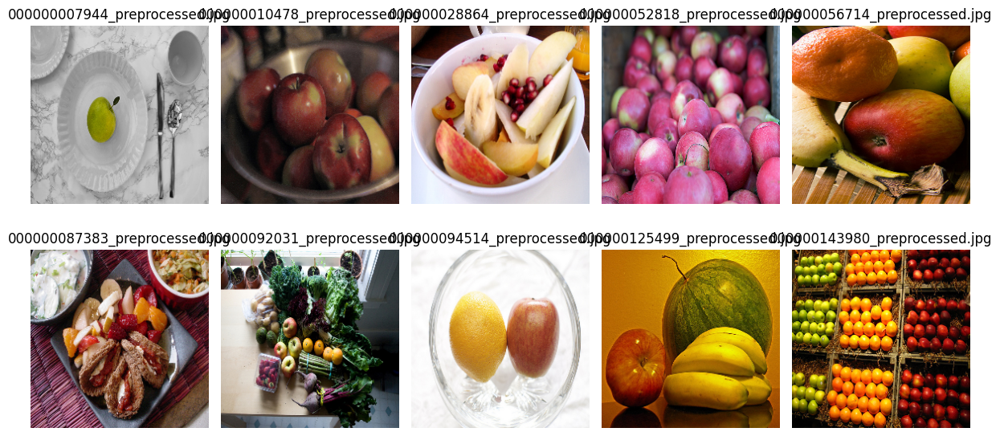

In [ ]:
# Sample data (replace this with your DataFrame)
df_food = pd.DataFrame({
    'image_file': df_food["image_file"],
    'memoscore': df_food["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_food['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_food.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_food.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_food.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_food.head()

,image_file,memoscore,preprocessed_image_path
0,/content/food/000000007944.jpg,0.855556,/content/food/000000007944_preprocessed.jpg
1,/content/food/000000010478.jpg,0.811881,/content/food/000000010478_preprocessed.jpg
2,/content/food/000000028864.jpg,0.823529,/content/food/000000028864_preprocessed.jpg
3,/content/food/000000052818.jpg,0.831579,/content/food/000000052818_preprocessed.jpg
4,/content/food/000000056714.jpg,0.811881,/content/food/000000056714_preprocessed.jpg


In [ ]:
del df_food["image_file"]

In [ ]:
df_food.head()

,memoscore,preprocessed_image_path
0,0.855556,/content/food/000000007944_preprocessed.jpg
1,0.811881,/content/food/000000010478_preprocessed.jpg
2,0.823529,/content/food/000000028864_preprocessed.jpg
3,0.831579,/content/food/000000052818_preprocessed.jpg
4,0.811881,/content/food/000000056714_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_food.drop('memoscore', axis=1)), pd.DataFrame(df_food['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
208,/content/food/n07654148_13111_preprocessed.jpg
107,/content/food/n07693725_905_preprocessed.jpg
1416,/content/food/000000546088_preprocessed.jpg
1820,/content/food/n07583197_6849_preprocessed.jpg
362,/content/food/n07680932_5209_preprocessed.jpg


In [ ]:
merged_train_food = pd.concat([X_train, y_train], axis=1)
merged_train_food

,preprocessed_image_path,memoscore
208,/content/food/n07654148_13111_preprocessed.jpg,0.753086
107,/content/food/n07693725_905_preprocessed.jpg,0.824742
1416,/content/food/000000546088_preprocessed.jpg,0.721649
1820,/content/food/n07583197_6849_preprocessed.jpg,0.790698
362,/content/food/n07680932_5209_preprocessed.jpg,0.809524
...,...,...
1053,/content/food/000000571990_preprocessed.jpg,0.863158
79,/content/food/n07693725_3602_preprocessed.jpg,0.929293
111,/content/food/000000000715_preprocessed.jpg,0.780702
735,/content/food/000000318044_preprocessed.jpg,0.849462


In [ ]:
merged_val_food = pd.concat([X_val, y_val], axis=1)
merged_val_food

,preprocessed_image_path,memoscore
970,/content/food/n07929519_34091_preprocessed.jpg,0.957447
387,/content/food/n07574602_22882_preprocessed.jpg,0.731481
1311,/content/food/n07711569_533_preprocessed.jpg,0.858696
192,/content/food/n07753592_9781_preprocessed.jpg,0.914894
900,/content/food/n07911677_2899_preprocessed.jpg,0.814433
...,...,...
1859,/content/food/n07933274_30873_preprocessed.jpg,0.850000
1302,/content/food/n07711569_4347_preprocessed.jpg,0.852941
499,/content/food/000000300264_preprocessed.jpg,0.761468
112,/content/food/000000004749_preprocessed.jpg,0.861702


In [ ]:
merged_test_food = pd.concat([X_test, y_test], axis=1)
merged_test_food

,preprocessed_image_path,memoscore
28,/content/food/000000572430_preprocessed.jpg,0.885417
1860,/content/food/n07933274_30896_preprocessed.jpg,0.857143
787,/content/food/n07801508_7989_preprocessed.jpg,0.931373
604,/content/food/n07880968_6021_preprocessed.jpg,0.894309
1939,/content/food/n07849336_29721_preprocessed.jpg,0.765957
...,...,...
170,/content/food/n07753592_3592_preprocessed.jpg,0.898876
1552,/content/food/000000321324_preprocessed.jpg,0.860465
490,/content/food/000000251702_preprocessed.jpg,0.875000
199,/content/food/000000579405_preprocessed.jpg,0.871287


# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_food = '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/food_Vit.csv'
merged_train_food.to_csv(csv_train_food, index=False)

In [ ]:
csv_val_food = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/food_Vit.csv'
merged_val_food.to_csv(csv_val_food, index=False)

In [ ]:
csv_test_food = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/food_Vit.csv'
merged_test_food.to_csv(csv_test_food, index=False)

#Load Dataset

In [ ]:
df_train_food = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/food_Vit.csv")
df_val_food = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/food_Vit.csv')
df_test_food = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/food_Vit.csv')

In [ ]:
df_train_food.head()

,preprocessed_image_path,memoscore
0,/content/food/n07849336_22546_preprocessed.jpg,0.730000
1,/content/food/n07880968_4309_preprocessed.jpg,0.863636
2,/content/food/000000293810_preprocessed.jpg,0.857143
3,/content/food/n07849336_20238_preprocessed.jpg,0.770115
4,/content/food/n07717556_3057_preprocessed.jpg,0.941176


In [ ]:
df_train_food.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_food(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_food["memoscore"]
        self.images = df_train_food["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds = Dataset_food(df_train_food, trans_transform=trans_transform)
train_dl = DataLoader(train_ds, batch_size=32, shuffle=False)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
class ViTMem_model_food(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit =  ViTMem_model_food( arch="vit_base_patch16_224_miil")



model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

In [ ]:
# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_food().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)




----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model_vit  = to_device(model_vit  , device)

In [ ]:
params = [param for param in list(model_vit.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.0026966696605086327

 Epoch: (1/30) Loss_rmse = 0.05192946642637253

 Epoch: (1/30) R^2 = -0.8211038112640381

 Epoch: (1/30) MAE = 0.042240530252456665
Spearman correlation coefficient: SignificanceResult(statistic=0.15056085973471411, pvalue=1.497354026083972e-10)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0

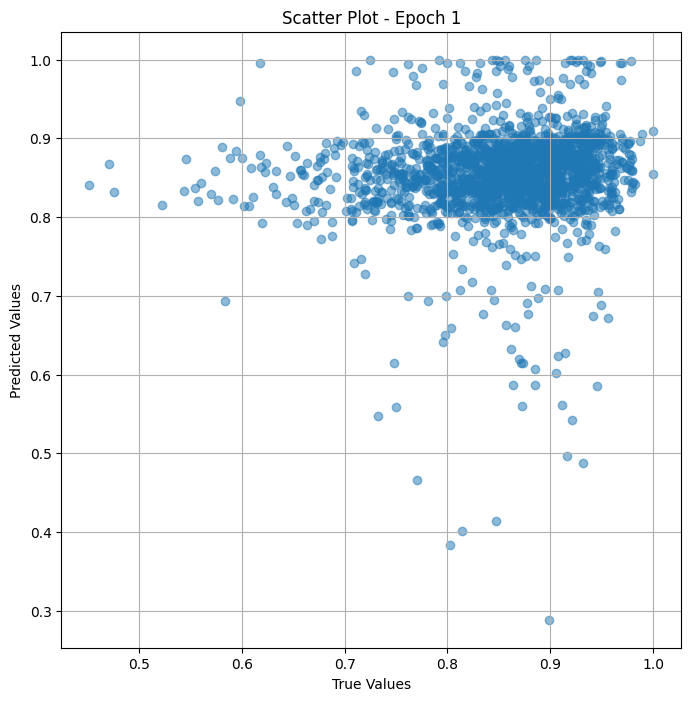

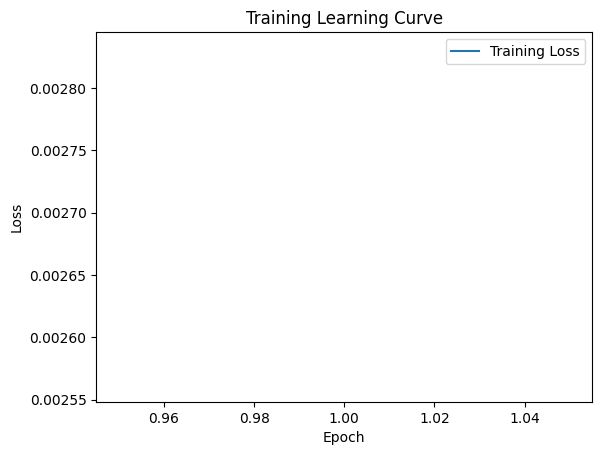


 Epoch: (2/30) Loss = 0.0018178196623921394

 Epoch: (2/30) Loss_rmse = 0.04263589531183243

 Epoch: (2/30) R^2 = -0.22760248184204102

 Epoch: (2/30) MAE = 0.03504063934087753
Spearman correlation coefficient: SignificanceResult(statistic=0.3982690836443045, pvalue=3.489856930932521e-69)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.

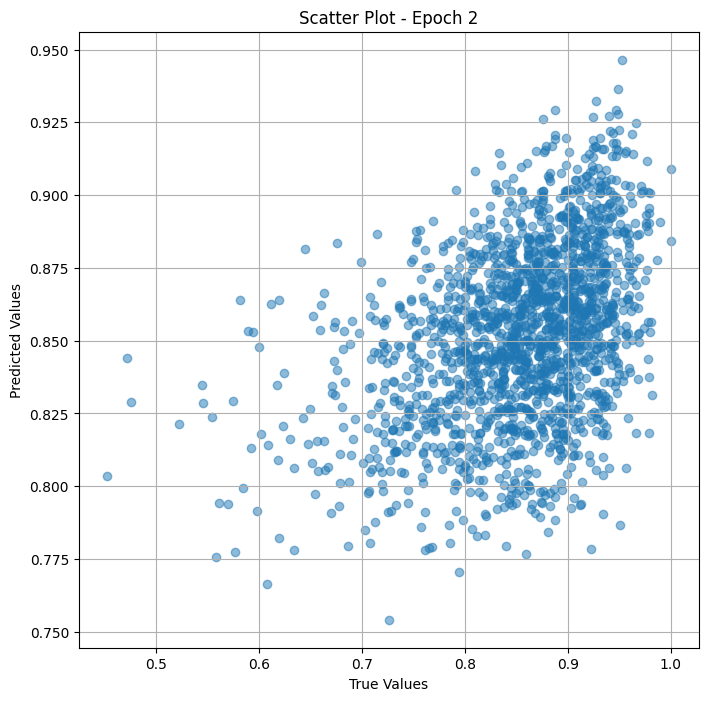

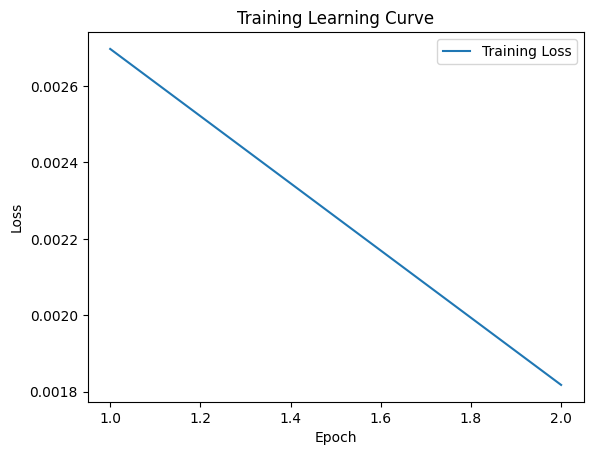


 Epoch: (3/30) Loss = 0.0021591850090771914

 Epoch: (3/30) Loss_rmse = 0.04646703228354454

 Epoch: (3/30) R^2 = -0.45813190937042236

 Epoch: (3/30) MAE = 0.041504018008708954
Spearman correlation coefficient: SignificanceResult(statistic=0.5225863259963666, pvalue=3.78764589849622e-126)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0

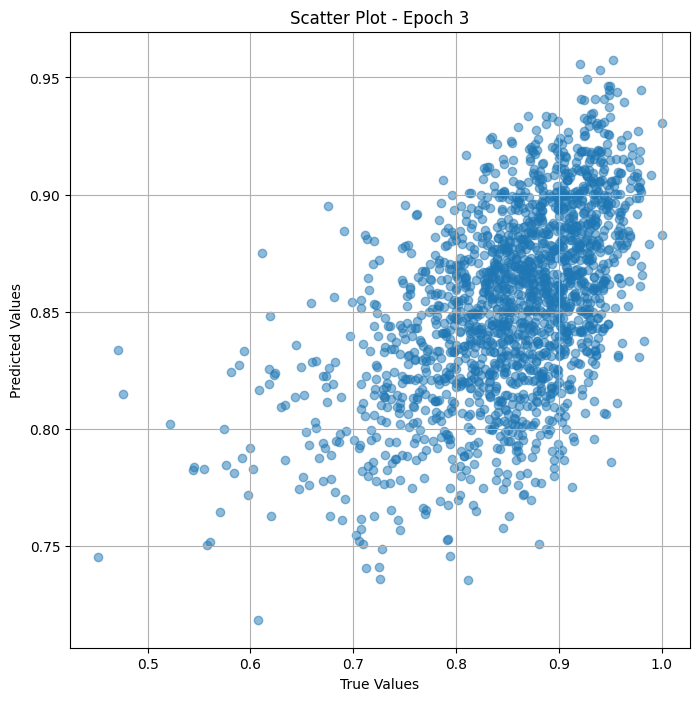

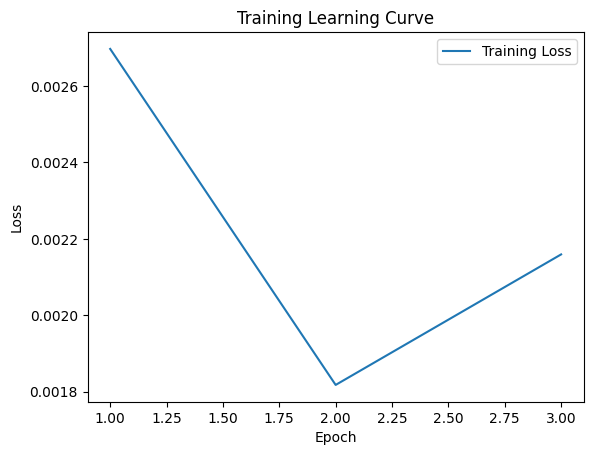


 Epoch: (4/30) Loss = 0.0006325192516669631

 Epoch: (4/30) Loss_rmse = 0.025149935856461525

 Epoch: (4/30) R^2 = 0.5728497505187988

 Epoch: (4/30) MAE = 0.024279609322547913
Spearman correlation coefficient: SignificanceResult(statistic=0.6256129000771394, pvalue=2.892629444858051e-195)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0

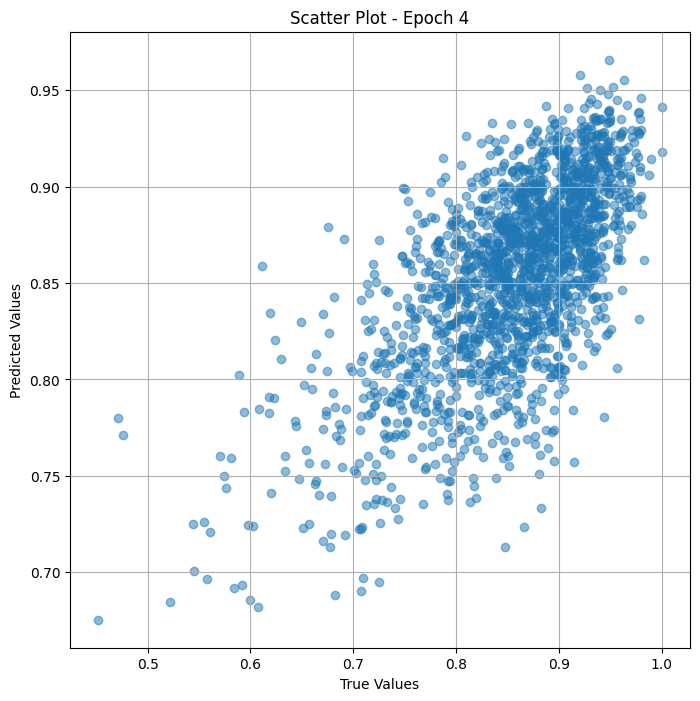

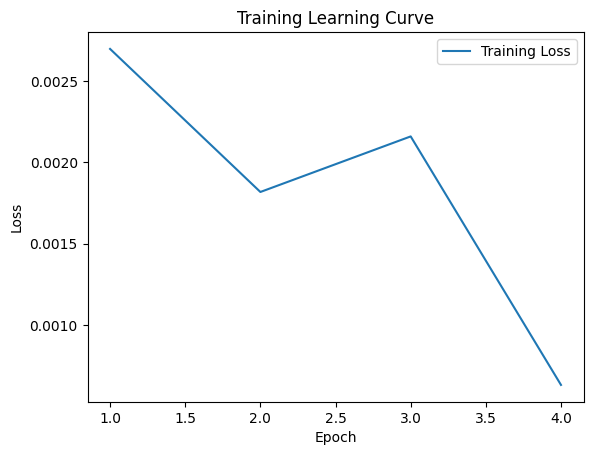


 Epoch: (5/30) Loss = 0.0008156602270901203

 Epoch: (5/30) Loss_rmse = 0.028559766709804535

 Epoch: (5/30) R^2 = 0.4491717219352722

 Epoch: (5/30) MAE = 0.023243077099323273
Spearman correlation coefficient: SignificanceResult(statistic=0.7032460554761358, pvalue=1.645249658457873e-267)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0

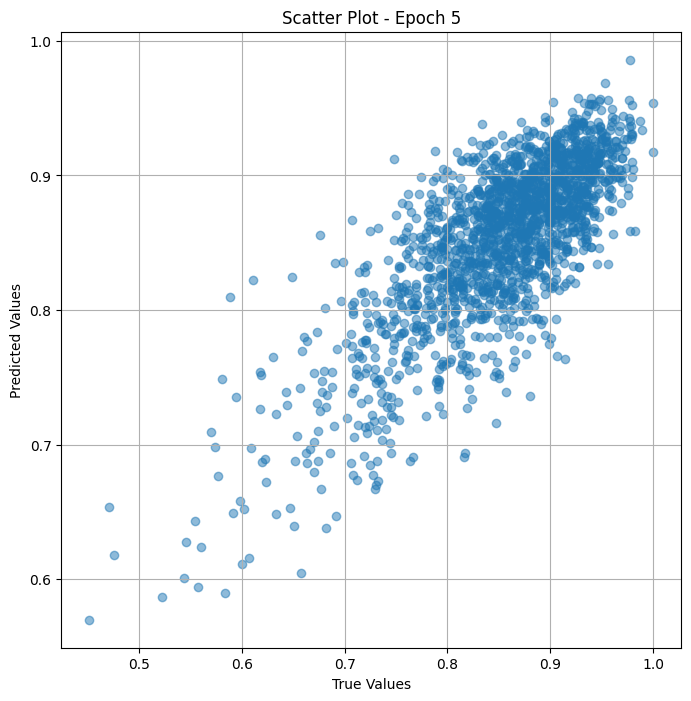

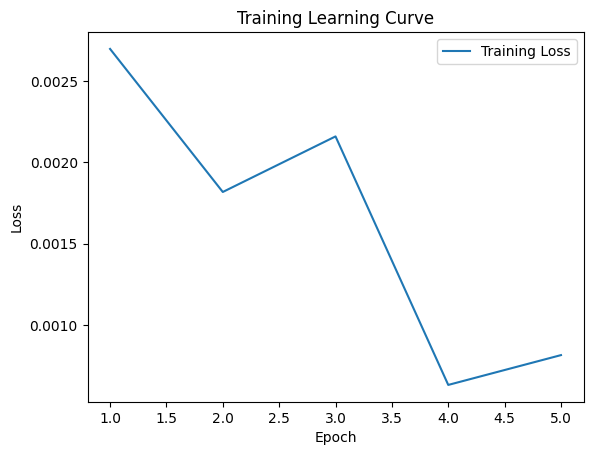


 Epoch: (6/30) Loss = 0.0006493339315056801

 Epoch: (6/30) Loss_rmse = 0.02548203244805336

 Epoch: (6/30) R^2 = 0.5614944696426392

 Epoch: (6/30) MAE = 0.02023937553167343
Spearman correlation coefficient: SignificanceResult(statistic=0.677740404423997, pvalue=2.612226449580097e-241)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.88

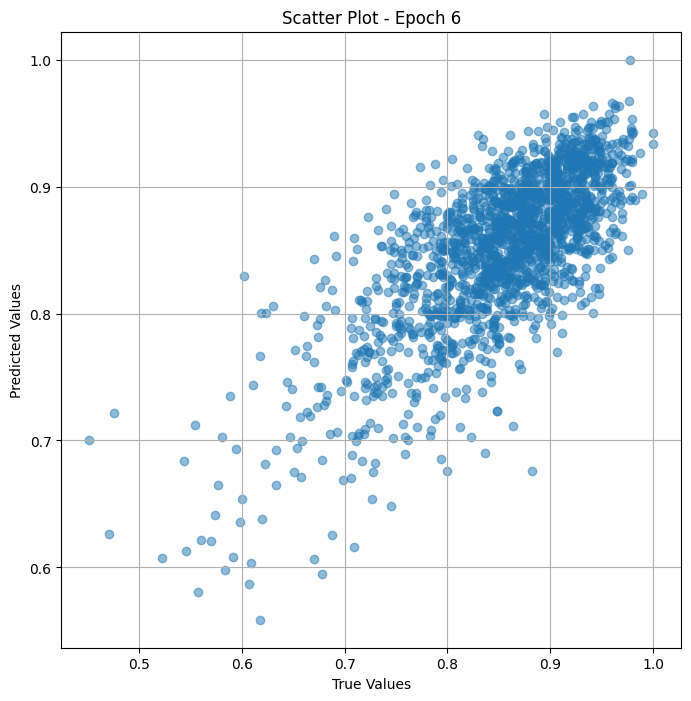

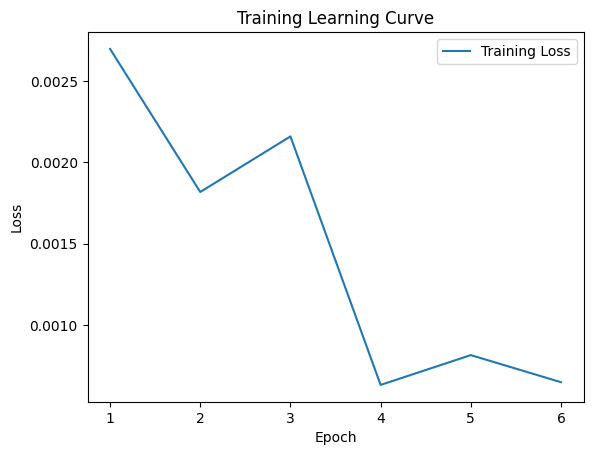

Epoch 0.06: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/30) Loss = 0.003122329944744706

 Epoch: (7/30) Loss_rmse = 0.05587781220674515

 Epoch: (7/30) R^2 = -1.1085588932037354

 Epoch: (7/30) MAE = 0.053784437477588654
Spearman correlation coefficient: SignificanceResult(statistic=0.71196116314548, pvalue=4.059732448224737e-277)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.82075

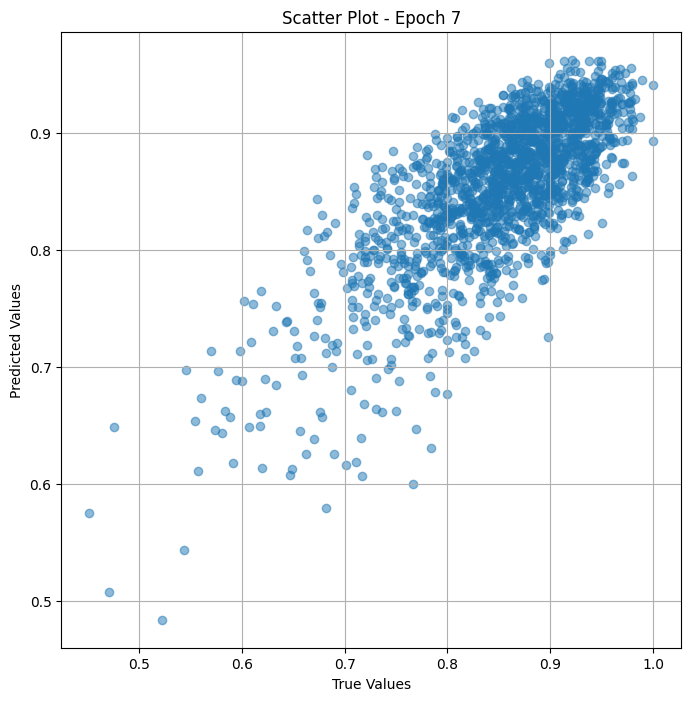

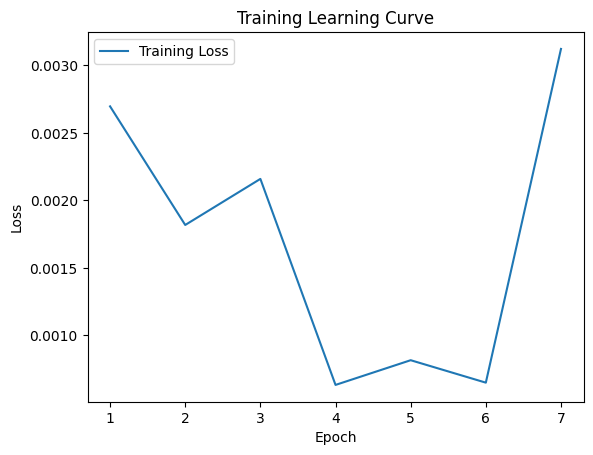


 Epoch: (8/30) Loss = 0.0002742326178122312

 Epoch: (8/30) Loss_rmse = 0.016559969633817673

 Epoch: (8/30) R^2 = 0.814806342124939

 Epoch: (8/30) MAE = 0.014096997678279877
Spearman correlation coefficient: SignificanceResult(statistic=0.8283804650400929, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611111,

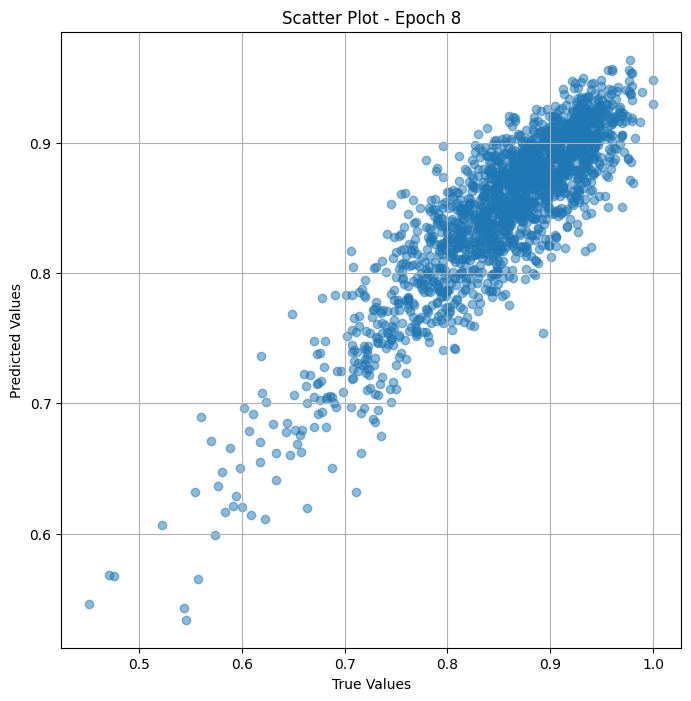

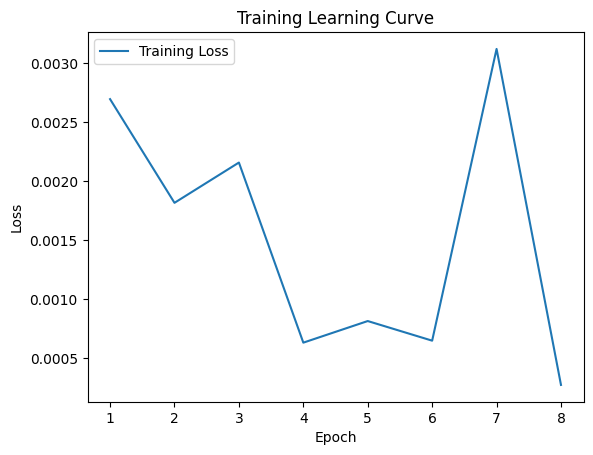


 Epoch: (9/30) Loss = 0.00024330668384209275

 Epoch: (9/30) Loss_rmse = 0.015598290599882603

 Epoch: (9/30) R^2 = 0.8356911540031433

 Epoch: (9/30) MAE = 0.013178758323192596
Spearman correlation coefficient: SignificanceResult(statistic=0.8932472011435504, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861111

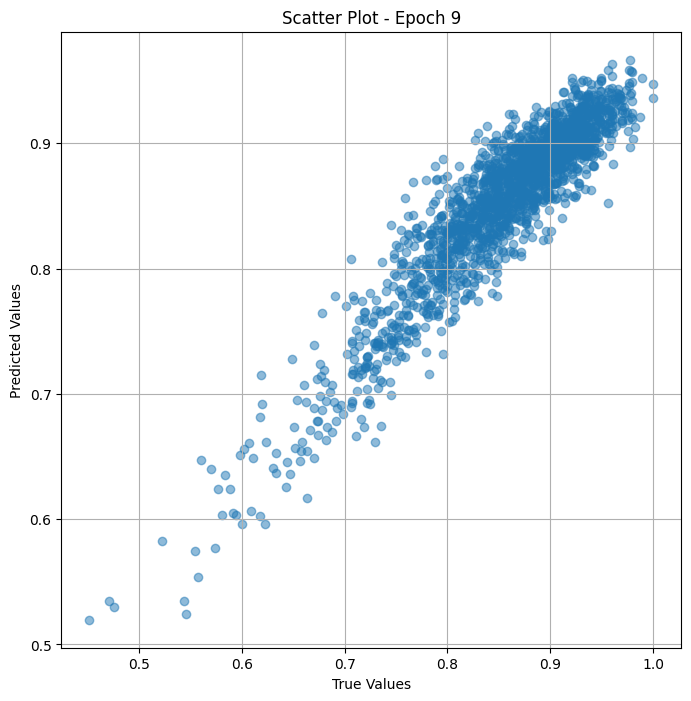

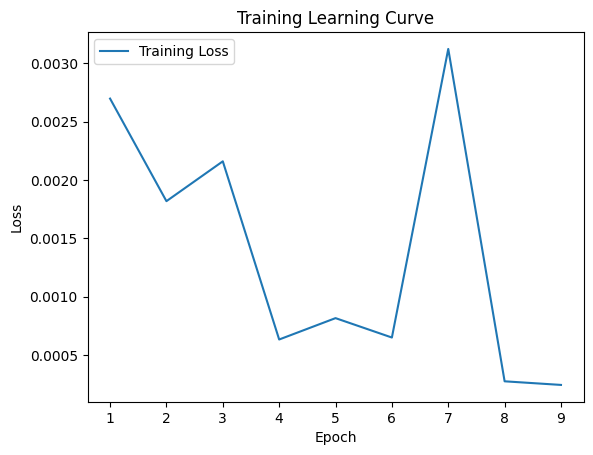


 Epoch: (10/30) Loss = 0.00017171038780361414

 Epoch: (10/30) Loss_rmse = 0.013103830628097057

 Epoch: (10/30) R^2 = 0.8840412497520447

 Epoch: (10/30) MAE = 0.01092473417520523
Spearman correlation coefficient: SignificanceResult(statistic=0.9075152195349327, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

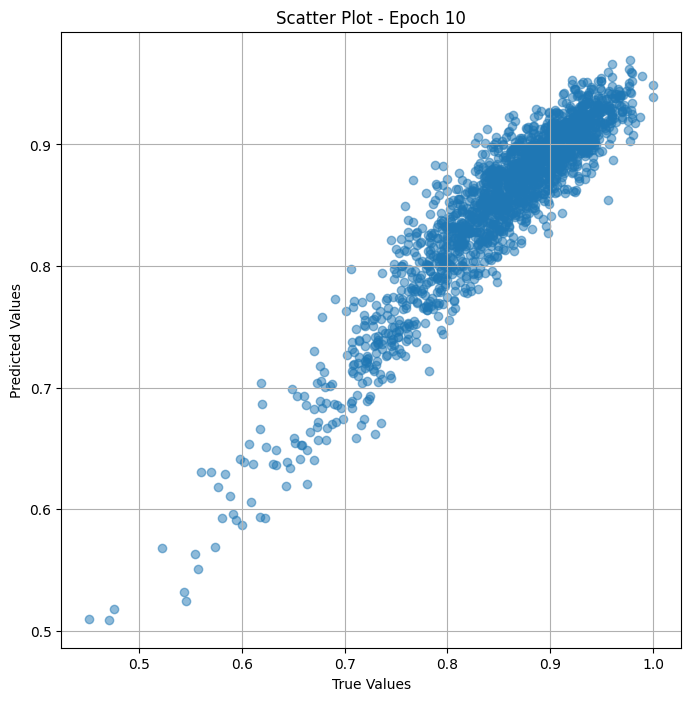

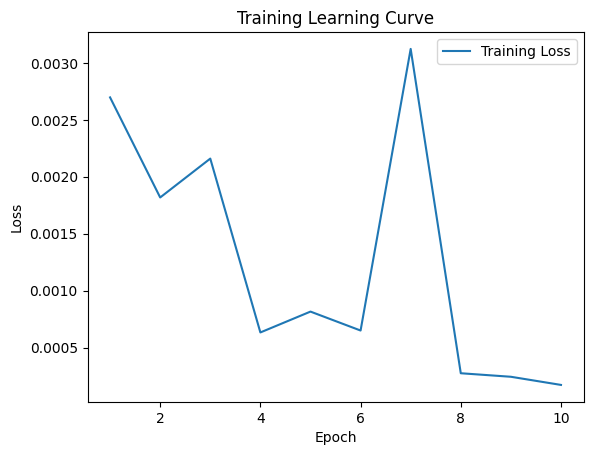


 Epoch: (11/30) Loss = 0.0001313419488724321

 Epoch: (11/30) Loss_rmse = 0.011460451409220695

 Epoch: (11/30) R^2 = 0.9113026857376099

 Epoch: (11/30) MAE = 0.0092085599899292
Spearman correlation coefficient: SignificanceResult(statistic=0.9185808946865363, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.86111

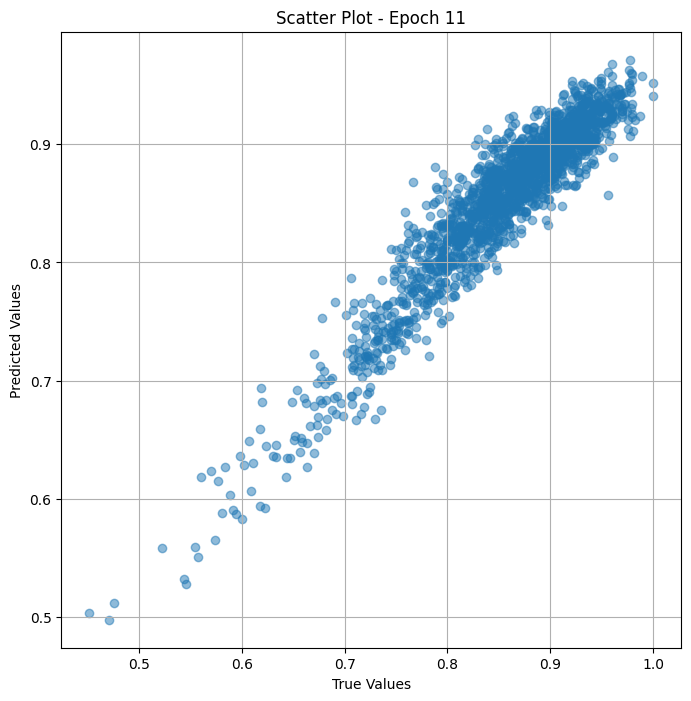

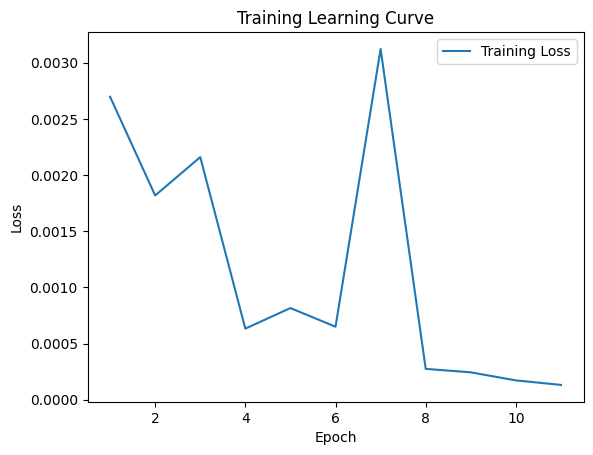


 Epoch: (12/30) Loss = 0.0001037634356180206

 Epoch: (12/30) Loss_rmse = 0.010186433792114258

 Epoch: (12/30) R^2 = 0.9299269318580627

 Epoch: (12/30) MAE = 0.007660411298274994
Spearman correlation coefficient: SignificanceResult(statistic=0.9278302576264745, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

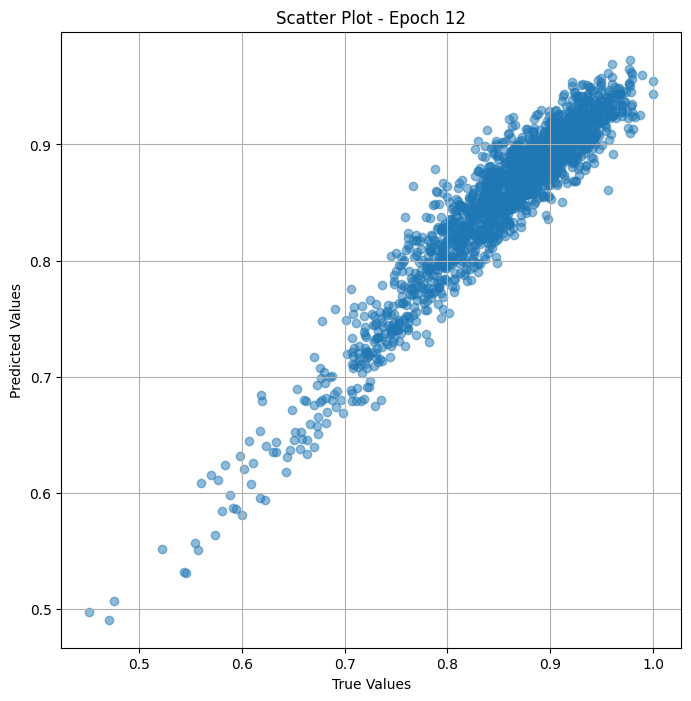

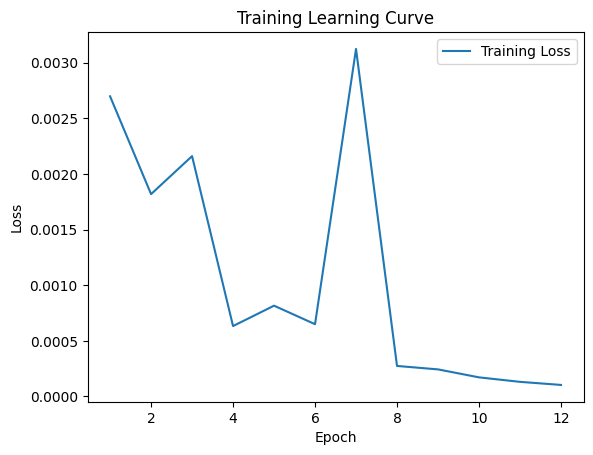


 Epoch: (13/30) Loss = 8.443791011814028e-05

 Epoch: (13/30) Loss_rmse = 0.009189010597765446

 Epoch: (13/30) R^2 = 0.9429777264595032

 Epoch: (13/30) MAE = 0.006347253918647766
Spearman correlation coefficient: SignificanceResult(statistic=0.936132747180622, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

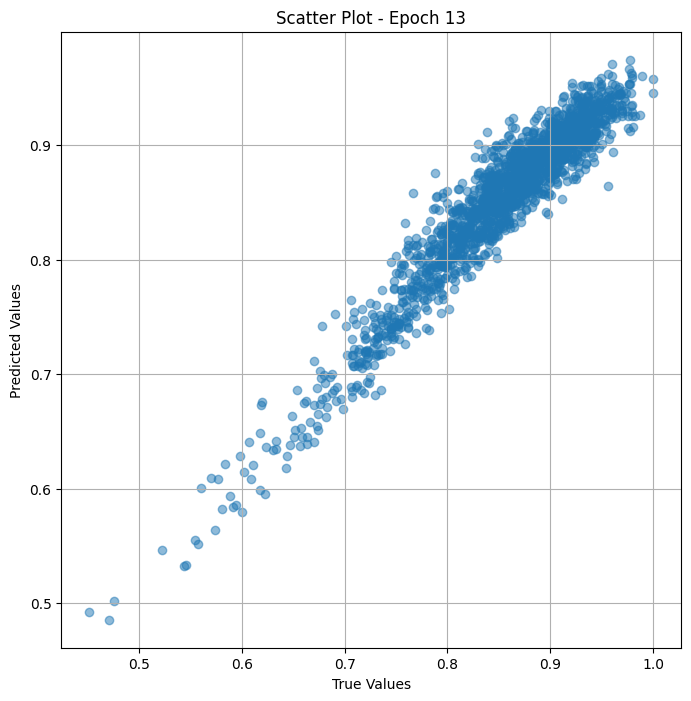

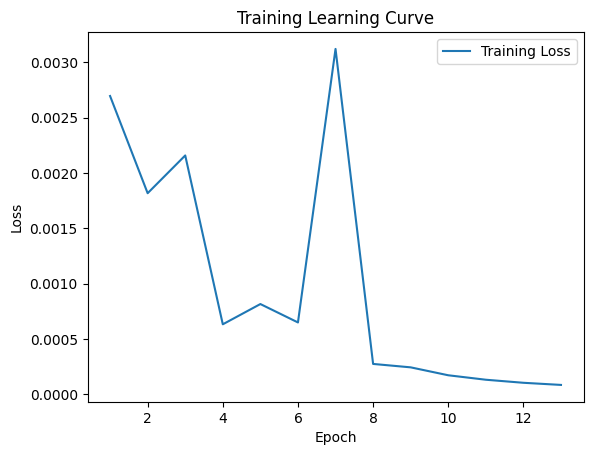


 Epoch: (14/30) Loss = 7.21710457582958e-05

 Epoch: (14/30) Loss_rmse = 0.00849535409361124

 Epoch: (14/30) R^2 = 0.9512617588043213

 Epoch: (14/30) MAE = 0.0057000890374183655
Spearman correlation coefficient: SignificanceResult(statistic=0.9436372345954848, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

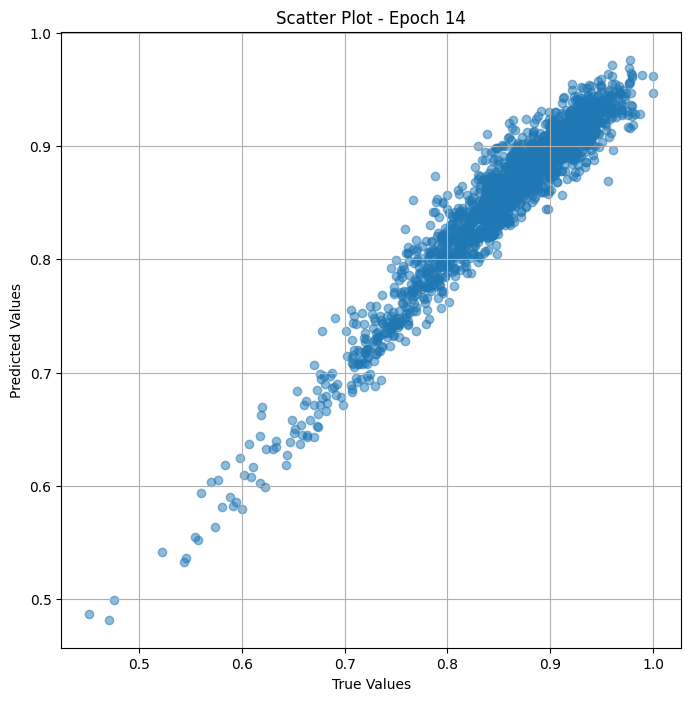

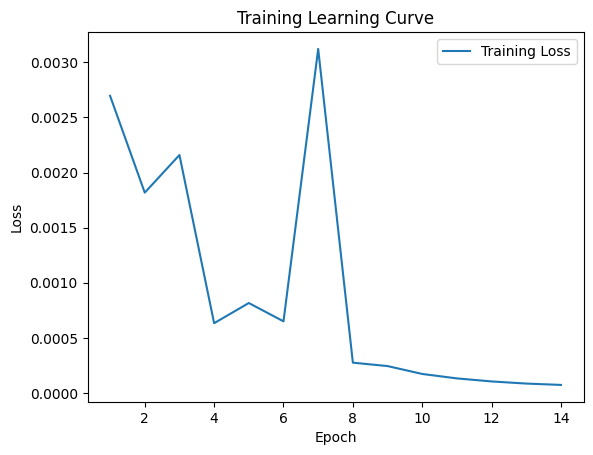


 Epoch: (15/30) Loss = 6.224036042112857e-05

 Epoch: (15/30) Loss_rmse = 0.00788925588130951

 Epoch: (15/30) R^2 = 0.9579681158065796

 Epoch: (15/30) MAE = 0.005119994282722473
Spearman correlation coefficient: SignificanceResult(statistic=0.9503998276261608, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

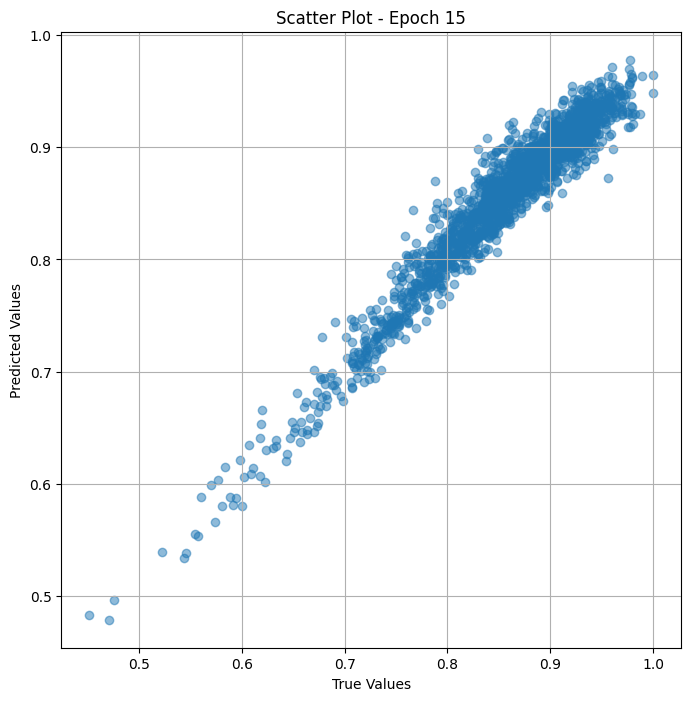

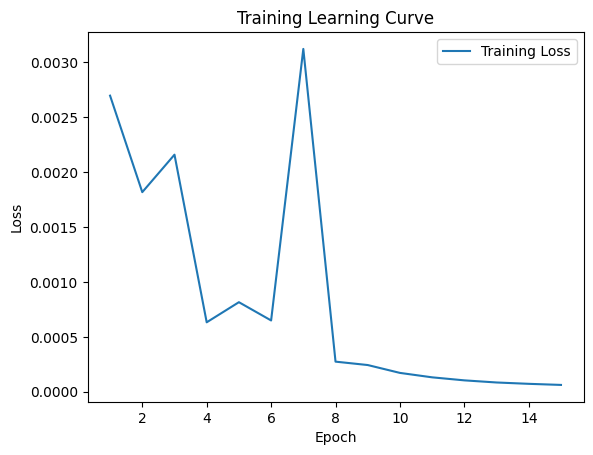


 Epoch: (16/30) Loss = 5.389938087319024e-05

 Epoch: (16/30) Loss_rmse = 0.007341619580984116

 Epoch: (16/30) R^2 = 0.9636008739471436

 Epoch: (16/30) MAE = 0.004617683589458466
Spearman correlation coefficient: SignificanceResult(statistic=0.9564111214416311, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

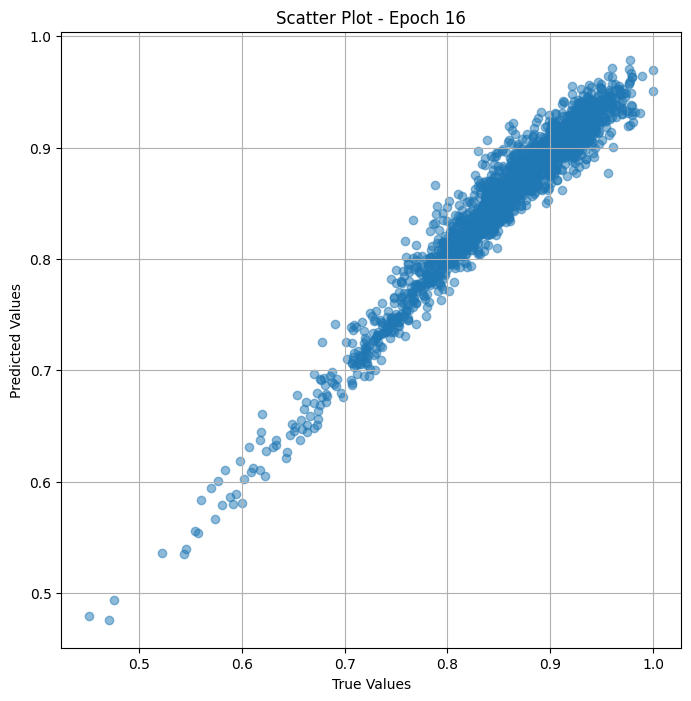

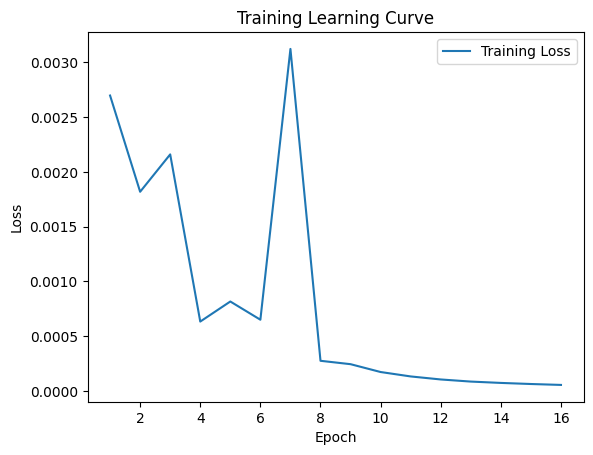


 Epoch: (17/30) Loss = 4.695067764259875e-05

 Epoch: (17/30) Loss_rmse = 0.006852056365460157

 Epoch: (17/30) R^2 = 0.9682934880256653

 Epoch: (17/30) MAE = 0.004220142960548401
Spearman correlation coefficient: SignificanceResult(statistic=0.961961782611796, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

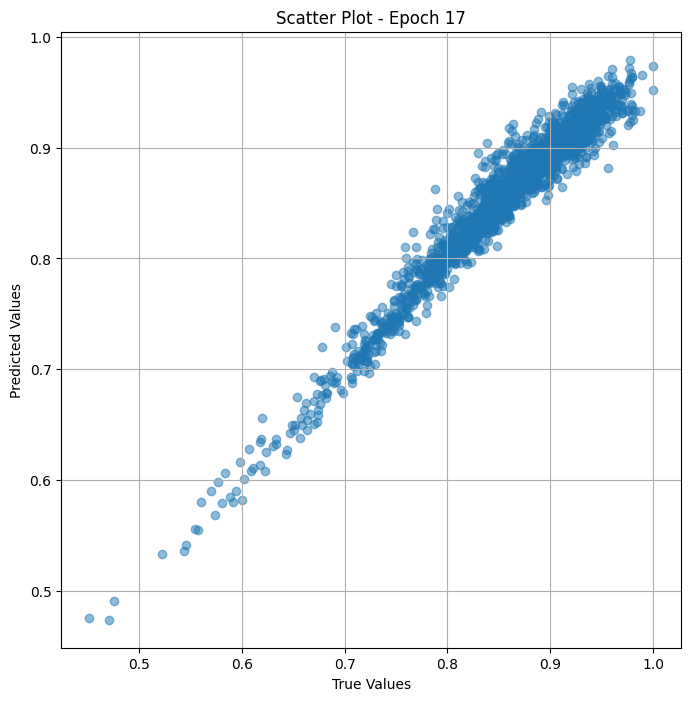

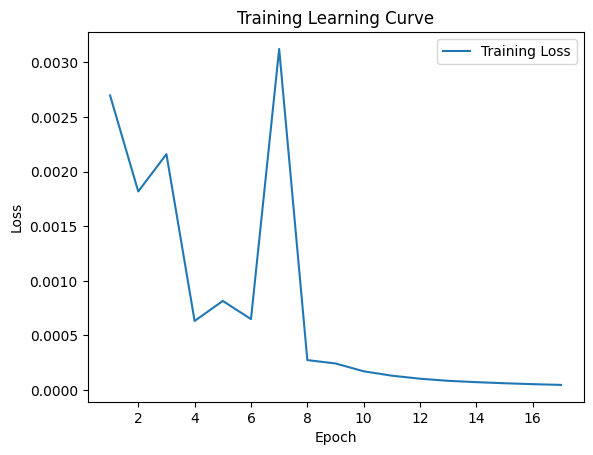


 Epoch: (18/30) Loss = 4.023667861474678e-05

 Epoch: (18/30) Loss_rmse = 0.006343238987028599

 Epoch: (18/30) R^2 = 0.9728275537490845

 Epoch: (18/30) MAE = 0.003917917609214783
Spearman correlation coefficient: SignificanceResult(statistic=0.9670382634292956, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

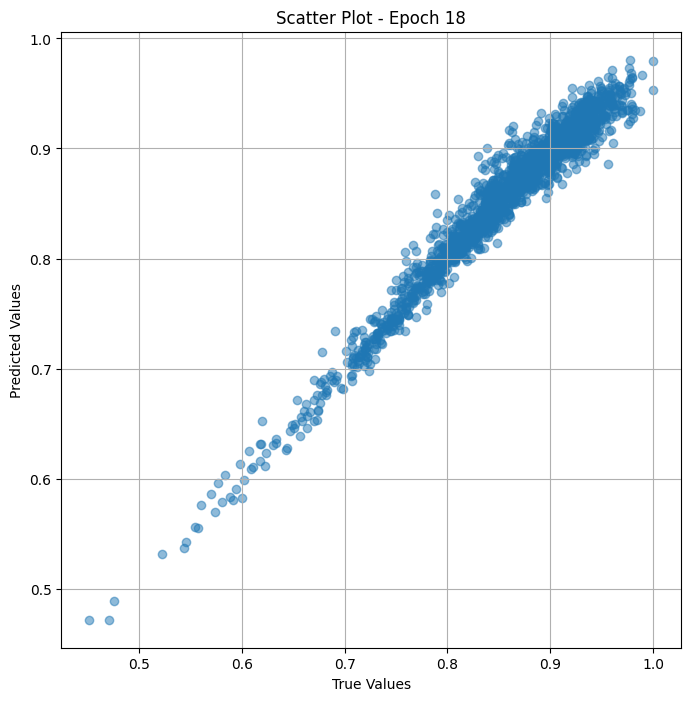

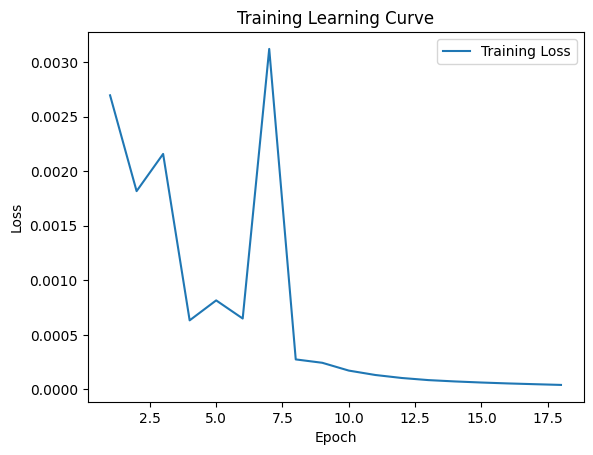


 Epoch: (19/30) Loss = 3.371019192854874e-05

 Epoch: (19/30) Loss_rmse = 0.005806047935038805

 Epoch: (19/30) R^2 = 0.977234959602356

 Epoch: (19/30) MAE = 0.003694966435432434
Spearman correlation coefficient: SignificanceResult(statistic=0.9714781350579137, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

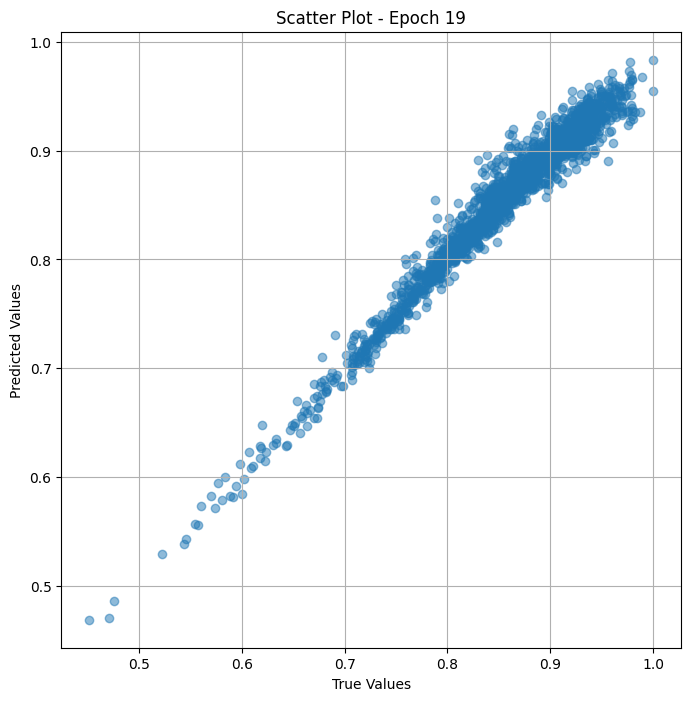

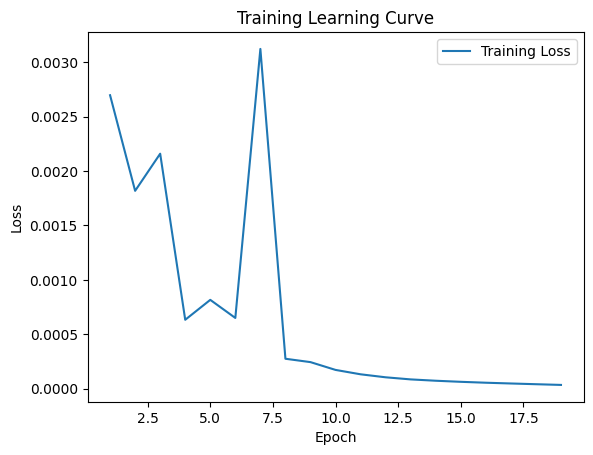


 Epoch: (20/30) Loss = 2.7322877940605395e-05

 Epoch: (20/30) Loss_rmse = 0.005227128975093365

 Epoch: (20/30) R^2 = 0.9815484285354614

 Epoch: (20/30) MAE = 0.0033692345023155212
Spearman correlation coefficient: SignificanceResult(statistic=0.9753084876557956, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

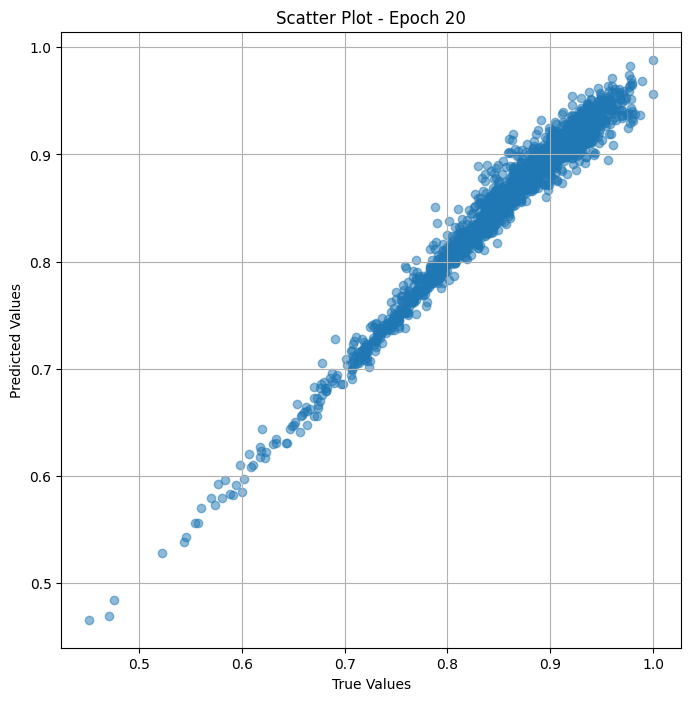

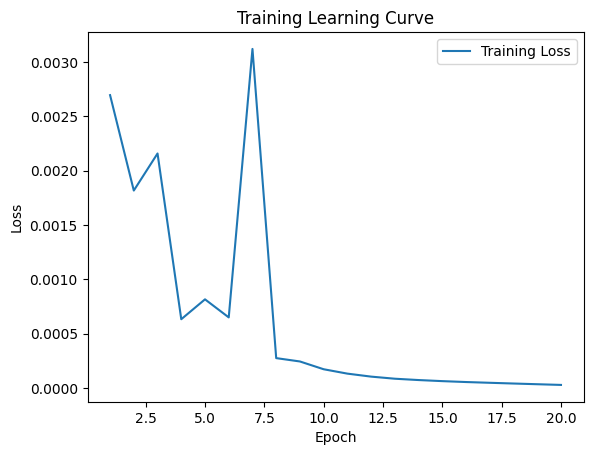


 Epoch: (21/30) Loss = 2.2803225874667987e-05

 Epoch: (21/30) Loss_rmse = 0.004775272216647863

 Epoch: (21/30) R^2 = 0.9846006035804749

 Epoch: (21/30) MAE = 0.0031791552901268005
Spearman correlation coefficient: SignificanceResult(statistic=0.9787169399928759, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

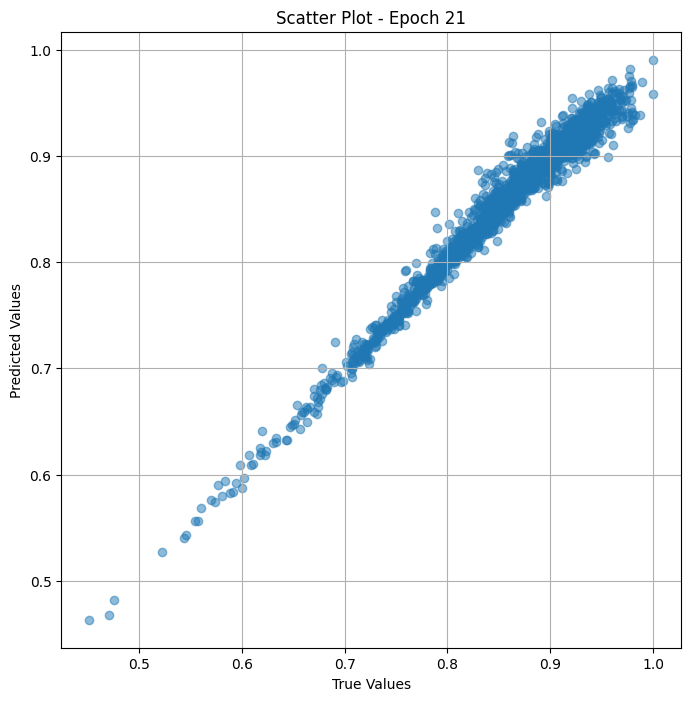

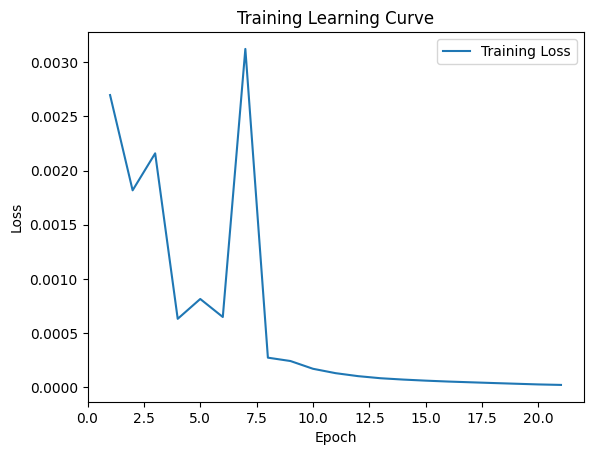


 Epoch: (22/30) Loss = 1.8194819858763367e-05

 Epoch: (22/30) Loss_rmse = 0.004265538416802883

 Epoch: (22/30) R^2 = 0.9877127408981323

 Epoch: (22/30) MAE = 0.00290052592754364
Spearman correlation coefficient: SignificanceResult(statistic=0.9818294958733753, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

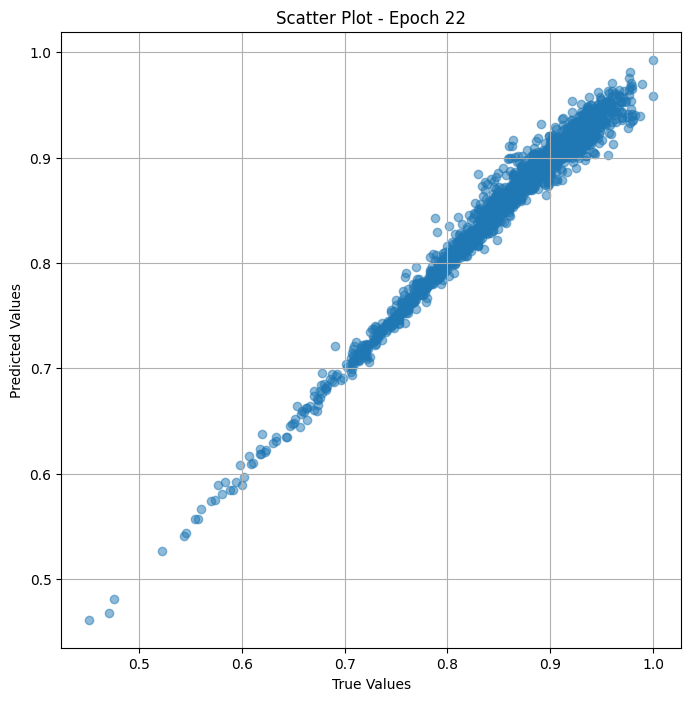

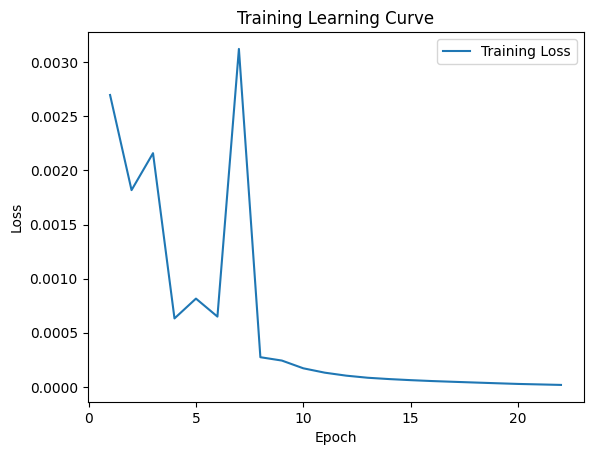


 Epoch: (23/30) Loss = 1.4782252947043162e-05

 Epoch: (23/30) Loss_rmse = 0.003844769671559334

 Epoch: (23/30) R^2 = 0.990017294883728

 Epoch: (23/30) MAE = 0.002707667648792267
Spearman correlation coefficient: SignificanceResult(statistic=0.9844762162537524, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

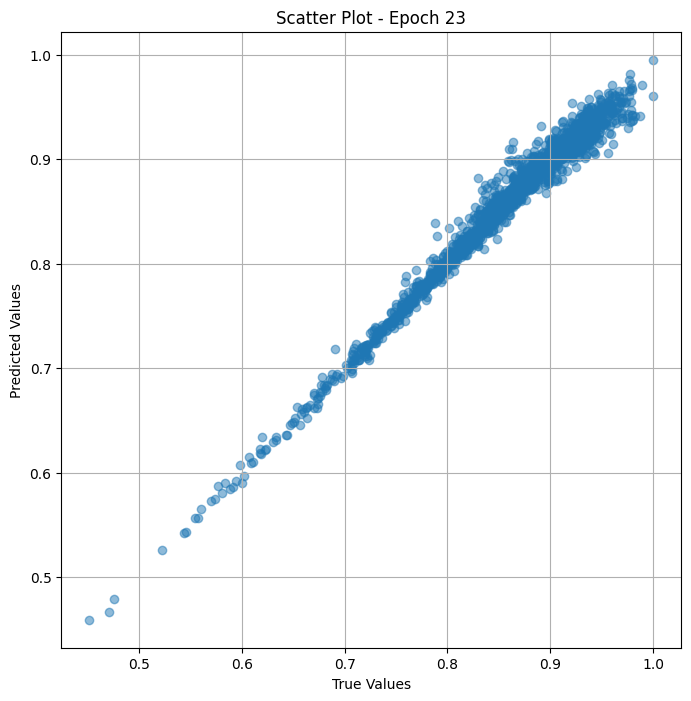

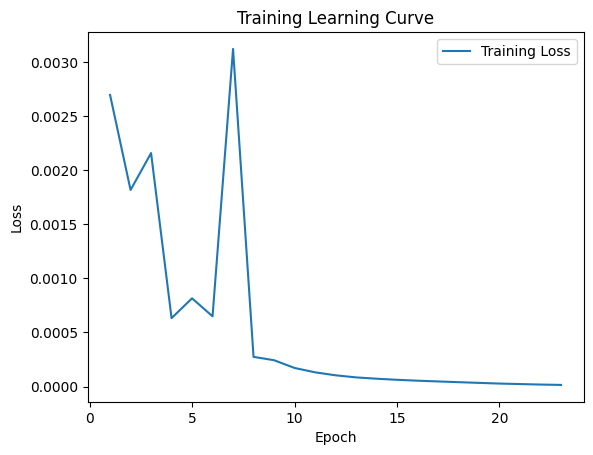


 Epoch: (24/30) Loss = 1.1313383765809704e-05

 Epoch: (24/30) Loss_rmse = 0.0033635373692959547

 Epoch: (24/30) R^2 = 0.9923598766326904

 Epoch: (24/30) MAE = 0.0023299306631088257
Spearman correlation coefficient: SignificanceResult(statistic=0.9867922599652086, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.

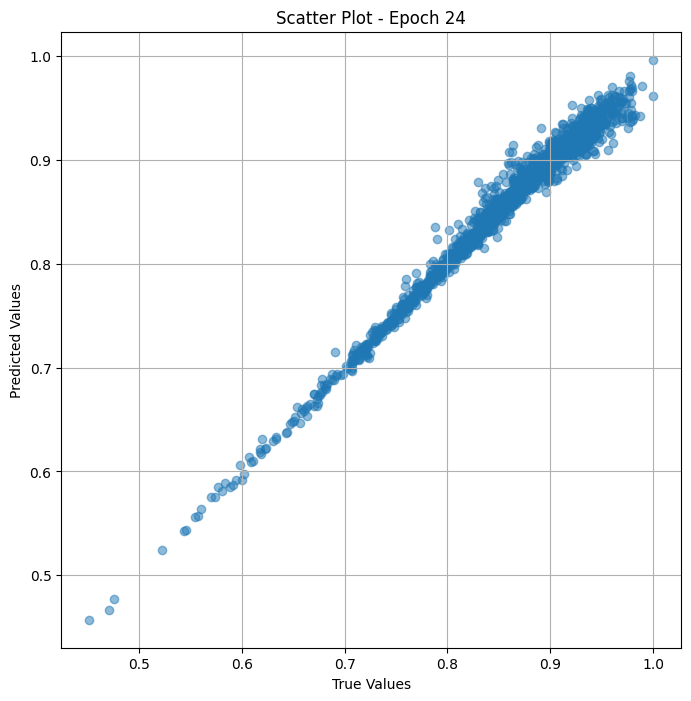

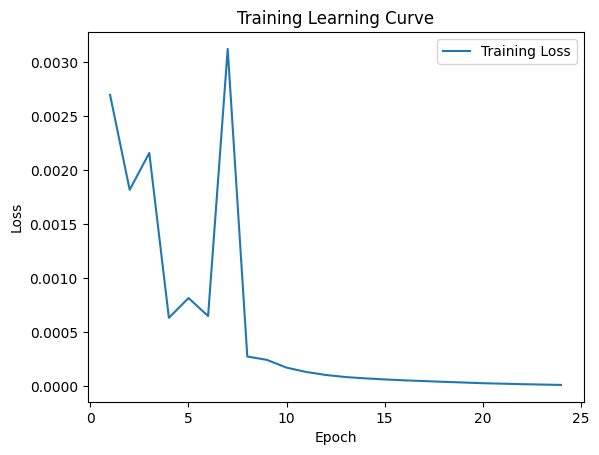


 Epoch: (25/30) Loss = 8.75417117640609e-06

 Epoch: (25/30) Loss_rmse = 0.002958744764328003

 Epoch: (25/30) R^2 = 0.9940881729125977

 Epoch: (25/30) MAE = 0.002008102834224701
Spearman correlation coefficient: SignificanceResult(statistic=0.9888014974498766, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

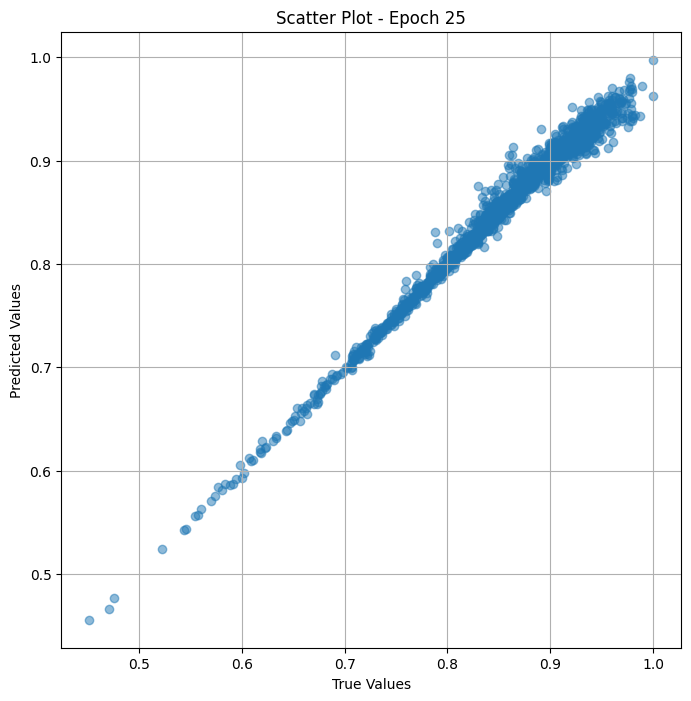

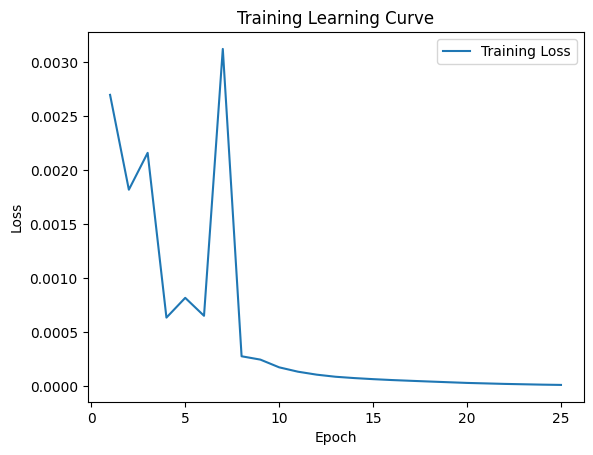


 Epoch: (26/30) Loss = 6.80720995660522e-06

 Epoch: (26/30) Loss_rmse = 0.0026090629398822784

 Epoch: (26/30) R^2 = 0.995402991771698

 Epoch: (26/30) MAE = 0.0017669051885604858
Spearman correlation coefficient: SignificanceResult(statistic=0.9905337902070878, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

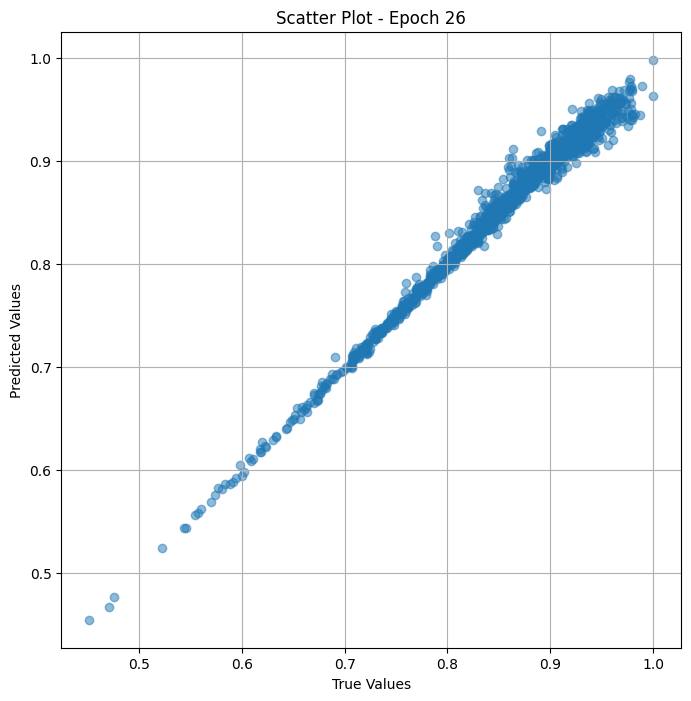

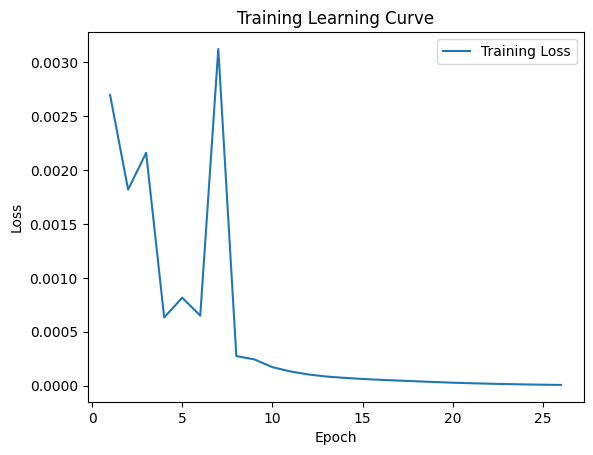


 Epoch: (27/30) Loss = 5.269620942272013e-06

 Epoch: (27/30) Loss_rmse = 0.0022955655585974455

 Epoch: (27/30) R^2 = 0.9964413642883301

 Epoch: (27/30) MAE = 0.0014745146036148071
Spearman correlation coefficient: SignificanceResult(statistic=0.9920216574920796, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

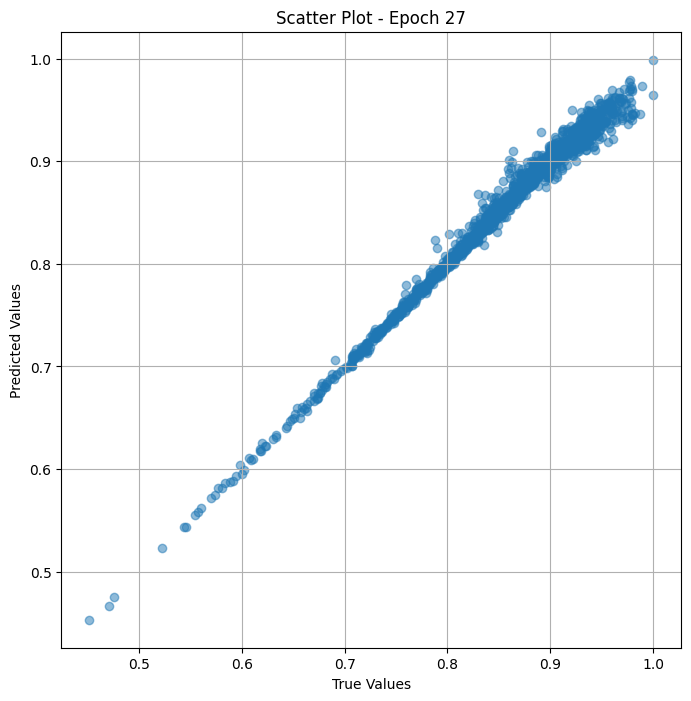

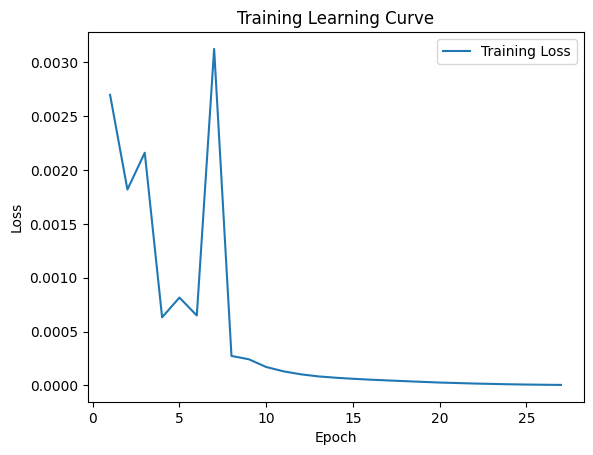


 Epoch: (28/30) Loss = 4.0804443415254354e-06

 Epoch: (28/30) Loss_rmse = 0.002020010957494378

 Epoch: (28/30) R^2 = 0.9972444176673889

 Epoch: (28/30) MAE = 0.0012790262699127197
Spearman correlation coefficient: SignificanceResult(statistic=0.9932931450341331, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

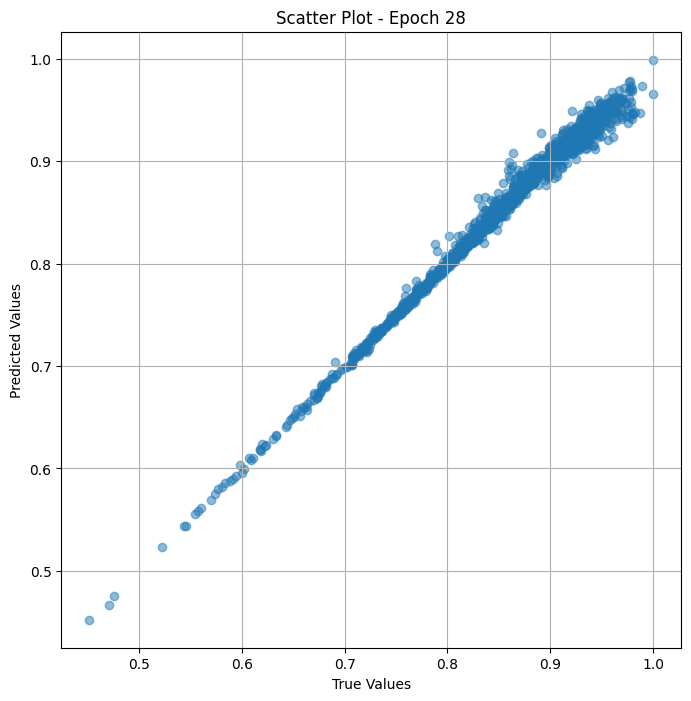

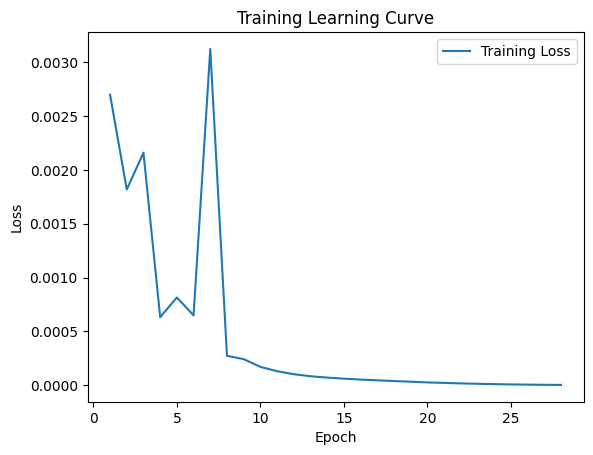


 Epoch: (29/30) Loss = 2.9200982680777088e-06

 Epoch: (29/30) Loss_rmse = 0.0017088295426219702

 Epoch: (29/30) R^2 = 0.998028039932251

 Epoch: (29/30) MAE = 0.0009882375597953796
Spearman correlation coefficient: SignificanceResult(statistic=0.9943911396616646, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

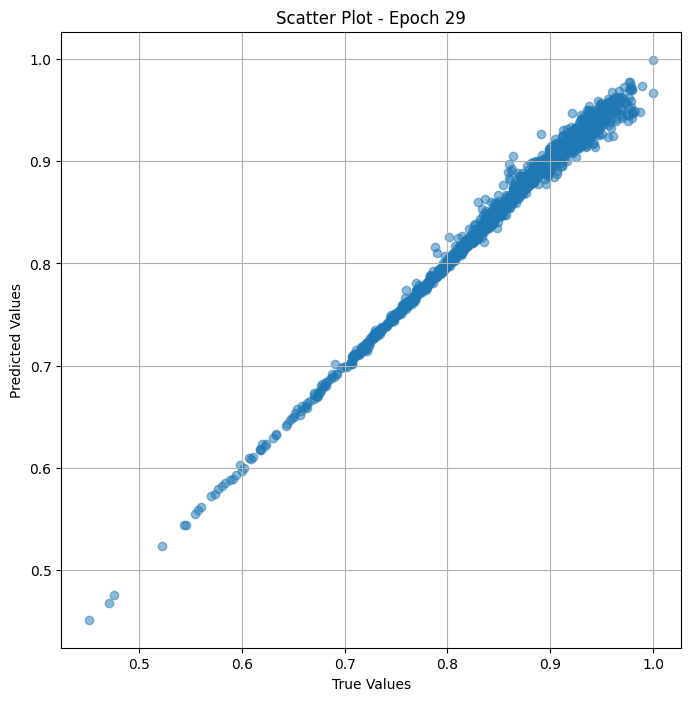

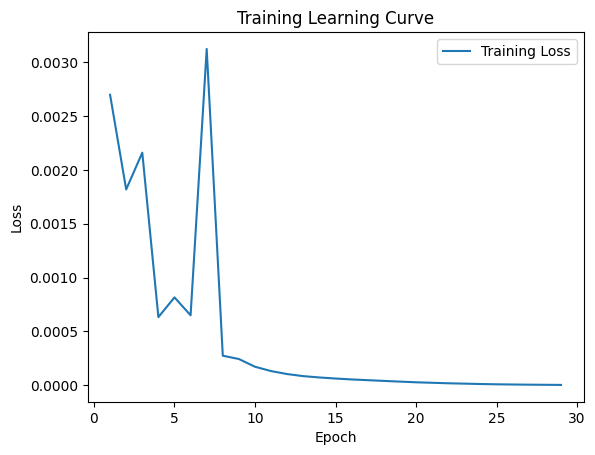


 Epoch: (30/30) Loss = 2.4071530333458213e-06

 Epoch: (30/30) Loss_rmse = 0.0015515002887696028

 Epoch: (30/30) R^2 = 0.9983744025230408

 Epoch: (30/30) MAE = 0.0009357556700706482
Spearman correlation coefficient: SignificanceResult(statistic=0.995324908974944, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

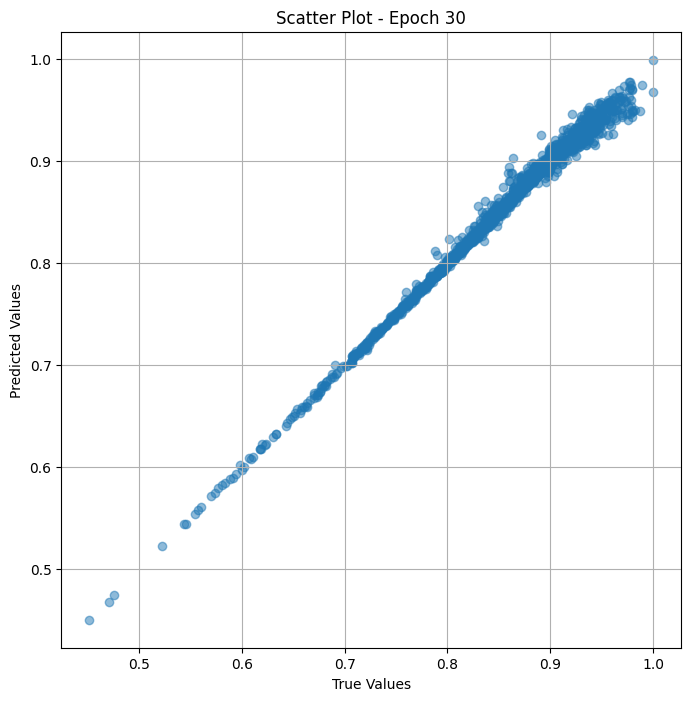

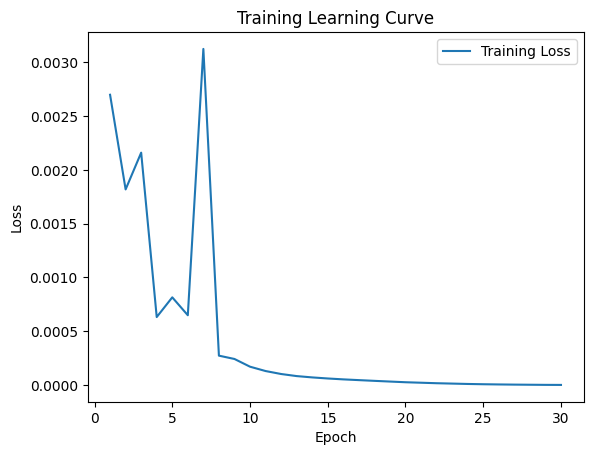

In [ ]:
# Training the model and save weights
fit(30, model_vit , train_dl)
torch.save(model_vit.state_dict(), "model_weights_sport")

In [ ]:
true_values_list = []
predicted_values_list = []

for x_trans, yb in train_dl:
    preds = model_vit(x_trans)
    true_values_list.extend(yb.cpu().detach().numpy())
    predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_food' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_train_food['preprocessed_image_path'],
    'True Value': true_values_list,  # Replace with your actual true values
    'Predicted Value': predicted_values_list  # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)



                                          Image Path  True Value  \
0     /content/food/n07849336_22546_preprocessed.jpg    0.730000   
1      /content/food/n07880968_4309_preprocessed.jpg    0.863636   
2        /content/food/000000293810_preprocessed.jpg    0.857143   
3     /content/food/n07849336_20238_preprocessed.jpg    0.770115   
4      /content/food/n07717556_3057_preprocessed.jpg    0.941176   
...                                              ...         ...   
1795     /content/food/000000541635_preprocessed.jpg    0.923077   
1796  /content/food/n07574602_26891_preprocessed.jpg    0.932039   
1797  /content/food/n07933274_33970_preprocessed.jpg    0.910891   
1798   /content/food/n07911677_1332_preprocessed.jpg    0.841121   
1799   /content/food/n07693725_2676_preprocessed.jpg    0.896907   

      Predicted Value  
0            0.733113  
1            0.870621  
2            0.863961  
3            0.769696  
4            0.940109  
...               ...  
1795         0.

In [ ]:
from prettytable import PrettyTable

# Assuming 'df_result' is your DataFrame
# The 'Image Path' column should contain the paths to your images

# Create a PrettyTable instance
table = PrettyTable()

# Add column names
table.field_names = df_result.columns.tolist()

# Add rows
for _, row in df_result.iterrows():
    table.add_row(row.tolist())

# Display the table
print(table)

+------------------------------------------------+------------+---------------------+
|                   Image Path                   | True Value |   Predicted Value   |
+------------------------------------------------+------------+---------------------+
| /content/food/n07849336_22546_preprocessed.jpg |    0.73    |  0.7331126928329468 |
| /content/food/n07880968_4309_preprocessed.jpg  | 0.8636364  |  0.8706209659576416 |
|  /content/food/000000293810_preprocessed.jpg   | 0.85714287 |  0.8639612793922424 |
| /content/food/n07849336_20238_preprocessed.jpg | 0.77011496 |  0.7696957588195801 |
| /content/food/n07717556_3057_preprocessed.jpg  | 0.9411765  |  0.9401090145111084 |
|  /content/food/000000086725_preprocessed.jpg   | 0.8817204  |  0.8833128809928894 |
| /content/food/n07806221_23757_preprocessed.jpg | 0.6770833  |  0.6788020730018616 |
| /content/food/n07863374_16116_preprocessed.jpg | 0.8235294  |  0.8240806460380554 |
| /content/food/n07880968_4731_preprocessed.jpg  | 0.7

## Valid

In [ ]:
class Dataset_val_food(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_val_food["memoscore"]
        self.images = df_val_food["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
val_ds = Dataset_val_food(df_val_food, trans_transform=trans_transform)
val_dl = DataLoader(val_ds, batch_size=32, shuffle=False)

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
class ViTMem_model_val_food(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_sval =  ViTMem_model_val_food( arch="vit_base_patch16_224_miil")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_val_food().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
val_dl = DeviceDataLoader(val_dl, device)
model_vit_sval  = to_device(model_vit_sval  , device)

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.014420751482248306

 Epoch: (1/30) Loss_rmse = 0.1200864315032959

 Epoch: (1/30) R^2 = -5.334475517272949

 Epoch: (1/30) MAE = 0.10972583293914795
Spearman correlation coefficient: SignificanceResult(statistic=-0.1248957168283586, pvalue=0.22534136333298818)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.87

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


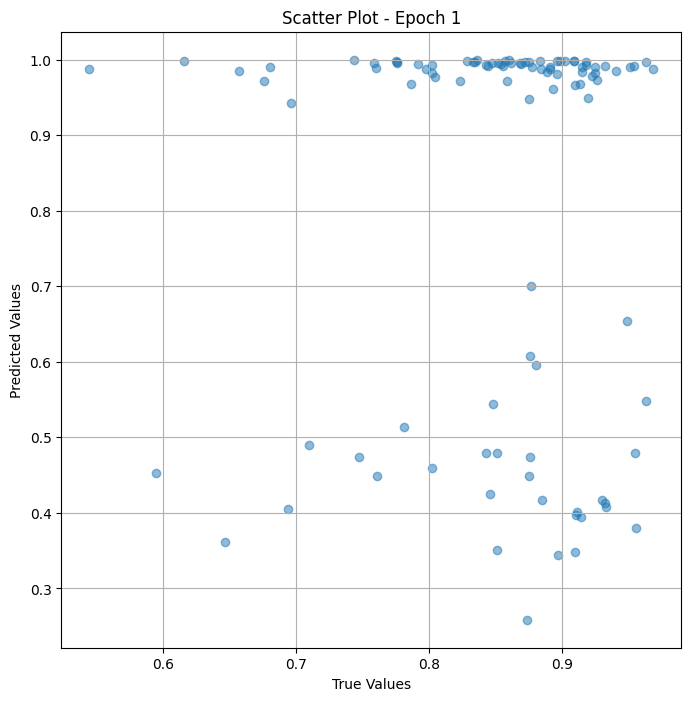

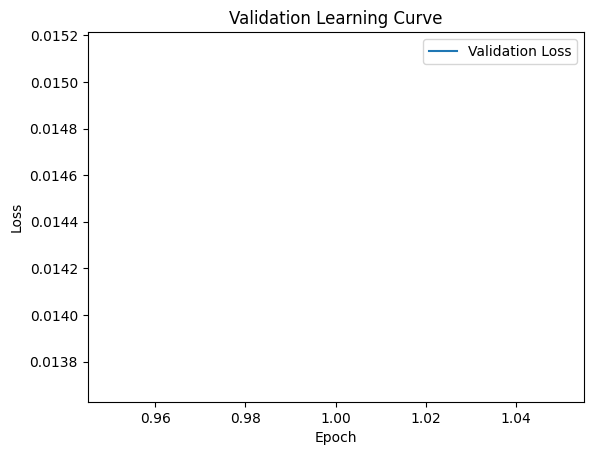


 Epoch: (2/30) Loss = 0.013984821736812592

 Epoch: (2/30) Loss_rmse = 0.11825744062662125

 Epoch: (2/30) R^2 = -5.142988204956055

 Epoch: (2/30) MAE = 0.10768838226795197
Spearman correlation coefficient: SignificanceResult(statistic=-0.2163503115950321, pvalue=0.034245674501380344)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.

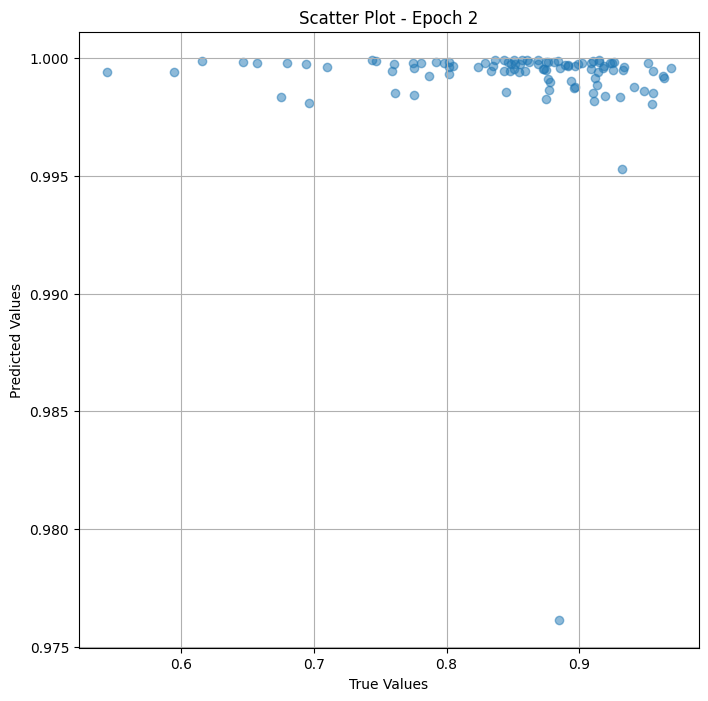

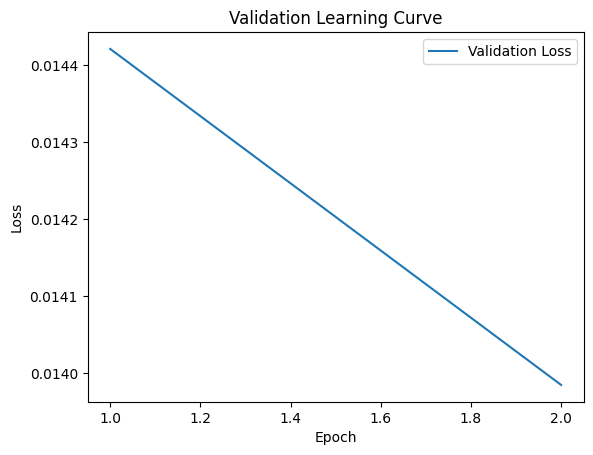


 Epoch: (3/30) Loss = 0.012371167540550232

 Epoch: (3/30) Loss_rmse = 0.11122575402259827

 Epoch: (3/30) R^2 = -4.434172630310059

 Epoch: (3/30) MAE = 0.09576895833015442
Spearman correlation coefficient: SignificanceResult(statistic=-0.21199655446846224, pvalue=0.03812061562283909)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.

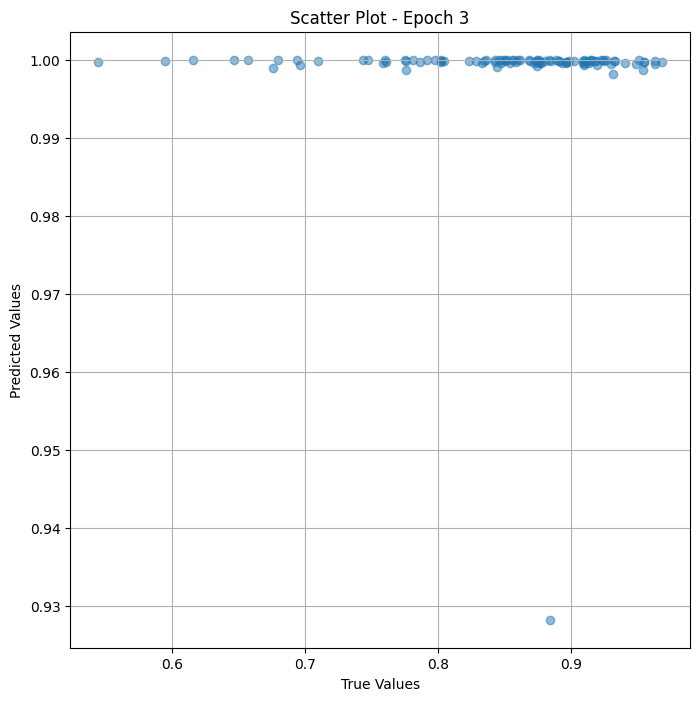

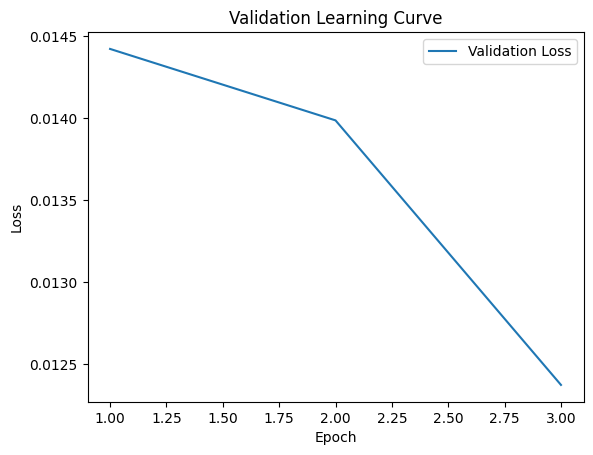


 Epoch: (4/30) Loss = 0.012536494061350822

 Epoch: (4/30) Loss_rmse = 0.11196648329496384

 Epoch: (4/30) R^2 = -4.506794452667236

 Epoch: (4/30) MAE = 0.09754857420921326
Spearman correlation coefficient: SignificanceResult(statistic=-0.16745798125999792, pvalue=0.10293440107537853)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.

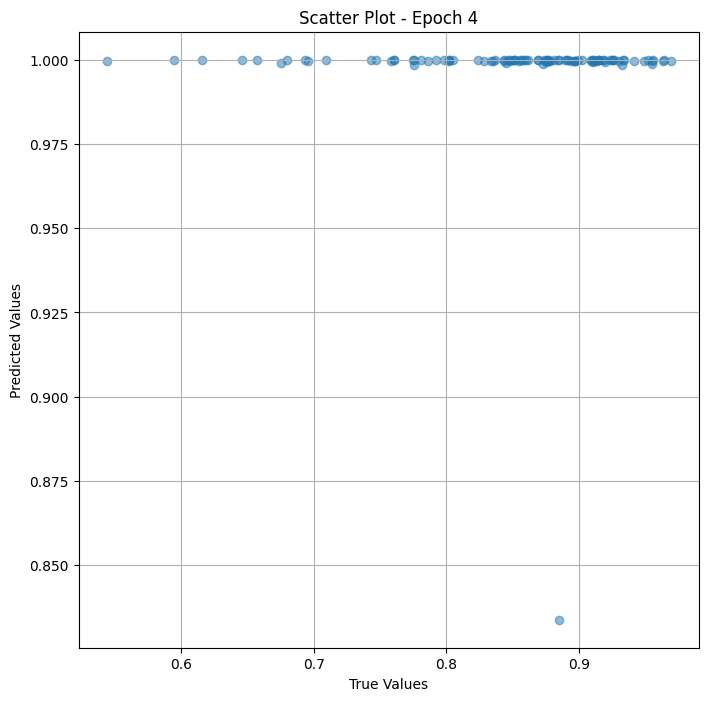

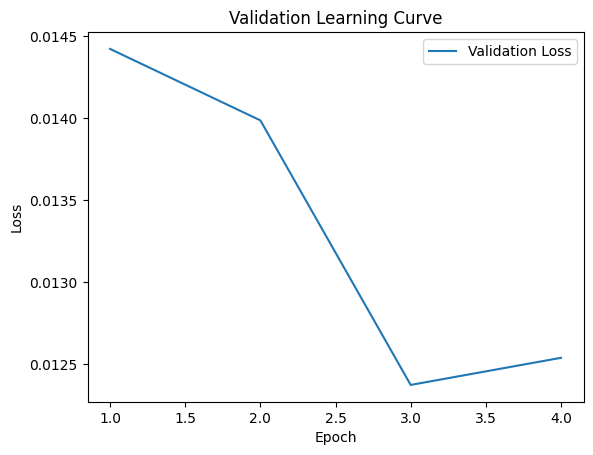


 Epoch: (5/30) Loss = 0.01189226284623146

 Epoch: (5/30) Loss_rmse = 0.1090516522526741

 Epoch: (5/30) R^2 = -4.223808765411377

 Epoch: (5/30) MAE = 0.08536840975284576
Spearman correlation coefficient: SignificanceResult(statistic=-0.13561322359400538, pvalue=0.1876971315500173)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.875

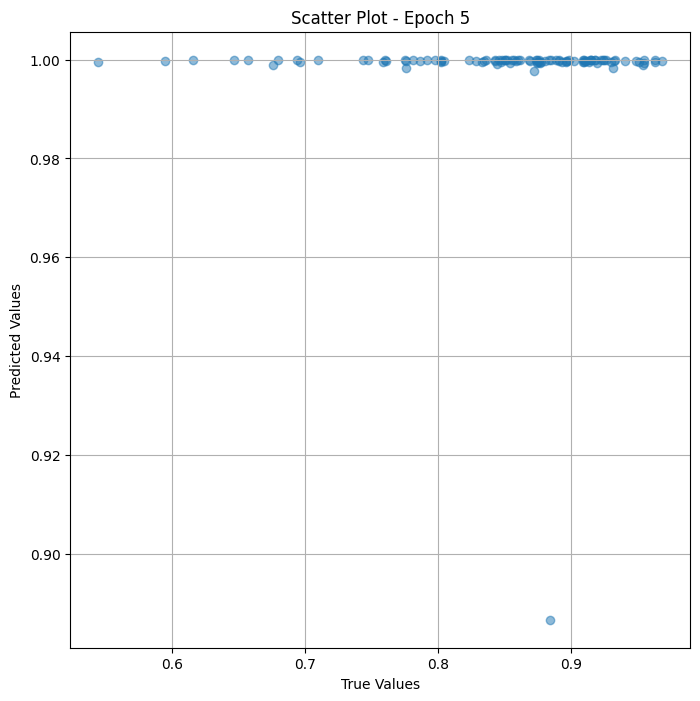

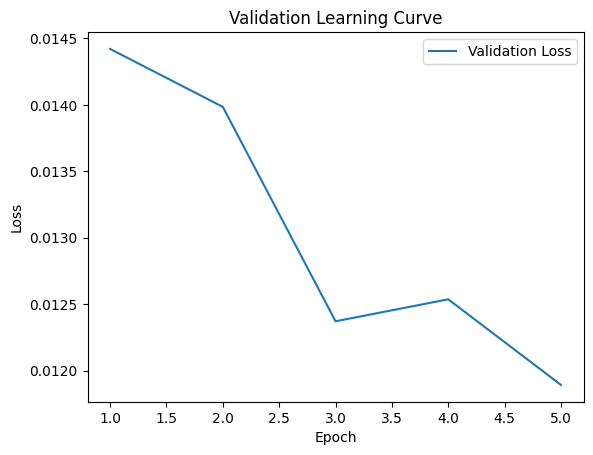


 Epoch: (6/30) Loss = 0.012042706832289696

 Epoch: (6/30) Loss_rmse = 0.1097392663359642

 Epoch: (6/30) R^2 = -4.289892673492432

 Epoch: (6/30) MAE = 0.09108561277389526
Spearman correlation coefficient: SignificanceResult(statistic=-0.10481639245823555, pvalue=0.3094691700345763)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.87

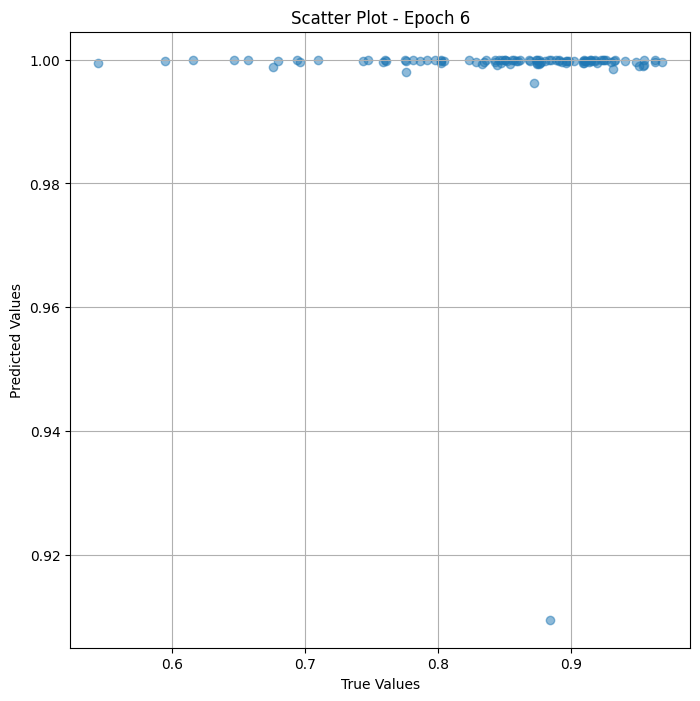

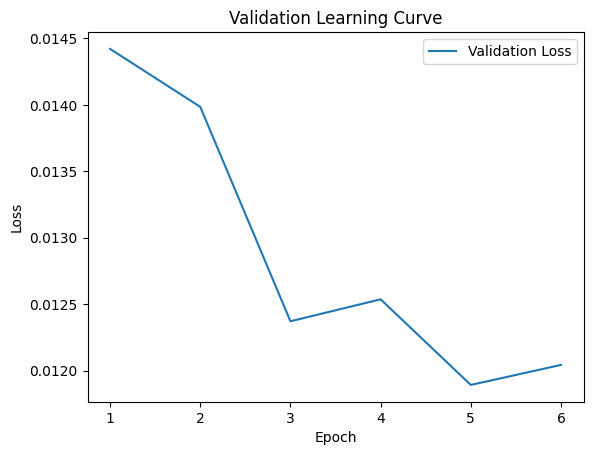


 Epoch: (7/30) Loss = 0.011898310855031013

 Epoch: (7/30) Loss_rmse = 0.10907937586307526

 Epoch: (7/30) R^2 = -4.226465225219727

 Epoch: (7/30) MAE = 0.08728055655956268
Spearman correlation coefficient: SignificanceResult(statistic=-0.05428154783194057, pvalue=0.5993962445909566)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.8

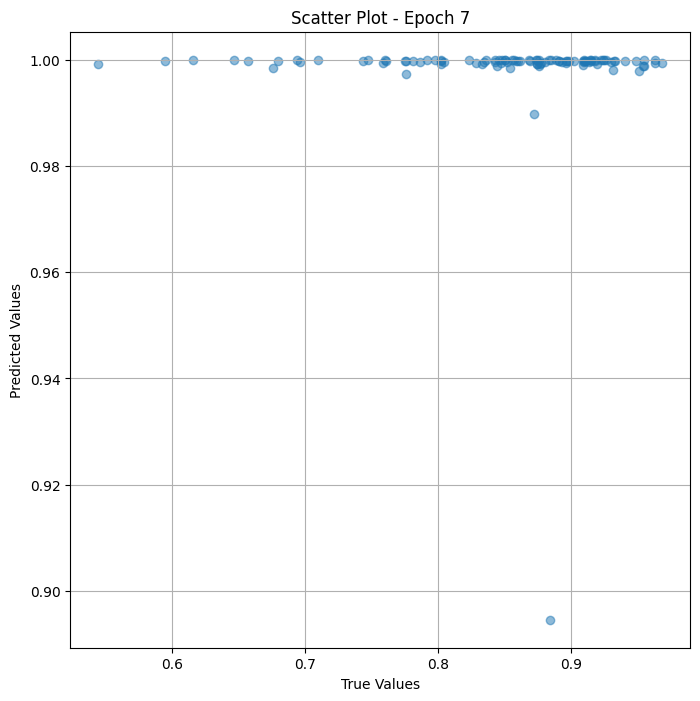

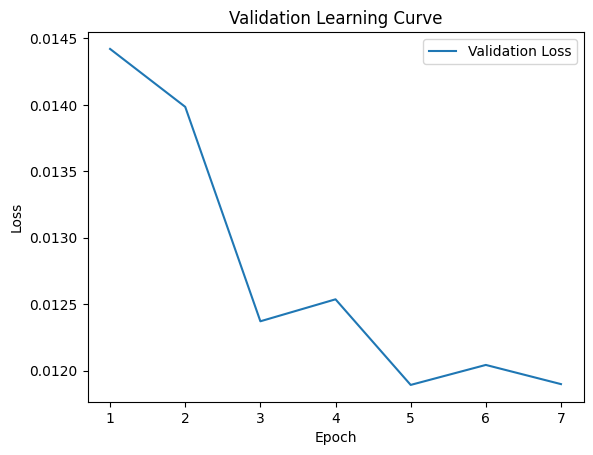

Epoch 0.11: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (8/30) Loss = 0.011981762014329433

 Epoch: (8/30) Loss_rmse = 0.1094612330198288

 Epoch: (8/30) R^2 = -4.263122081756592

 Epoch: (8/30) MAE = 0.09065055847167969
Spearman correlation coefficient: SignificanceResult(statistic=-0.0008207006482150206, pvalue=0.9936681697591006)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167

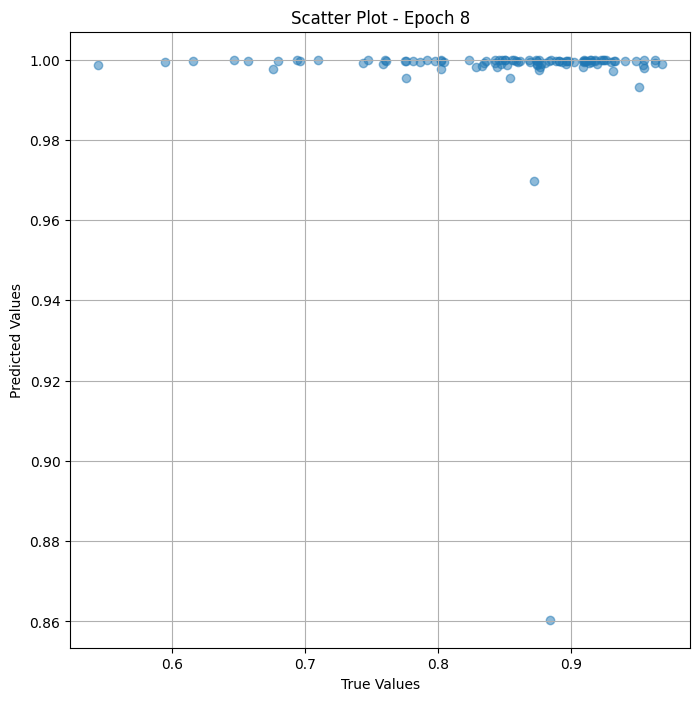

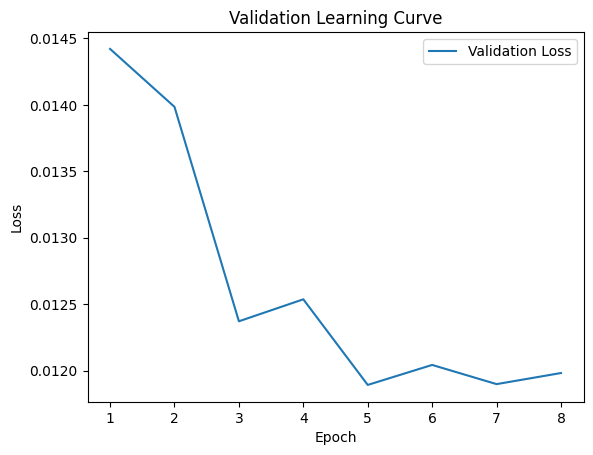


 Epoch: (9/30) Loss = 0.01192084513604641

 Epoch: (9/30) Loss_rmse = 0.10918262600898743

 Epoch: (9/30) R^2 = -4.236363887786865

 Epoch: (9/30) MAE = 0.08971245586872101
Spearman correlation coefficient: SignificanceResult(statistic=0.08044222882504251, pvalue=0.4359156266716574)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.875

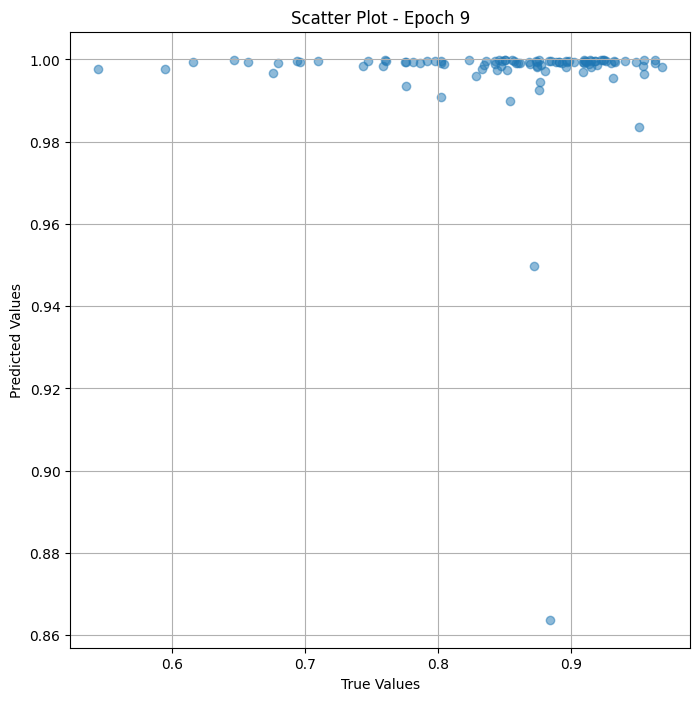

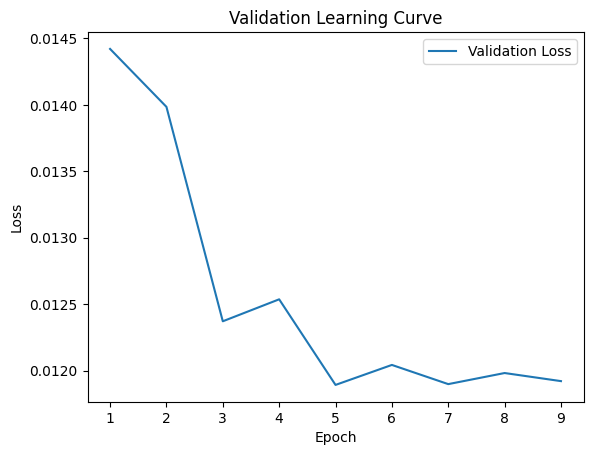


 Epoch: (10/30) Loss = 0.011897038668394089

 Epoch: (10/30) Loss_rmse = 0.10907354950904846

 Epoch: (10/30) R^2 = -4.2259063720703125

 Epoch: (10/30) MAE = 0.0894300639629364
Spearman correlation coefficient: SignificanceResult(statistic=0.09296300069781052, pvalue=0.3676580376881581)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 

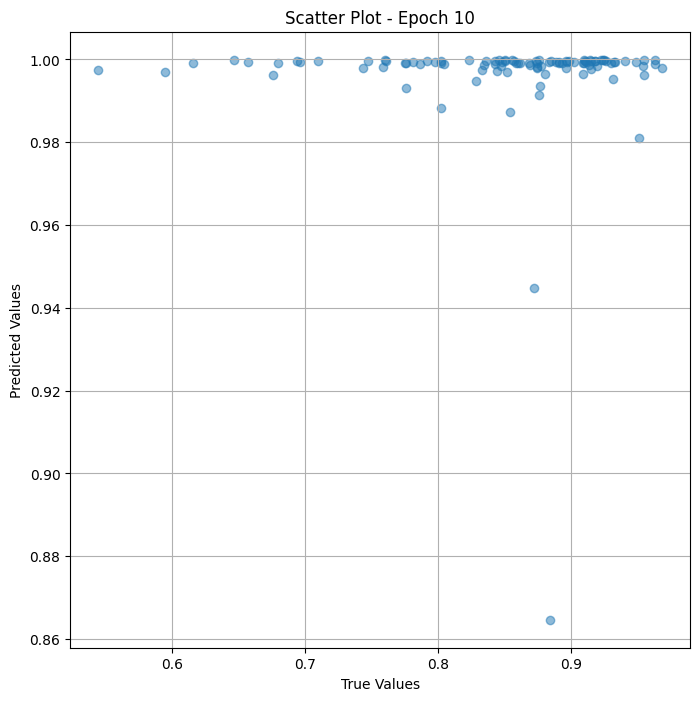

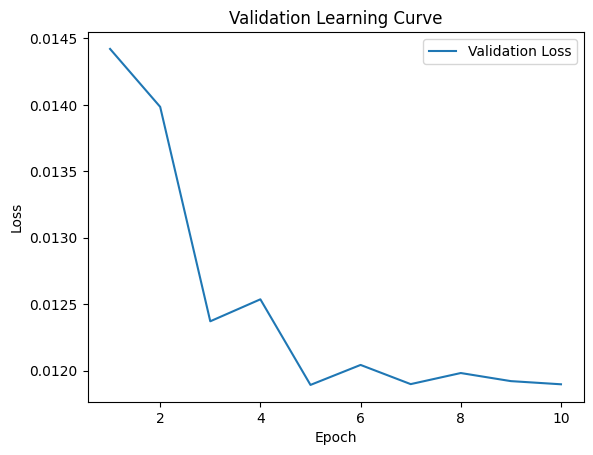


 Epoch: (11/30) Loss = 0.011865595355629921

 Epoch: (11/30) Loss_rmse = 0.10892931371927261

 Epoch: (11/30) R^2 = -4.212094783782959

 Epoch: (11/30) MAE = 0.08911590278148651
Spearman correlation coefficient: SignificanceResult(statistic=0.11512191819961606, pvalue=0.2640361285168607)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 

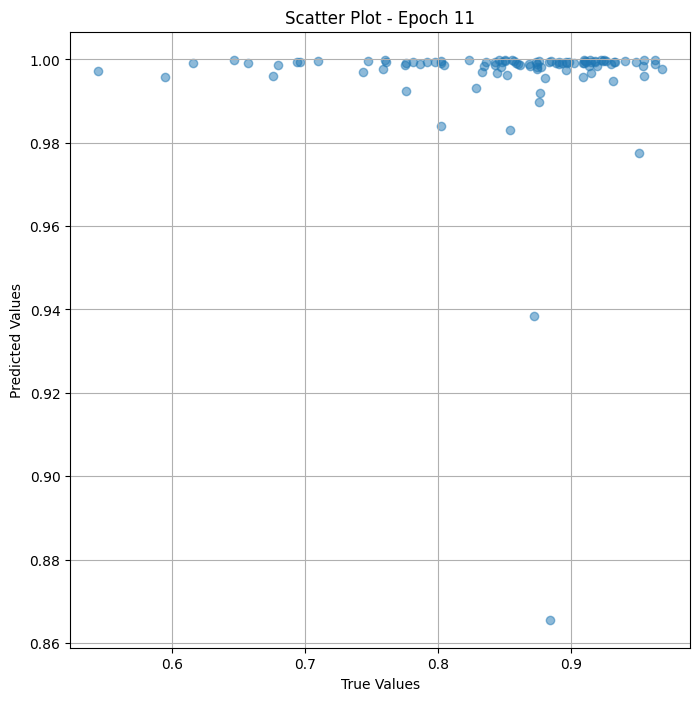

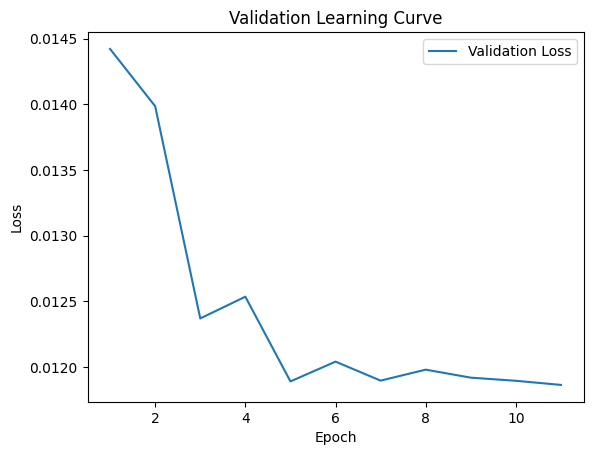


 Epoch: (12/30) Loss = 0.011835354380309582

 Epoch: (12/30) Loss_rmse = 0.10879041254520416

 Epoch: (12/30) R^2 = -4.198811054229736

 Epoch: (12/30) MAE = 0.08912372589111328
Spearman correlation coefficient: SignificanceResult(statistic=0.14984959429638825, pvalue=0.14505317225552716)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703,

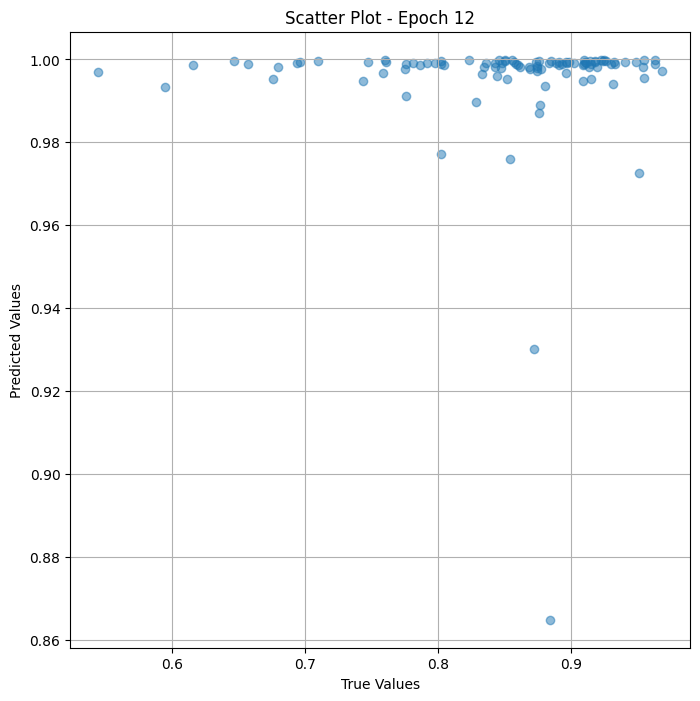

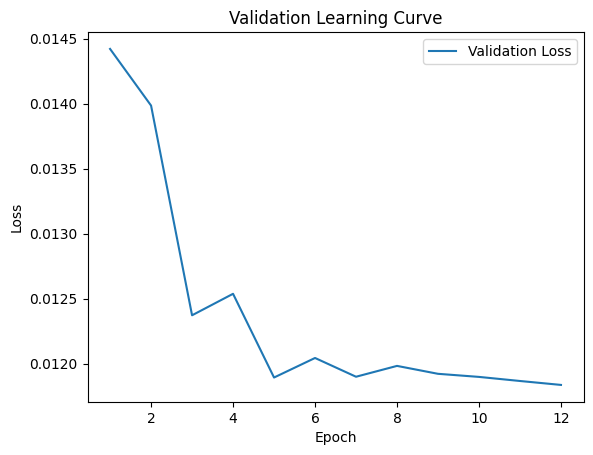


 Epoch: (13/30) Loss = 0.011805782094597816

 Epoch: (13/30) Loss_rmse = 0.10865441709756851

 Epoch: (13/30) R^2 = -4.185821056365967

 Epoch: (13/30) MAE = 0.08966898918151855
Spearman correlation coefficient: SignificanceResult(statistic=0.18700444274327546, pvalue=0.06809313157978085)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703,

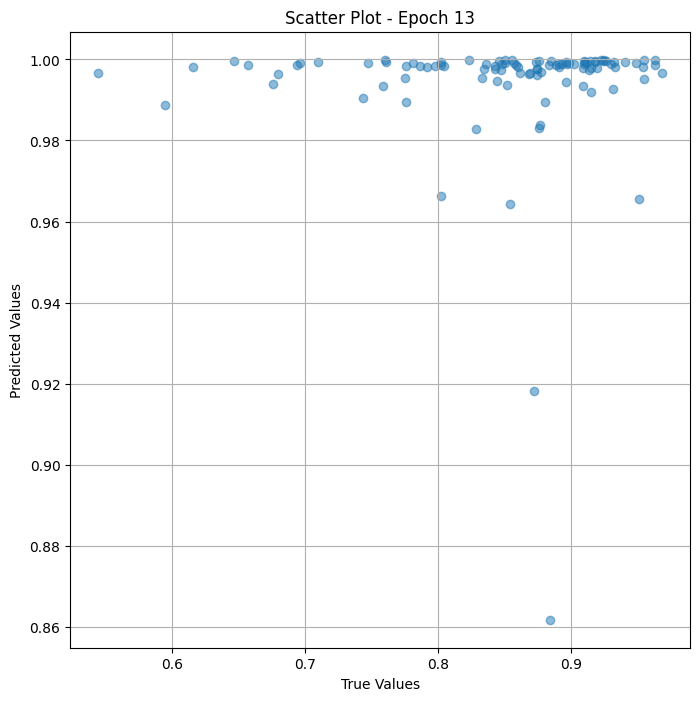

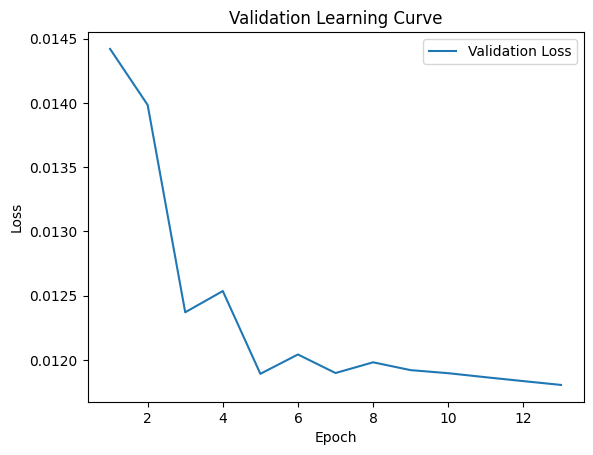


 Epoch: (14/30) Loss = 0.01174504030495882

 Epoch: (14/30) Loss_rmse = 0.10837453603744507

 Epoch: (14/30) R^2 = -4.159139633178711

 Epoch: (14/30) MAE = 0.09092707931995392
Spearman correlation coefficient: SignificanceResult(statistic=0.21756028092681817, pvalue=0.03322955099071926)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 

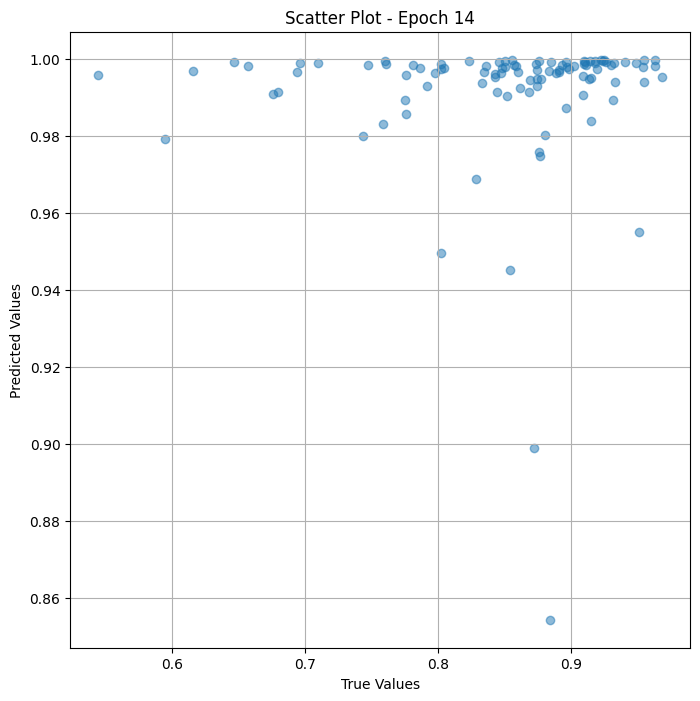

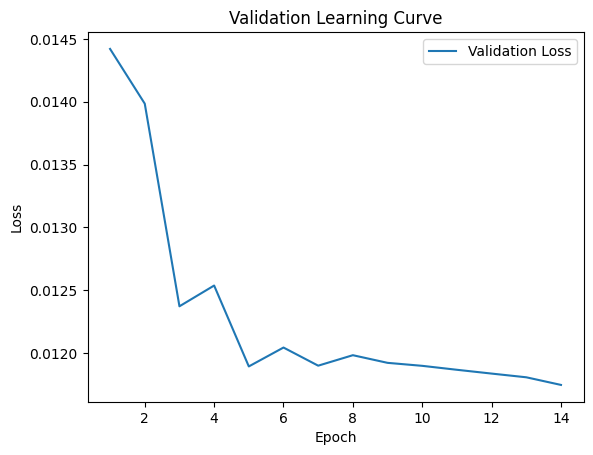


 Epoch: (15/30) Loss = 0.010728402994573116

 Epoch: (15/30) Loss_rmse = 0.10357800126075745

 Epoch: (15/30) R^2 = -3.7125701904296875

 Epoch: (15/30) MAE = 0.09044665098190308
Spearman correlation coefficient: SignificanceResult(statistic=0.2734289688553068, pvalue=0.007027812042190732)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703

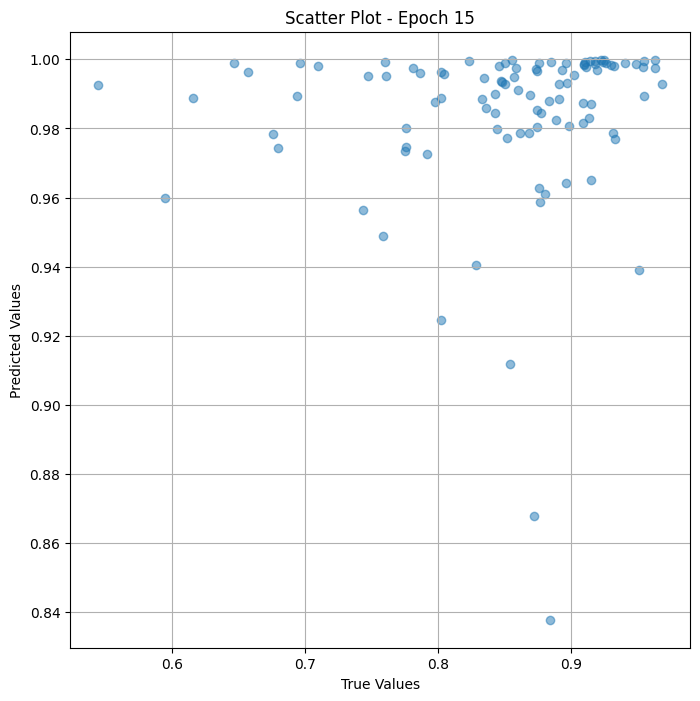

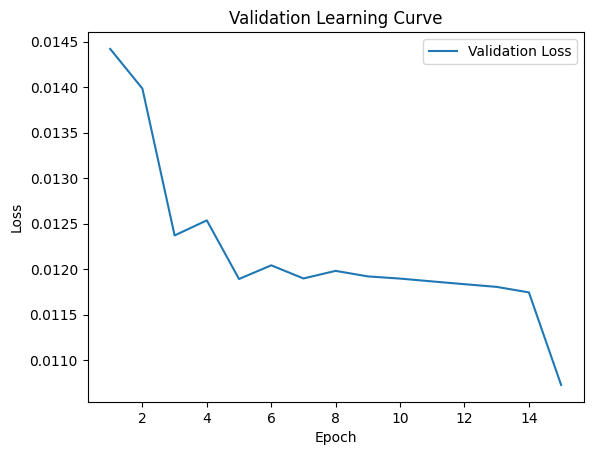


 Epoch: (16/30) Loss = 0.005050497129559517

 Epoch: (16/30) Loss_rmse = 0.07106684893369675

 Epoch: (16/30) R^2 = -1.218487024307251

 Epoch: (16/30) MAE = 0.06701824069023132
Spearman correlation coefficient: SignificanceResult(statistic=0.3152914845642581, pvalue=0.001754255227865196)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703,

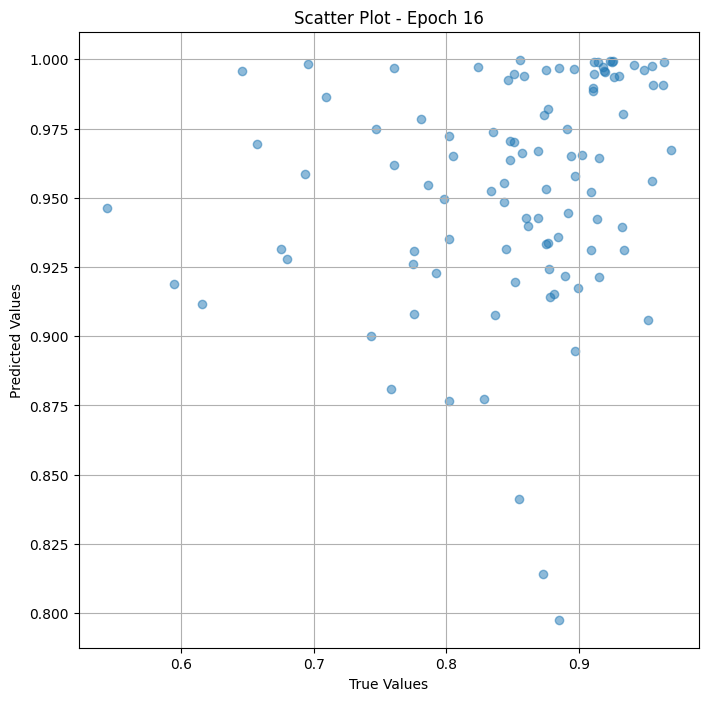

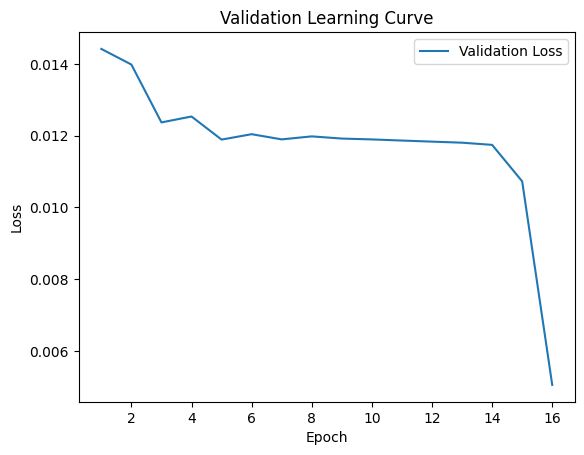


 Epoch: (17/30) Loss = 0.00869367178529501

 Epoch: (17/30) Loss_rmse = 0.09323985874652863

 Epoch: (17/30) R^2 = -2.8187918663024902

 Epoch: (17/30) MAE = 0.08184140920639038
Spearman correlation coefficient: SignificanceResult(statistic=0.32161291435050937, pvalue=0.0013972829506536417)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936170

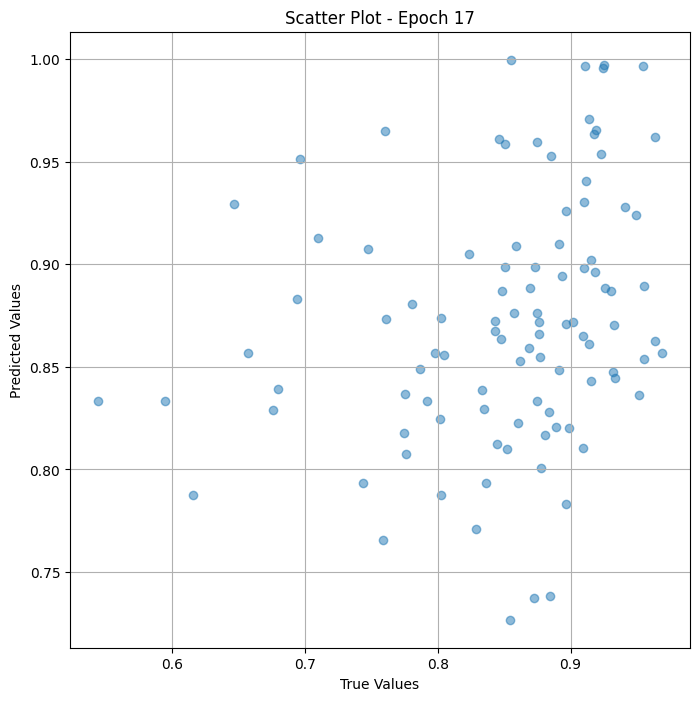

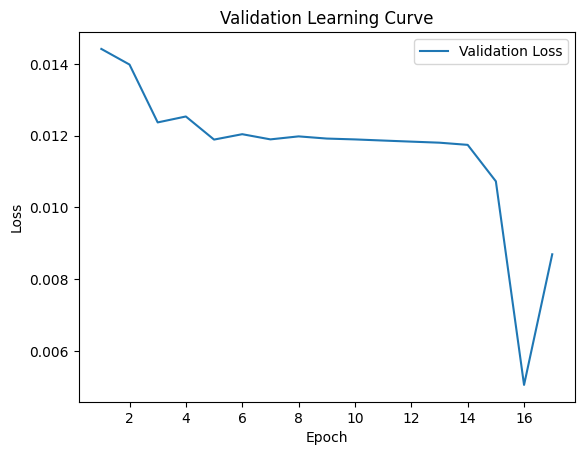


 Epoch: (18/30) Loss = 0.0035002632066607475

 Epoch: (18/30) Loss_rmse = 0.05916302278637886

 Epoch: (18/30) R^2 = -0.537529468536377

 Epoch: (18/30) MAE = 0.04967606067657471
Spearman correlation coefficient: SignificanceResult(statistic=0.3275002545377047, pvalue=0.0011254993802984887)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936170

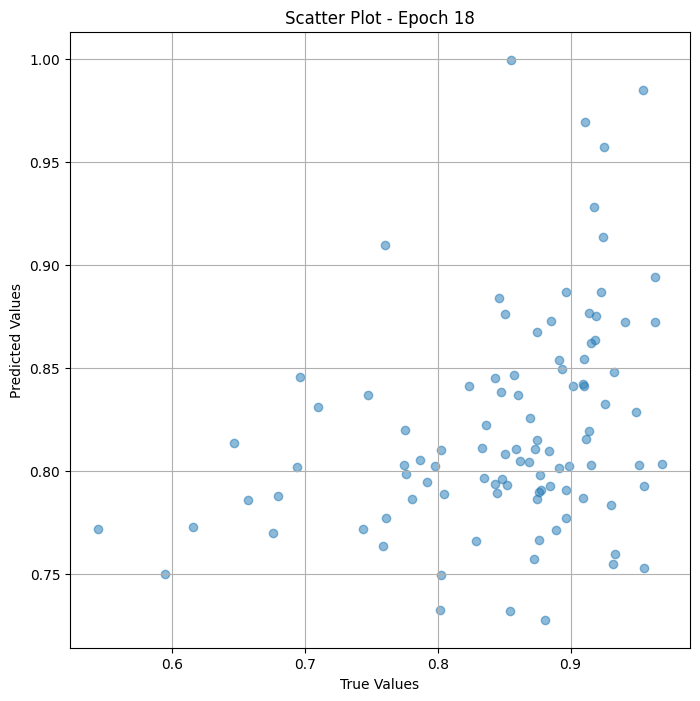

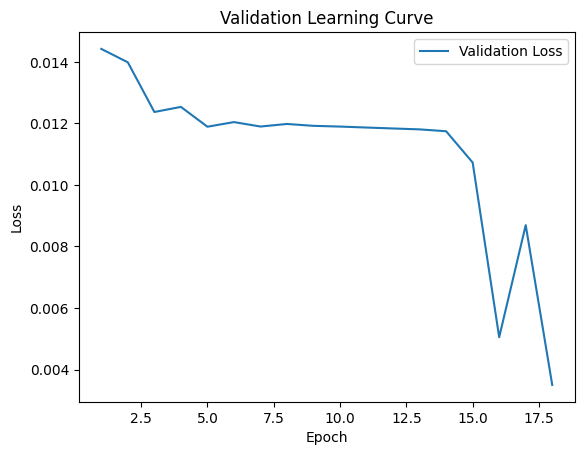


 Epoch: (19/30) Loss = 0.0007161651737987995

 Epoch: (19/30) Loss_rmse = 0.026761261746287346

 Epoch: (19/30) R^2 = 0.6854164600372314

 Epoch: (19/30) MAE = 0.02558860182762146
Spearman correlation coefficient: SignificanceResult(statistic=0.34820768494266713, pvalue=0.0005080059250205935)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

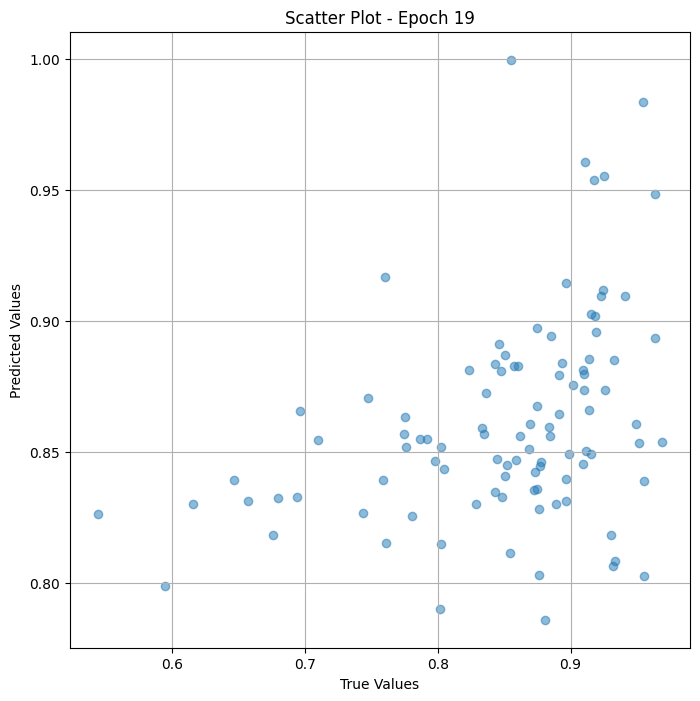

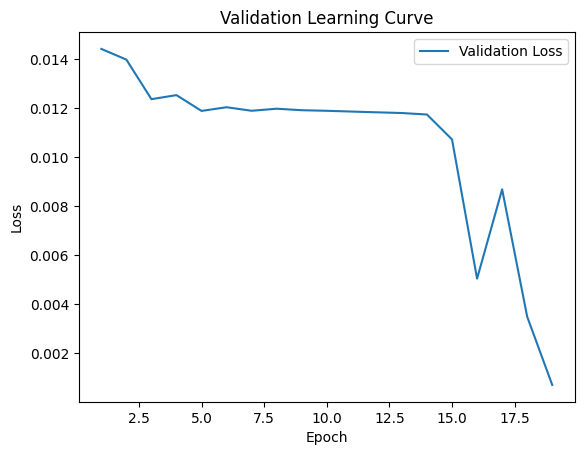


 Epoch: (20/30) Loss = 0.0007029573316685855

 Epoch: (20/30) Loss_rmse = 0.026513341814279556

 Epoch: (20/30) R^2 = 0.6912181973457336

 Epoch: (20/30) MAE = 0.022252589464187622
Spearman correlation coefficient: SignificanceResult(statistic=0.41918811703828857, pvalue=2.129221332796021e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936

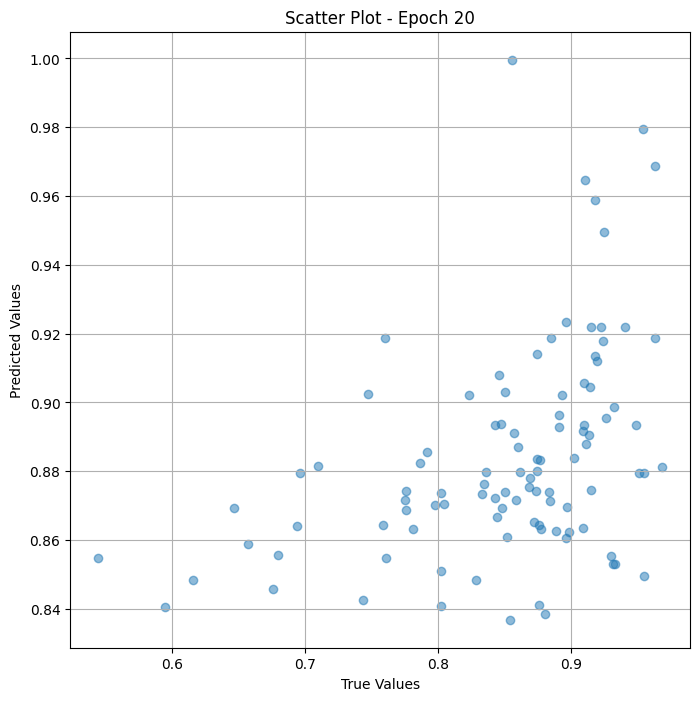

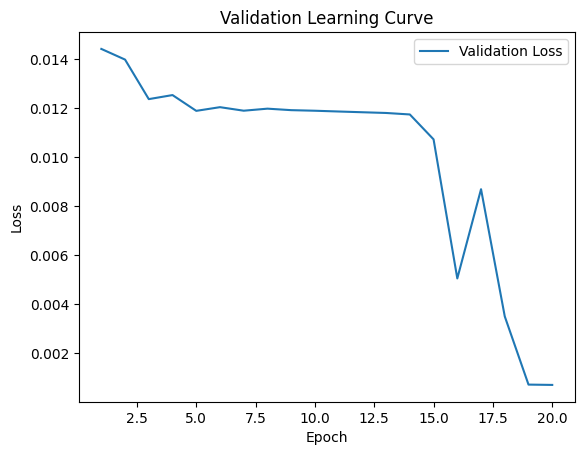


 Epoch: (21/30) Loss = 0.00030012865317985415

 Epoch: (21/30) Loss_rmse = 0.01732422225177288

 Epoch: (21/30) R^2 = 0.868165135383606

 Epoch: (21/30) MAE = 0.012882828712463379
Spearman correlation coefficient: SignificanceResult(statistic=0.48497982189519523, pvalue=5.513768949048284e-07)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

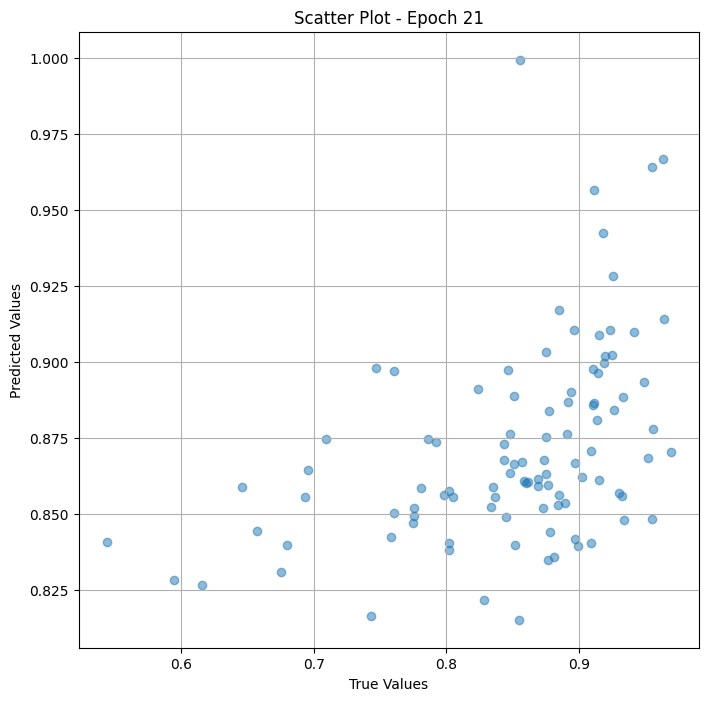

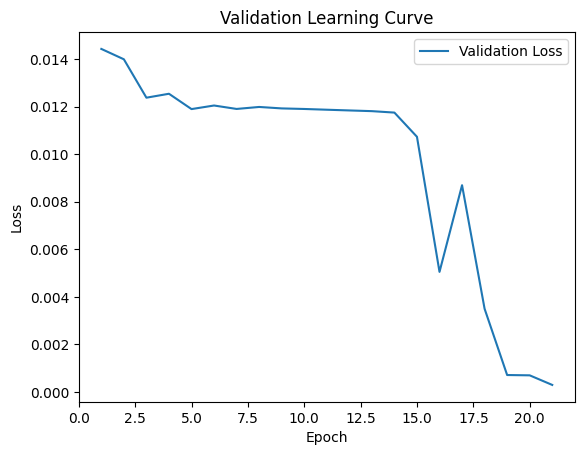


 Epoch: (22/30) Loss = 0.0006571206031367183

 Epoch: (22/30) Loss_rmse = 0.025634363293647766

 Epoch: (22/30) R^2 = 0.7113524675369263

 Epoch: (22/30) MAE = 0.018697157502174377
Spearman correlation coefficient: SignificanceResult(statistic=0.52953504964829, pvalue=2.900465563629031e-08)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936170

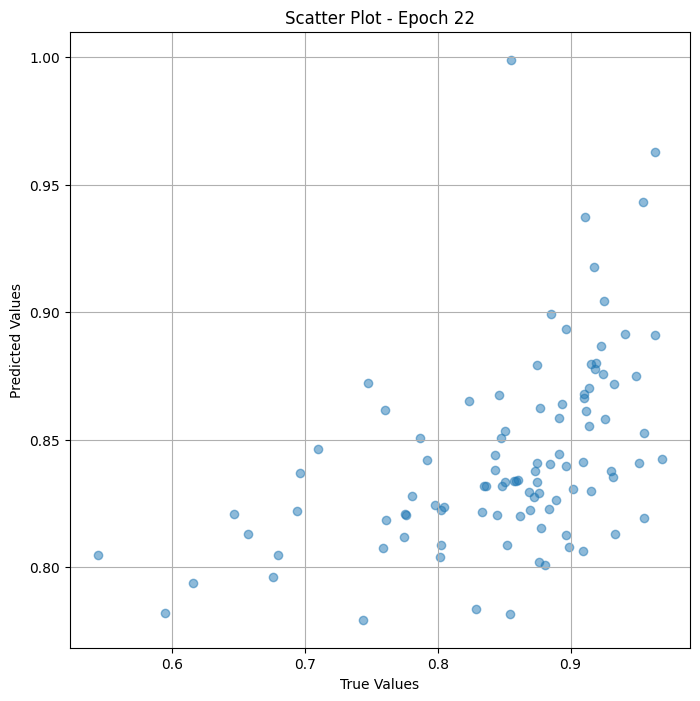

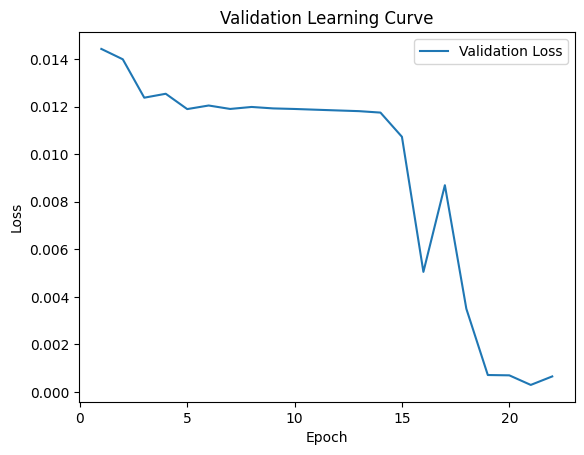


 Epoch: (23/30) Loss = 0.0003755603393074125

 Epoch: (23/30) Loss_rmse = 0.019379379227757454

 Epoch: (23/30) R^2 = 0.8350309133529663

 Epoch: (23/30) MAE = 0.015155568718910217
Spearman correlation coefficient: SignificanceResult(statistic=0.5539729375451389, pvalue=4.773798032551105e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

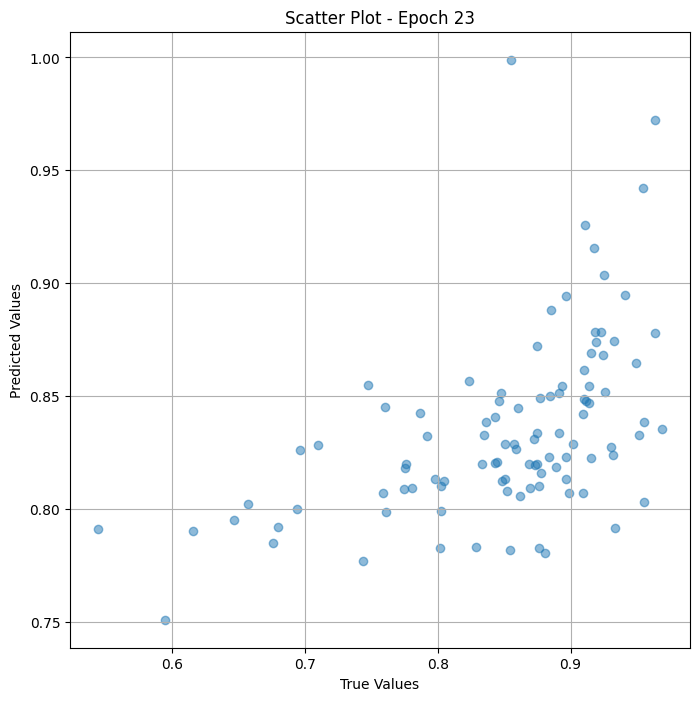

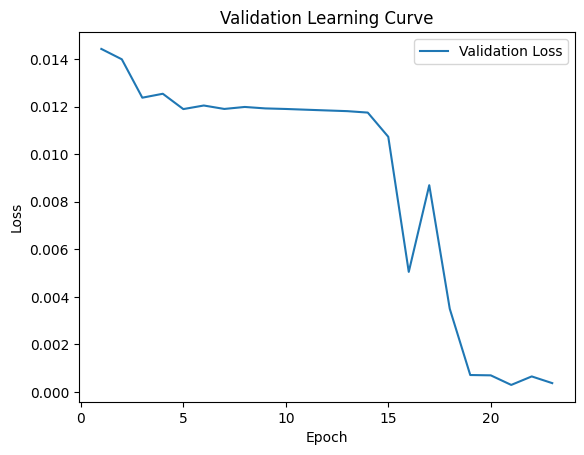


 Epoch: (24/30) Loss = 0.0002432245237287134

 Epoch: (24/30) Loss_rmse = 0.01559565681964159

 Epoch: (24/30) R^2 = 0.8931609392166138

 Epoch: (24/30) MAE = 0.014731287956237793
Spearman correlation coefficient: SignificanceResult(statistic=0.569885034410531, pvalue=1.3606405963346967e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.893617

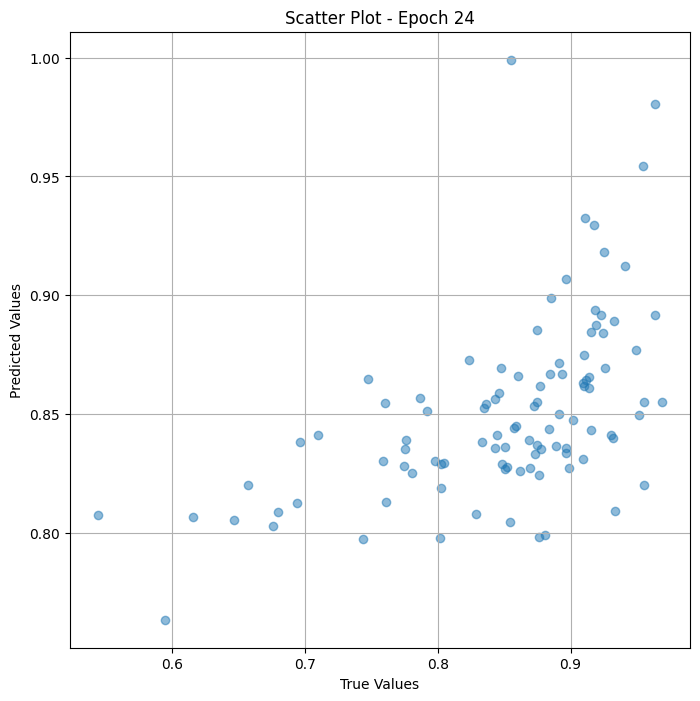

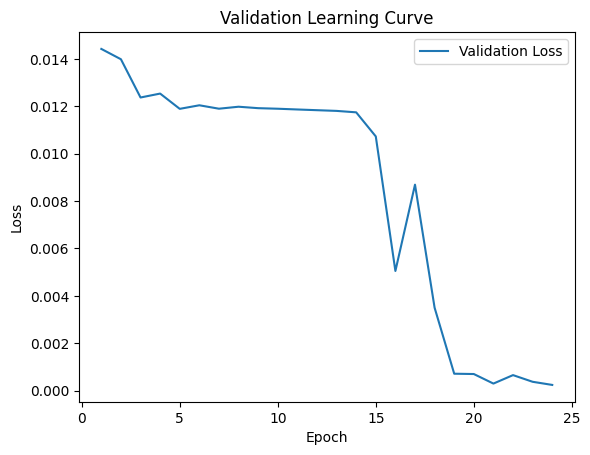


 Epoch: (25/30) Loss = 0.0002362314990023151

 Epoch: (25/30) Loss_rmse = 0.015369824133813381

 Epoch: (25/30) R^2 = 0.8962326645851135

 Epoch: (25/30) MAE = 0.015039324760437012
Spearman correlation coefficient: SignificanceResult(statistic=0.6077186560282449, pvalue=5.1768474523918226e-11)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936

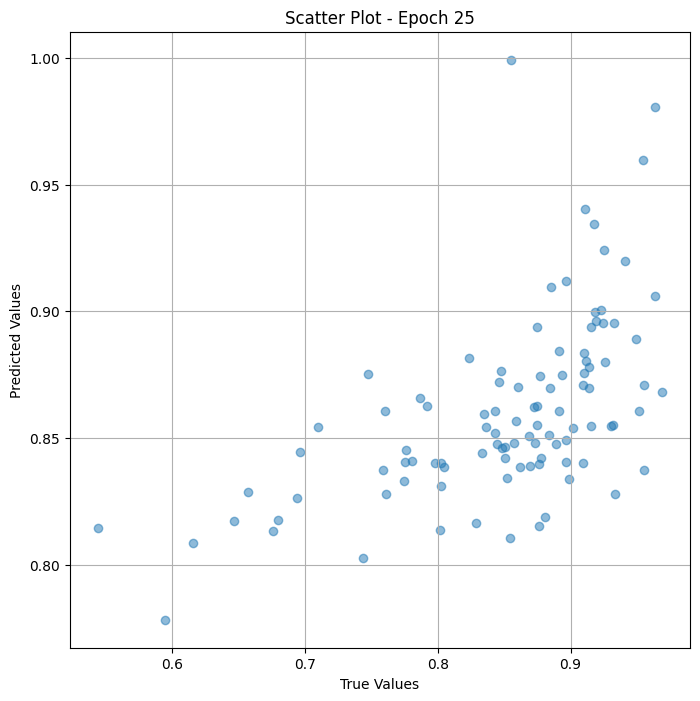

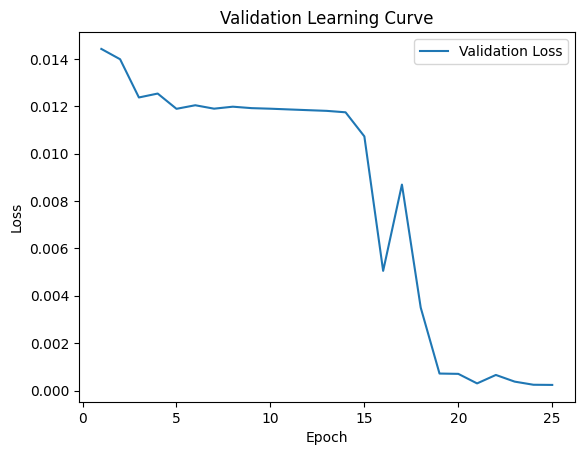


 Epoch: (26/30) Loss = 0.0001676442043390125

 Epoch: (26/30) Loss_rmse = 0.012947749346494675

 Epoch: (26/30) R^2 = 0.9263604283332825

 Epoch: (26/30) MAE = 0.010035023093223572
Spearman correlation coefficient: SignificanceResult(statistic=0.638559365511168, pvalue=2.5712022061586043e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

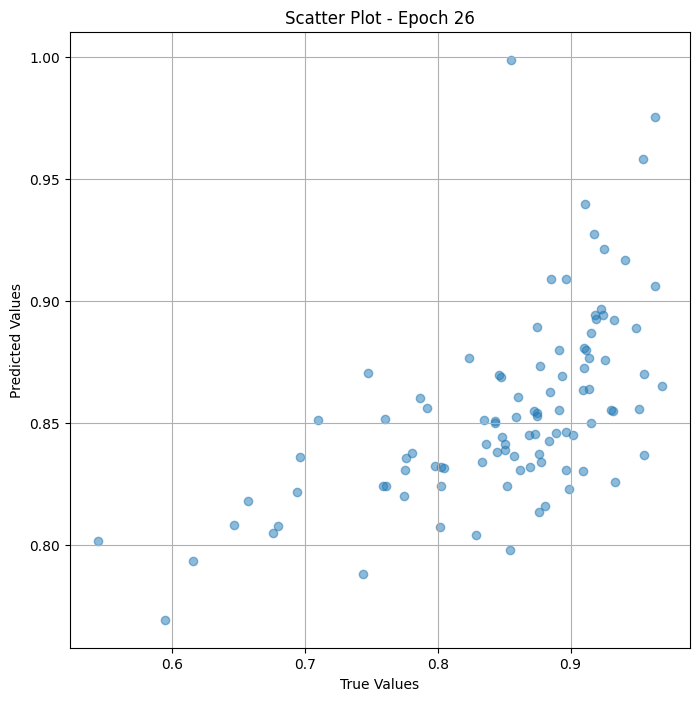

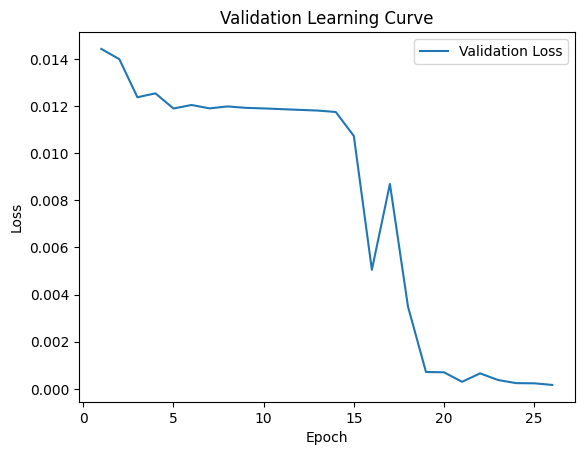


 Epoch: (27/30) Loss = 0.0001948008284671232

 Epoch: (27/30) Loss_rmse = 0.01395710650831461

 Epoch: (27/30) R^2 = 0.9144315719604492

 Epoch: (27/30) MAE = 0.010551616549491882
Spearman correlation coefficient: SignificanceResult(statistic=0.6627395127085774, pvalue=1.9071897442597455e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

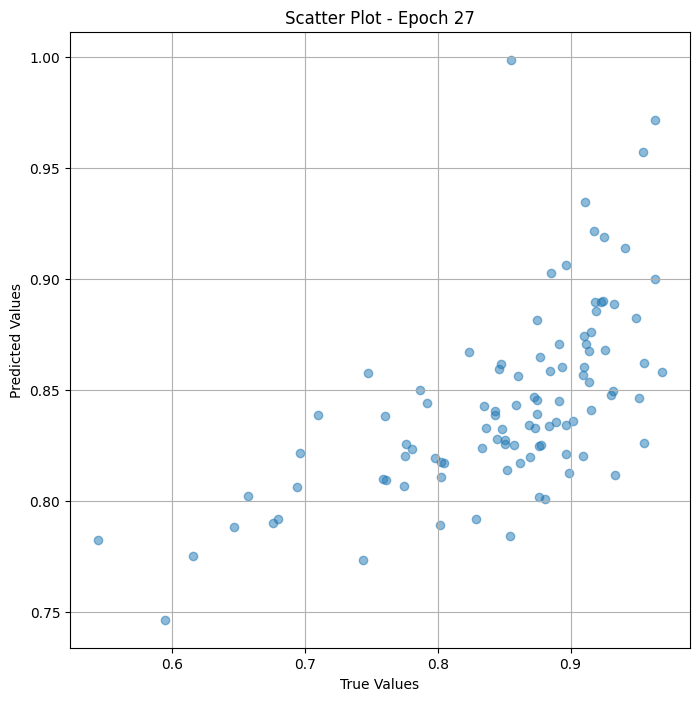

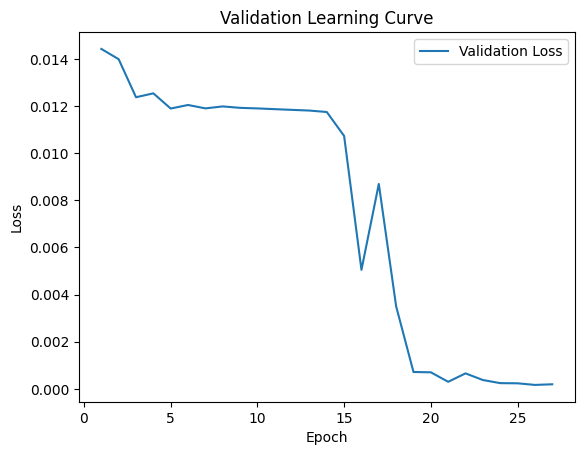


 Epoch: (28/30) Loss = 0.00013021458289586008

 Epoch: (28/30) Loss_rmse = 0.011411160230636597

 Epoch: (28/30) R^2 = 0.9428017735481262

 Epoch: (28/30) MAE = 0.008469223976135254
Spearman correlation coefficient: SignificanceResult(statistic=0.6678875440473808, pvalue=1.0624488220336716e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.893

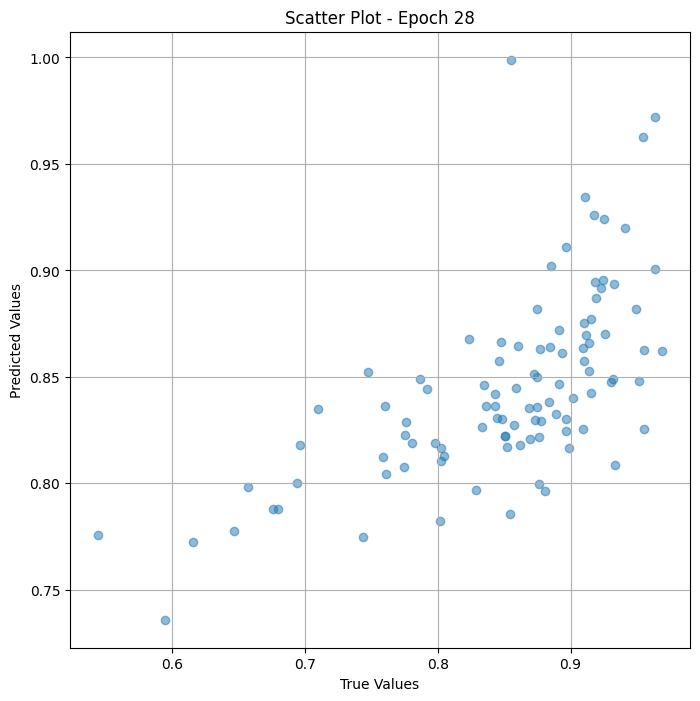

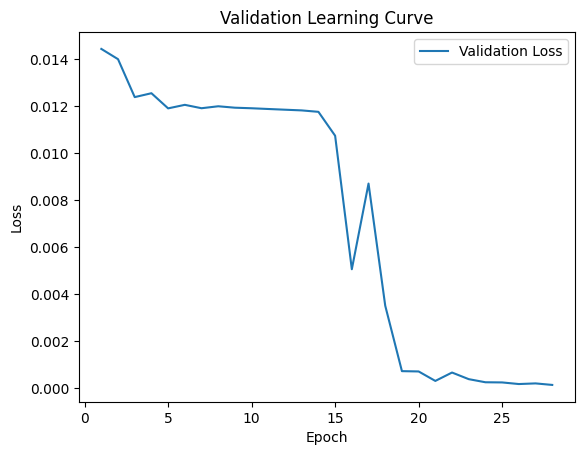


 Epoch: (29/30) Loss = 0.00012161875201854855

 Epoch: (29/30) Loss_rmse = 0.011028089560568333

 Epoch: (29/30) R^2 = 0.9465776085853577

 Epoch: (29/30) MAE = 0.010137274861335754
Spearman correlation coefficient: SignificanceResult(statistic=0.6866008753566802, pvalue=1.1448699870787537e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.893

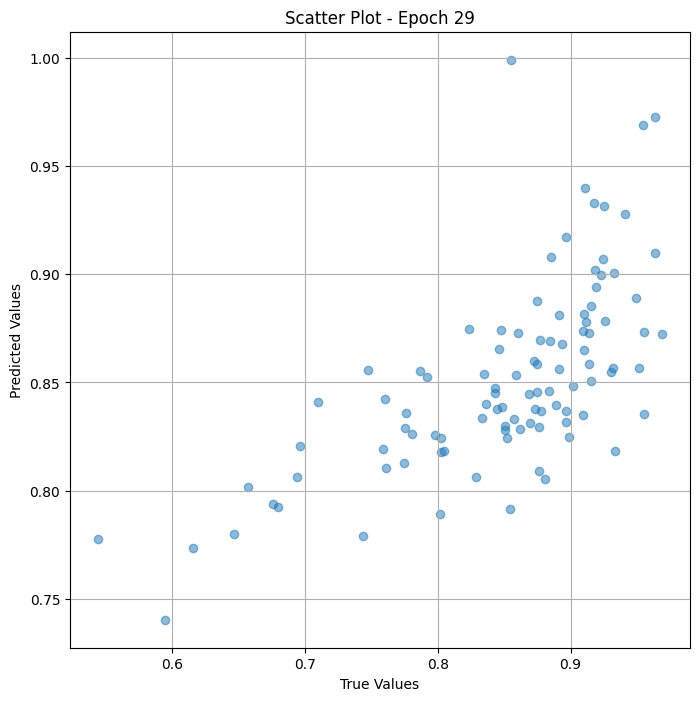

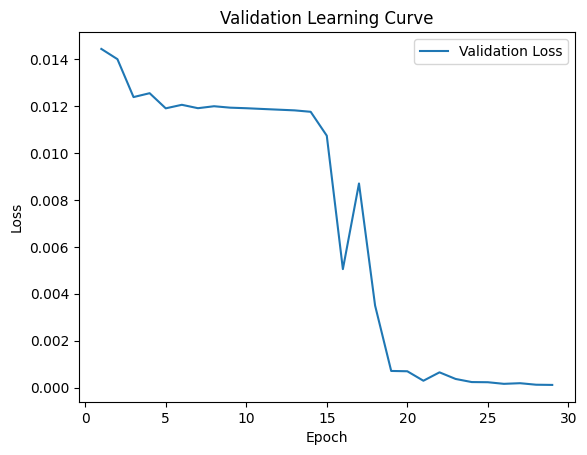


 Epoch: (30/30) Loss = 0.00011093429930042475

 Epoch: (30/30) Loss_rmse = 0.01053253561258316

 Epoch: (30/30) R^2 = 0.9512708783149719

 Epoch: (30/30) MAE = 0.00879339873790741
Spearman correlation coefficient: SignificanceResult(statistic=0.706250212363944, pvalue=9.157575305810023e-16)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936170

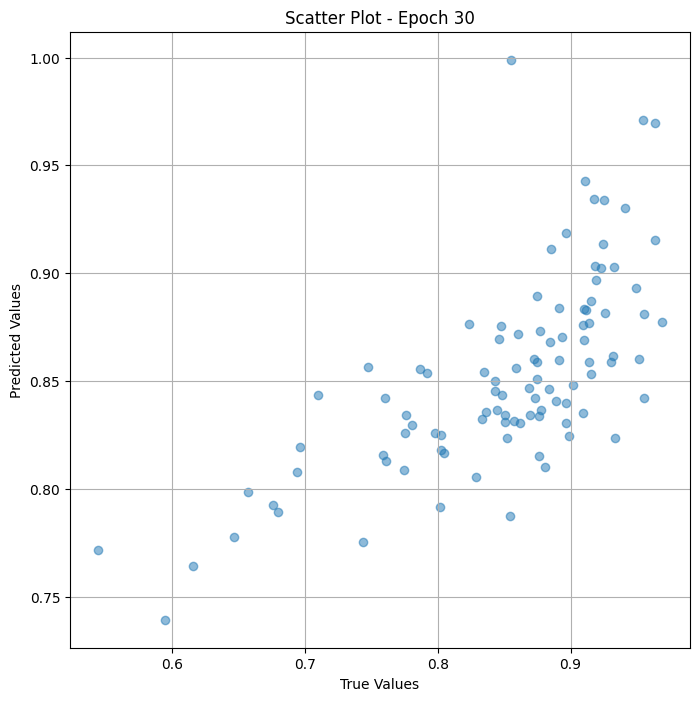

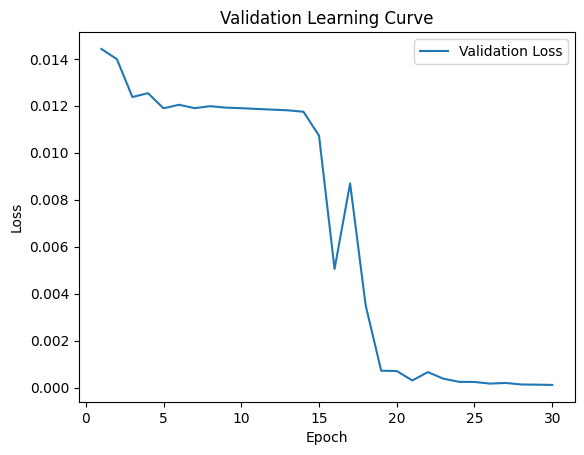

In [ ]:
# val the model and save weights
fit(30, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

In [ ]:
true_values_list_val = []
predicted_values_list_val = []

for x_trans, yb in val_dl:
    preds = model_vit(x_trans)
    true_values_list_val.extend(yb.cpu().detach().numpy())
    predicted_values_list_val.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_food' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_val_food['preprocessed_image_path'],
    'True Value': true_values_list_val,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_val # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                        Image Path  True Value  \
0     /content/food/n07911677_573_preprocessed.jpg    0.876405   
1   /content/food/n07693725_13403_preprocessed.jpg    0.780952   
2   /content/food/n07929519_31336_preprocessed.jpg    0.963636   
3      /content/food/000000365880_preprocessed.jpg    0.914286   
4   /content/food/n07696839_15859_preprocessed.jpg    0.873563   
..                                             ...         ...   
95   /content/food/n07583197_7214_preprocessed.jpg    0.844660   
96  /content/food/n07838073_22701_preprocessed.jpg    0.860215   
97   /content/food/n07716358_1018_preprocessed.jpg    0.884615   
98     /content/food/000000018781_preprocessed.jpg    0.836364   
99   /content/food/n07716358_9840_preprocessed.jpg    0.963303   

    Predicted Value  
0          0.901659  
1          0.888071  
2          0.927980  
3          0.861700  
4          0.800724  
..              ...  
95         0.813898  
96         0.830656  
97       

## Test

In [ ]:
df_test_food.head()


,preprocessed_image_path,memoscore
0,/content/food/000000374451_preprocessed.jpg,0.760417
1,/content/food/n07863374_17242_preprocessed.jpg,0.881188
2,/content/food/n07583197_3923_preprocessed.jpg,0.803922
3,/content/food/000000445557_preprocessed.jpg,0.923729
4,/content/food/000000435488_preprocessed.jpg,0.857143


In [ ]:
df_test_food.shape

(100, 2)

In [ ]:
class Dataset_test_food(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_test_food["memoscore"]
        self.images = df_test_food["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
test_ds = Dataset_test_food(df_test_food, trans_transform=trans_transform)
test_dl = DataLoader(test_ds, batch_size=32, shuffle=False)

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
print(test_ds)

In [ ]:
class ViTMem_model_test_food(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_test =  ViTMem_model_test_food( arch="vit_base_patch16_224_miil")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_test_food().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
test_dl = DeviceDataLoader(test_dl, device)
model_vit_test  = to_device(model_vit_test  , device)

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad ]
optimizer = torch.optim.Adam(params, lr=1e-4)   #,weight_decay=1e-7

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.004020427353680134

 Epoch: (1/30) Loss_rmse = 0.06340683996677399

 Epoch: (1/30) R^2 = -1.116204023361206

 Epoch: (1/30) MAE = 0.04304942488670349
Spearman correlation coefficient: SignificanceResult(statistic=-0.03079291763762189, pvalue=0.7658358520759685)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396226, 0

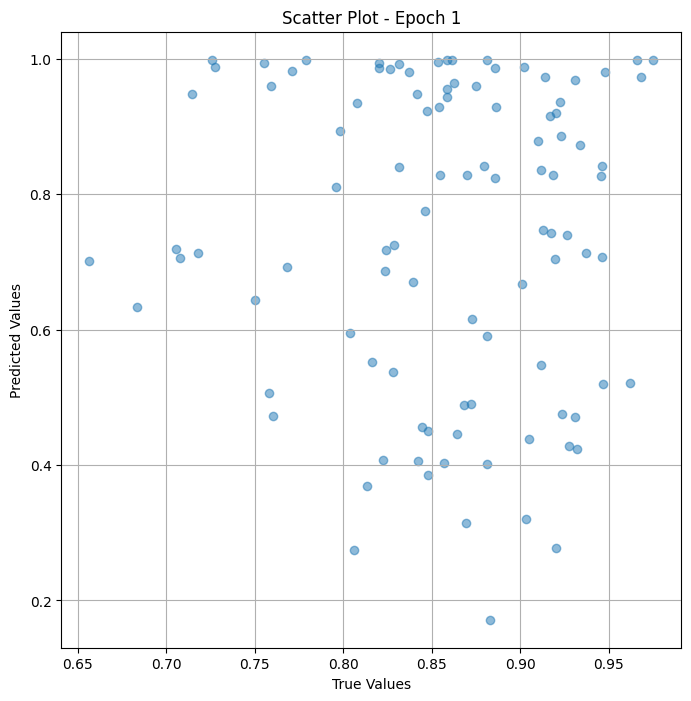

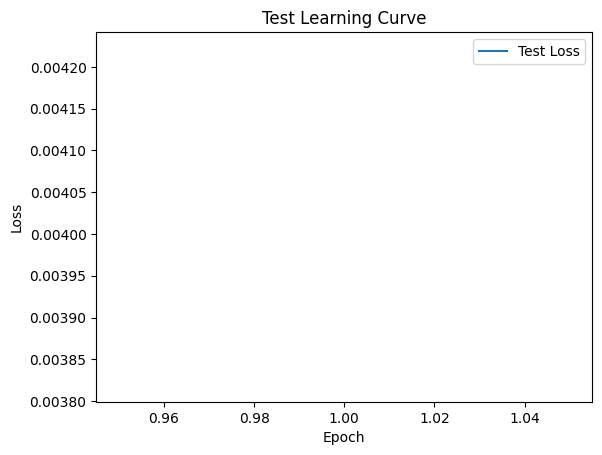


 Epoch: (2/30) Loss = 0.0002517803804948926

 Epoch: (2/30) Loss_rmse = 0.01586758904159069

 Epoch: (2/30) R^2 = 0.8674721121788025

 Epoch: (2/30) MAE = 0.014606013894081116
Spearman correlation coefficient: SignificanceResult(statistic=0.08491791383767093, pvalue=0.41072955721430027)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396226,

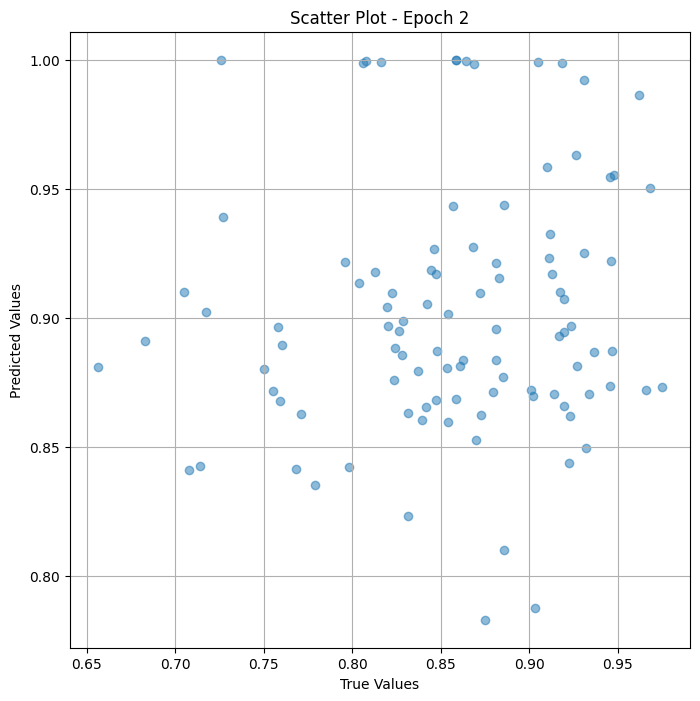

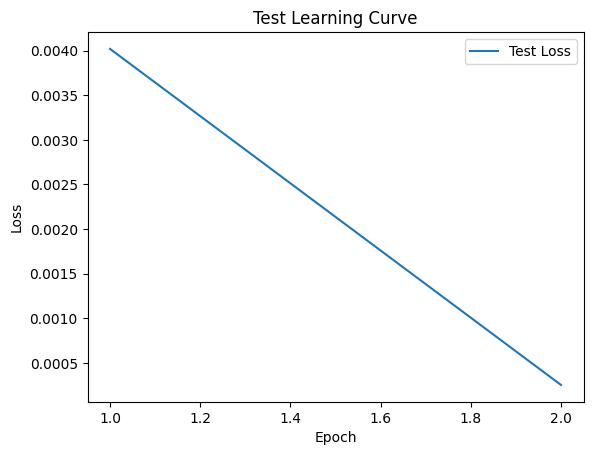


 Epoch: (3/30) Loss = 0.00018232697038911283

 Epoch: (3/30) Loss_rmse = 0.013502850197255611

 Epoch: (3/30) R^2 = 0.9040298461914062

 Epoch: (3/30) MAE = 0.011759236454963684
Spearman correlation coefficient: SignificanceResult(statistic=0.2534040078985003, pvalue=0.012734084060040955)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.839622

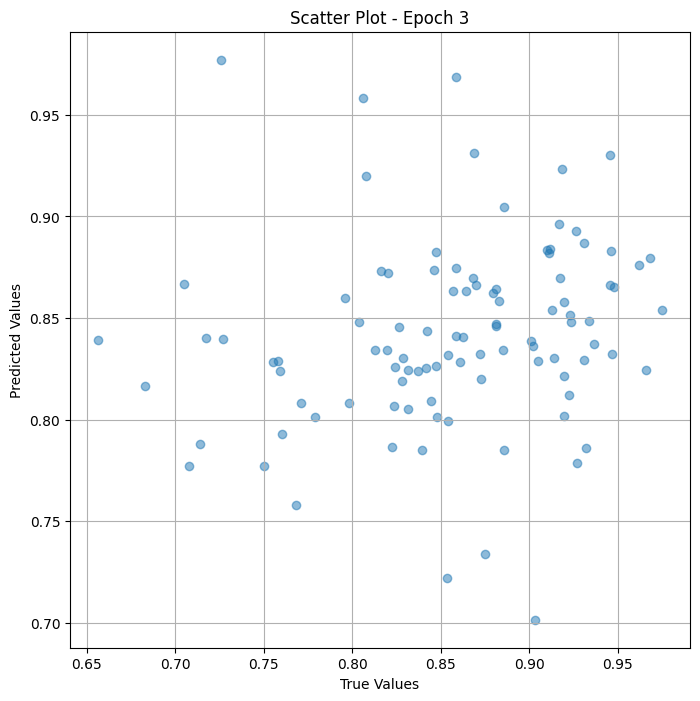

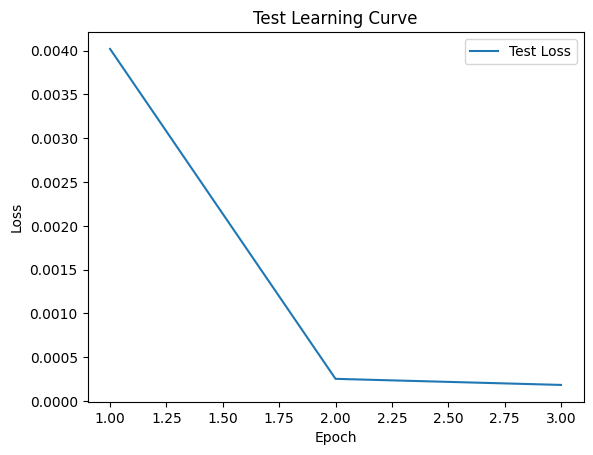


 Epoch: (4/30) Loss = 0.0003267291176598519

 Epoch: (4/30) Loss_rmse = 0.018075650557875633

 Epoch: (4/30) R^2 = 0.8280218839645386

 Epoch: (4/30) MAE = 0.016252771019935608
Spearman correlation coefficient: SignificanceResult(statistic=0.36833484256138643, pvalue=0.00022218527016335215)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396

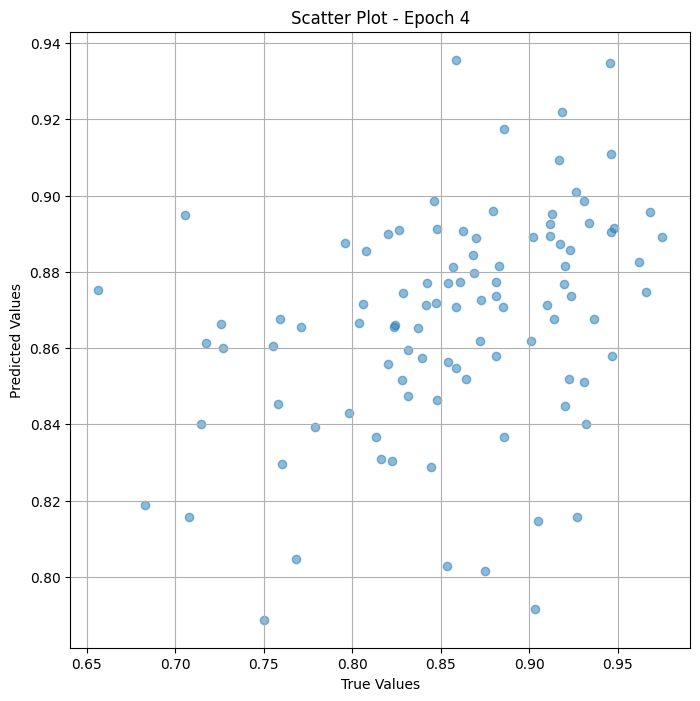

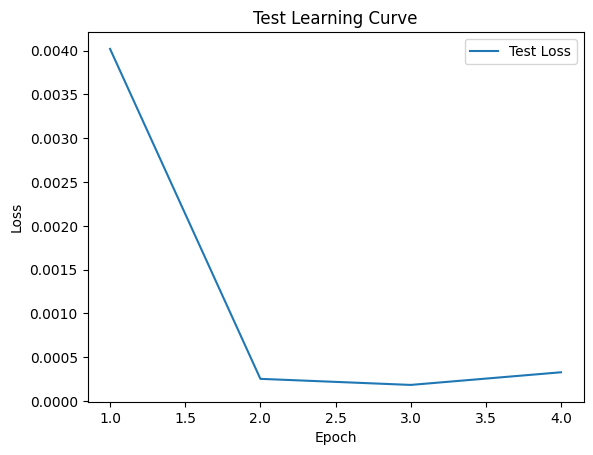


 Epoch: (5/30) Loss = 0.0002908141468651593

 Epoch: (5/30) Loss_rmse = 0.01705327443778515

 Epoch: (5/30) R^2 = 0.846926212310791

 Epoch: (5/30) MAE = 0.013568773865699768
Spearman correlation coefficient: SignificanceResult(statistic=0.4774326575836657, pvalue=8.723157577180564e-07)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396226,

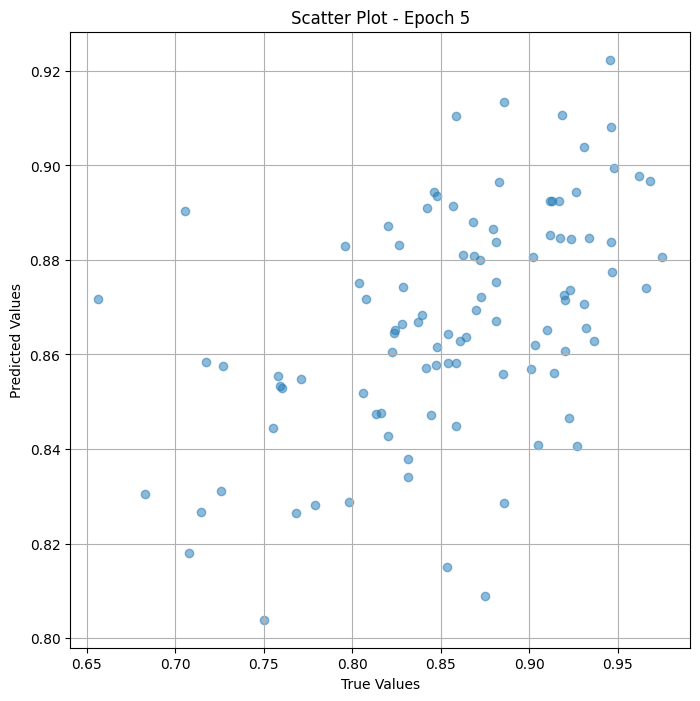

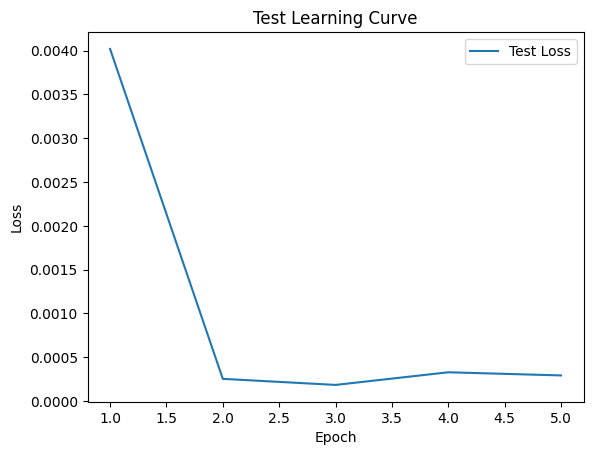

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (6/30) Loss = 0.00039571107481606305

 Epoch: (6/30) Loss_rmse = 0.019892487674951553

 Epoch: (6/30) R^2 = 0.7917123436927795

 Epoch: (6/30) MAE = 0.016271010041236877
Spearman correlation coefficient: SignificanceResult(statistic=0.5602411887373497, pvalue=2.9346078243456453e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0

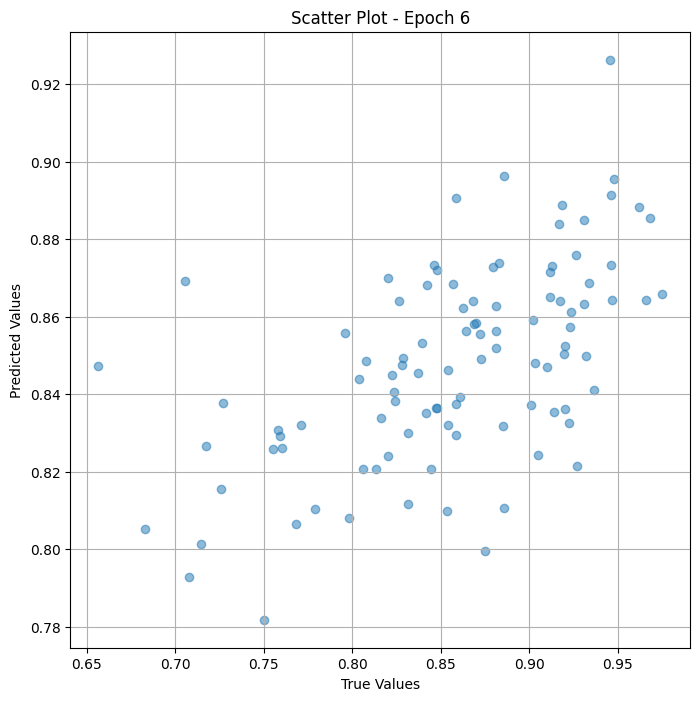

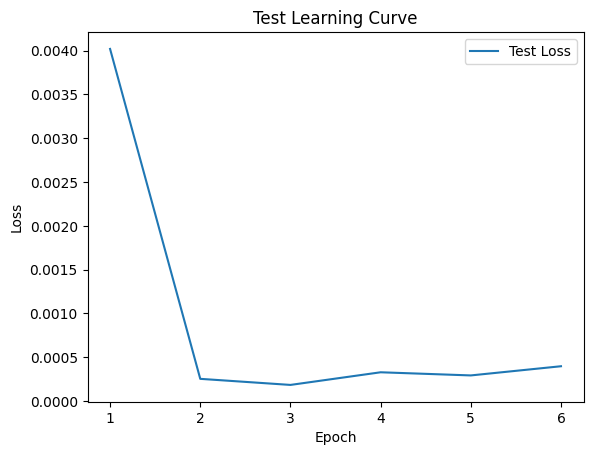


 Epoch: (7/30) Loss = 0.00024091359227895737

 Epoch: (7/30) Loss_rmse = 0.015521391294896603

 Epoch: (7/30) R^2 = 0.8731920123100281

 Epoch: (7/30) MAE = 0.012351006269454956
Spearman correlation coefficient: SignificanceResult(statistic=0.6097811601966429, pvalue=4.2779586260880946e-11)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396

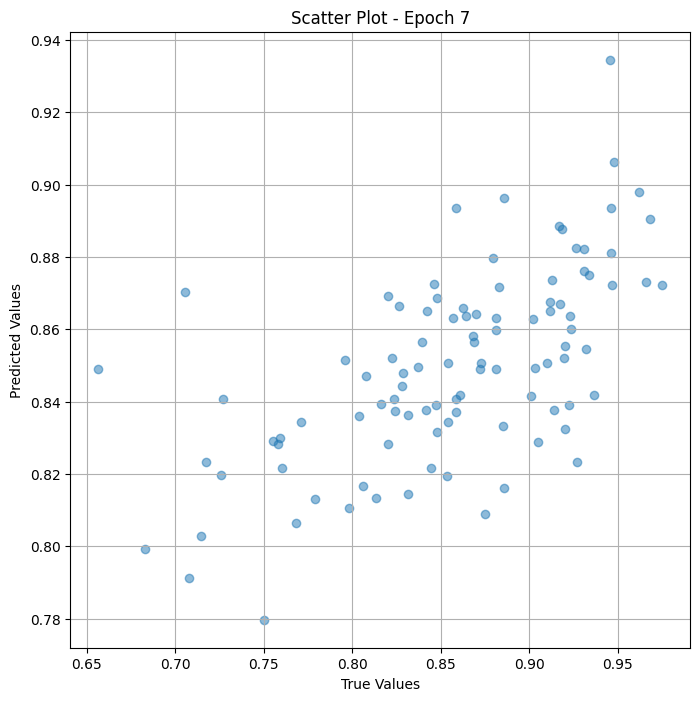

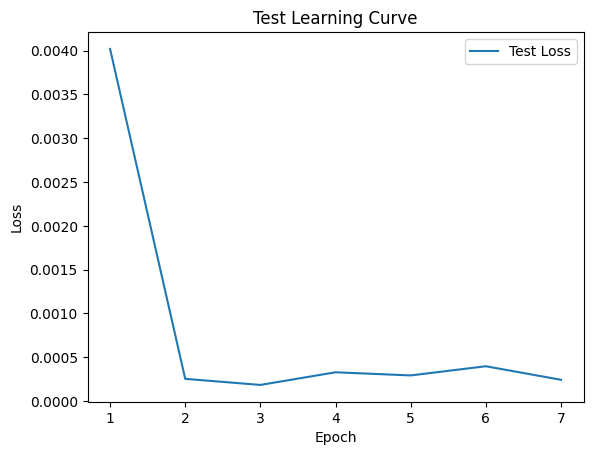


 Epoch: (8/30) Loss = 0.00018807269225362688

 Epoch: (8/30) Loss_rmse = 0.013713959604501724

 Epoch: (8/30) R^2 = 0.9010055065155029

 Epoch: (8/30) MAE = 0.010613888502120972
Spearman correlation coefficient: SignificanceResult(statistic=0.6158447875904828, pvalue=2.4223156269007518e-11)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396

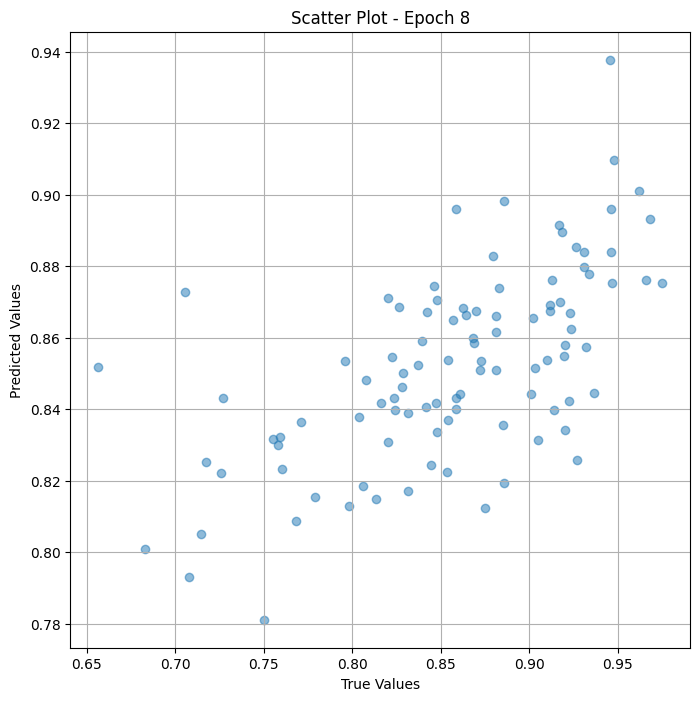

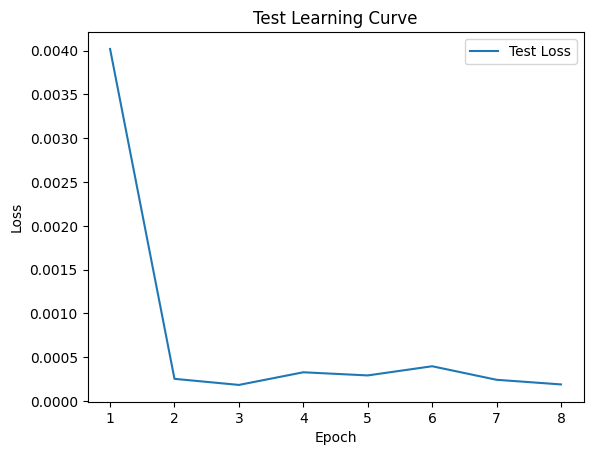


 Epoch: (9/30) Loss = 0.00014986035239417106

 Epoch: (9/30) Loss_rmse = 0.012241746298968792

 Epoch: (9/30) R^2 = 0.9211190938949585

 Epoch: (9/30) MAE = 0.009232491254806519
Spearman correlation coefficient: SignificanceResult(statistic=0.621352243344172, pvalue=1.4297485017350129e-11)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83962

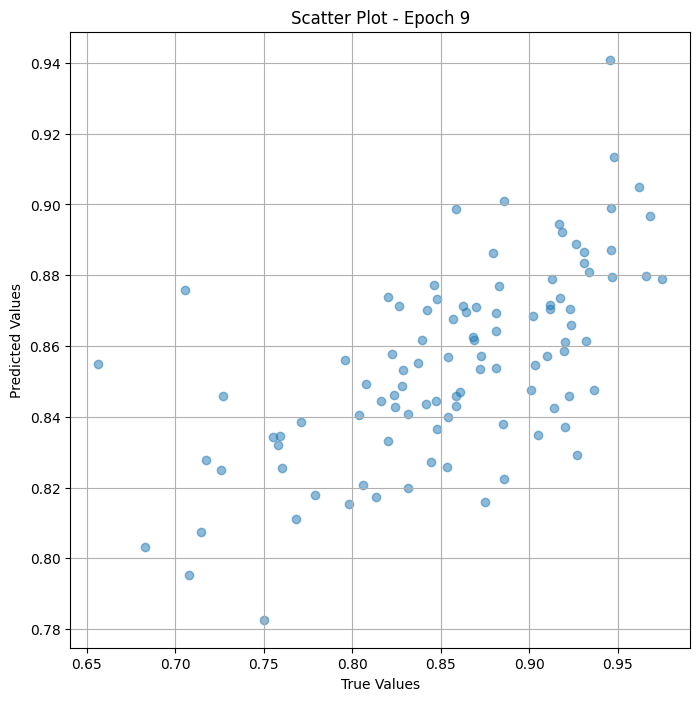

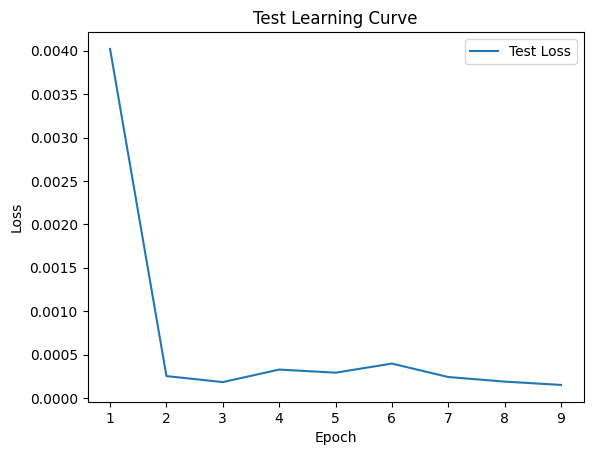


 Epoch: (10/30) Loss = 0.00012551705003716052

 Epoch: (10/30) Loss_rmse = 0.011203438974916935

 Epoch: (10/30) R^2 = 0.9339324831962585

 Epoch: (10/30) MAE = 0.008778303861618042
Spearman correlation coefficient: SignificanceResult(statistic=0.6301560334529018, pvalue=6.02273906817533e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

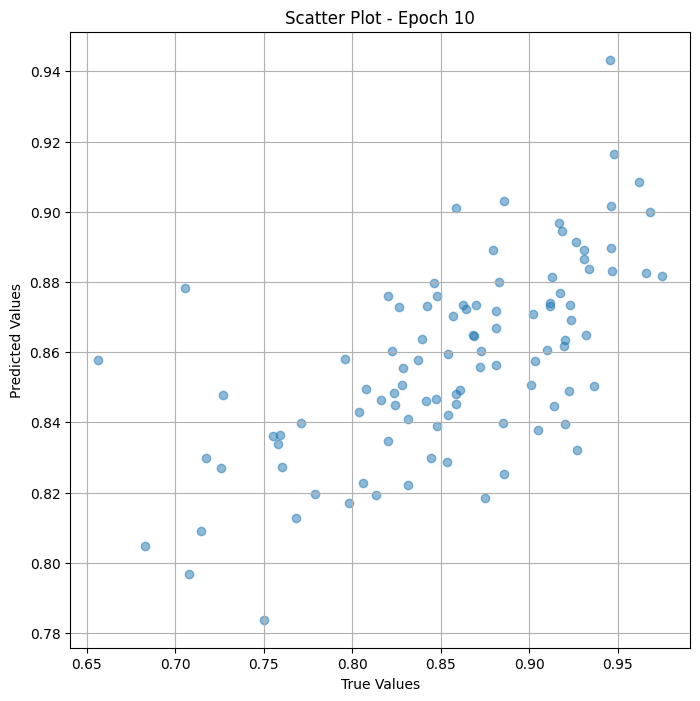

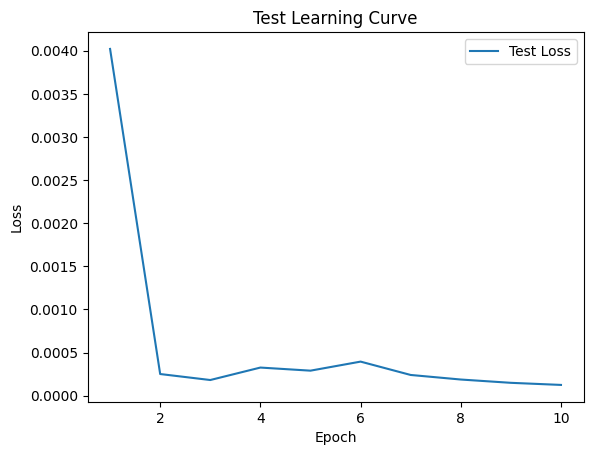


 Epoch: (11/30) Loss = 0.00010770179505925626

 Epoch: (11/30) Loss_rmse = 0.010377947241067886

 Epoch: (11/30) R^2 = 0.9433097839355469

 Epoch: (11/30) MAE = 0.008049532771110535
Spearman correlation coefficient: SignificanceResult(statistic=0.6362671389135841, pvalue=3.251547315155462e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

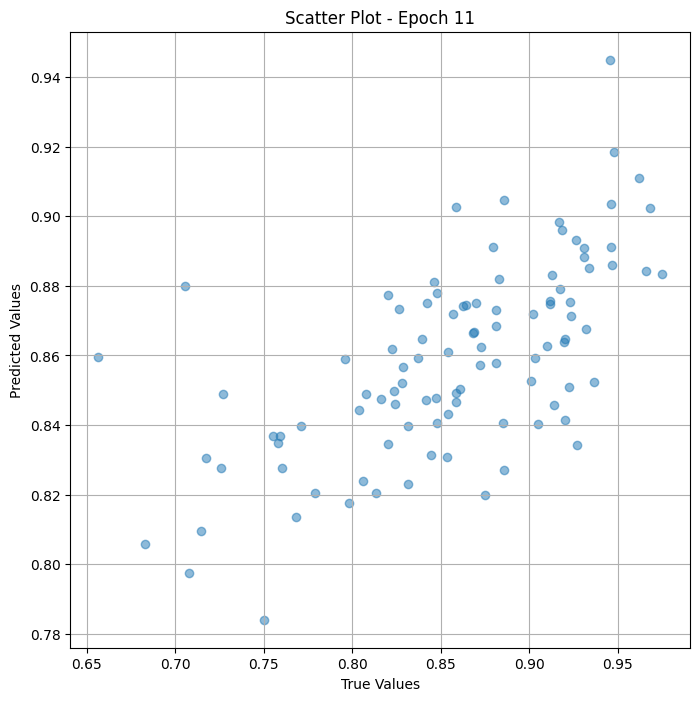

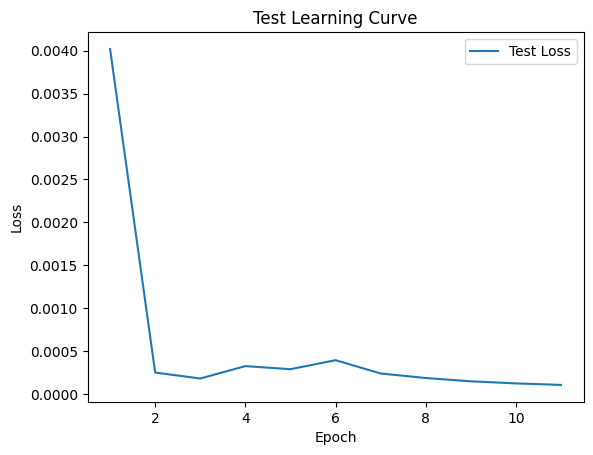


 Epoch: (12/30) Loss = 9.484239126322791e-05

 Epoch: (12/30) Loss_rmse = 0.009738706052303314

 Epoch: (12/30) R^2 = 0.9500784873962402

 Epoch: (12/30) MAE = 0.007441654801368713
Spearman correlation coefficient: SignificanceResult(statistic=0.6431311108627632, pvalue=1.6003945890241898e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

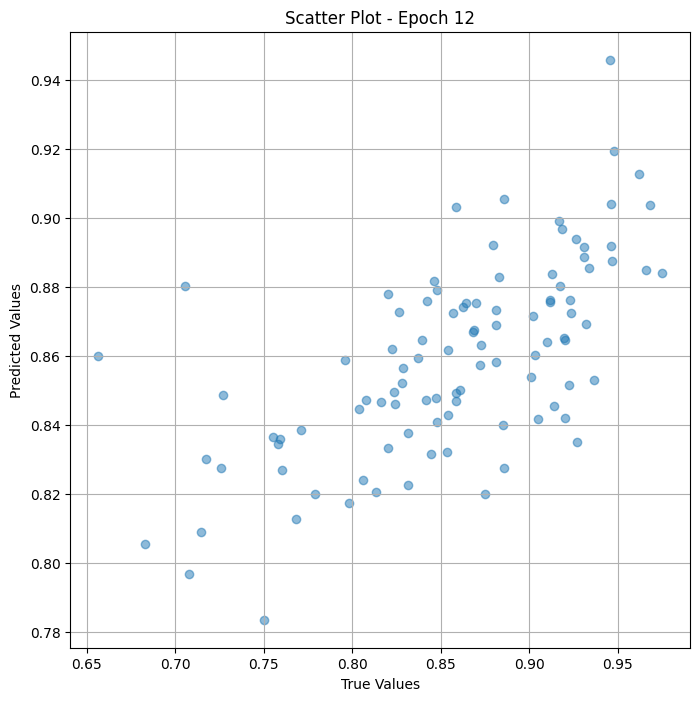

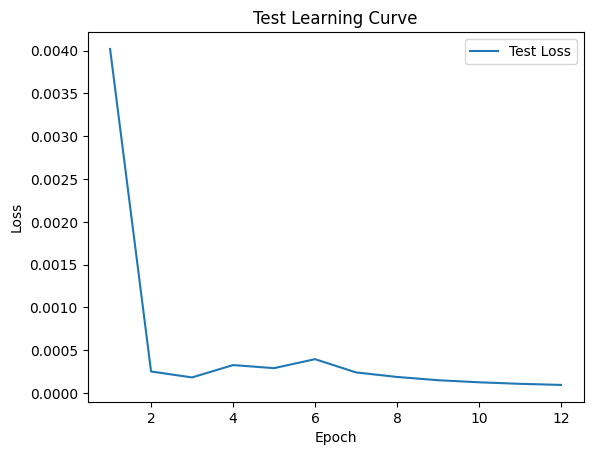


 Epoch: (13/30) Loss = 8.622148016002029e-05

 Epoch: (13/30) Loss_rmse = 0.00928555242717266

 Epoch: (13/30) R^2 = 0.9546161890029907

 Epoch: (13/30) MAE = 0.006815269589424133
Spearman correlation coefficient: SignificanceResult(statistic=0.6511006435112667, pvalue=6.868935938204714e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.839

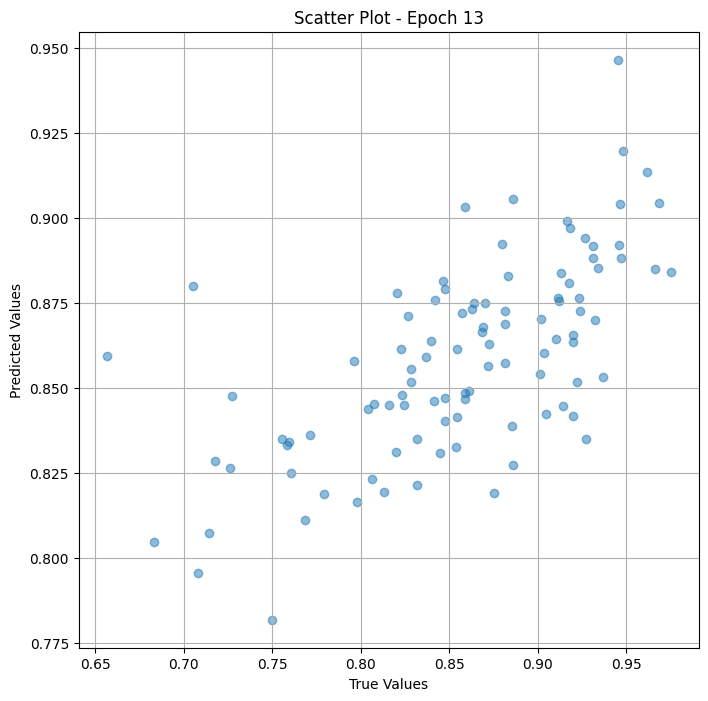

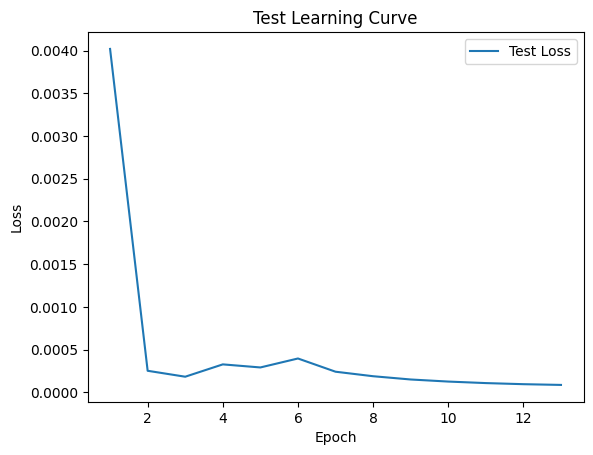


 Epoch: (14/30) Loss = 8.215445996029302e-05

 Epoch: (14/30) Loss_rmse = 0.009063909761607647

 Epoch: (14/30) R^2 = 0.9567569494247437

 Epoch: (14/30) MAE = 0.006172597408294678
Spearman correlation coefficient: SignificanceResult(statistic=0.6588395684065369, pvalue=2.948424999278852e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

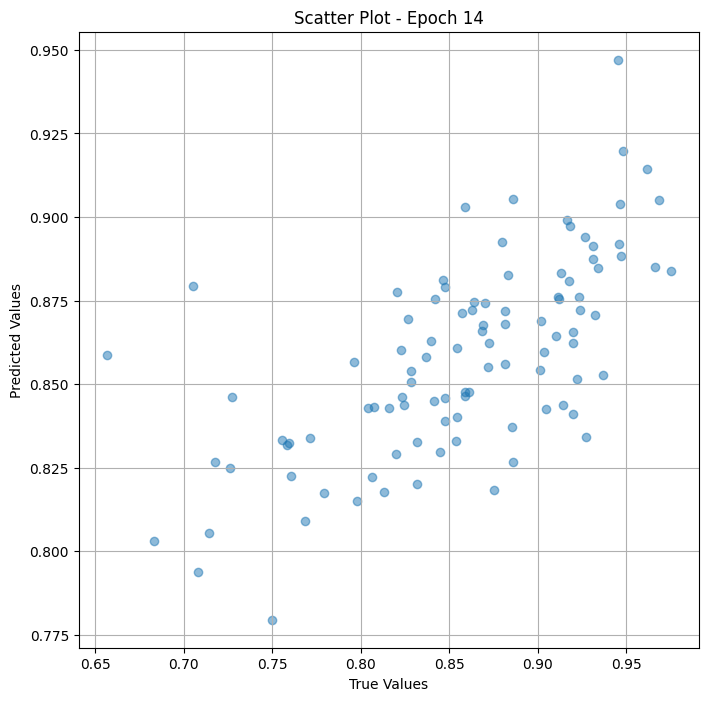

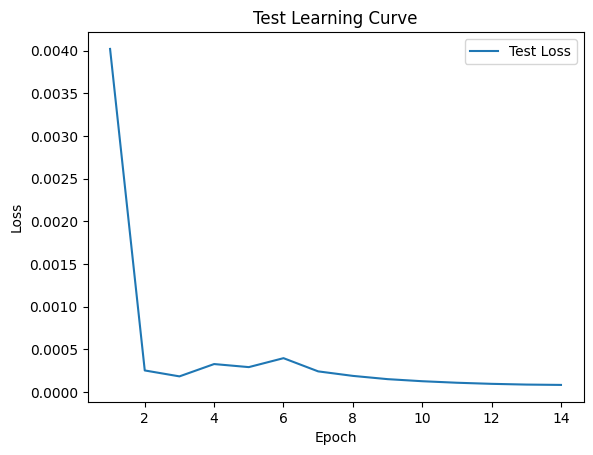


 Epoch: (15/30) Loss = 8.069180330494419e-05

 Epoch: (15/30) Loss_rmse = 0.008982861414551735

 Epoch: (15/30) R^2 = 0.9575268030166626

 Epoch: (15/30) MAE = 0.006039023399353027
Spearman correlation coefficient: SignificanceResult(statistic=0.6674873591527853, pvalue=1.1123451397917805e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

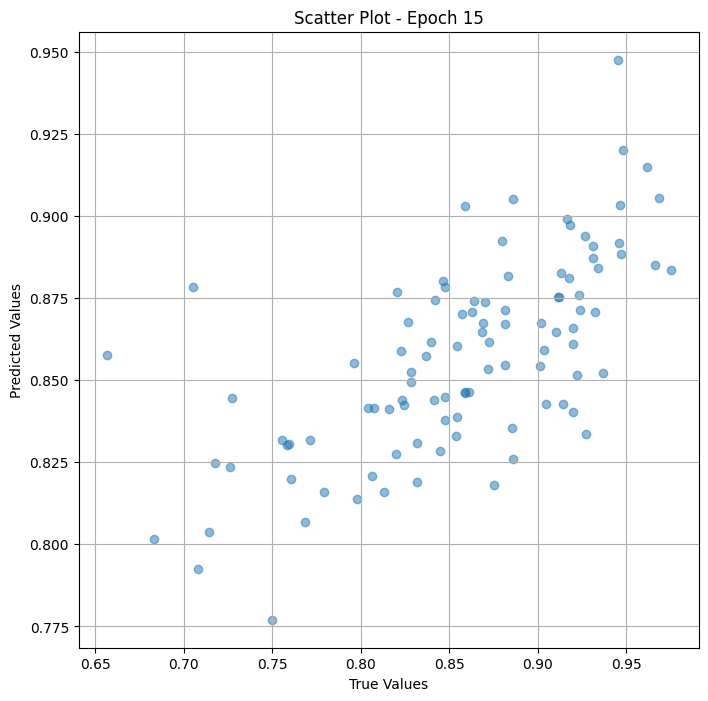

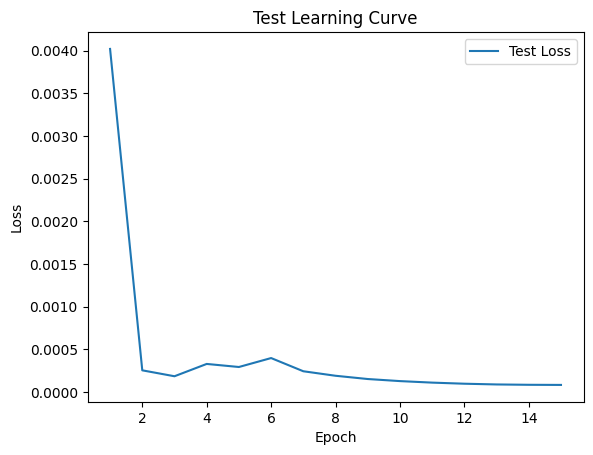


 Epoch: (16/30) Loss = 7.948787970235571e-05

 Epoch: (16/30) Loss_rmse = 0.008915597572922707

 Epoch: (16/30) R^2 = 0.9581605195999146

 Epoch: (16/30) MAE = 0.006365180015563965
Spearman correlation coefficient: SignificanceResult(statistic=0.6749278504850478, pvalue=4.683576000653712e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

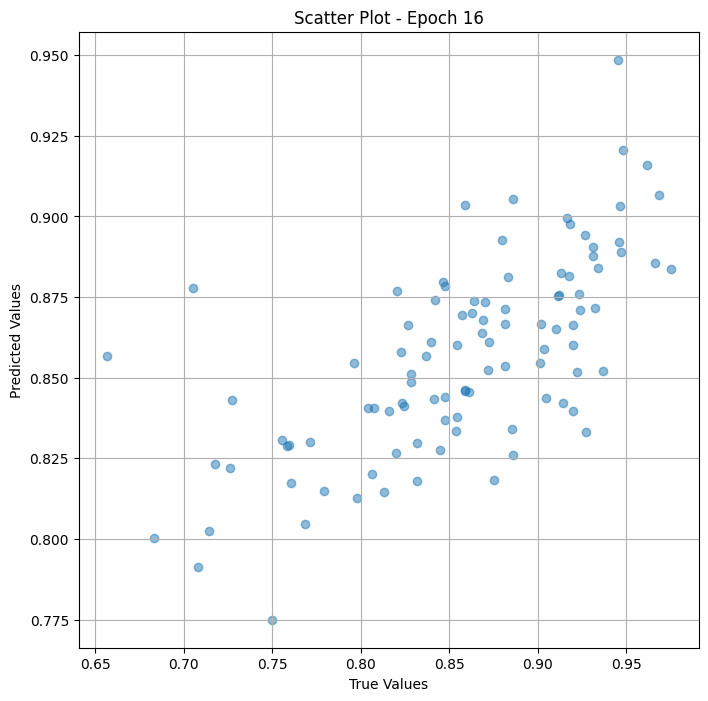

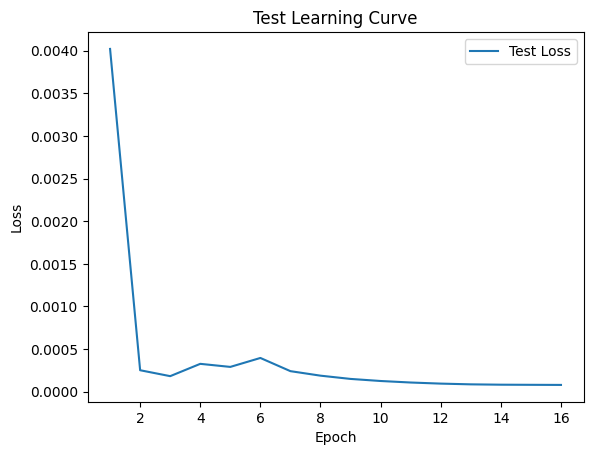


 Epoch: (17/30) Loss = 7.75181979406625e-05

 Epoch: (17/30) Loss_rmse = 0.0088044423609972

 Epoch: (17/30) R^2 = 0.9591972827911377

 Epoch: (17/30) MAE = 0.0065987855195999146
Spearman correlation coefficient: SignificanceResult(statistic=0.6787193132514421, pvalue=2.9849061418352905e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.839

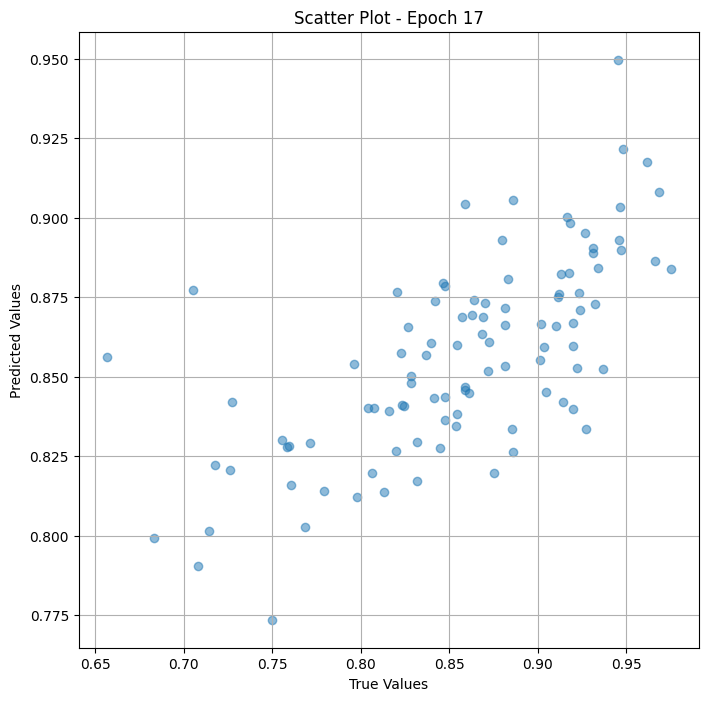

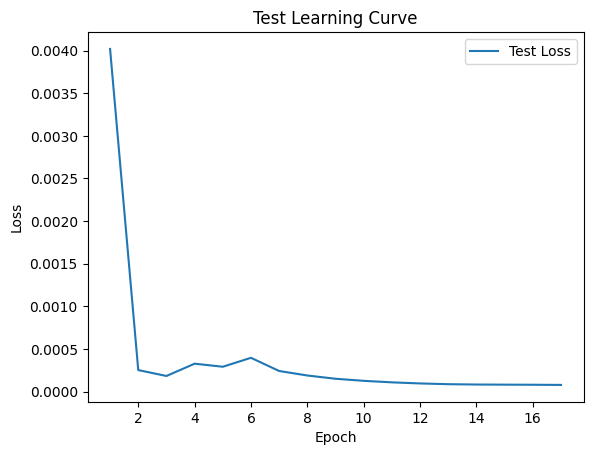


 Epoch: (18/30) Loss = 7.521606312366202e-05

 Epoch: (18/30) Loss_rmse = 0.008672719821333885

 Epoch: (18/30) R^2 = 0.9604090452194214

 Epoch: (18/30) MAE = 0.006755024194717407
Spearman correlation coefficient: SignificanceResult(statistic=0.6872518001210739, pvalue=1.0563282915711598e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

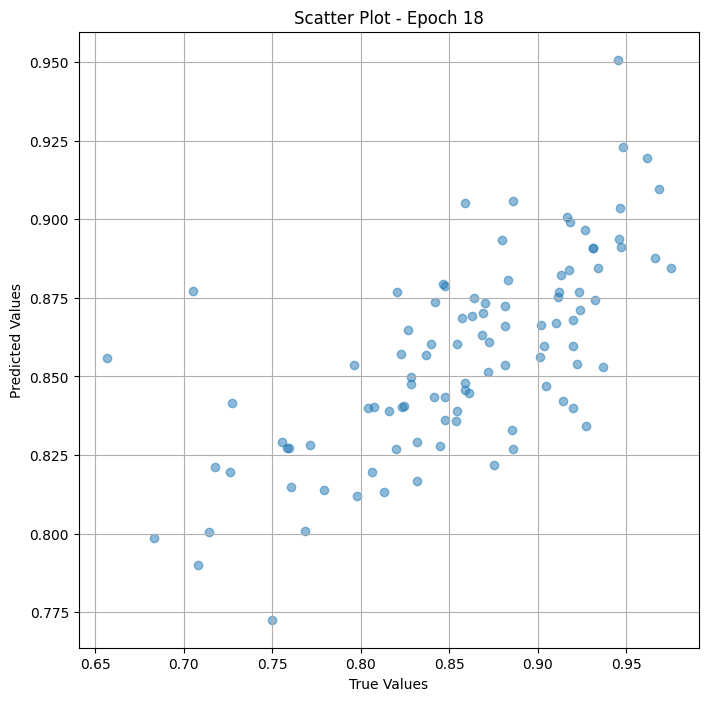

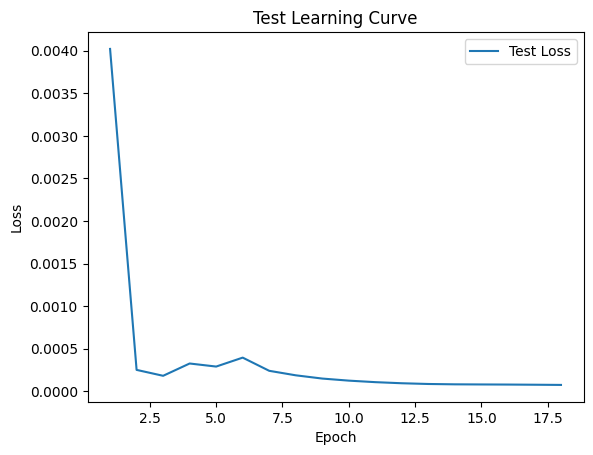


 Epoch: (19/30) Loss = 7.326582999667153e-05

 Epoch: (19/30) Loss_rmse = 0.008559546433389187

 Epoch: (19/30) R^2 = 0.9614355564117432

 Epoch: (19/30) MAE = 0.0068505555391311646
Spearman correlation coefficient: SignificanceResult(statistic=0.699046708440859, pvalue=2.367055922340558e-15)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

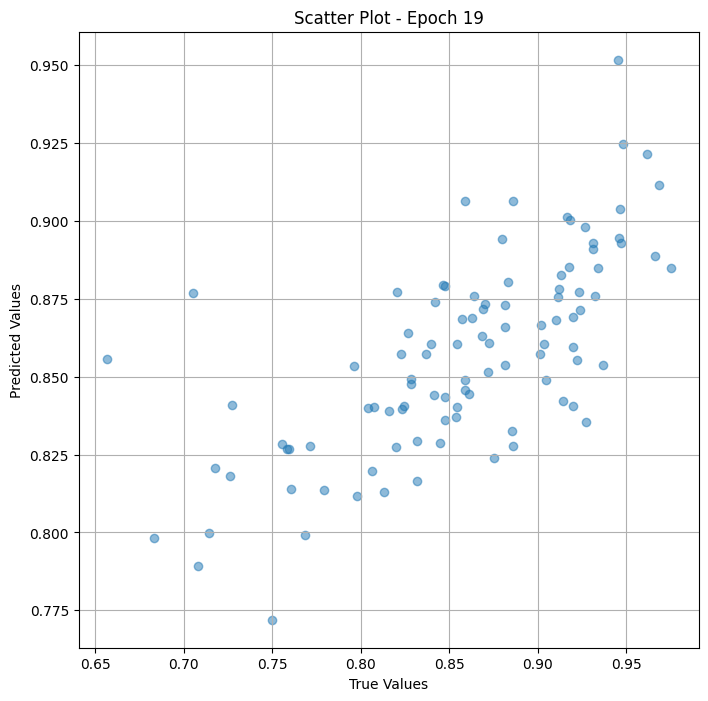

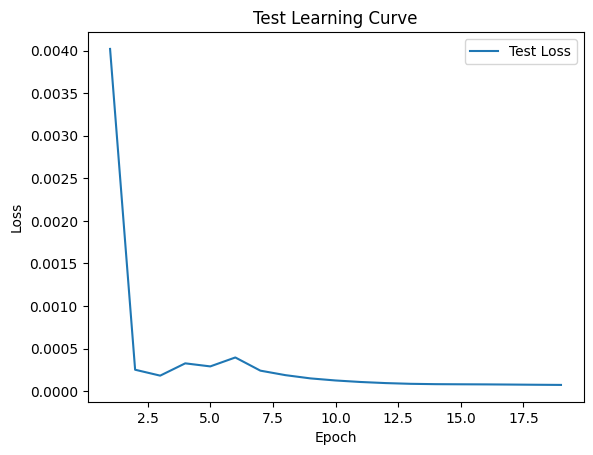


 Epoch: (20/30) Loss = 7.184619607869536e-05

 Epoch: (20/30) Loss_rmse = 0.008476213552057743

 Epoch: (20/30) R^2 = 0.9621828198432922

 Epoch: (20/30) MAE = 0.006901189684867859
Spearman correlation coefficient: SignificanceResult(statistic=0.7103600535112452, pvalue=5.25858968398901e-16)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.839

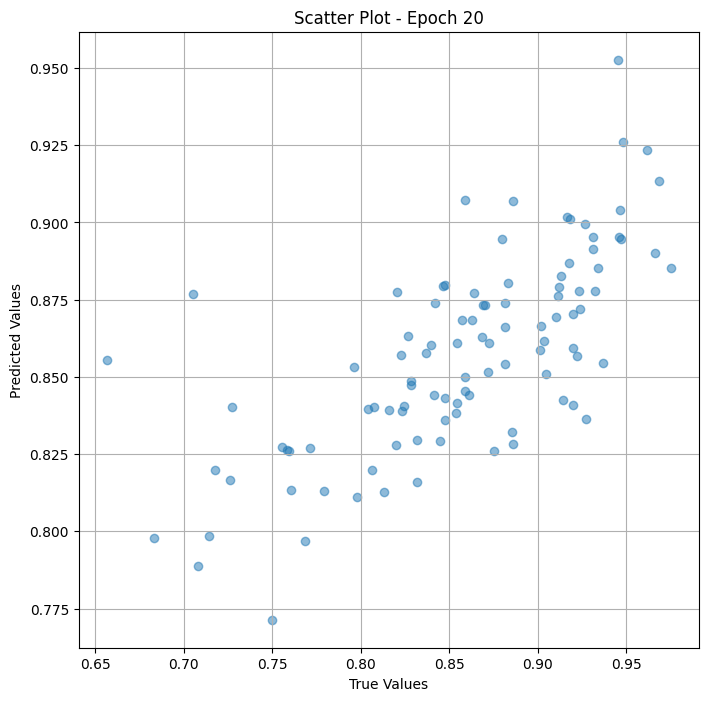

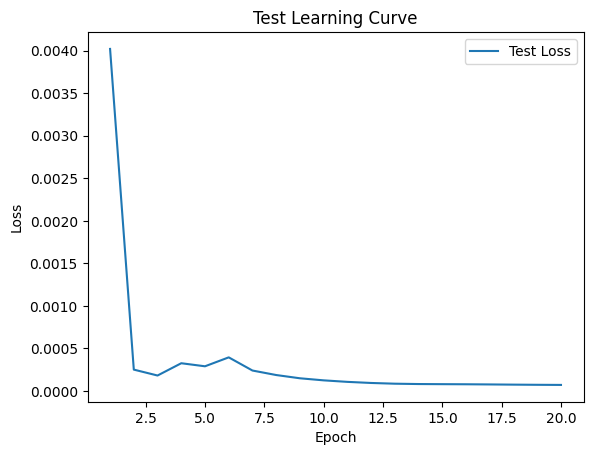


 Epoch: (21/30) Loss = 7.072332664392889e-05

 Epoch: (21/30) Loss_rmse = 0.008409716188907623

 Epoch: (21/30) R^2 = 0.962773859500885

 Epoch: (21/30) MAE = 0.006914377212524414
Spearman correlation coefficient: SignificanceResult(statistic=0.7194147991161407, pvalue=1.4964256899300706e-16)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

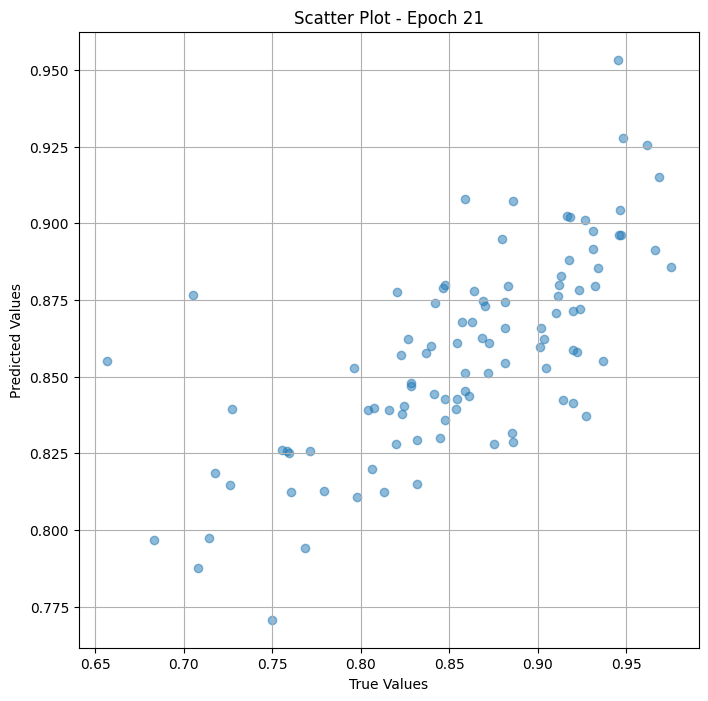

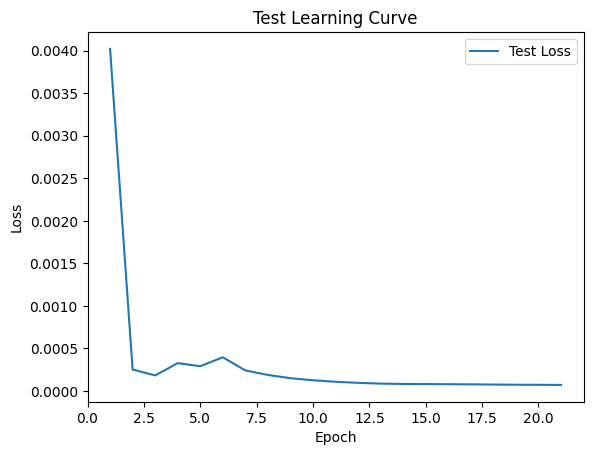


 Epoch: (22/30) Loss = 6.951057002879679e-05

 Epoch: (22/30) Loss_rmse = 0.008337300270795822

 Epoch: (22/30) R^2 = 0.9634122252464294

 Epoch: (22/30) MAE = 0.006884321570396423
Spearman correlation coefficient: SignificanceResult(statistic=0.7259532071784022, pvalue=5.854190255361264e-17)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

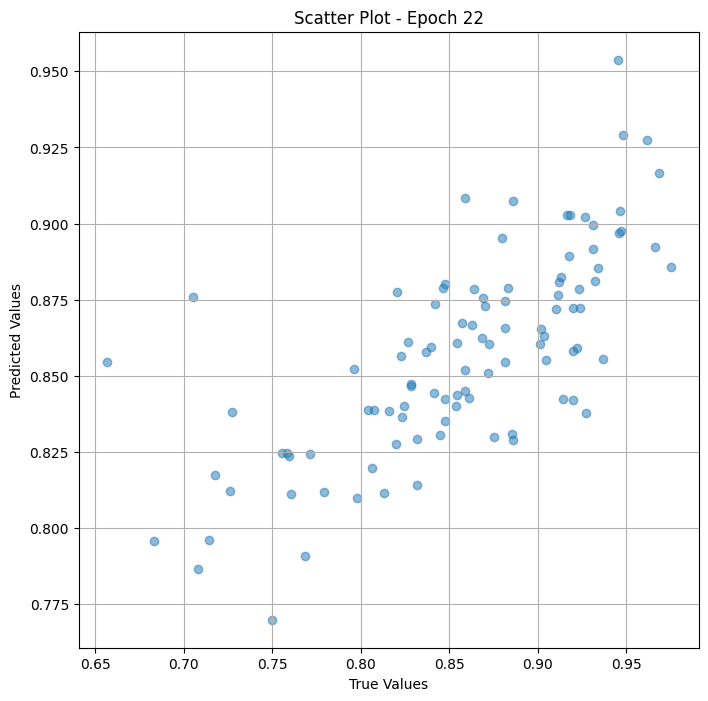

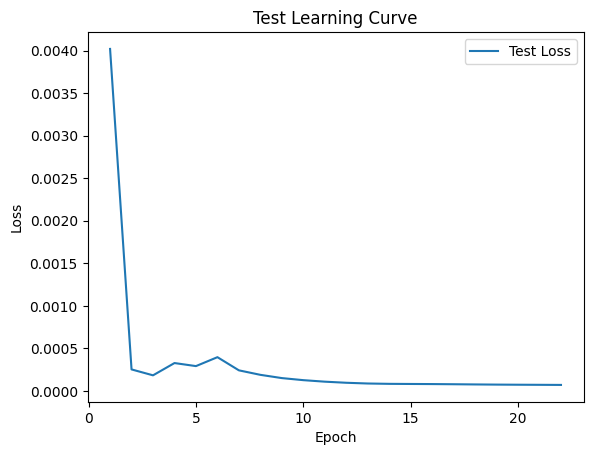


 Epoch: (23/30) Loss = 6.780450348742306e-05

 Epoch: (23/30) Loss_rmse = 0.008234349079430103

 Epoch: (23/30) R^2 = 0.9643102288246155

 Epoch: (23/30) MAE = 0.006796911358833313
Spearman correlation coefficient: SignificanceResult(statistic=0.7360321225108926, pvalue=1.3052447857584323e-17)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

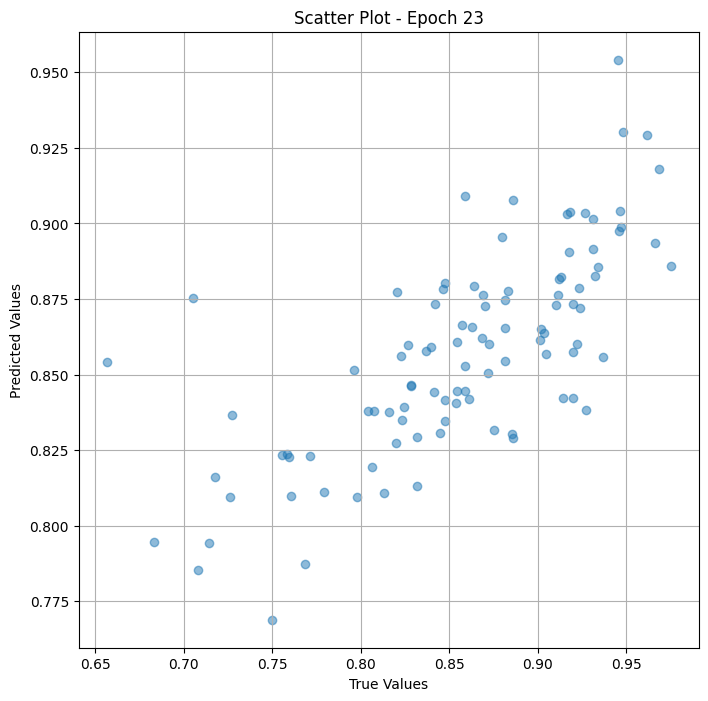

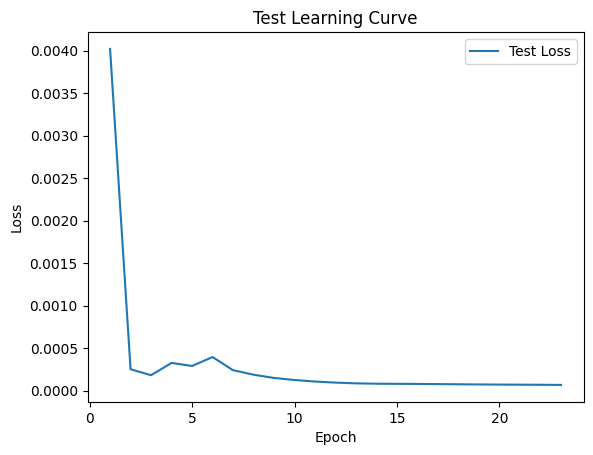


 Epoch: (24/30) Loss = 6.535152351716533e-05

 Epoch: (24/30) Loss_rmse = 0.008084028959274292

 Epoch: (24/30) R^2 = 0.96560138463974

 Epoch: (24/30) MAE = 0.006637647747993469
Spearman correlation coefficient: SignificanceResult(statistic=0.7408613201668367, pvalue=6.205435691695372e-18)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396

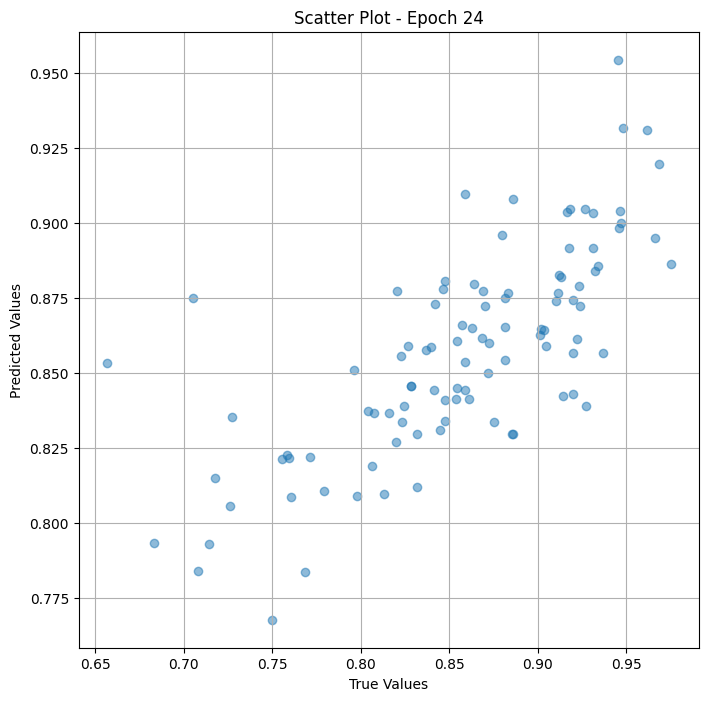

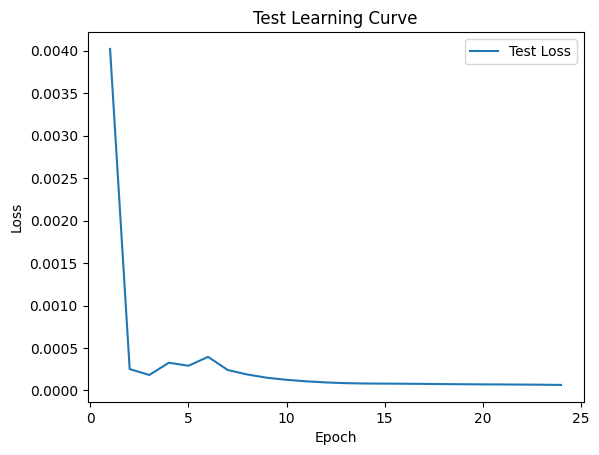


 Epoch: (25/30) Loss = 6.215497705852613e-05

 Epoch: (25/30) Loss_rmse = 0.007883843034505844

 Epoch: (25/30) R^2 = 0.9672839045524597

 Epoch: (25/30) MAE = 0.0064070820808410645
Spearman correlation coefficient: SignificanceResult(statistic=0.7484035502137609, pvalue=1.8787607653234623e-18)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.

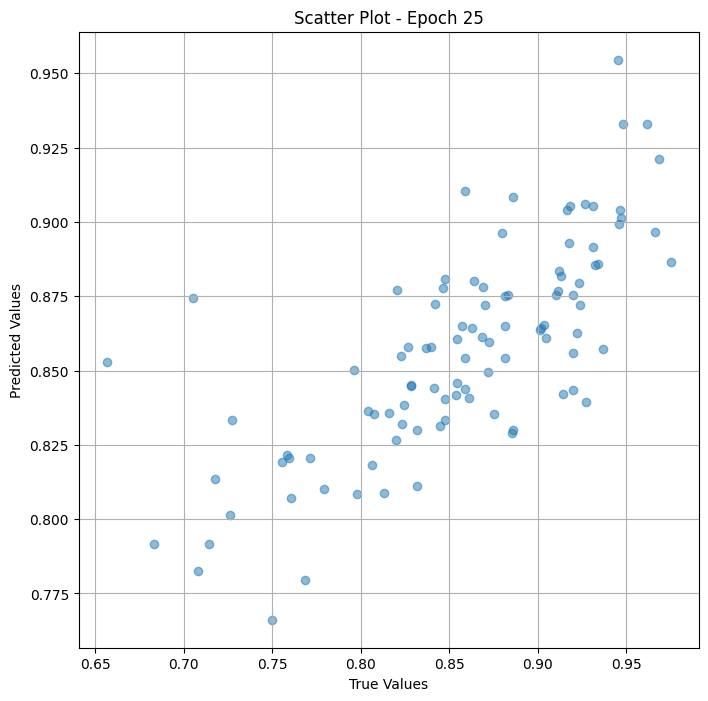

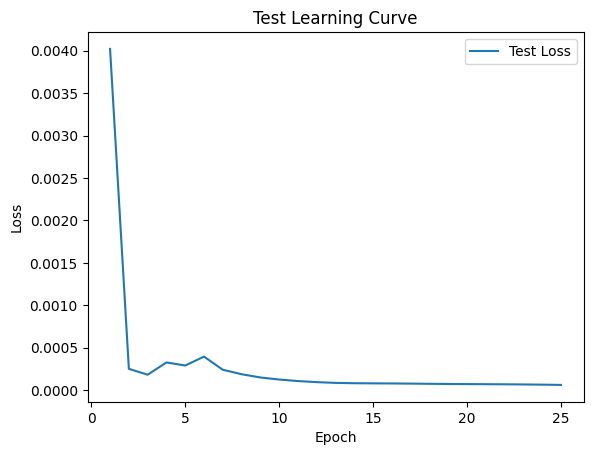


 Epoch: (26/30) Loss = 5.8583398640621454e-05

 Epoch: (26/30) Loss_rmse = 0.007653979118913412

 Epoch: (26/30) R^2 = 0.9691638946533203

 Epoch: (26/30) MAE = 0.0061381906270980835
Spearman correlation coefficient: SignificanceResult(statistic=0.7555930860498576, pvalue=5.778980438258543e-19)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.

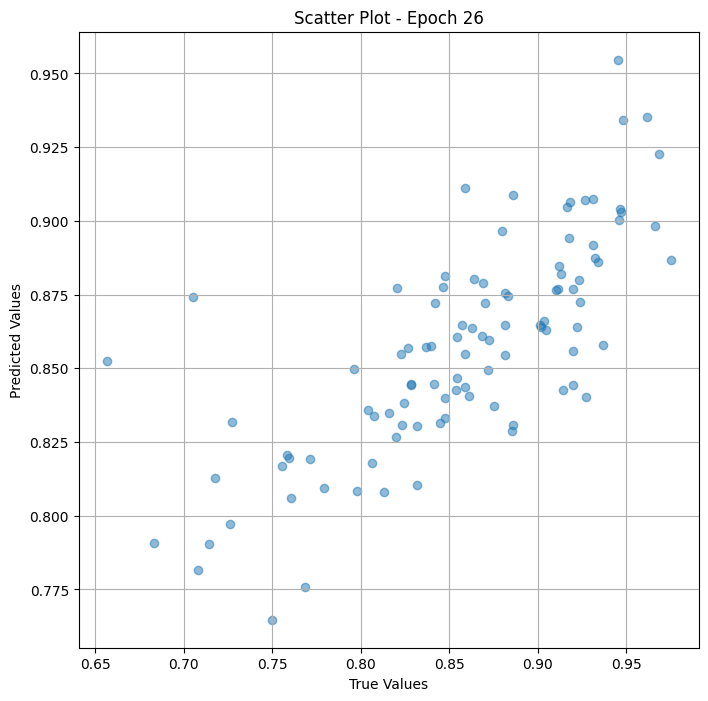

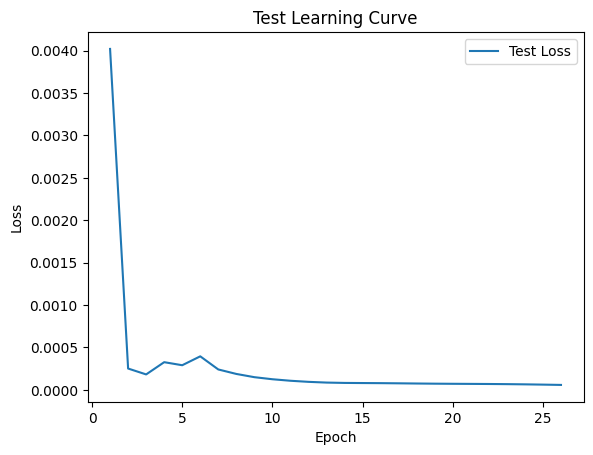


 Epoch: (27/30) Loss = 5.510226765181869e-05

 Epoch: (27/30) Loss_rmse = 0.007423090282827616

 Epoch: (27/30) R^2 = 0.9709962010383606

 Epoch: (27/30) MAE = 0.005886822938919067
Spearman correlation coefficient: SignificanceResult(statistic=0.7644511368064069, pvalue=1.2769405098297756e-19)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

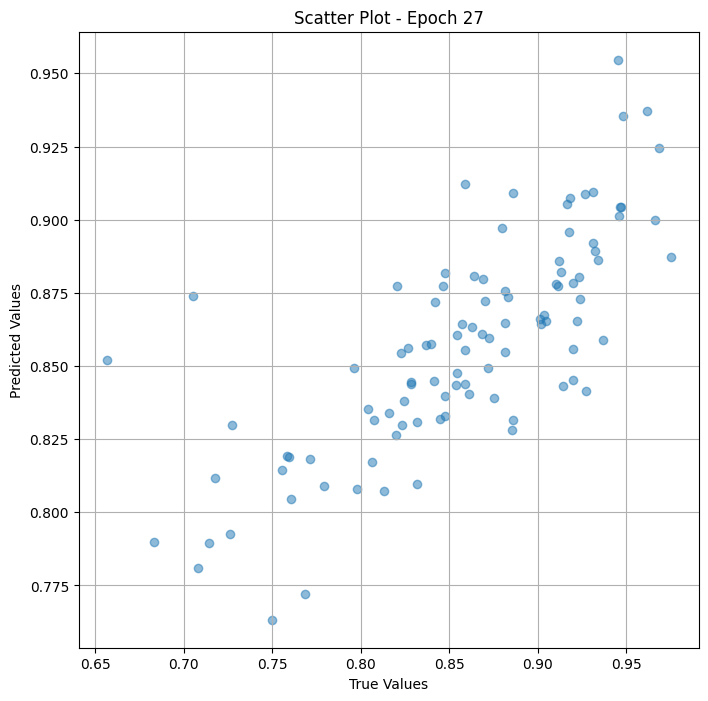

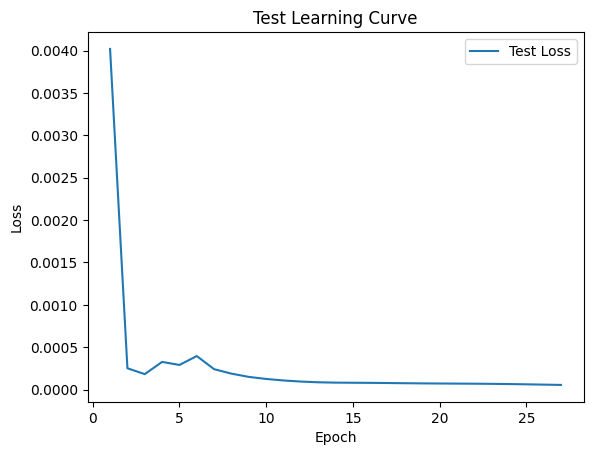


 Epoch: (28/30) Loss = 5.1972387154819444e-05

 Epoch: (28/30) Loss_rmse = 0.007209187839180231

 Epoch: (28/30) R^2 = 0.9726436734199524

 Epoch: (28/30) MAE = 0.005677774548530579
Spearman correlation coefficient: SignificanceResult(statistic=0.7700060706269383, pvalue=4.7880244502592243e-20)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.

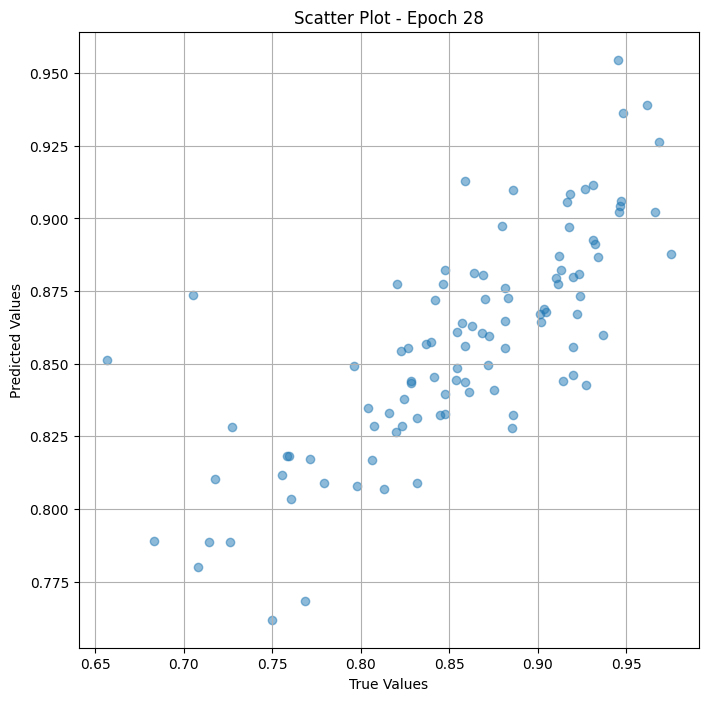

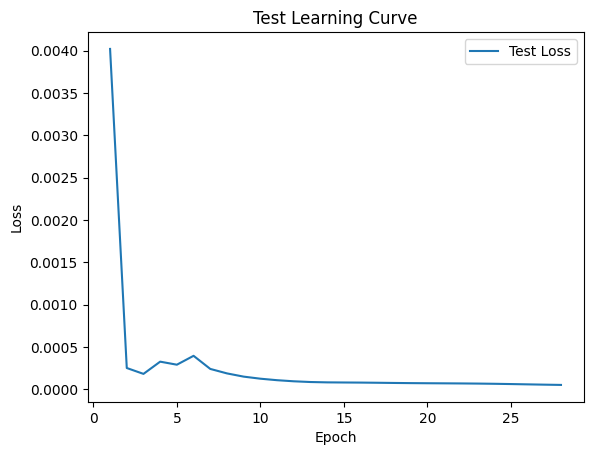


 Epoch: (29/30) Loss = 4.939219797961414e-05

 Epoch: (29/30) Loss_rmse = 0.007027958519756794

 Epoch: (29/30) R^2 = 0.9740017652511597

 Epoch: (29/30) MAE = 0.005494788289070129
Spearman correlation coefficient: SignificanceResult(statistic=0.7781749370828782, pvalue=1.0753355481551633e-20)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

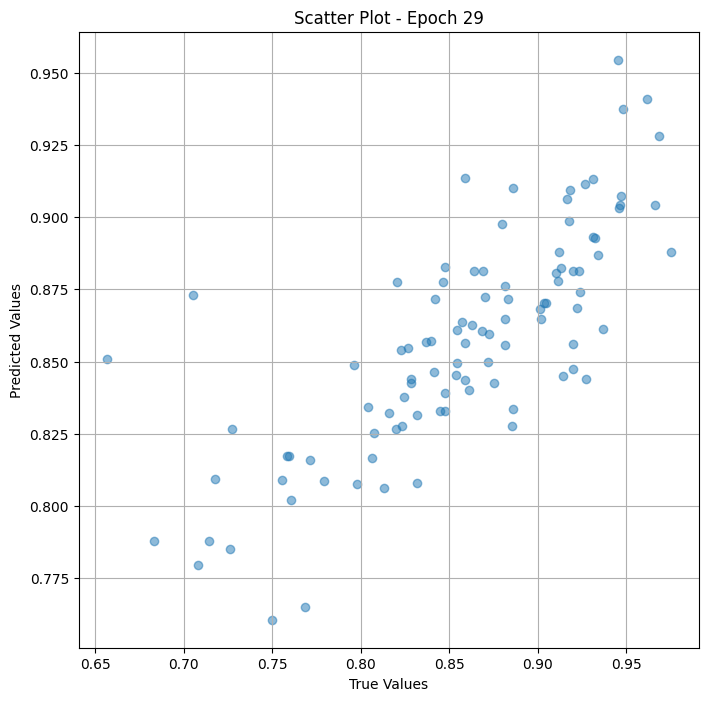

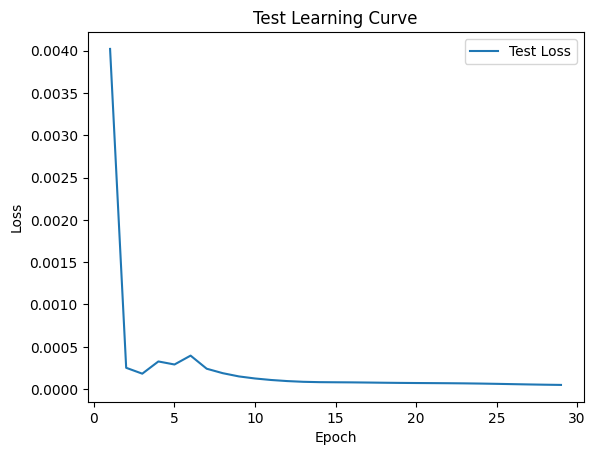


 Epoch: (30/30) Loss = 4.733315290650353e-05

 Epoch: (30/30) Loss_rmse = 0.0068799094296991825

 Epoch: (30/30) R^2 = 0.9750855565071106

 Epoch: (30/30) MAE = 0.005402237176895142
Spearman correlation coefficient: SignificanceResult(statistic=0.7867658282222167, pvalue=2.084885310278671e-21)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

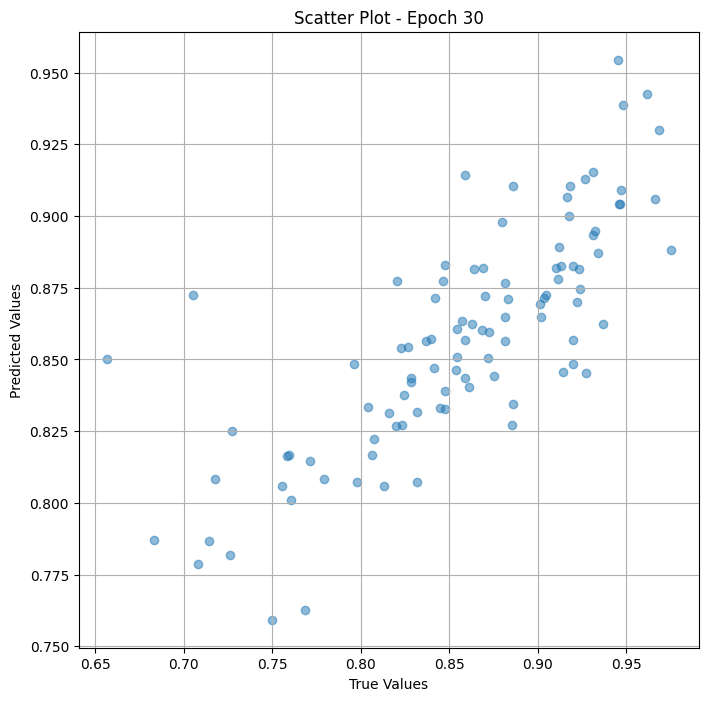

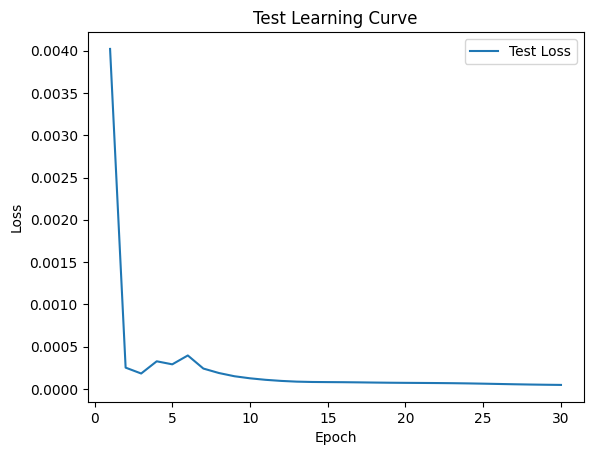

In [ ]:
# val the model and save weights
fit(30, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_food' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_test_food['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                        Image Path  True Value  \
0      /content/food/000000374451_preprocessed.jpg    0.760417   
1   /content/food/n07863374_17242_preprocessed.jpg    0.881188   
2    /content/food/n07583197_3923_preprocessed.jpg    0.803922   
3      /content/food/000000445557_preprocessed.jpg    0.923729   
4      /content/food/000000435488_preprocessed.jpg    0.857143   
..                                             ...         ...   
95     /content/food/000000245540_preprocessed.jpg    0.885965   
96  /content/food/n07933274_29270_preprocessed.jpg    0.831579   
97  /content/food/n07716358_11986_preprocessed.jpg    0.945455   
98   /content/food/n07693725_8046_preprocessed.jpg    0.916667   
99     /content/food/000000439537_preprocessed.jpg    0.869919   

    Predicted Value  
0          0.849890  
1          0.866117  
2          0.870264  
3          0.841594  
4          0.808364  
..              ...  
95         0.931886  
96         0.869234  
97       

#Finetuning

##Train

In [ ]:
class Dataset_train_fine_food(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_food["memoscore"]
        self.images = df_train_food["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds_fine = Dataset_train_fine_food(df_train_food, trans_transform=trans_transform)
train_dl_fine = DataLoader(train_ds_fine, batch_size=16, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


'for image_trans, label in train_dl:\n    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch\n    print(image_trans)\n    break'

In [ ]:
class ViTMem_model_fine_food(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_fine =  ViTMem_model_fine_food( arch="vit_base_patch16_224_miil")

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_fine = DeviceDataLoader(train_dl_fine, device)
model_vit_fine  = to_device(model_vit_fine  , device)

In [ ]:
params = [param for param in list(model_vit_fine.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_fine, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_fine.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_fine(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.003611905500292778

 Epoch: (1/30) Loss_rmse = 0.06009913235902786

 Epoch: (1/30) R^2 = -1.4391770362854004

 Epoch: (1/30) MAE = 0.051665328443050385
Spearman correlation coefficient: SignificanceResult(statistic=0.15868641254068297, pvalue=1.4216960691359044e-11)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0

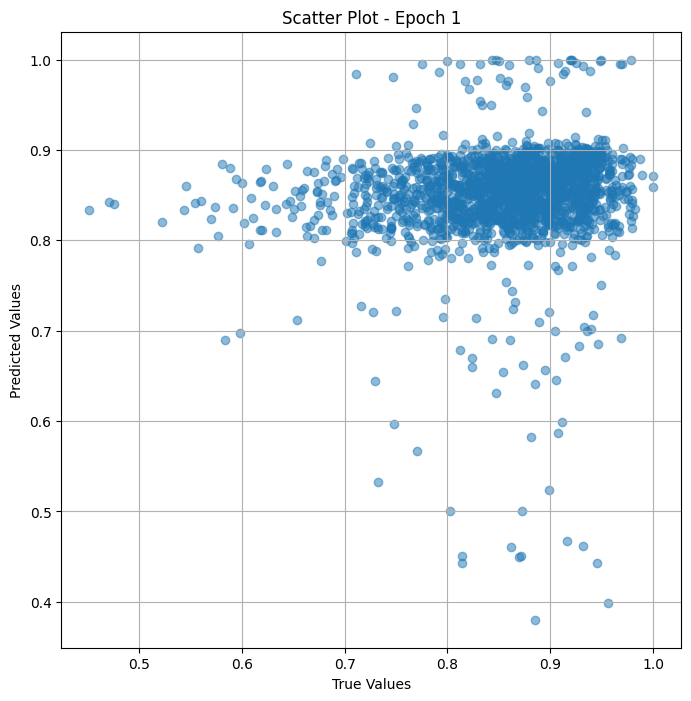

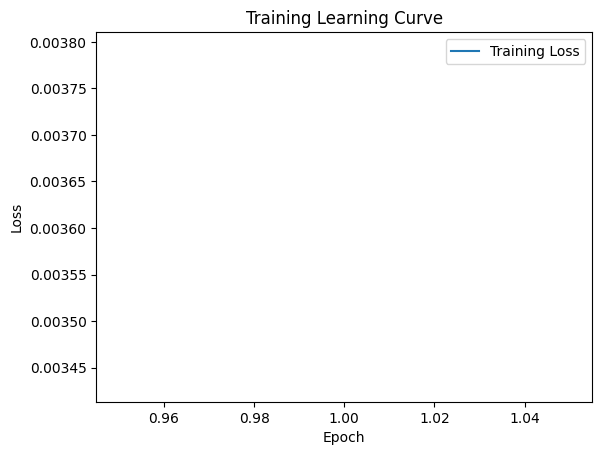


 Epoch: (2/30) Loss = 0.0019444557838141918

 Epoch: (2/30) Loss_rmse = 0.04409598559141159

 Epoch: (2/30) R^2 = -0.3131217956542969

 Epoch: (2/30) MAE = 0.034006841480731964
Spearman correlation coefficient: SignificanceResult(statistic=0.4273975869132185, pvalue=1.7372862766069767e-80)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0

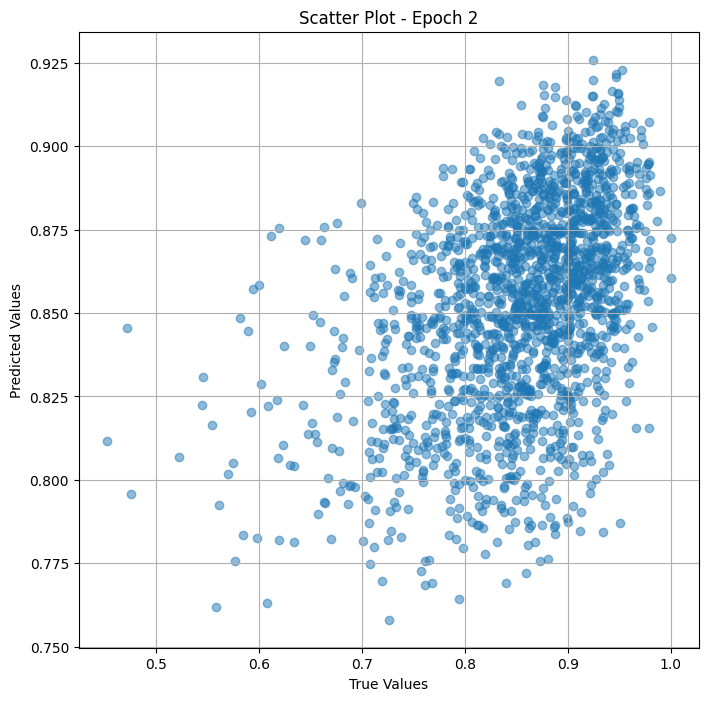

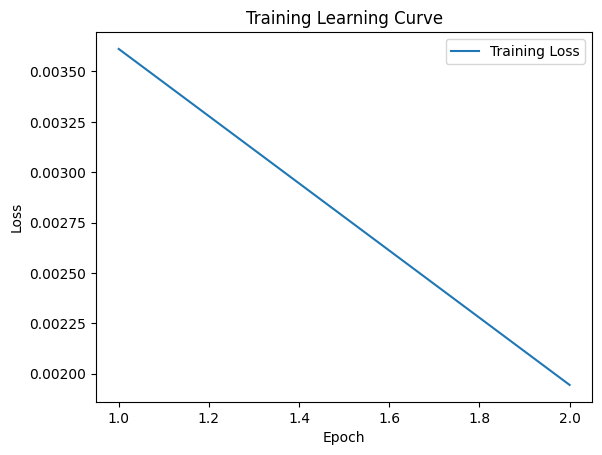


 Epoch: (3/30) Loss = 0.0008769750129431486

 Epoch: (3/30) Loss_rmse = 0.029613763093948364

 Epoch: (3/30) R^2 = 0.40776485204696655

 Epoch: (3/30) MAE = 0.026126421988010406
Spearman correlation coefficient: SignificanceResult(statistic=0.5574320175505023, pvalue=7.708340951953271e-147)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 

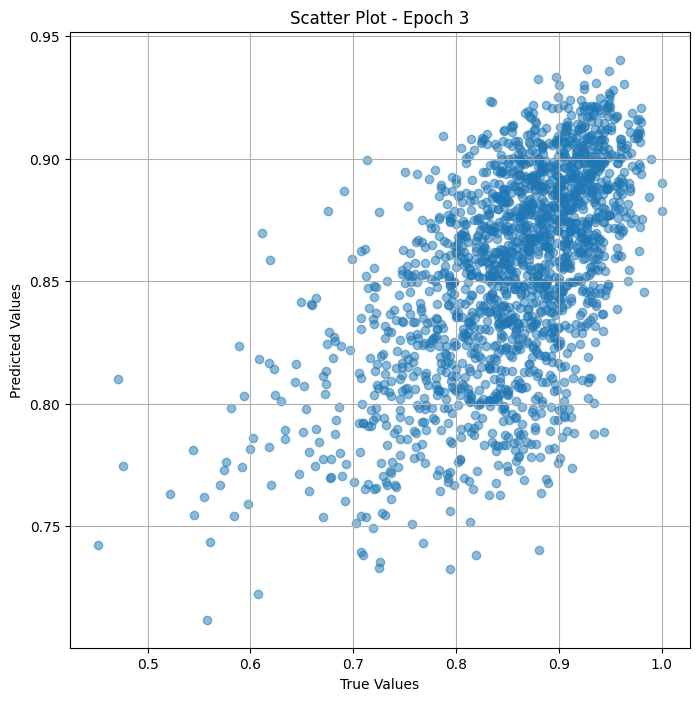

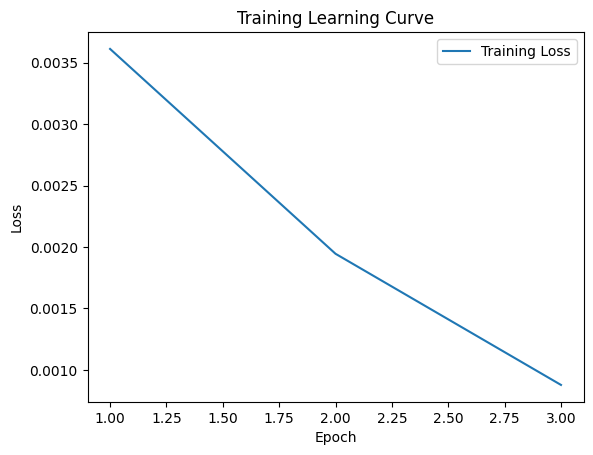


 Epoch: (4/30) Loss = 0.0007351802196353674

 Epoch: (4/30) Loss_rmse = 0.027114206925034523

 Epoch: (4/30) R^2 = 0.5035211443901062

 Epoch: (4/30) MAE = 0.02417658269405365
Spearman correlation coefficient: SignificanceResult(statistic=0.6681896778835662, pvalue=3.600527771904591e-232)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.

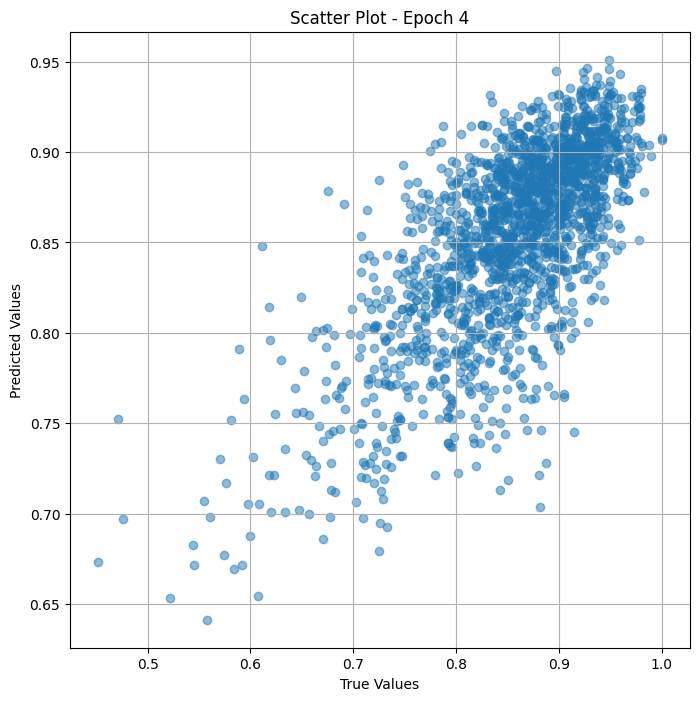

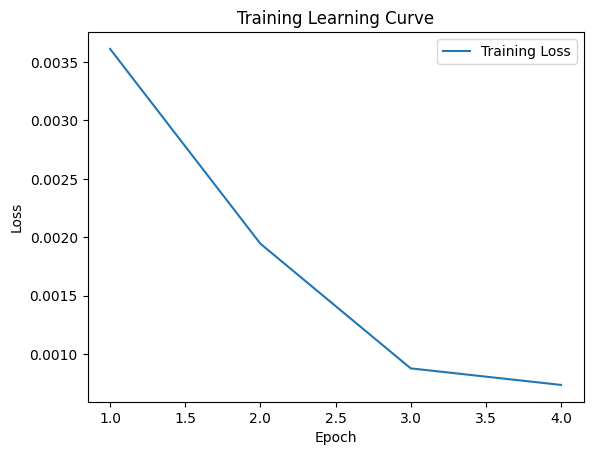


 Epoch: (5/30) Loss = 0.0006778761162422597

 Epoch: (5/30) Loss_rmse = 0.026036053895950317

 Epoch: (5/30) R^2 = 0.5422195196151733

 Epoch: (5/30) MAE = 0.022192470729351044
Spearman correlation coefficient: SignificanceResult(statistic=0.787599679936035, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611111,

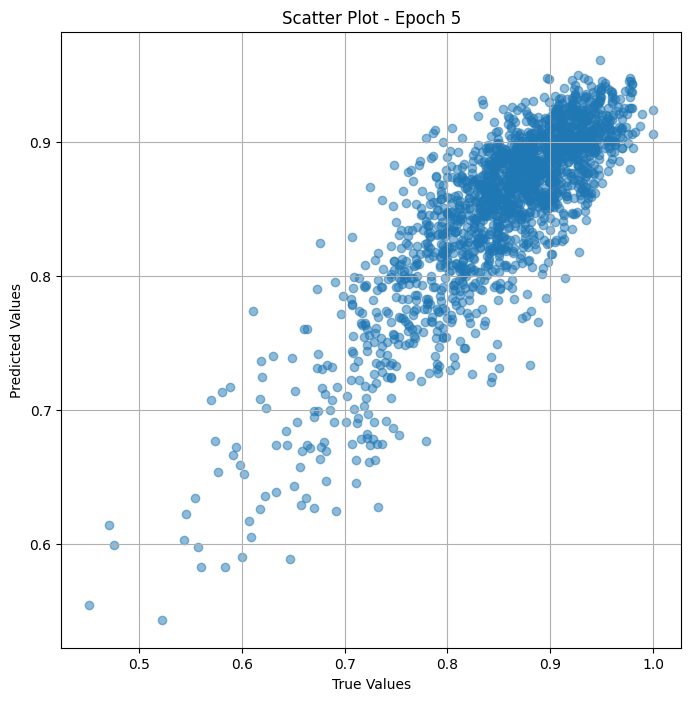

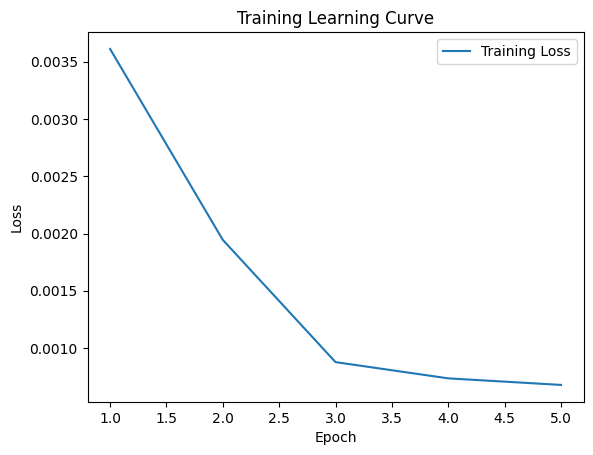


 Epoch: (6/30) Loss = 0.0010244399309158325

 Epoch: (6/30) Loss_rmse = 0.032006874680519104

 Epoch: (6/30) R^2 = 0.30817949771881104

 Epoch: (6/30) MAE = 0.027921609580516815
Spearman correlation coefficient: SignificanceResult(statistic=0.7288319021503475, pvalue=8.910077818437002e-297)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 

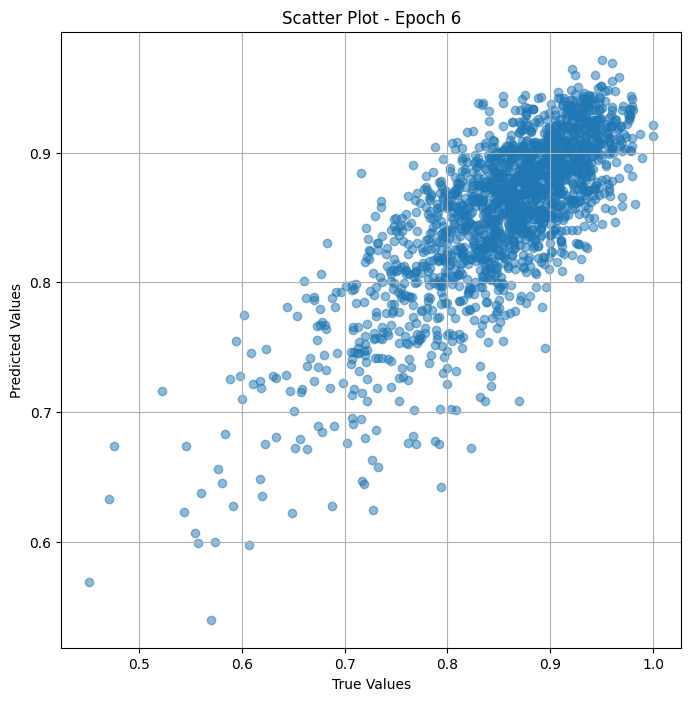

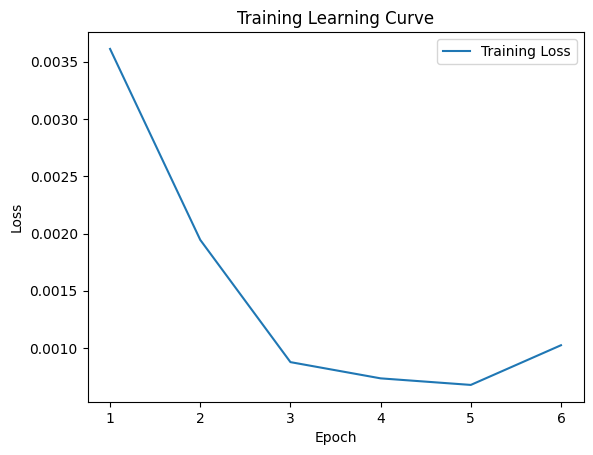


 Epoch: (7/30) Loss = 0.0011860696831718087

 Epoch: (7/30) Loss_rmse = 0.034439362585544586

 Epoch: (7/30) R^2 = 0.19902831315994263

 Epoch: (7/30) MAE = 0.03302399069070816
Spearman correlation coefficient: SignificanceResult(statistic=0.7788457857749229, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611111

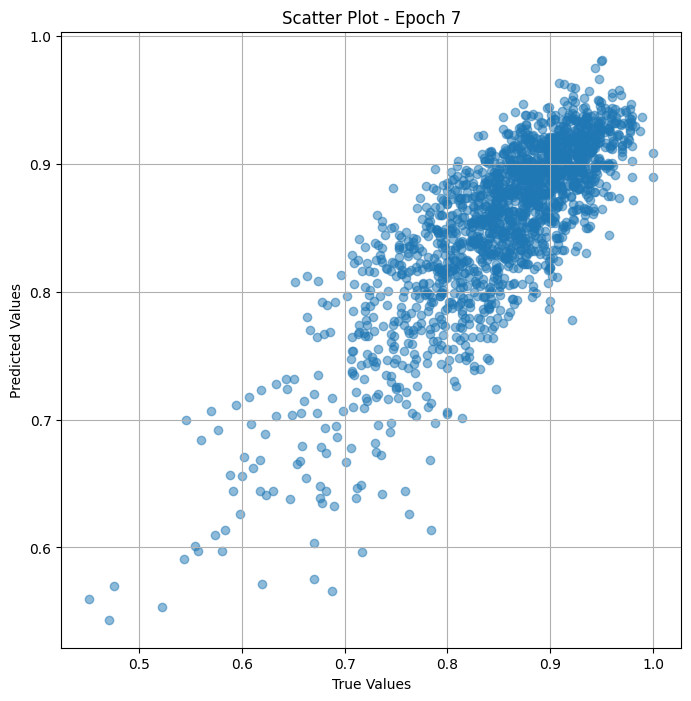

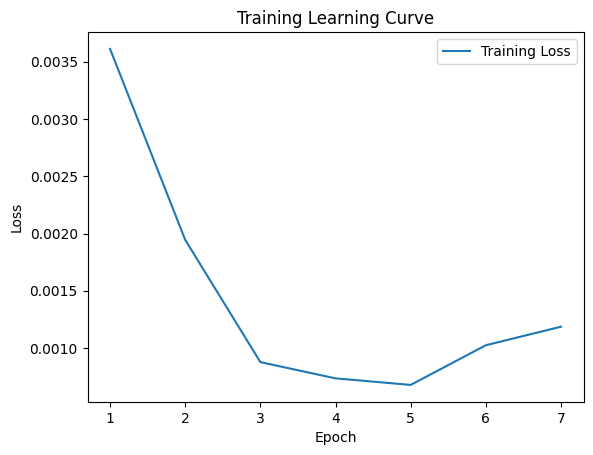


 Epoch: (8/30) Loss = 0.0005307056708261371

 Epoch: (8/30) Loss_rmse = 0.023037049919366837

 Epoch: (8/30) R^2 = 0.6416060328483582

 Epoch: (8/30) MAE = 0.01801721751689911
Spearman correlation coefficient: SignificanceResult(statistic=0.7976919549882509, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611111,

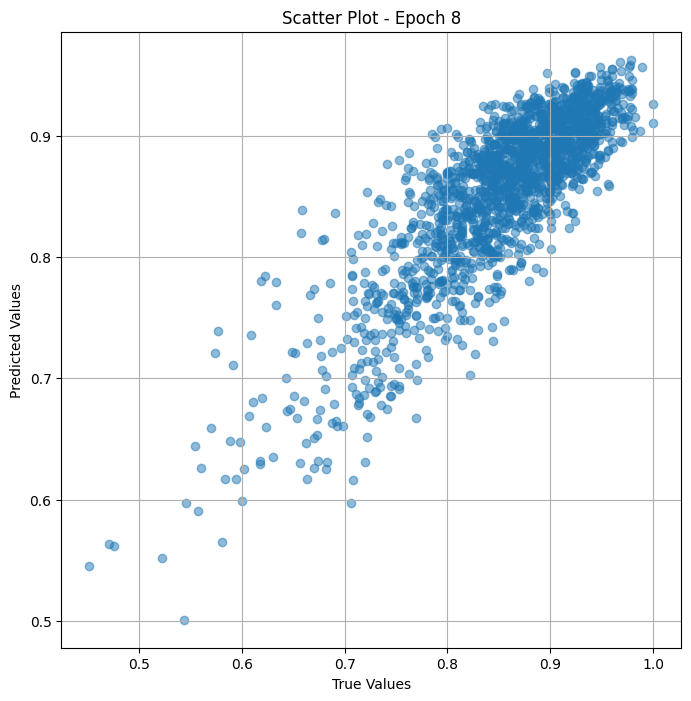

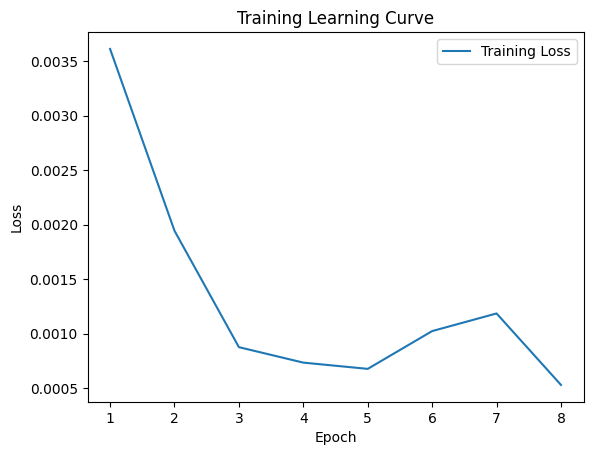


 Epoch: (9/30) Loss = 0.0009085986530408263

 Epoch: (9/30) Loss_rmse = 0.030142970383167267

 Epoch: (9/30) R^2 = 0.3864089250564575

 Epoch: (9/30) MAE = 0.028452813625335693
Spearman correlation coefficient: SignificanceResult(statistic=0.843851506207535, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611111,

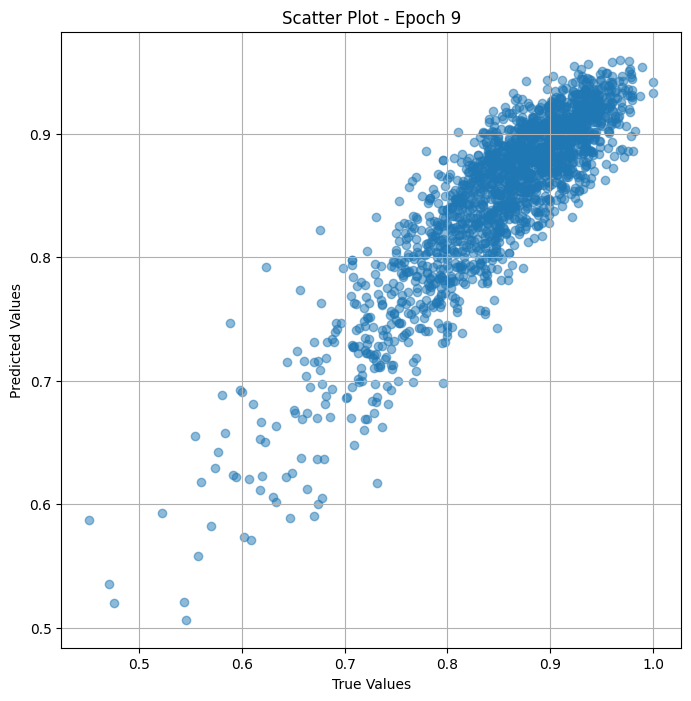

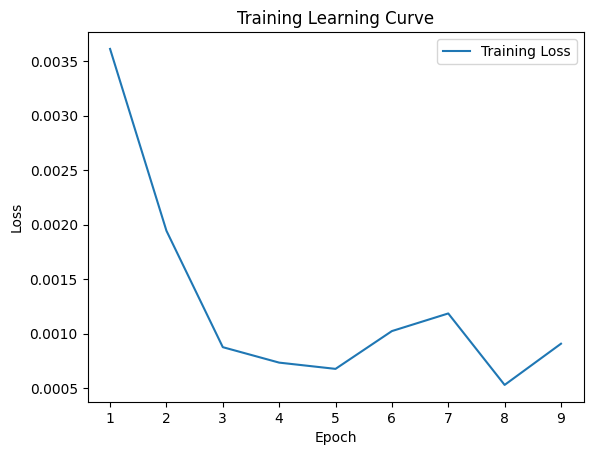


 Epoch: (10/30) Loss = 0.000374933413695544

 Epoch: (10/30) Loss_rmse = 0.019363196566700935

 Epoch: (10/30) R^2 = 0.746801495552063

 Epoch: (10/30) MAE = 0.016822054982185364
Spearman correlation coefficient: SignificanceResult(statistic=0.8448490707131515, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.86111

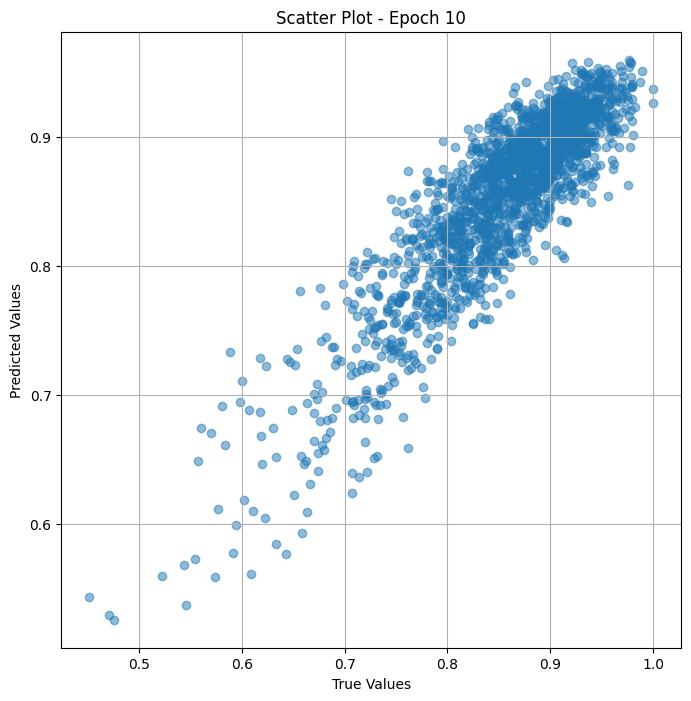

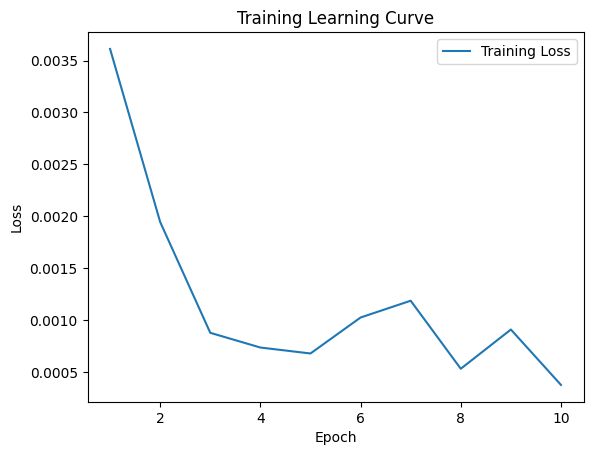


 Epoch: (11/30) Loss = 0.00012611961574293673

 Epoch: (11/30) Loss_rmse = 0.01123029924929142

 Epoch: (11/30) R^2 = 0.914829432964325

 Epoch: (11/30) MAE = 0.009518243372440338
Spearman correlation coefficient: SignificanceResult(statistic=0.8123128054908274, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

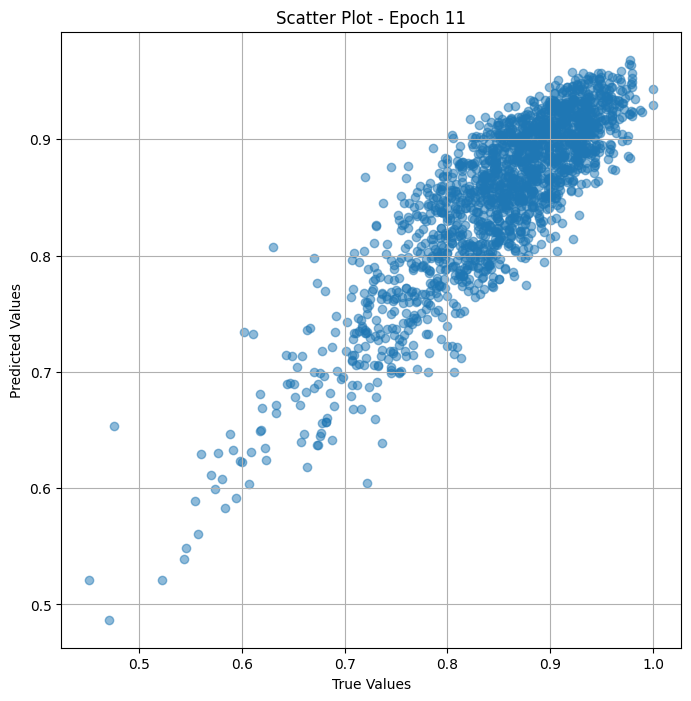

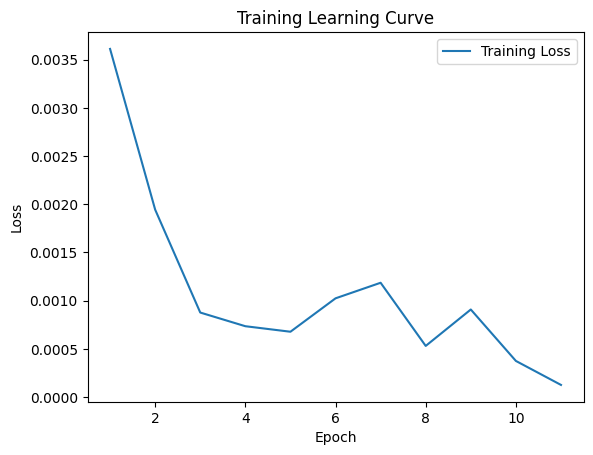


 Epoch: (12/30) Loss = 0.0008808946004137397

 Epoch: (12/30) Loss_rmse = 0.02967986837029457

 Epoch: (12/30) R^2 = 0.405117928981781

 Epoch: (12/30) MAE = 0.02485170215368271
Spearman correlation coefficient: SignificanceResult(statistic=0.8639835671872518, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861111

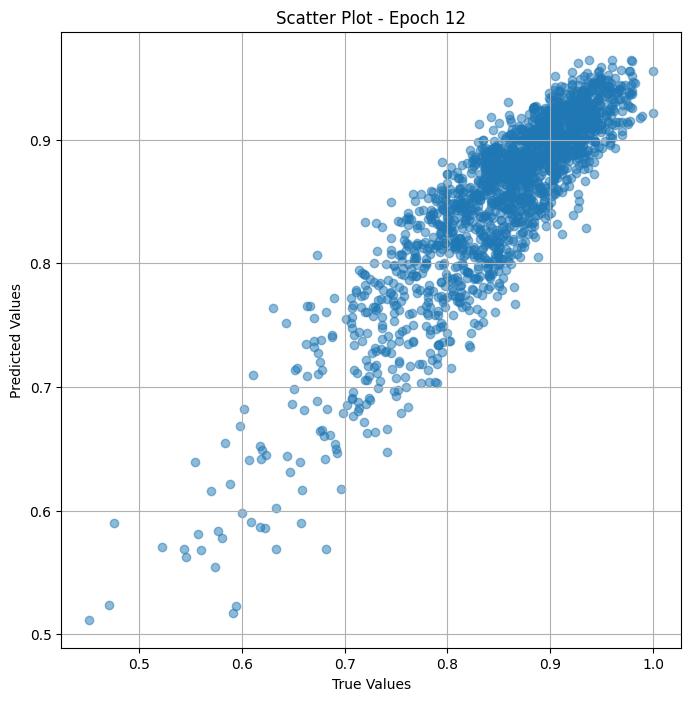

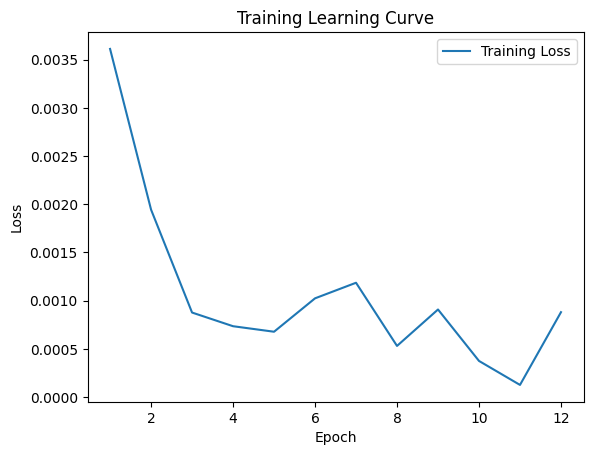


 Epoch: (13/30) Loss = 0.0003778092213906348

 Epoch: (13/30) Loss_rmse = 0.019437314942479134

 Epoch: (13/30) R^2 = 0.7448594570159912

 Epoch: (13/30) MAE = 0.018392130732536316
Spearman correlation coefficient: SignificanceResult(statistic=0.8951781980570992, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

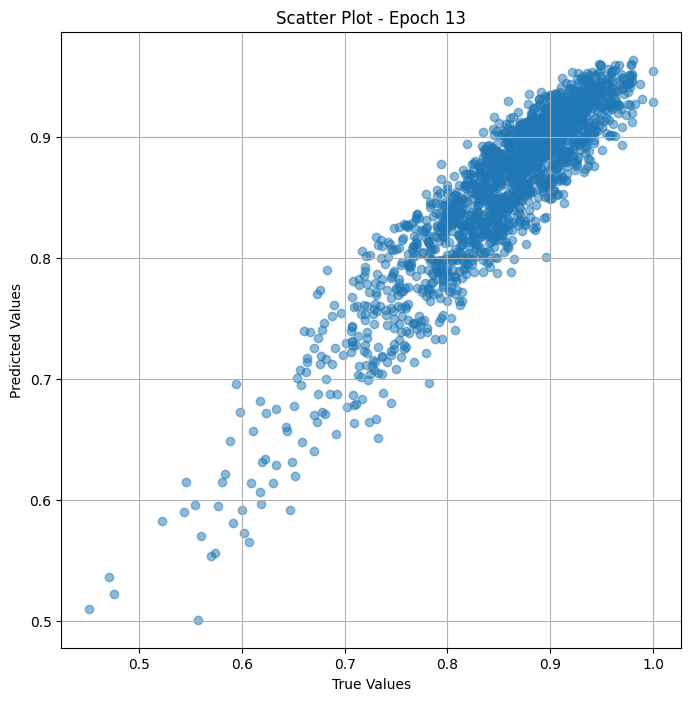

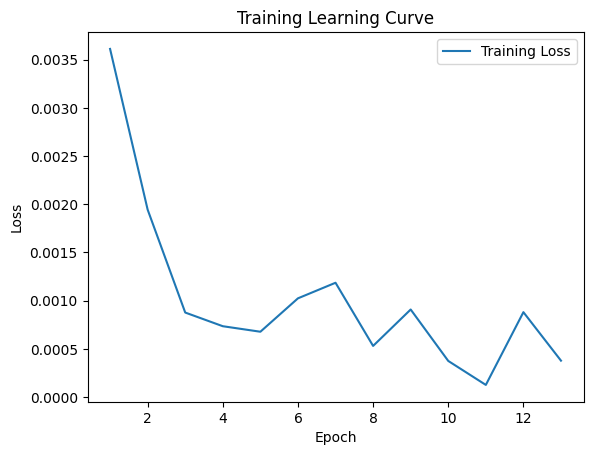

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (14/30) Loss = 0.00017408347048331052

 Epoch: (14/30) Loss_rmse = 0.013194069266319275

 Epoch: (14/30) R^2 = 0.8824386596679688

 Epoch: (14/30) MAE = 0.011563003063201904
Spearman correlation coefficient: SignificanceResult(statistic=0.9293689702897788, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.91452

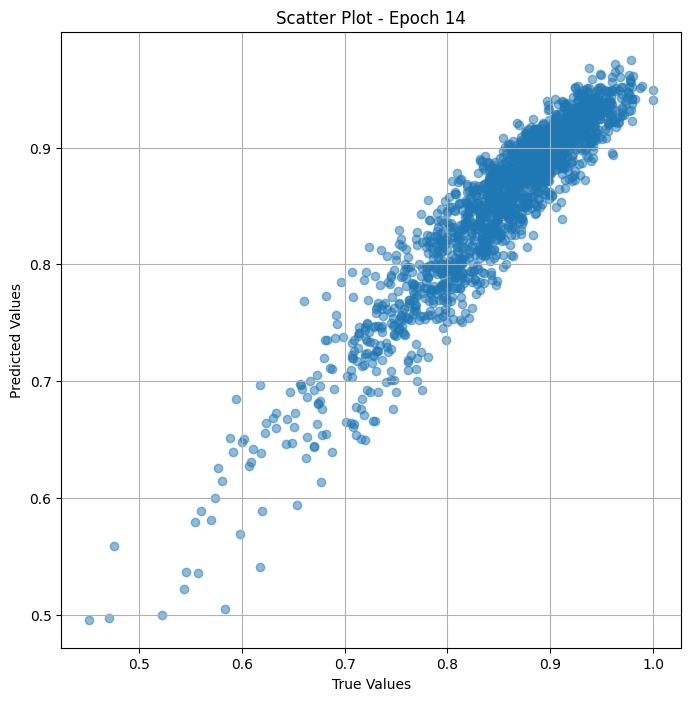

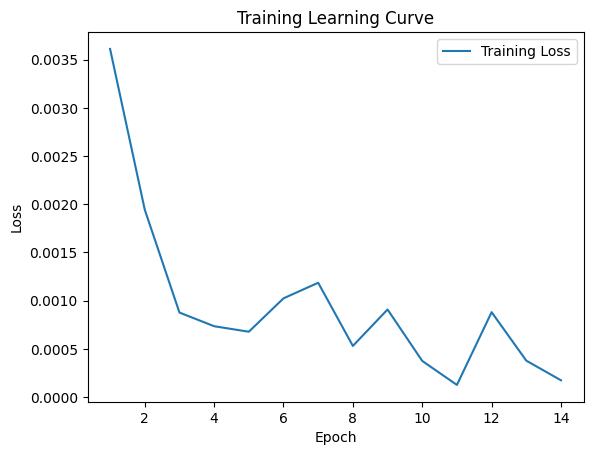


 Epoch: (15/30) Loss = 0.0001319842122029513

 Epoch: (15/30) Loss_rmse = 0.011488438583910465

 Epoch: (15/30) R^2 = 0.9108690023422241

 Epoch: (15/30) MAE = 0.01004202663898468
Spearman correlation coefficient: SignificanceResult(statistic=0.9789676458706594, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

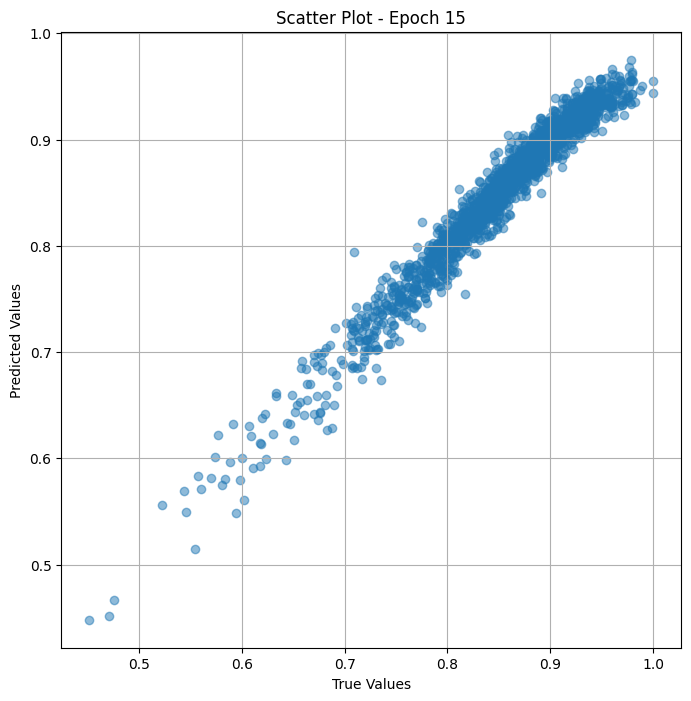

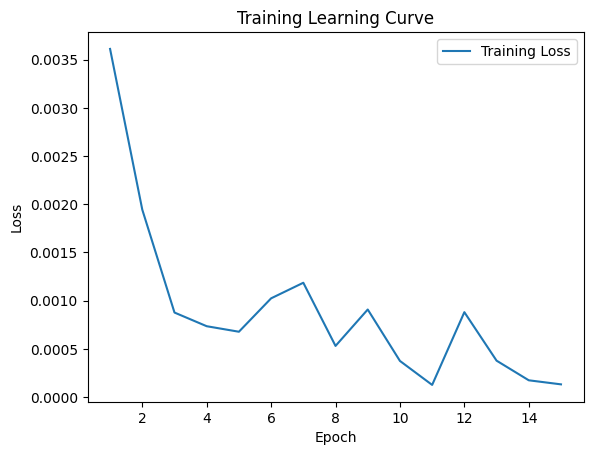


 Epoch: (16/30) Loss = 0.0001038973277900368

 Epoch: (16/30) Loss_rmse = 0.01019300427287817

 Epoch: (16/30) R^2 = 0.9298365116119385

 Epoch: (16/30) MAE = 0.008877471089363098
Spearman correlation coefficient: SignificanceResult(statistic=0.9828432292132085, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

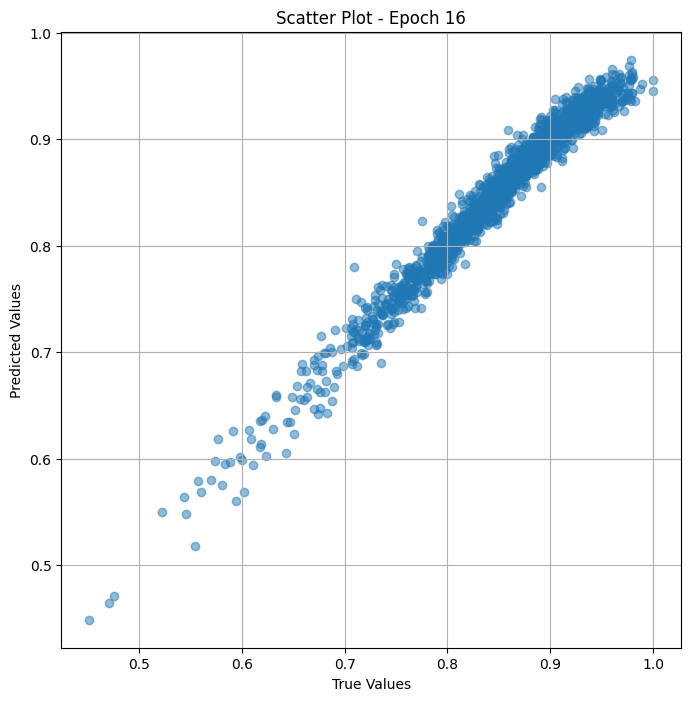

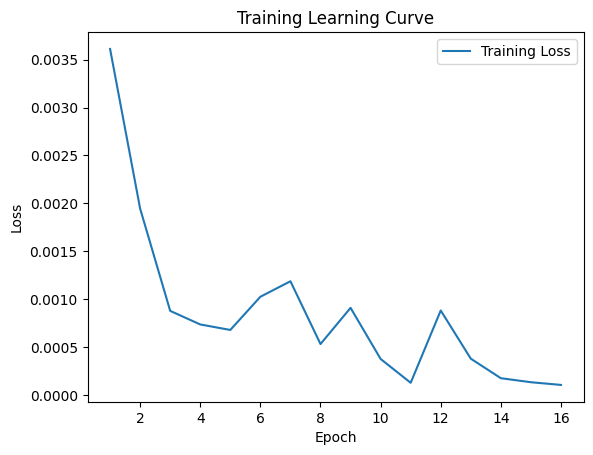


 Epoch: (17/30) Loss = 8.556091052014381e-05

 Epoch: (17/30) Loss_rmse = 0.009249914437532425

 Epoch: (17/30) R^2 = 0.9422193765640259

 Epoch: (17/30) MAE = 0.008249402046203613
Spearman correlation coefficient: SignificanceResult(statistic=0.9847689456747852, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

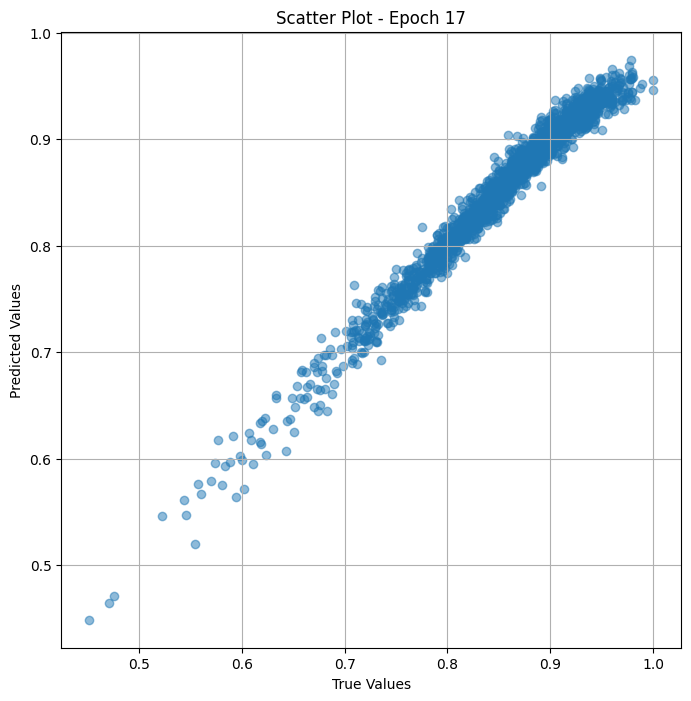

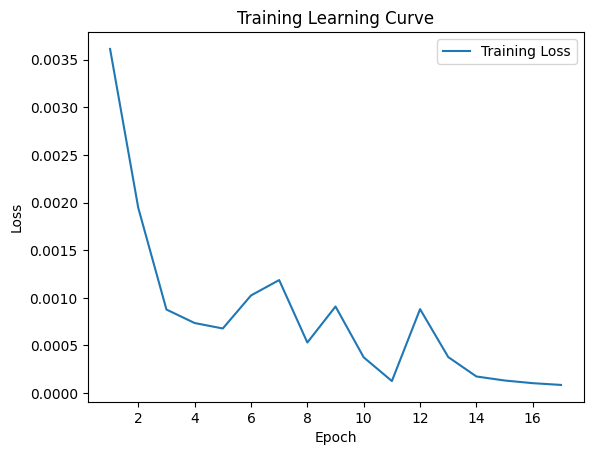


 Epoch: (18/30) Loss = 7.192074554041028e-05

 Epoch: (18/30) Loss_rmse = 0.008480610325932503

 Epoch: (18/30) R^2 = 0.9514307975769043

 Epoch: (18/30) MAE = 0.00768665224313736
Spearman correlation coefficient: SignificanceResult(statistic=0.9863334858392467, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

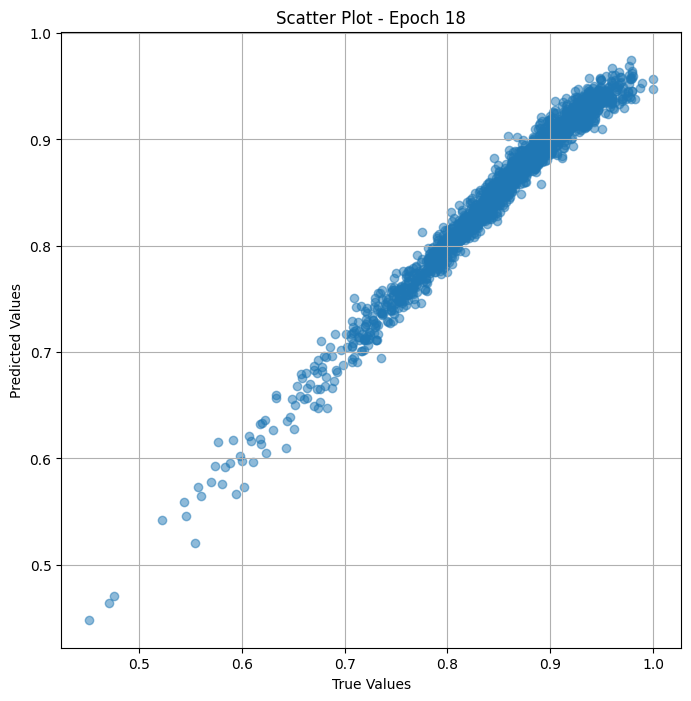

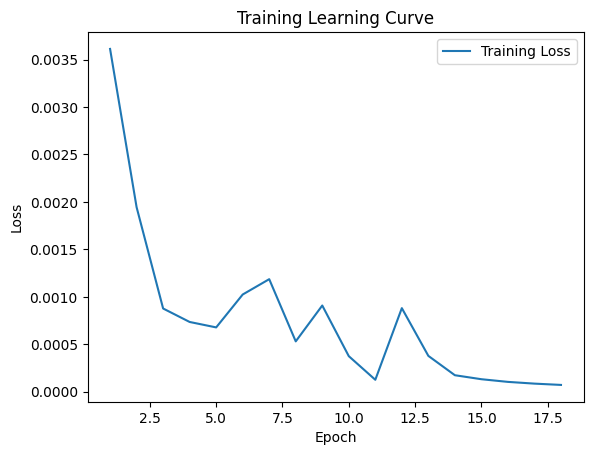


 Epoch: (19/30) Loss = 6.129324901849031e-05

 Epoch: (19/30) Loss_rmse = 0.007829000242054462

 Epoch: (19/30) R^2 = 0.9586076736450195

 Epoch: (19/30) MAE = 0.00716022402048111
Spearman correlation coefficient: SignificanceResult(statistic=0.9876734327812196, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

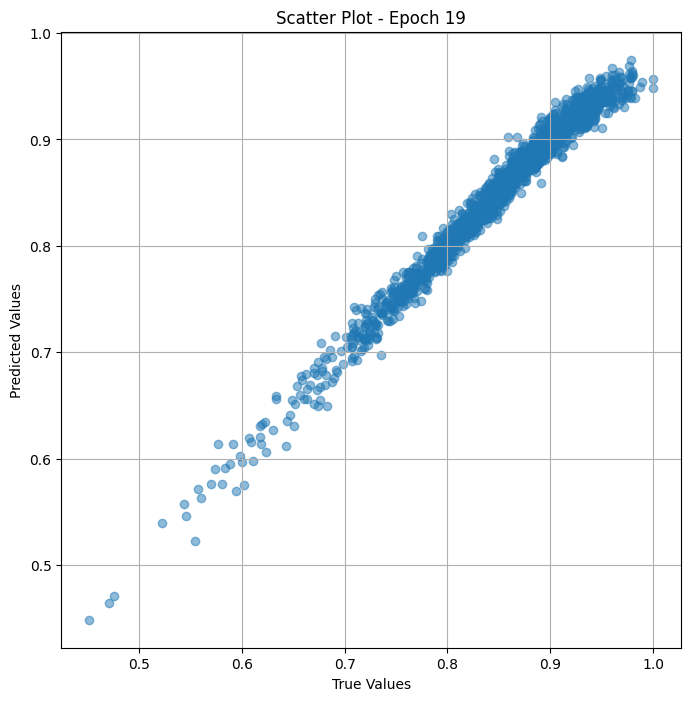

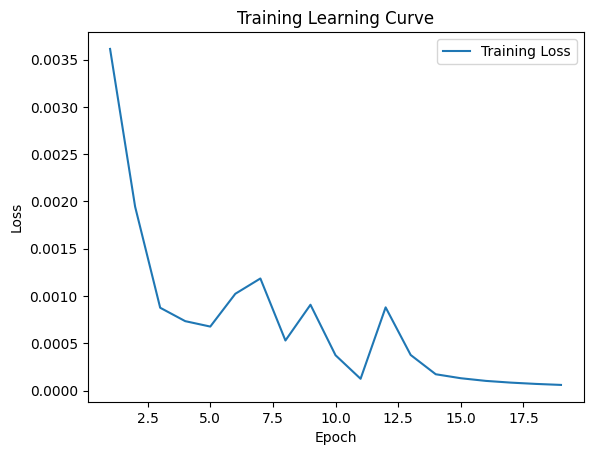


 Epoch: (20/30) Loss = 5.2180221246089786e-05

 Epoch: (20/30) Loss_rmse = 0.007223587948828936

 Epoch: (20/30) R^2 = 0.9647618532180786

 Epoch: (20/30) MAE = 0.0066315606236457825
Spearman correlation coefficient: SignificanceResult(statistic=0.988886161737395, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.86

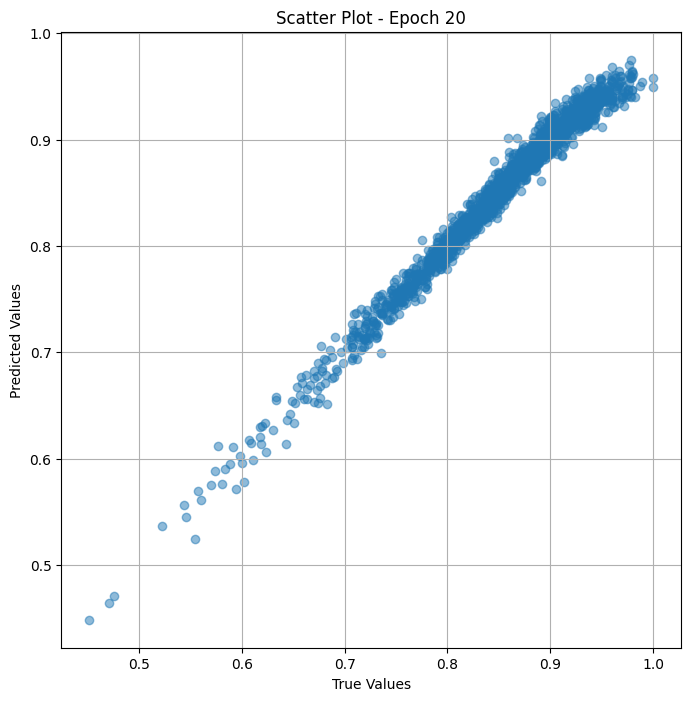

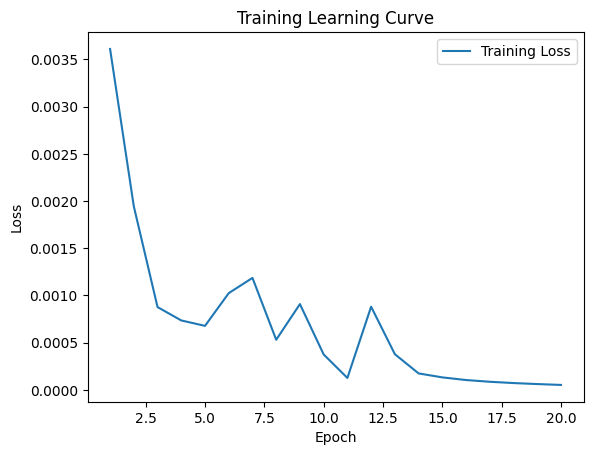


 Epoch: (21/30) Loss = 4.510262078838423e-05

 Epoch: (21/30) Loss_rmse = 0.006715848576277494

 Epoch: (21/30) R^2 = 0.9695414900779724

 Epoch: (21/30) MAE = 0.006135866045951843
Spearman correlation coefficient: SignificanceResult(statistic=0.9899368596426511, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

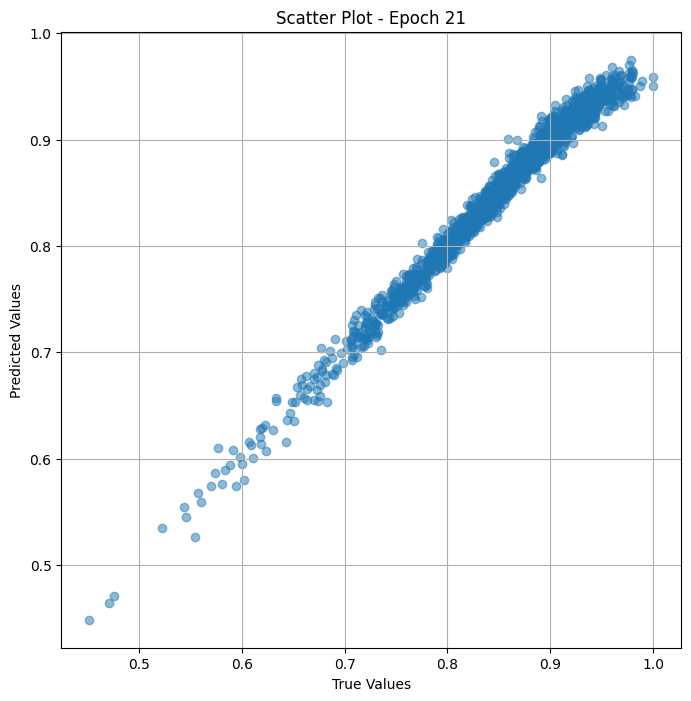

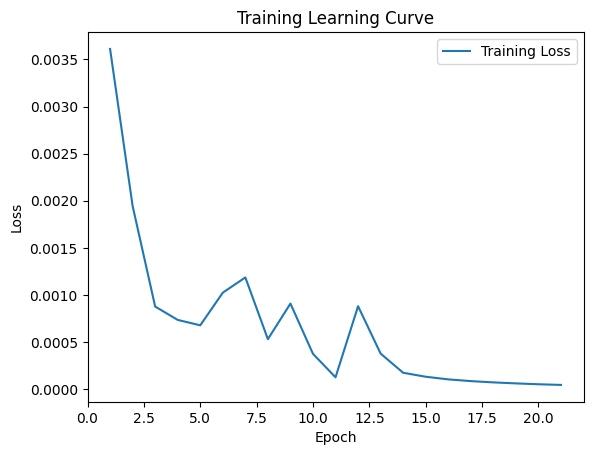


 Epoch: (22/30) Loss = 3.886846388923004e-05

 Epoch: (22/30) Loss_rmse = 0.006234457716345787

 Epoch: (22/30) R^2 = 0.9737514853477478

 Epoch: (22/30) MAE = 0.005652979016304016
Spearman correlation coefficient: SignificanceResult(statistic=0.9908749528286139, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

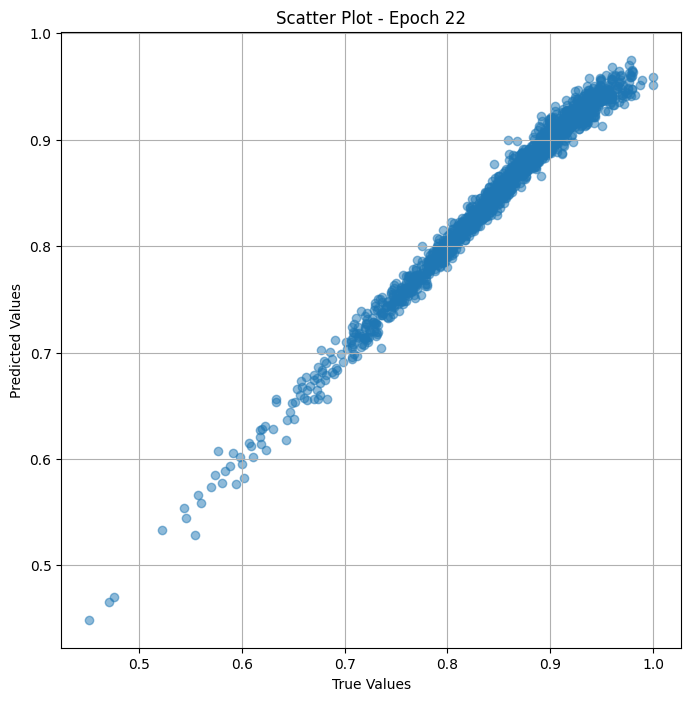

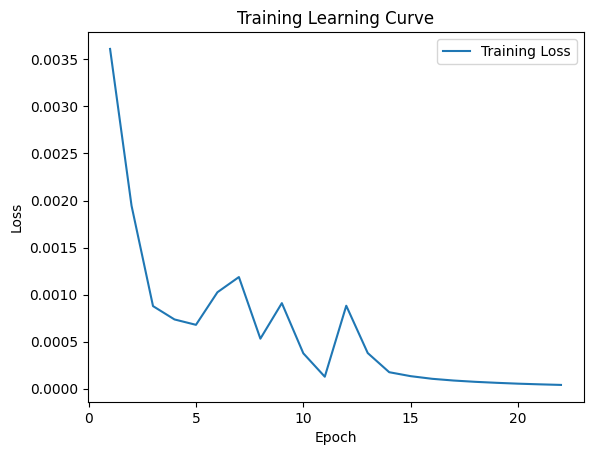


 Epoch: (23/30) Loss = 3.397365435375832e-05

 Epoch: (23/30) Loss_rmse = 0.005828692112118006

 Epoch: (23/30) R^2 = 0.9770570397377014

 Epoch: (23/30) MAE = 0.005211725831031799
Spearman correlation coefficient: SignificanceResult(statistic=0.9917194571648815, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

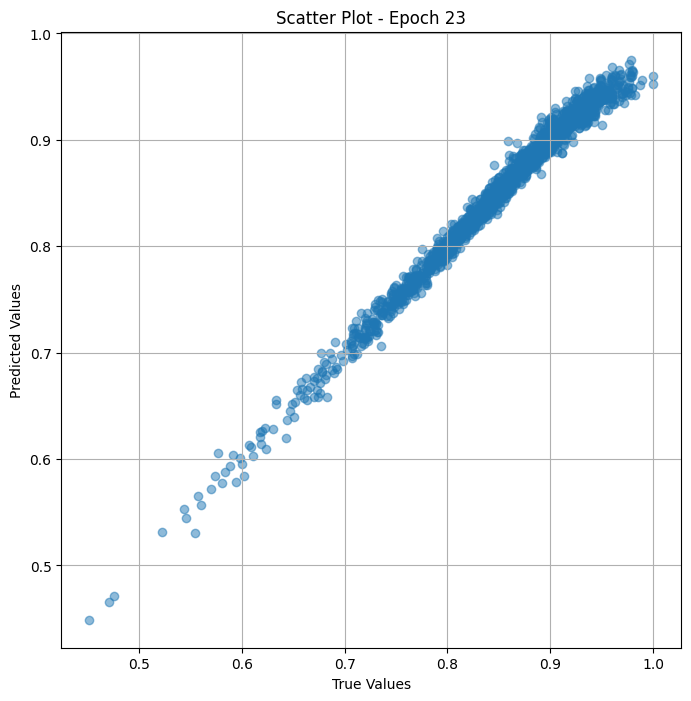

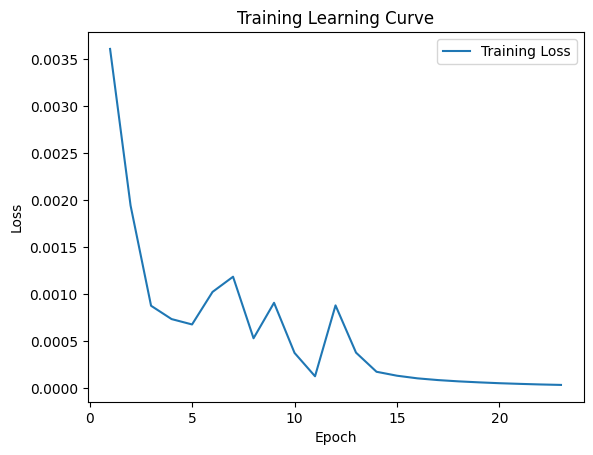


 Epoch: (24/30) Loss = 2.994146416313015e-05

 Epoch: (24/30) Loss_rmse = 0.005471879616379738

 Epoch: (24/30) R^2 = 0.9797800779342651

 Epoch: (24/30) MAE = 0.0047964975237846375
Spearman correlation coefficient: SignificanceResult(statistic=0.992464055238404, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

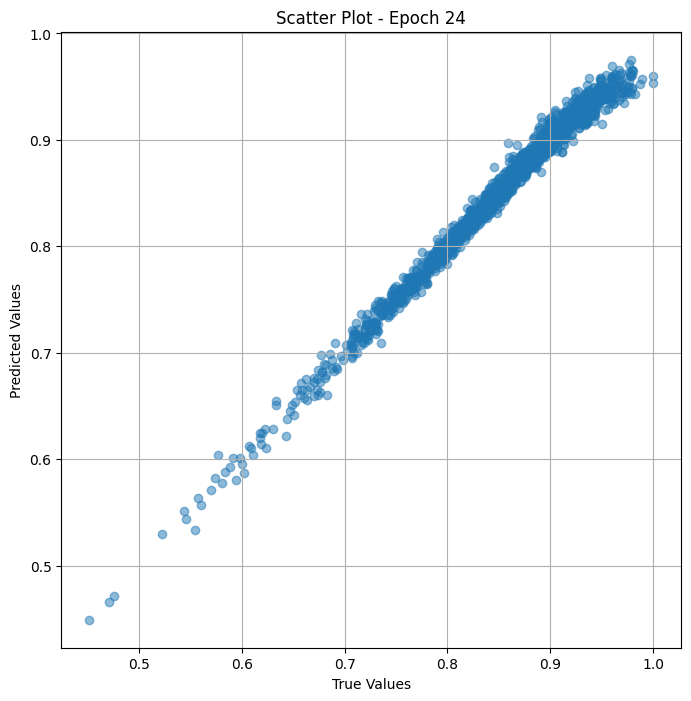

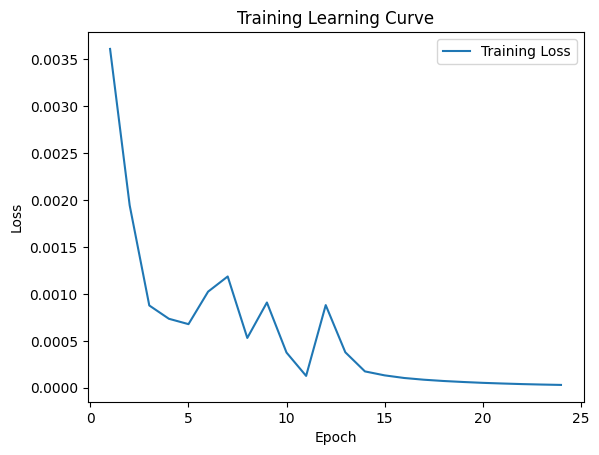


 Epoch: (25/30) Loss = 2.6406007236801088e-05

 Epoch: (25/30) Loss_rmse = 0.005138677544891834

 Epoch: (25/30) R^2 = 0.9821676015853882

 Epoch: (25/30) MAE = 0.00439172238111496
Spearman correlation coefficient: SignificanceResult(statistic=0.9931566349414876, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.861

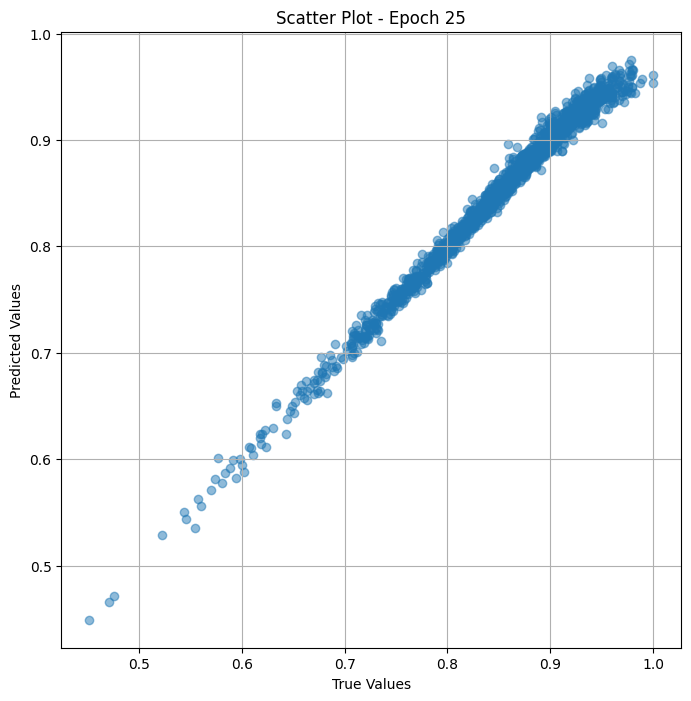

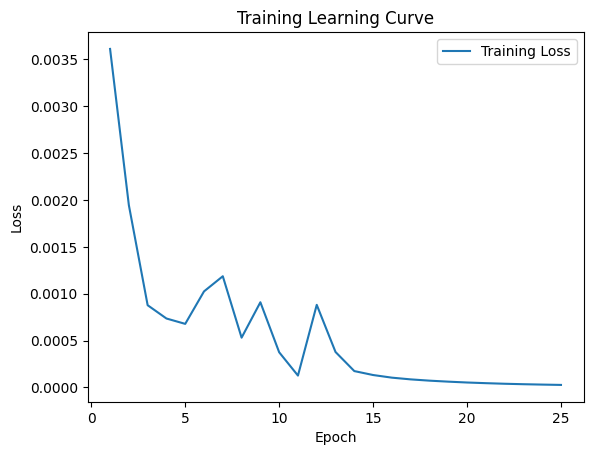


 Epoch: (26/30) Loss = 2.3212935047922656e-05

 Epoch: (26/30) Loss_rmse = 0.004817980341613293

 Epoch: (26/30) R^2 = 0.9843239188194275

 Epoch: (26/30) MAE = 0.0040011778473854065
Spearman correlation coefficient: SignificanceResult(statistic=0.9937917593794713, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

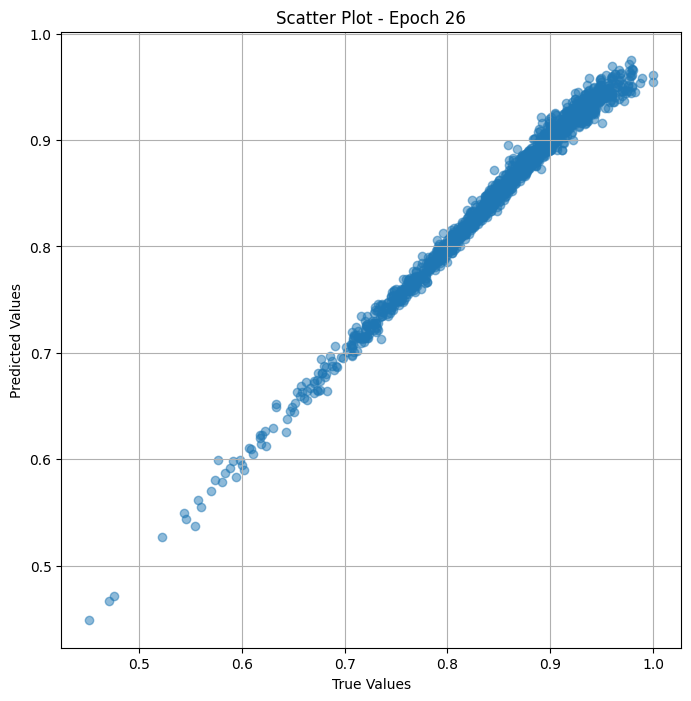

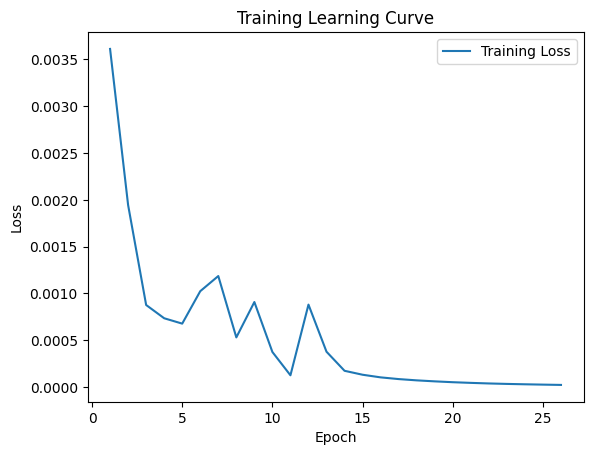


 Epoch: (27/30) Loss = 2.0545832740026526e-05

 Epoch: (27/30) Loss_rmse = 0.00453275116160512

 Epoch: (27/30) R^2 = 0.9861250519752502

 Epoch: (27/30) MAE = 0.003644809126853943
Spearman correlation coefficient: SignificanceResult(statistic=0.994373337961543, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8611

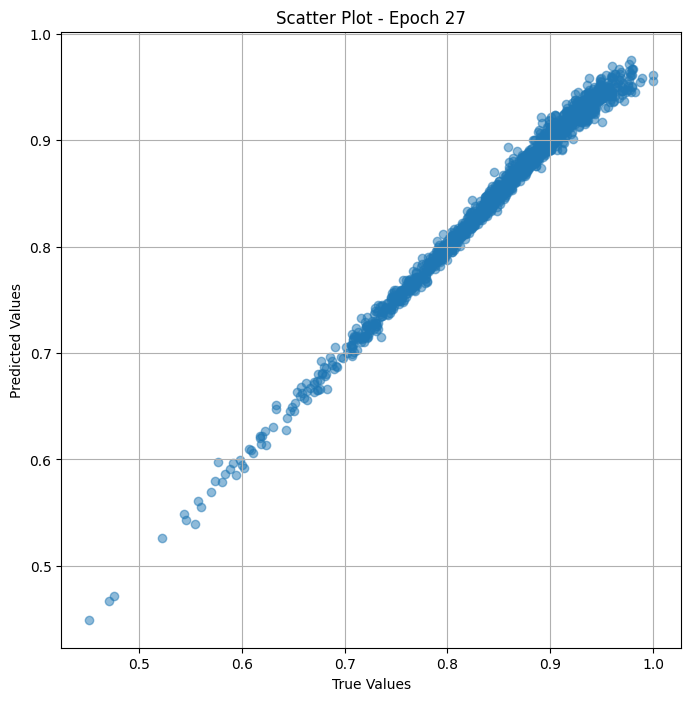

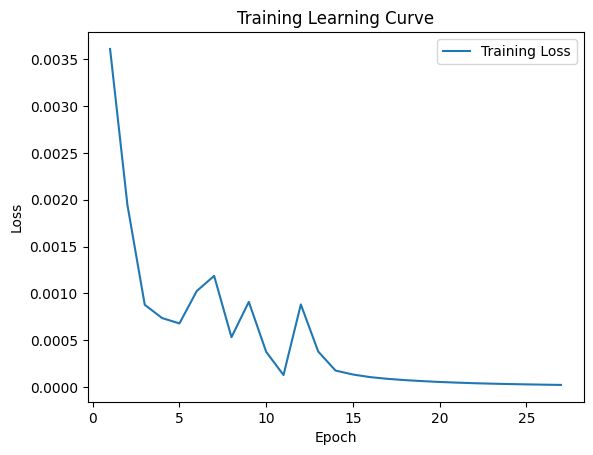


 Epoch: (28/30) Loss = 1.8166065274272114e-05

 Epoch: (28/30) Loss_rmse = 0.004262166563421488

 Epoch: (28/30) R^2 = 0.9877321720123291

 Epoch: (28/30) MAE = 0.003297165036201477
Spearman correlation coefficient: SignificanceResult(statistic=0.9948675038404899, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.86

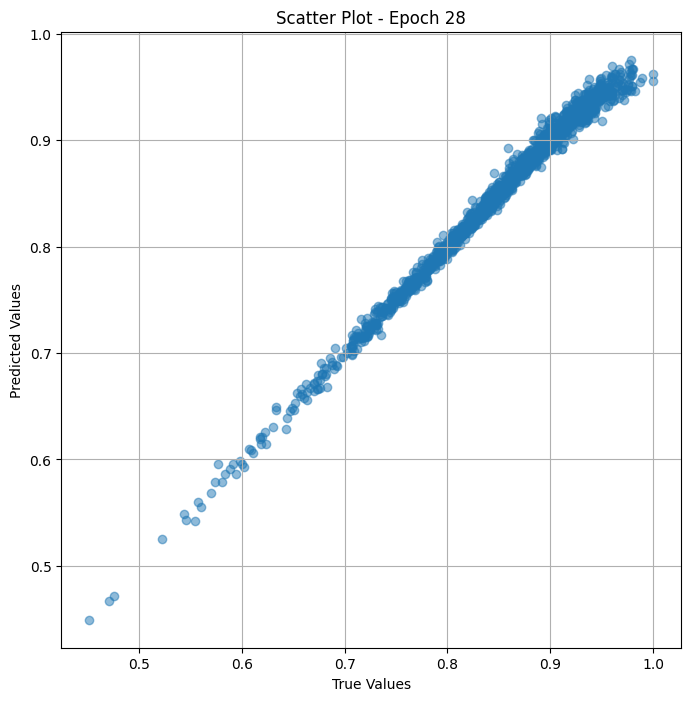

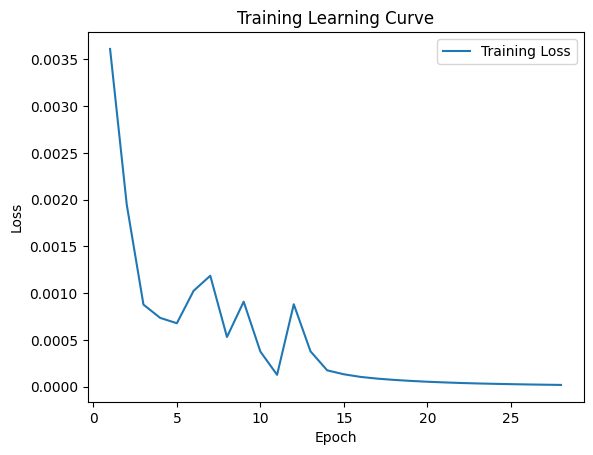


 Epoch: (29/30) Loss = 1.6238562238868326e-05

 Epoch: (29/30) Loss_rmse = 0.004029709845781326

 Epoch: (29/30) R^2 = 0.9890338182449341

 Epoch: (29/30) MAE = 0.0030033141374588013
Spearman correlation coefficient: SignificanceResult(statistic=0.9953403970350454, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

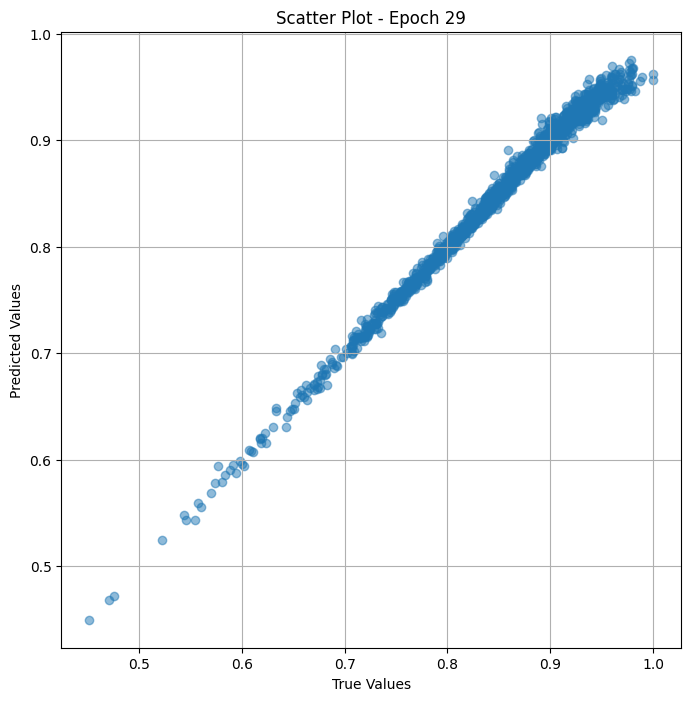

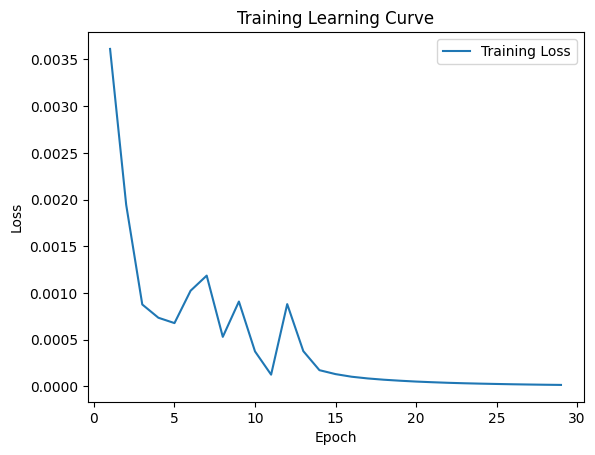


 Epoch: (30/30) Loss = 1.4282767551776487e-05

 Epoch: (30/30) Loss_rmse = 0.0037792548537254333

 Epoch: (30/30) R^2 = 0.990354597568512

 Epoch: (30/30) MAE = 0.0027094483375549316
Spearman correlation coefficient: SignificanceResult(statistic=0.9957678426439731, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.73, 0.8636364, 0.85714287, 0.77011496, 0.9411765, 0.8817204, 0.6770833, 0.8235294, 0.79591835, 0.8989899, 0.8712871, 0.8854167, 0.9313725, 0.8021978, 0.9166667, 0.814433, 0.90756303, 0.7326733, 0.9117647, 0.8613861, 0.8695652, 0.84745765, 0.7157895, 0.8736842, 0.95652175, 0.74766356, 0.9052632, 0.94505495, 0.814433, 0.92156863, 0.75, 0.87234044, 0.827957, 0.59782606, 0.6542056, 0.74712646, 0.8989899, 0.8240741, 0.8952381, 0.91964287, 0.9142857, 0.5841584, 0.82857144, 0.85106385, 0.9279279, 0.8854167, 0.7111111, 0.9396552, 0.8429752, 0.9326923, 0.8207547, 0.9145299, 0.8989899, 0.86238533, 0.8125, 0.9047619, 0.8888889, 0.8

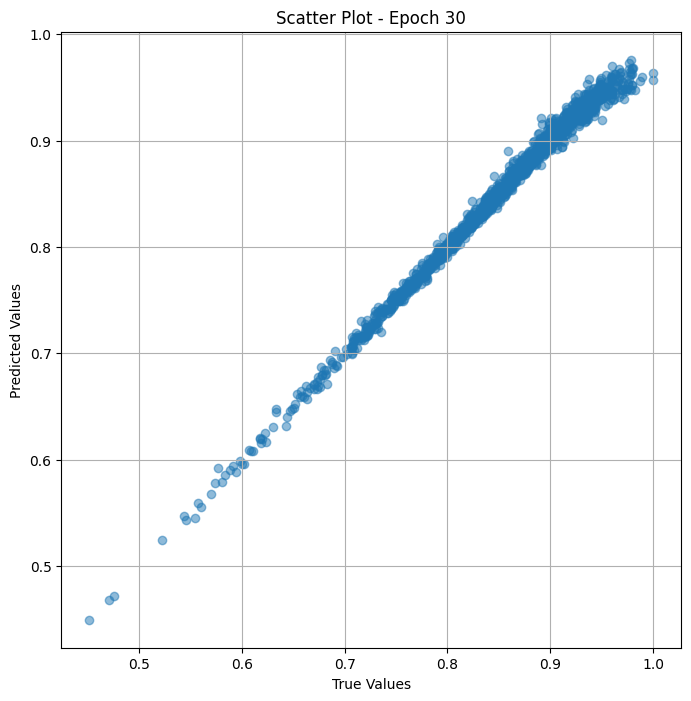

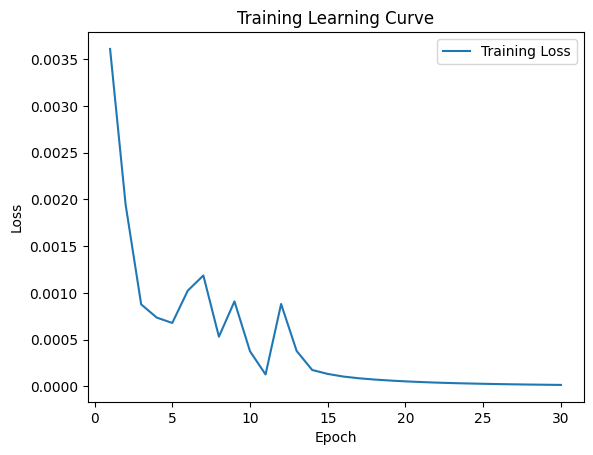

In [ ]:
# Training the model and save weights
fit(30,model_vit_fine , train_dl)
torch.save(model_vit_fine.state_dict(), "model_weights_fine")

## valid

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-4,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)



 Epoch: (1/30) Loss = 0.007030637469142675

 Epoch: (1/30) Loss_rmse = 0.08384889364242554

 Epoch: (1/30) R^2 = -2.0882856845855713

 Epoch: (1/30) MAE = 0.07800599932670593
Spearman correlation coefficient: SignificanceResult(statistic=0.2593956660358285, pvalue=0.01070763809158612)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.8

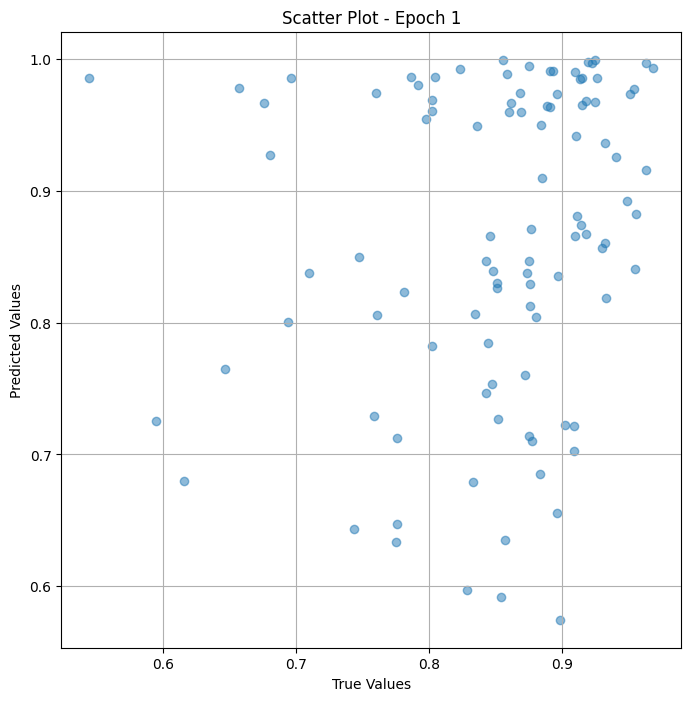

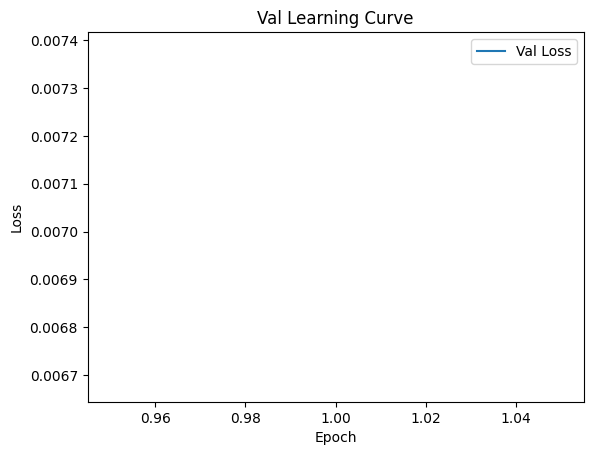


 Epoch: (2/30) Loss = 0.0016263177385553718

 Epoch: (2/30) Loss_rmse = 0.04032763093709946

 Epoch: (2/30) R^2 = 0.28562188148498535

 Epoch: (2/30) MAE = 0.03516533970832825
Spearman correlation coefficient: SignificanceResult(statistic=0.5848746908779293, pvalue=3.9177048110608384e-10)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703,

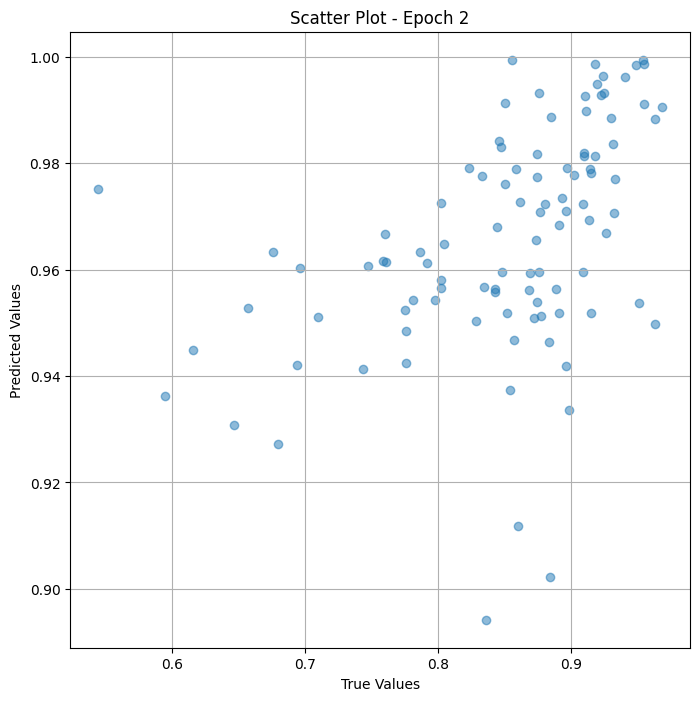

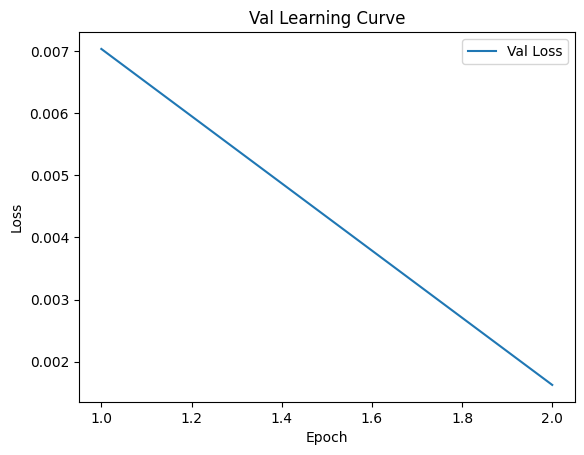


 Epoch: (3/30) Loss = 0.005194301716983318

 Epoch: (3/30) Loss_rmse = 0.07207150757312775

 Epoch: (3/30) R^2 = -1.2816548347473145

 Epoch: (3/30) MAE = 0.06880176067352295
Spearman correlation coefficient: SignificanceResult(statistic=0.36860311344830826, pvalue=0.00021966824223755552)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703,

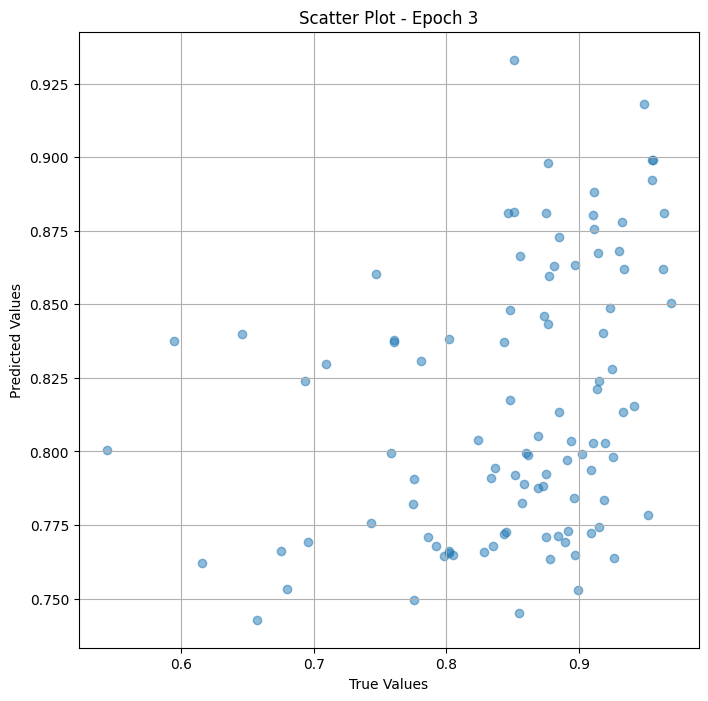

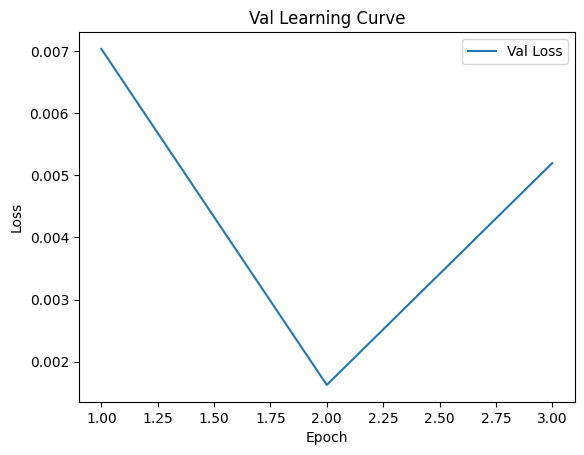


 Epoch: (4/30) Loss = 0.0018388389144092798

 Epoch: (4/30) Loss_rmse = 0.04288168624043465

 Epoch: (4/30) R^2 = 0.19226956367492676

 Epoch: (4/30) MAE = 0.04122091829776764
Spearman correlation coefficient: SignificanceResult(statistic=0.47828534635975534, pvalue=8.287107513435092e-07)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703,

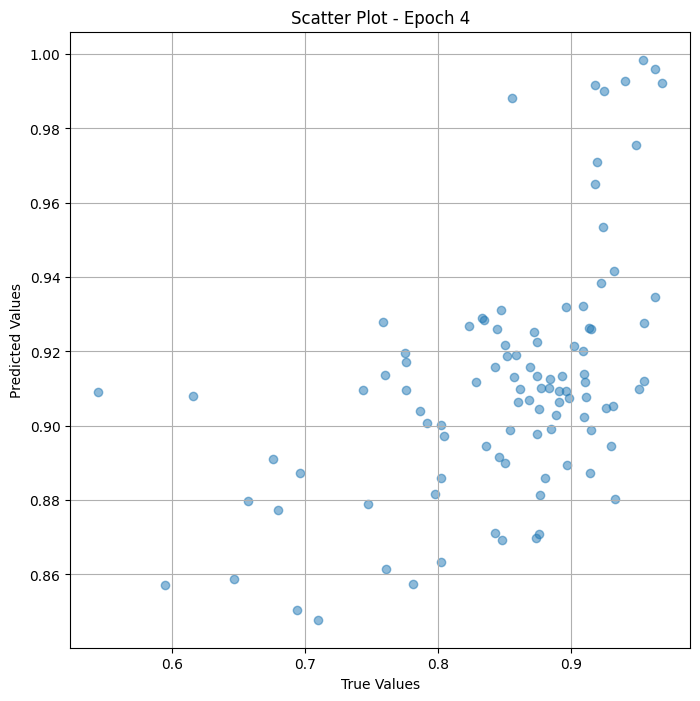

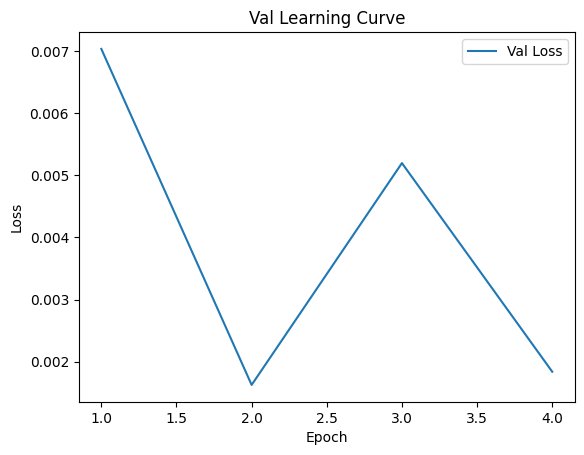

Epoch 0.05: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (5/30) Loss = 0.0023923071566969156

 Epoch: (5/30) Loss_rmse = 0.04891121760010719

 Epoch: (5/30) R^2 = -0.050847530364990234

 Epoch: (5/30) MAE = 0.04750324785709381
Spearman correlation coefficient: SignificanceResult(statistic=0.6337775972715681, pvalue=4.186607640238906e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.760

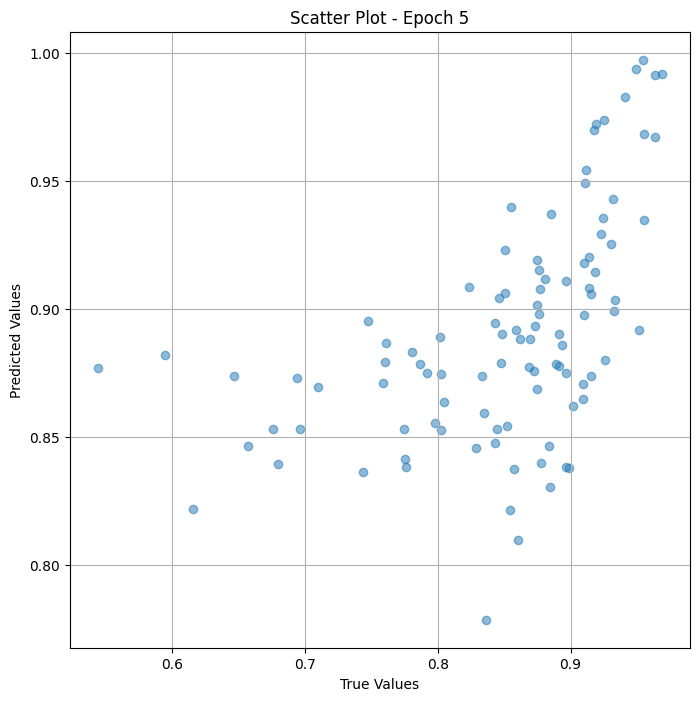

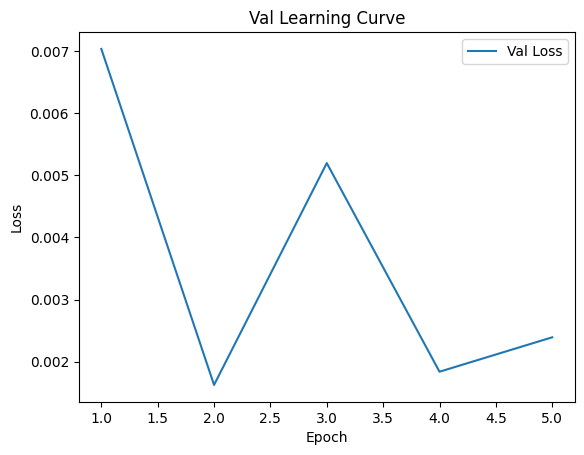


 Epoch: (6/30) Loss = 0.0032782673370093107

 Epoch: (6/30) Loss_rmse = 0.05725615471601486

 Epoch: (6/30) R^2 = -0.4400153160095215

 Epoch: (6/30) MAE = 0.05479525029659271
Spearman correlation coefficient: SignificanceResult(statistic=0.7709092146733143, pvalue=4.0716052570117436e-20)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703,

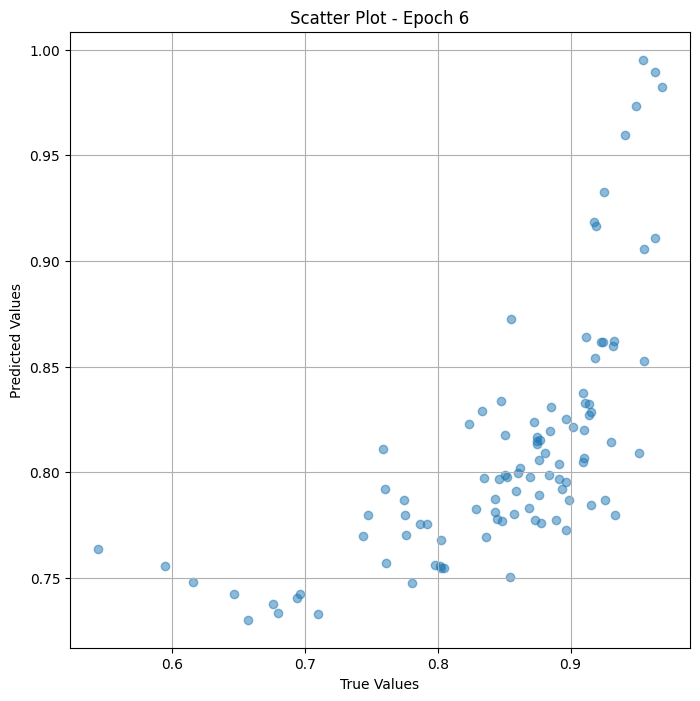

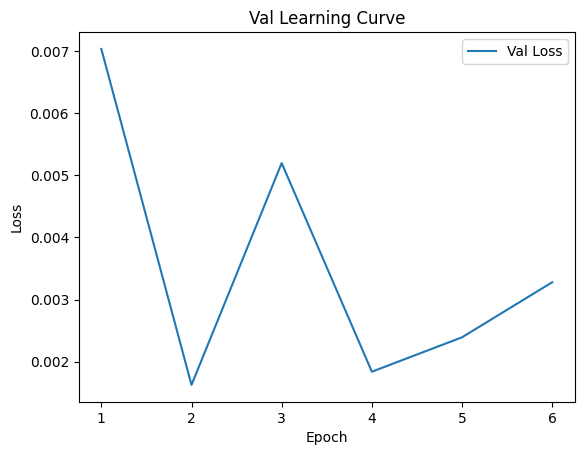


 Epoch: (7/30) Loss = 0.001424137968569994

 Epoch: (7/30) Loss_rmse = 0.03773775324225426

 Epoch: (7/30) R^2 = 0.3744315505027771

 Epoch: (7/30) MAE = 0.03705538809299469
Spearman correlation coefficient: SignificanceResult(statistic=0.771940177471072, pvalue=3.3807969989624255e-20)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 0.

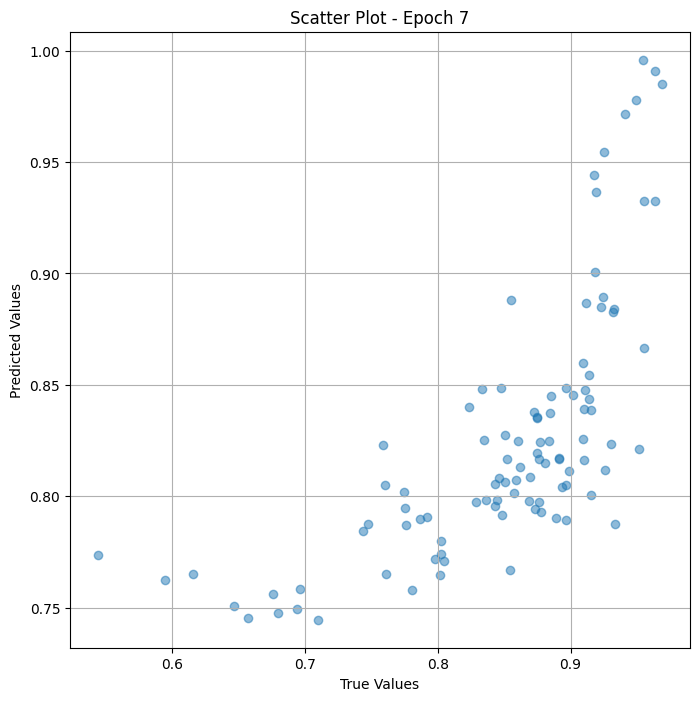

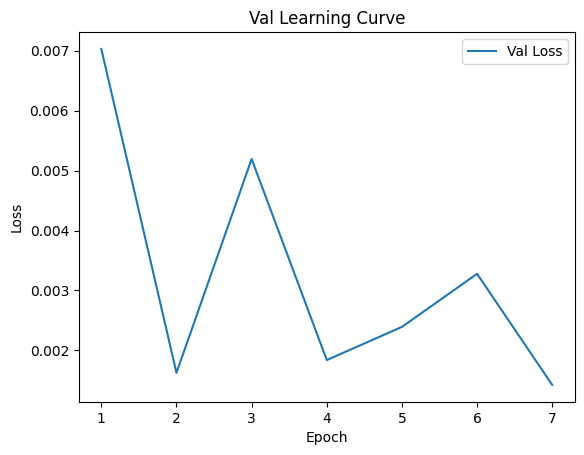


 Epoch: (8/30) Loss = 0.00043454361730255187

 Epoch: (8/30) Loss_rmse = 0.02084570936858654

 Epoch: (8/30) R^2 = 0.8091219067573547

 Epoch: (8/30) MAE = 0.017161965370178223
Spearman correlation coefficient: SignificanceResult(statistic=0.790748465880165, pvalue=9.496509592961066e-22)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703, 

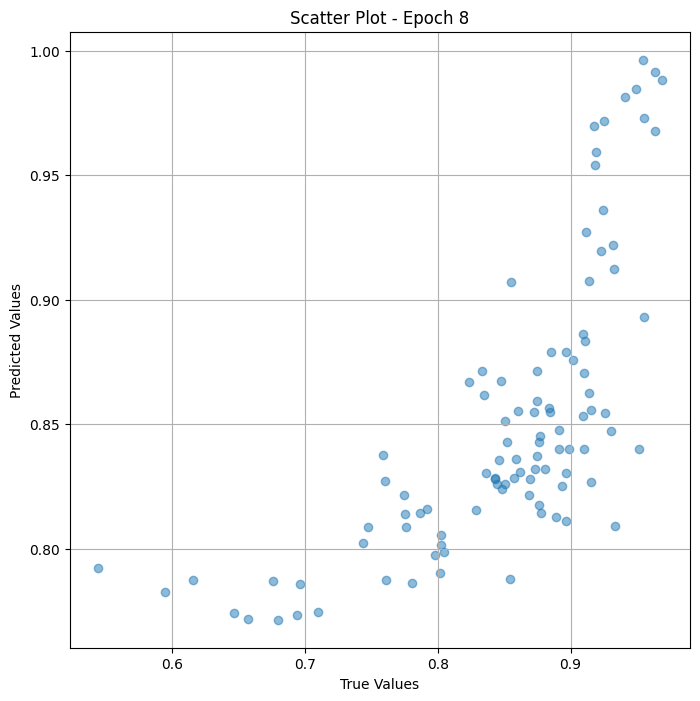

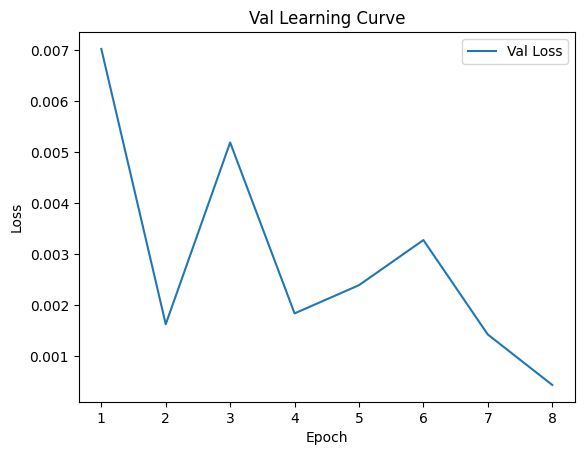


 Epoch: (9/30) Loss = 0.00036754057509824634

 Epoch: (9/30) Loss_rmse = 0.019171347841620445

 Epoch: (9/30) R^2 = 0.8385537266731262

 Epoch: (9/30) MAE = 0.01786792278289795
Spearman correlation coefficient: SignificanceResult(statistic=0.7963238041680388, pvalue=3.0678125436992815e-22)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703

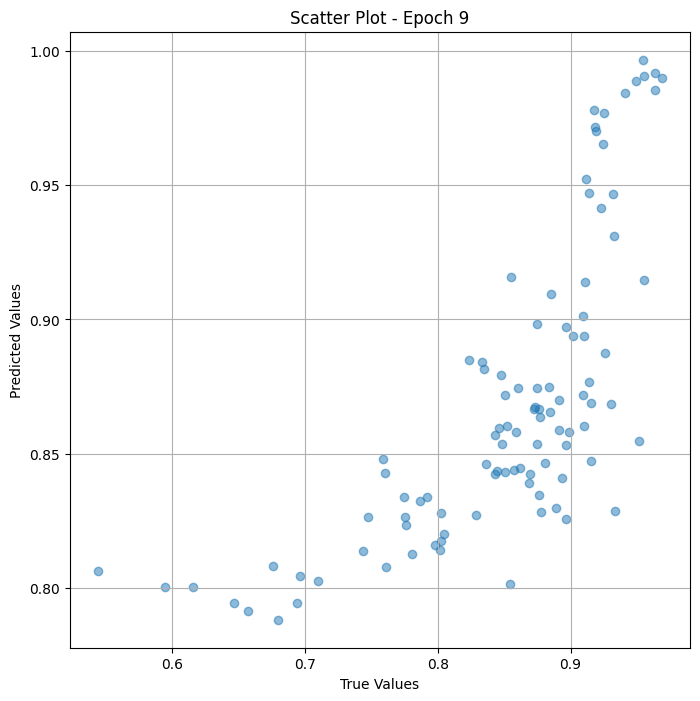

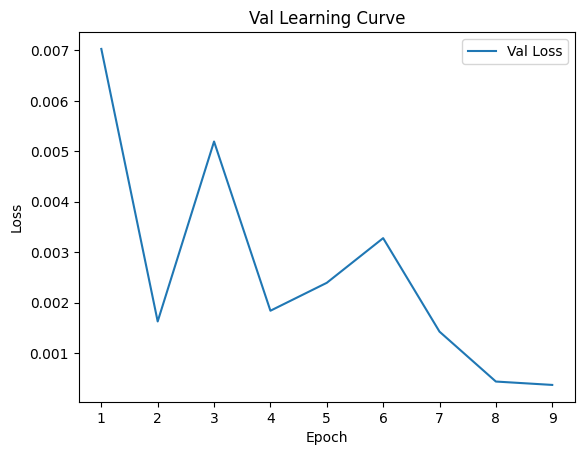


 Epoch: (10/30) Loss = 0.0002976921678055078

 Epoch: (10/30) Loss_rmse = 0.017253758385777473

 Epoch: (10/30) R^2 = 0.8692353963851929

 Epoch: (10/30) MAE = 0.014906391501426697
Spearman correlation coefficient: SignificanceResult(statistic=0.8066130841956602, pvalue=3.4665230574382746e-23)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936

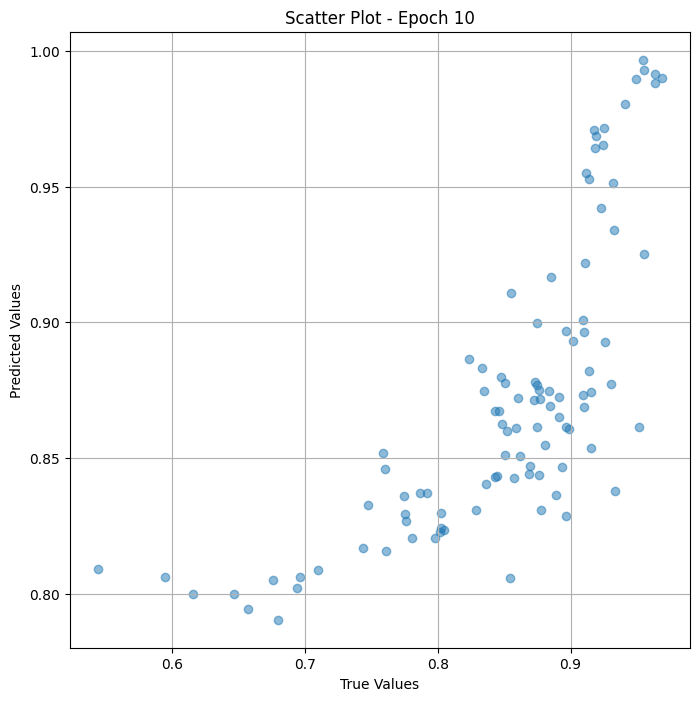

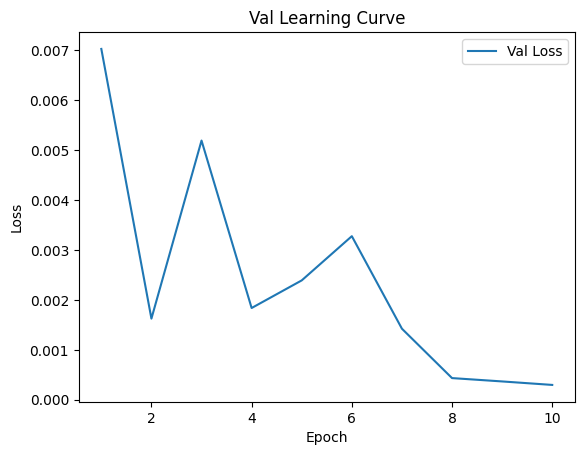


 Epoch: (11/30) Loss = 0.000286777300061658

 Epoch: (11/30) Loss_rmse = 0.016934501007199287

 Epoch: (11/30) R^2 = 0.8740298748016357

 Epoch: (11/30) MAE = 0.013787582516670227
Spearman correlation coefficient: SignificanceResult(statistic=0.8298504430451202, pvalue=1.4989274432442636e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

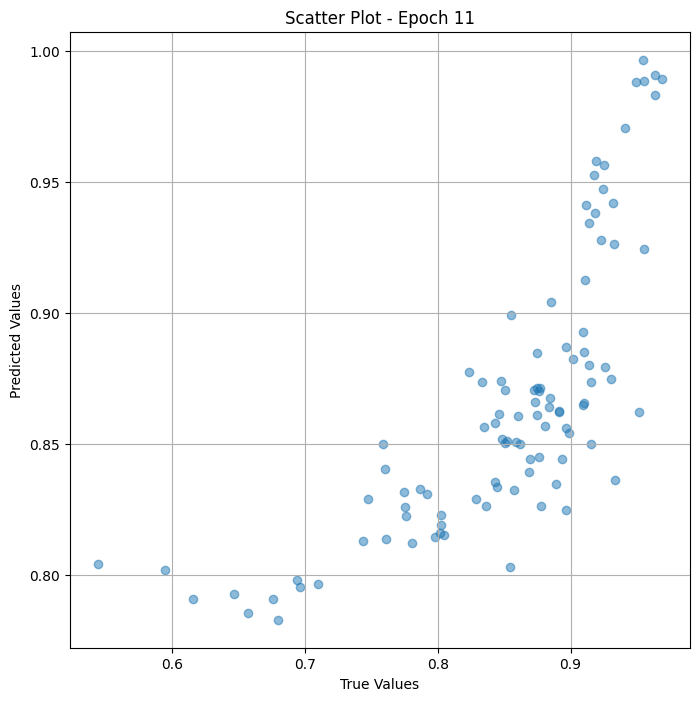

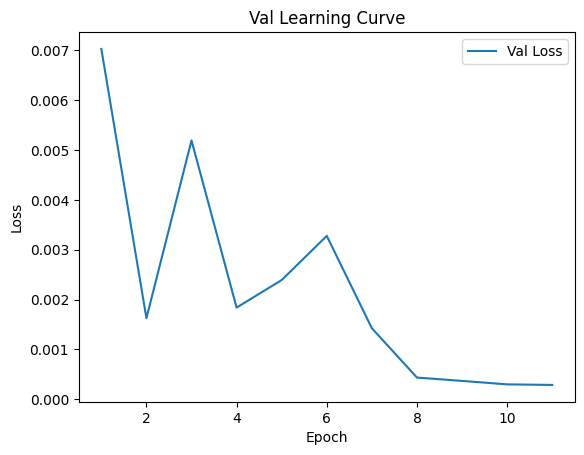


 Epoch: (12/30) Loss = 0.00042127224151045084

 Epoch: (12/30) Loss_rmse = 0.020524917170405388

 Epoch: (12/30) R^2 = 0.814951479434967

 Epoch: (12/30) MAE = 0.019441381096839905
Spearman correlation coefficient: SignificanceResult(statistic=0.8392105000247626, pvalue=1.319043813281949e-26)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

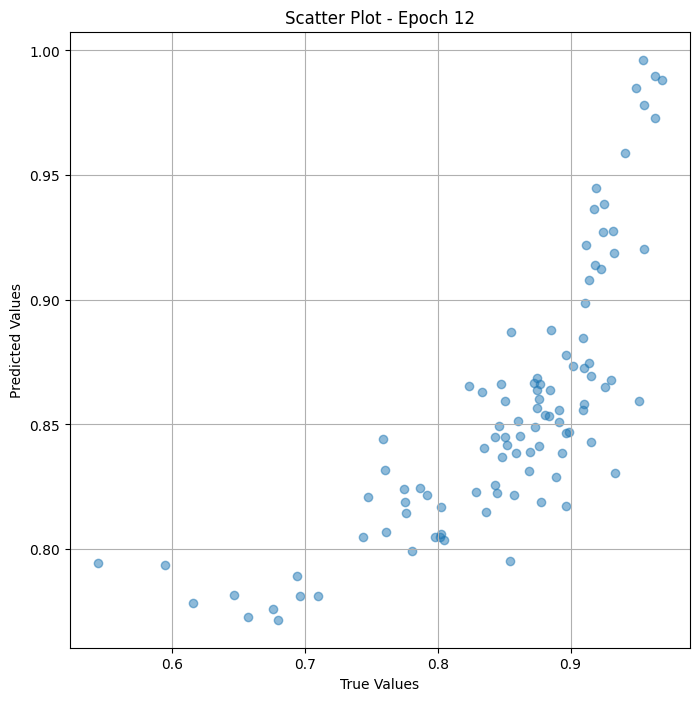

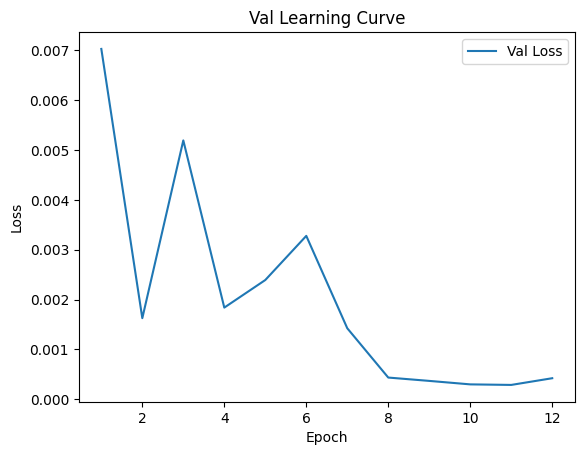


 Epoch: (13/30) Loss = 0.0004958937643095851

 Epoch: (13/30) Loss_rmse = 0.022268671542406082

 Epoch: (13/30) R^2 = 0.7821731567382812

 Epoch: (13/30) MAE = 0.021492555737495422
Spearman correlation coefficient: SignificanceResult(statistic=0.8489775160035199, pvalue=8.796936559492549e-28)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

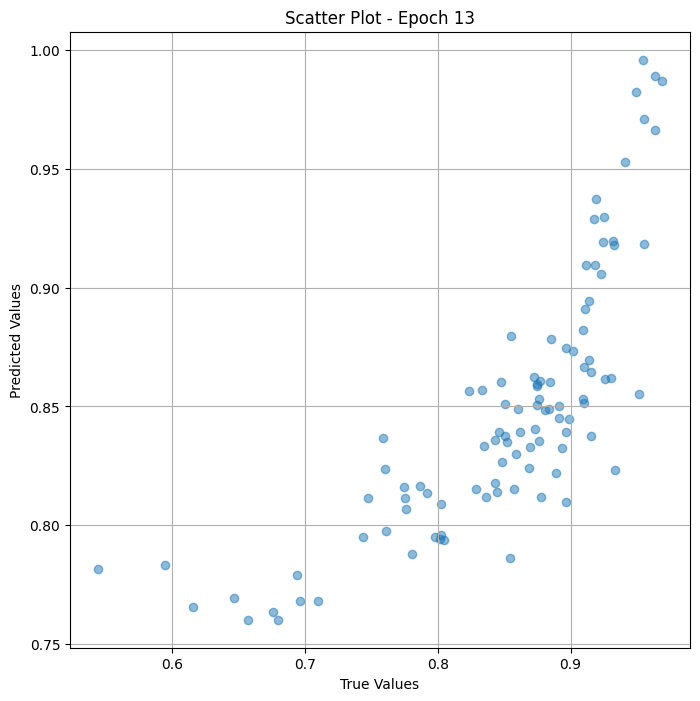

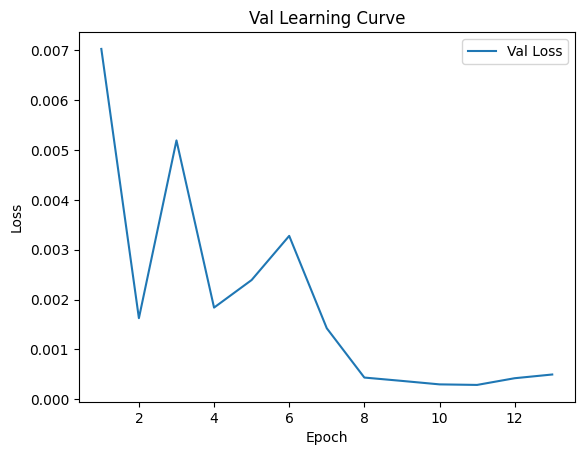

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (14/30) Loss = 0.00039384447154589

 Epoch: (14/30) Loss_rmse = 0.019845515489578247

 Epoch: (14/30) R^2 = 0.8269994258880615

 Epoch: (14/30) MAE = 0.01792369782924652
Spearman correlation coefficient: SignificanceResult(statistic=0.8575033070349768, pvalue=7.045103930592422e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.760

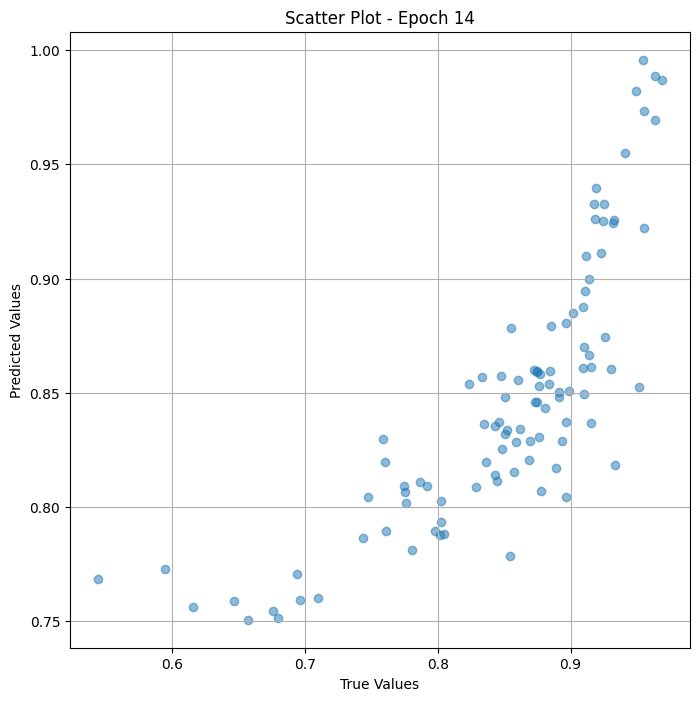

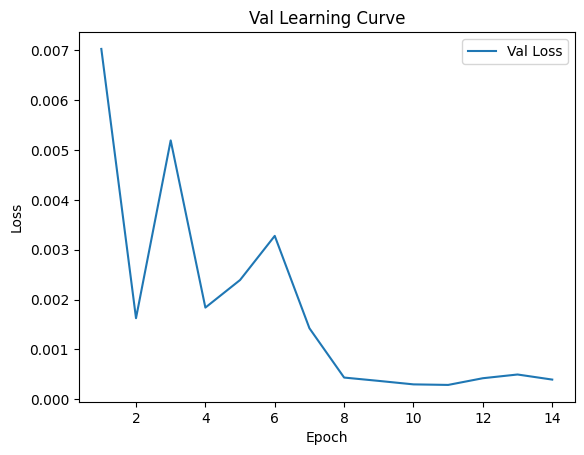


 Epoch: (15/30) Loss = 0.0003484487533569336

 Epoch: (15/30) Loss_rmse = 0.01866678148508072

 Epoch: (15/30) R^2 = 0.8469400405883789

 Epoch: (15/30) MAE = 0.015526443719863892
Spearman correlation coefficient: SignificanceResult(statistic=0.8580662669837523, pvalue=5.929186775095484e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.893617

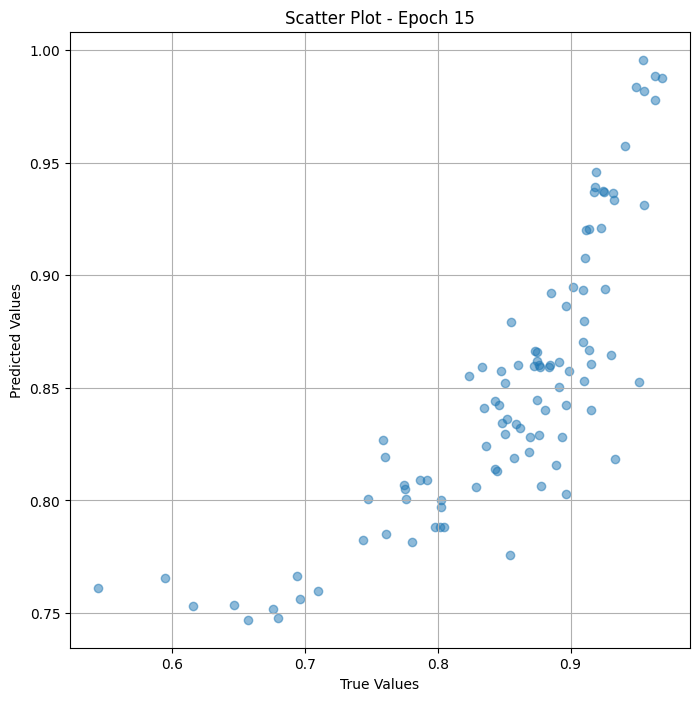

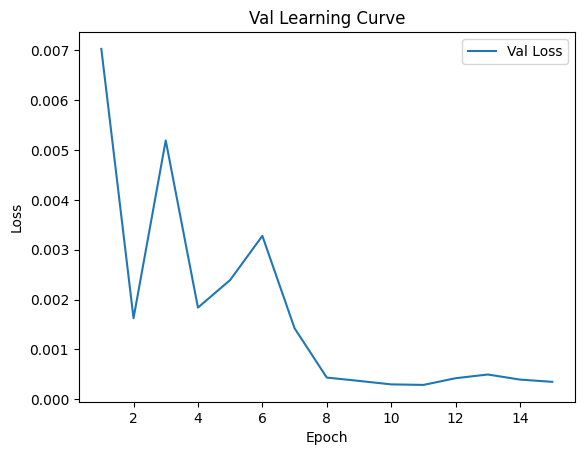


 Epoch: (16/30) Loss = 0.000338970246957615

 Epoch: (16/30) Loss_rmse = 0.018411144614219666

 Epoch: (16/30) R^2 = 0.8511035442352295

 Epoch: (16/30) MAE = 0.015424281358718872
Spearman correlation coefficient: SignificanceResult(statistic=0.8578017436343277, pvalue=6.430215496054277e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.893617

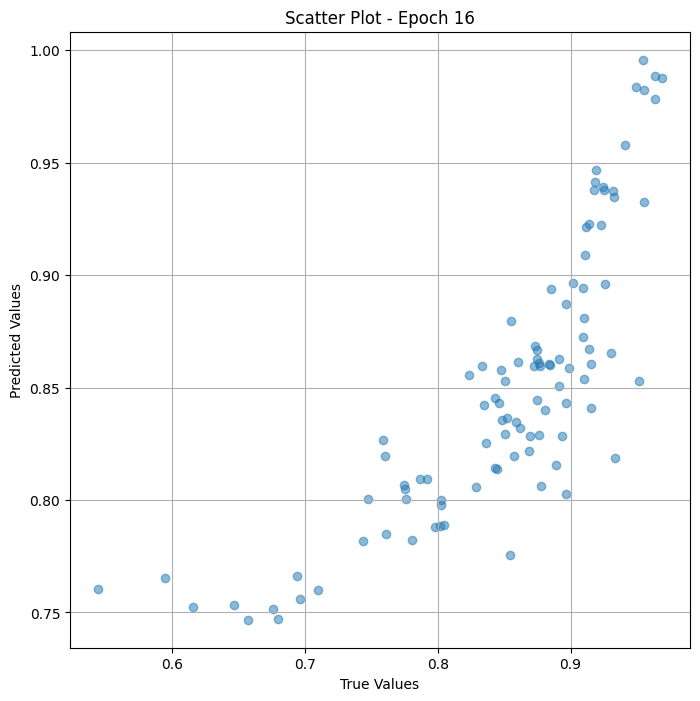

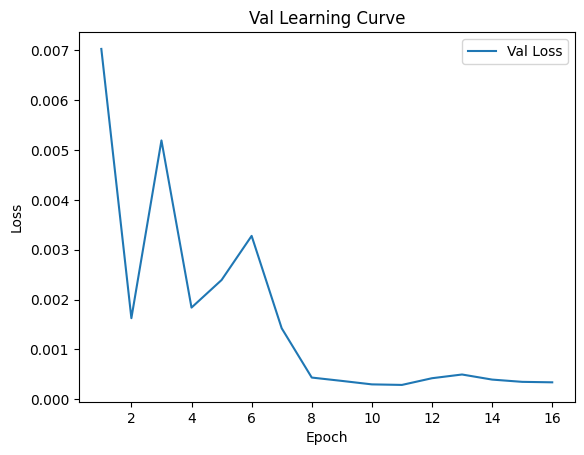

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (17/30) Loss = 0.0003307696897536516

 Epoch: (17/30) Loss_rmse = 0.01818707399070263

 Epoch: (17/30) R^2 = 0.8547057509422302

 Epoch: (17/30) MAE = 0.015356972813606262
Spearman correlation coefficient: SignificanceResult(statistic=0.8587309666823066, pvalue=4.832282377086773e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7

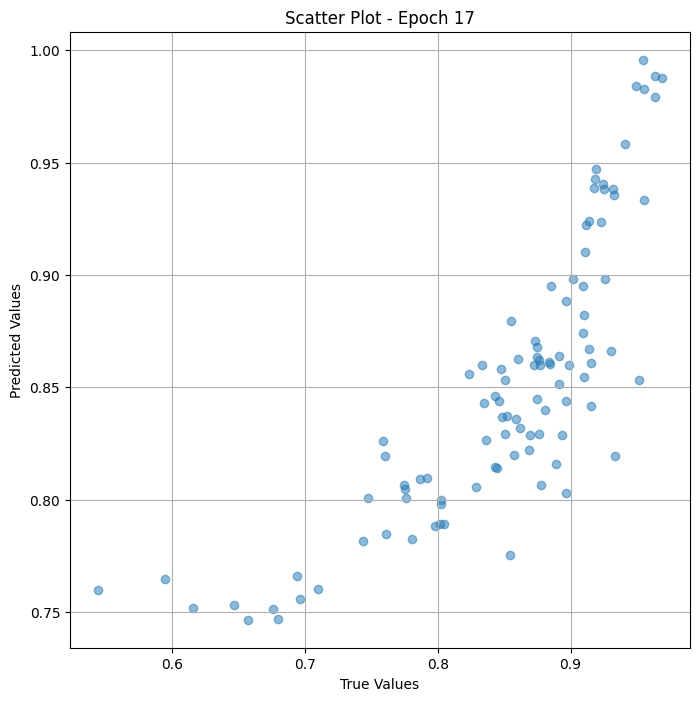

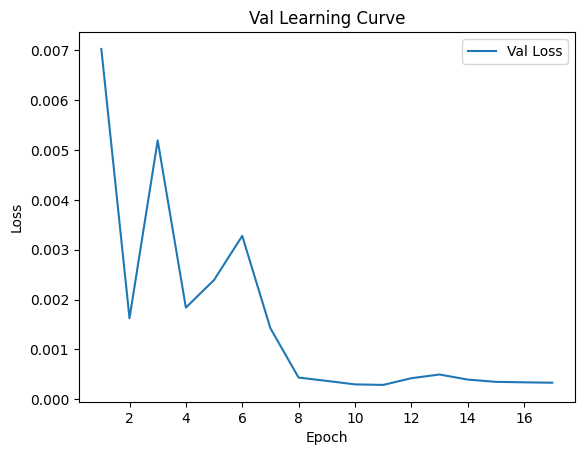


 Epoch: (18/30) Loss = 0.0003278442600276321

 Epoch: (18/30) Loss_rmse = 0.01810646988451481

 Epoch: (18/30) R^2 = 0.8559907674789429

 Epoch: (18/30) MAE = 0.0153120756149292
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703

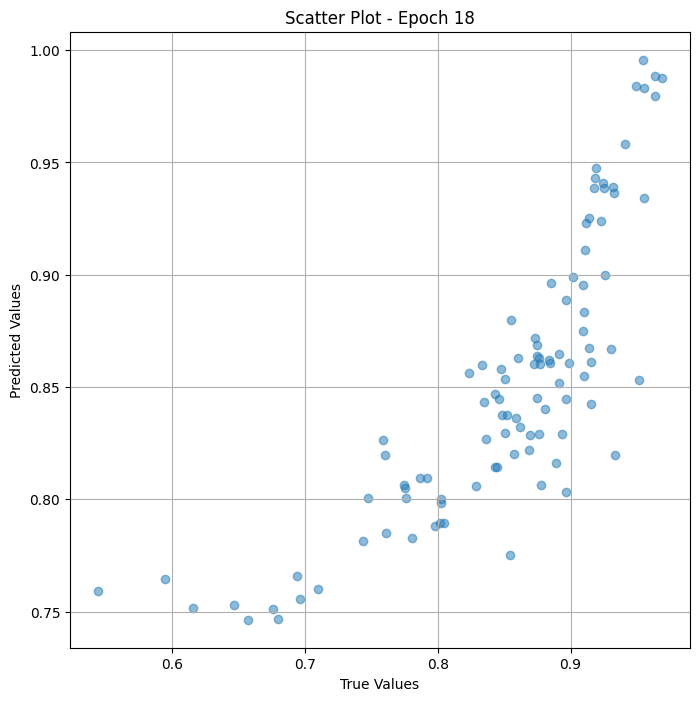

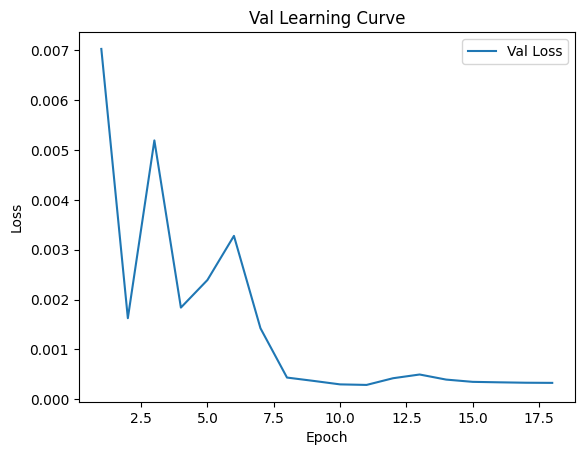


 Epoch: (19/30) Loss = 0.0003271677123848349

 Epoch: (19/30) Loss_rmse = 0.018087778240442276

 Epoch: (19/30) R^2 = 0.856287956237793

 Epoch: (19/30) MAE = 0.015302672982215881
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.893617

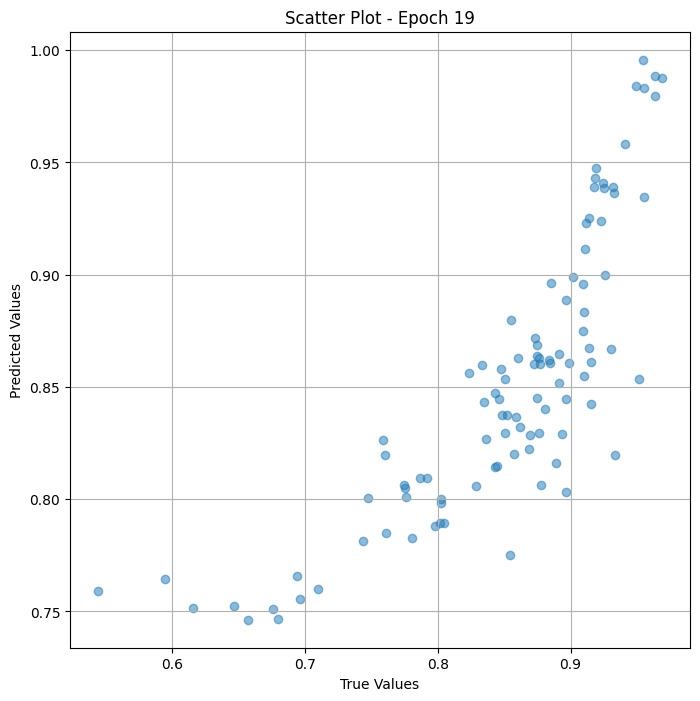

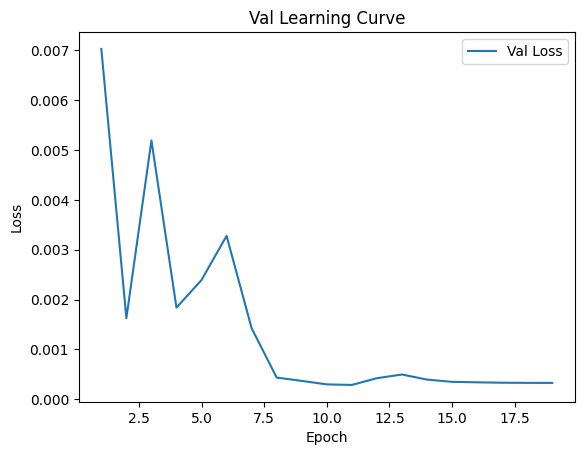

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (20/30) Loss = 0.0003265101695433259

 Epoch: (20/30) Loss_rmse = 0.018069593235850334

 Epoch: (20/30) R^2 = 0.8565768003463745

 Epoch: (20/30) MAE = 0.01529228687286377
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7

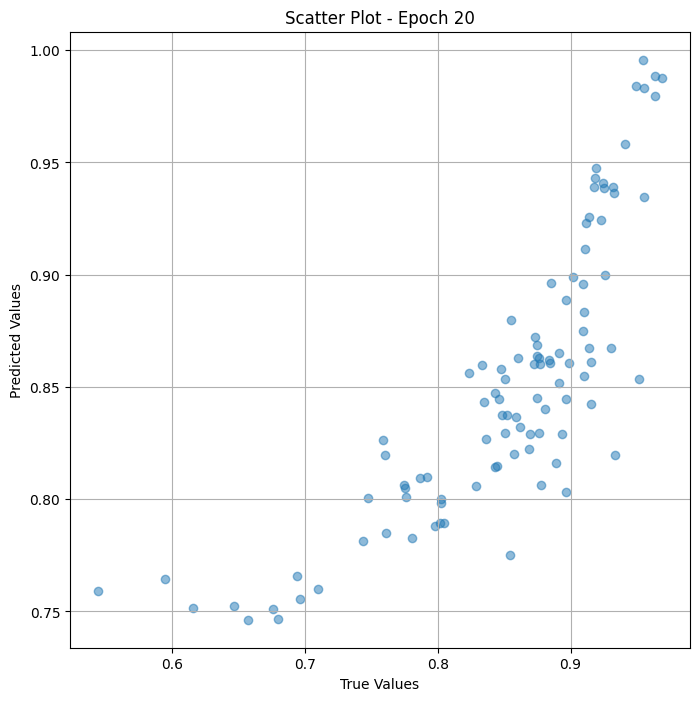

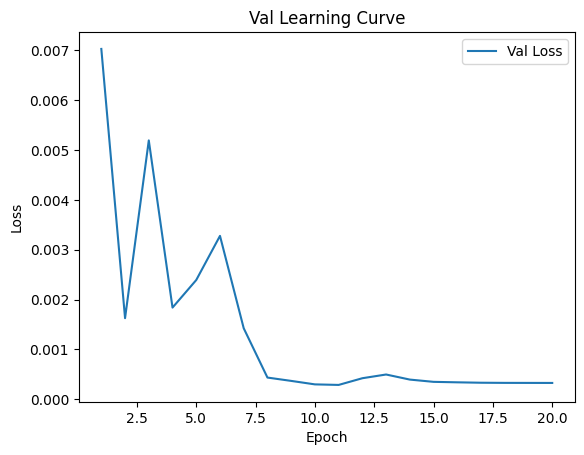


 Epoch: (21/30) Loss = 0.0003262528916820884

 Epoch: (21/30) Loss_rmse = 0.018062472343444824

 Epoch: (21/30) R^2 = 0.8566898107528687

 Epoch: (21/30) MAE = 0.015286803245544434
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

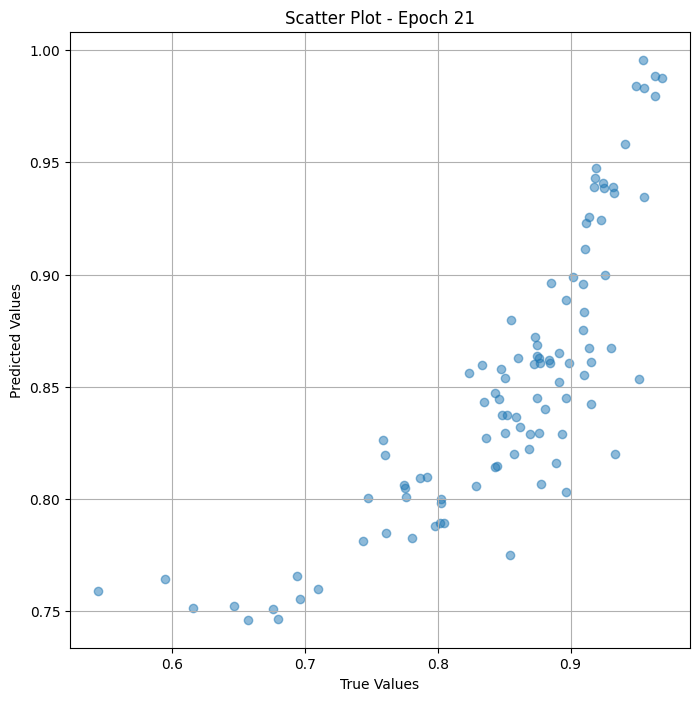

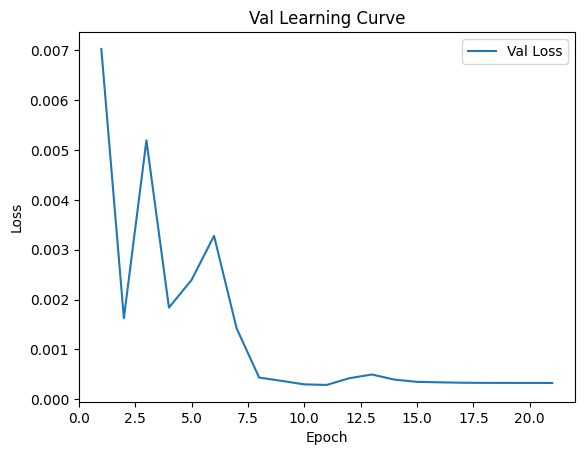


 Epoch: (22/30) Loss = 0.0003262072568759322

 Epoch: (22/30) Loss_rmse = 0.018061209470033646

 Epoch: (22/30) R^2 = 0.8567098379135132

 Epoch: (22/30) MAE = 0.015285924077033997
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

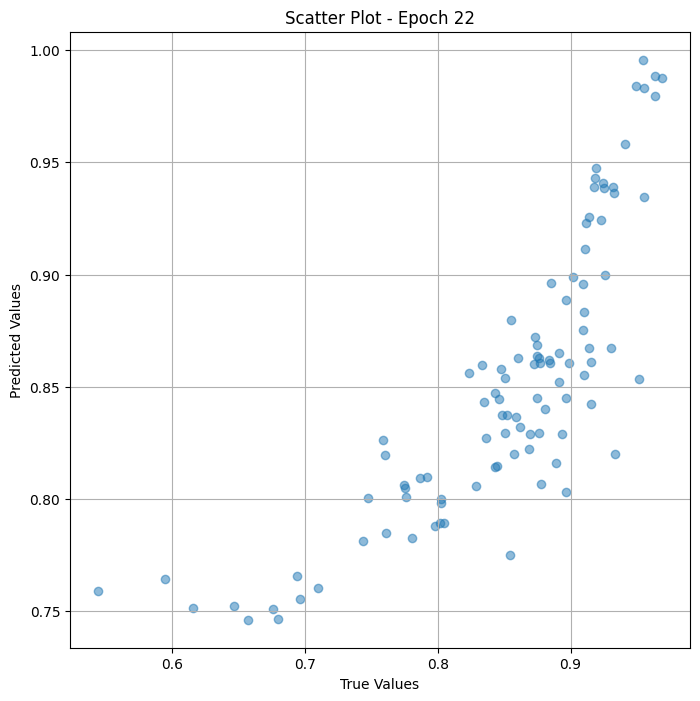

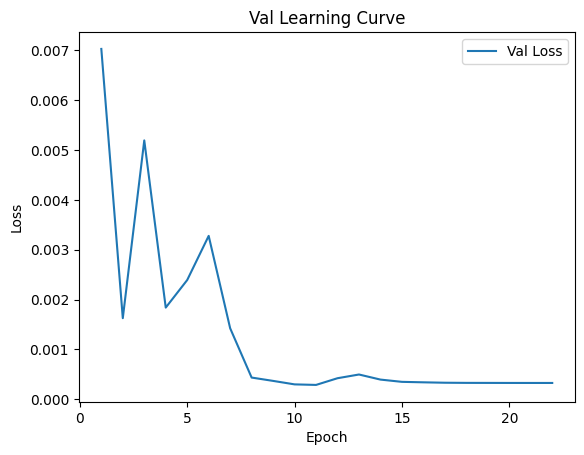


 Epoch: (23/30) Loss = 0.0003261605743318796

 Epoch: (23/30) Loss_rmse = 0.01805991679430008

 Epoch: (23/30) R^2 = 0.8567303419113159

 Epoch: (23/30) MAE = 0.015284985303878784
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.893617

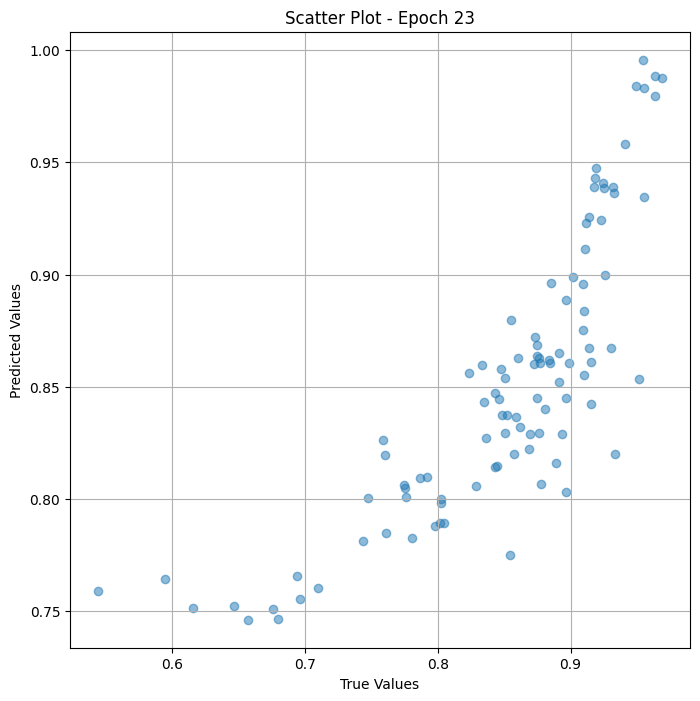

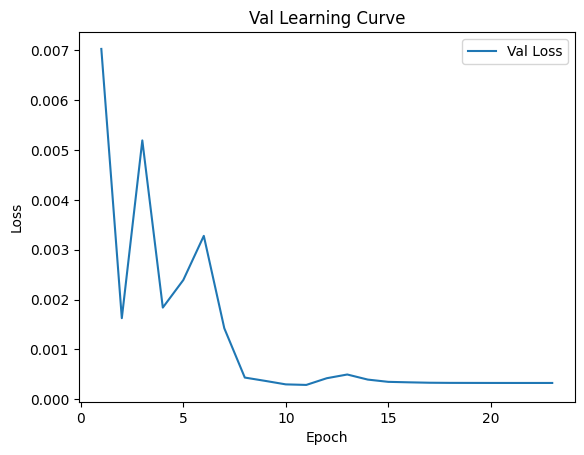


 Epoch: (24/30) Loss = 0.00032611144706606865

 Epoch: (24/30) Loss_rmse = 0.01805855520069599

 Epoch: (24/30) R^2 = 0.8567519187927246

 Epoch: (24/30) MAE = 0.015283972024917603
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

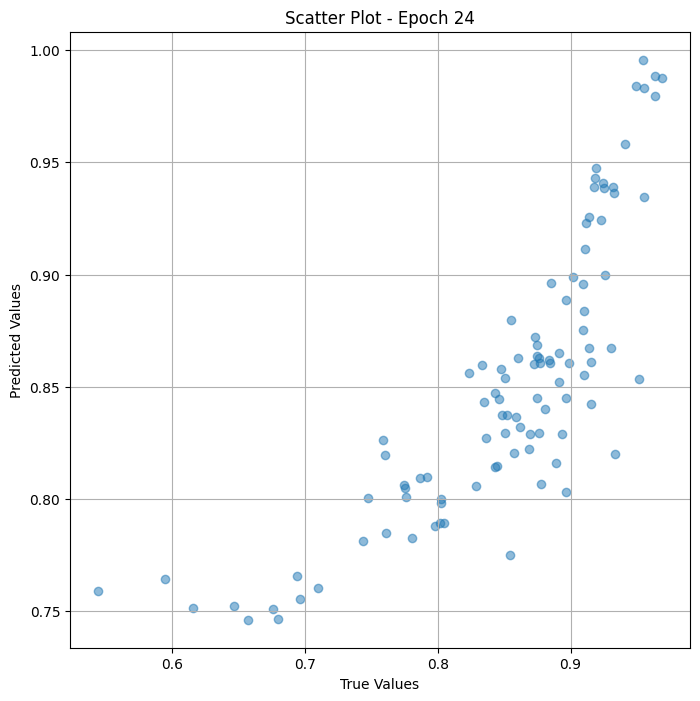

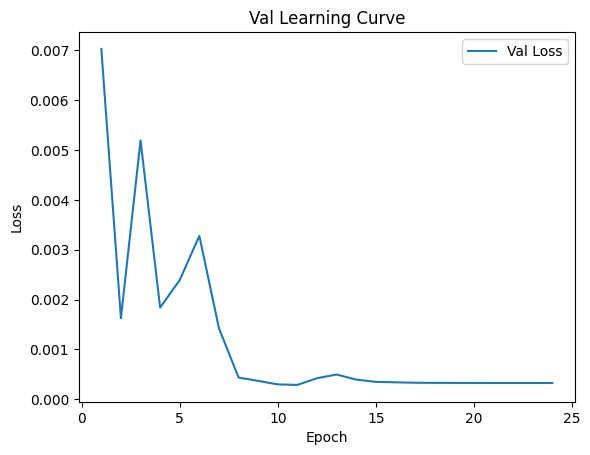


 Epoch: (25/30) Loss = 0.0003260610974393785

 Epoch: (25/30) Loss_rmse = 0.018057161942124367

 Epoch: (25/30) R^2 = 0.8567740321159363

 Epoch: (25/30) MAE = 0.015282943844795227
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

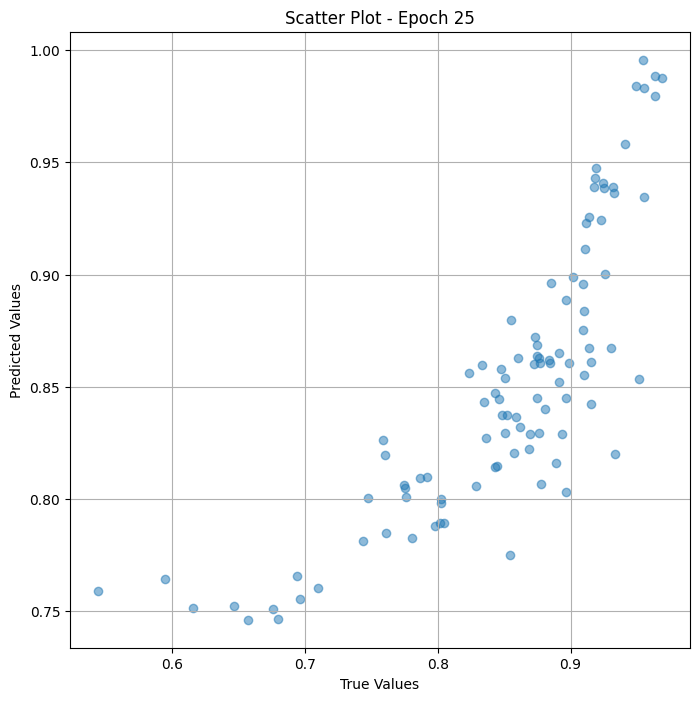

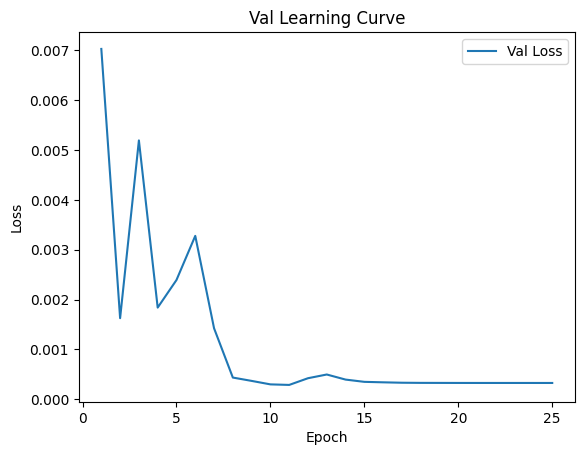


 Epoch: (26/30) Loss = 0.00032600905979052186

 Epoch: (26/30) Loss_rmse = 0.018055720254778862

 Epoch: (26/30) R^2 = 0.85679692029953

 Epoch: (26/30) MAE = 0.0152817964553833
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361703

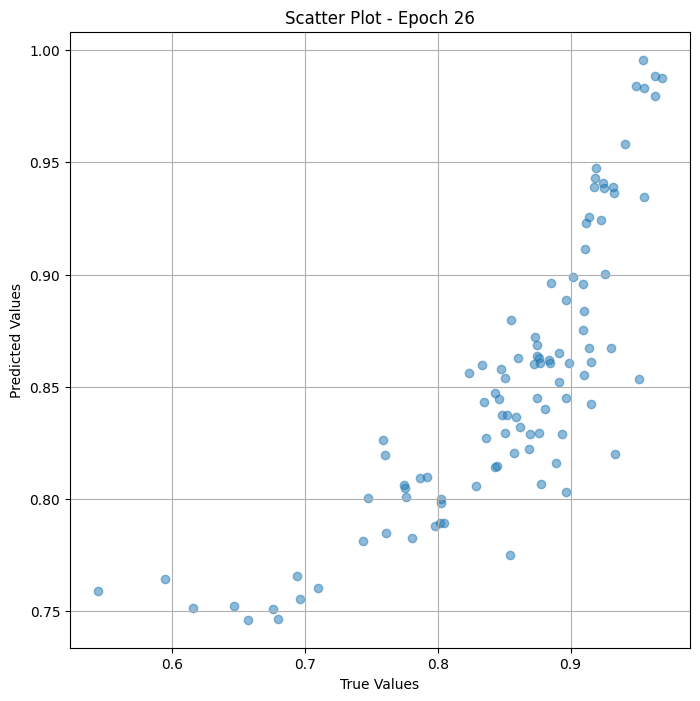

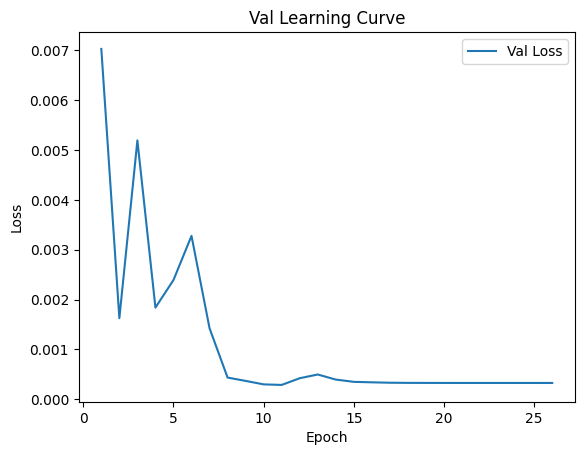


 Epoch: (27/30) Loss = 0.00032595815719105303

 Epoch: (27/30) Loss_rmse = 0.018054312095046043

 Epoch: (27/30) R^2 = 0.8568192720413208

 Epoch: (27/30) MAE = 0.015280723571777344
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936

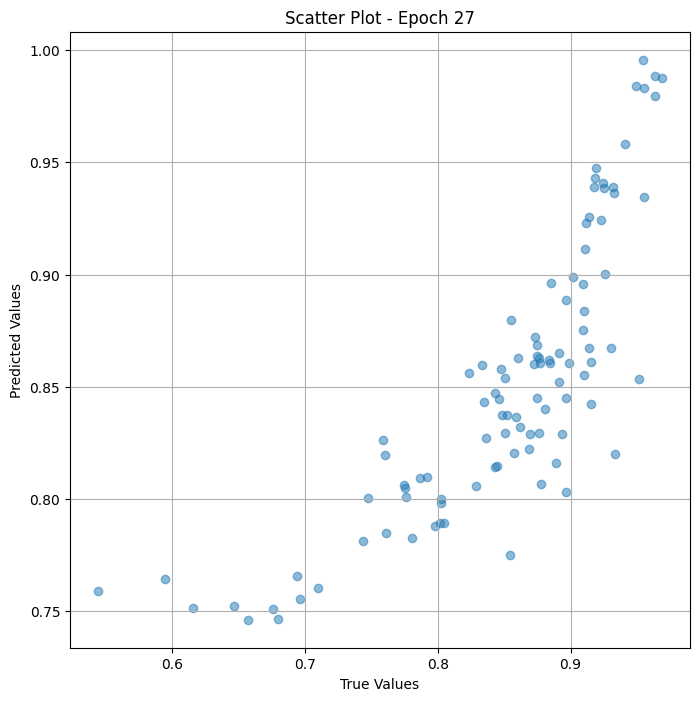

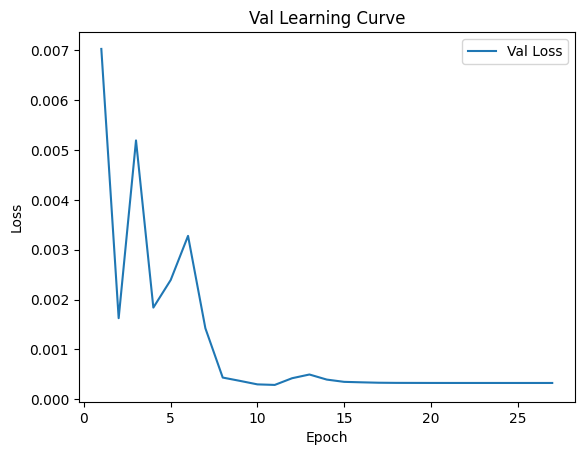


 Epoch: (28/30) Loss = 0.00032590486807748675

 Epoch: (28/30) Loss_rmse = 0.018052835017442703

 Epoch: (28/30) R^2 = 0.8568426370620728

 Epoch: (28/30) MAE = 0.015279576182365417
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.8936

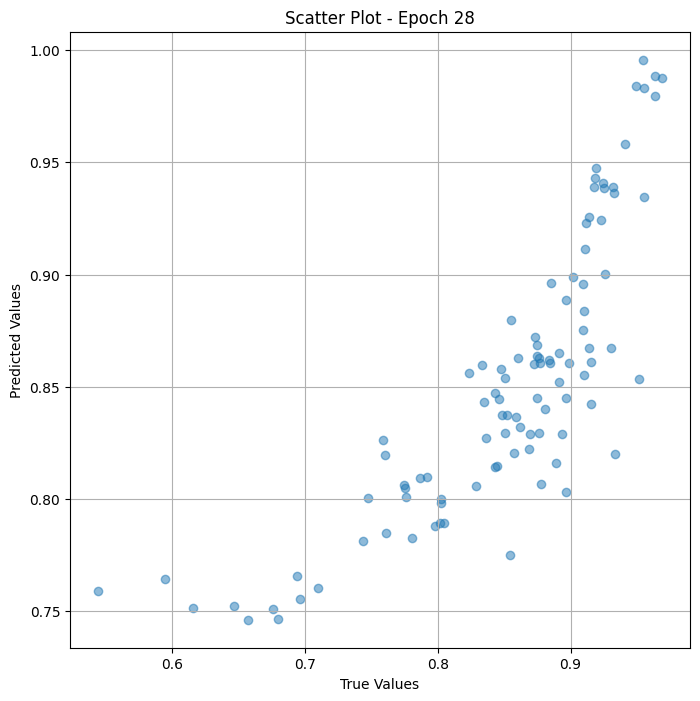

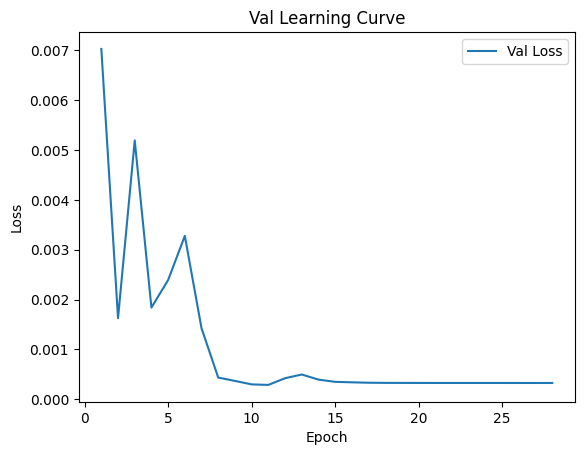


 Epoch: (29/30) Loss = 0.00032585131702944636

 Epoch: (29/30) Loss_rmse = 0.018051352351903915

 Epoch: (29/30) R^2 = 0.856866180896759

 Epoch: (29/30) MAE = 0.015278413891792297
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.89361

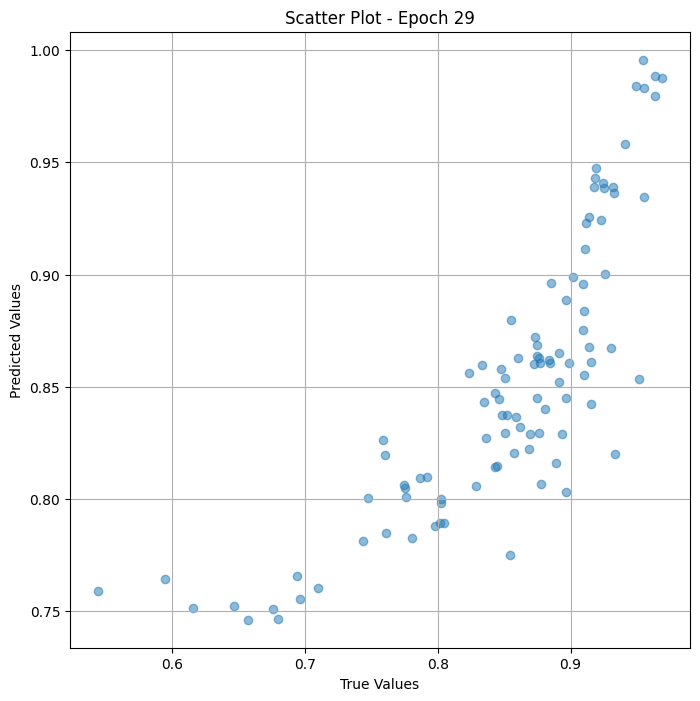

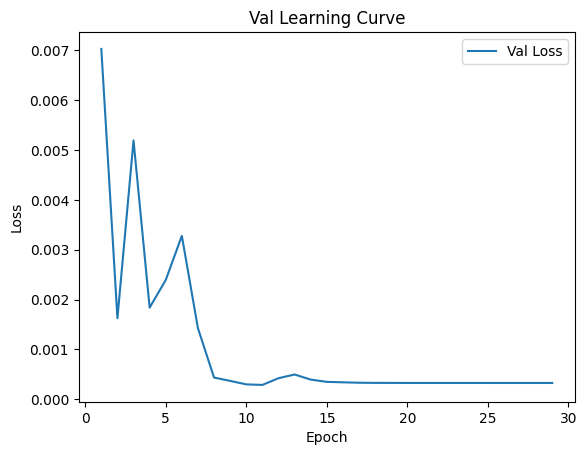


 Epoch: (30/30) Loss = 0.0003257966600358486

 Epoch: (30/30) Loss_rmse = 0.01804983802139759

 Epoch: (30/30) R^2 = 0.8568902015686035

 Epoch: (30/30) MAE = 0.015277236700057983
Spearman correlation coefficient: SignificanceResult(statistic=0.8601010619793268, pvalue=3.159288704755552e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8764045, 0.7809524, 0.96363634, 0.9142857, 0.87356323, 0.93333334, 0.64646465, 0.95555556, 0.6938776, 0.8769231, 0.9550562, 0.5948276, 0.91, 0.88505745, 0.88095236, 0.84821427, 0.7096774, 0.84615386, 0.91071427, 0.9322034, 0.8020833, 0.74725276, 0.9302326, 0.8969072, 0.85087717, 0.9489796, 0.9113924, 0.875, 0.84313726, 0.85087717, 0.8761905, 0.76086956, 0.86915886, 0.86868685, 0.8235294, 0.8888889, 0.9150943, 0.7980769, 0.96875, 0.8910891, 0.91358024, 0.8021978, 0.86170214, 0.8021978, 0.9195402, 0.6756757, 0.9150943, 0.6960784, 0.68, 0.6571429, 0.7604167, 0.8045977, 0.8586956, 0.78640777, 0.9263158, 0.893617

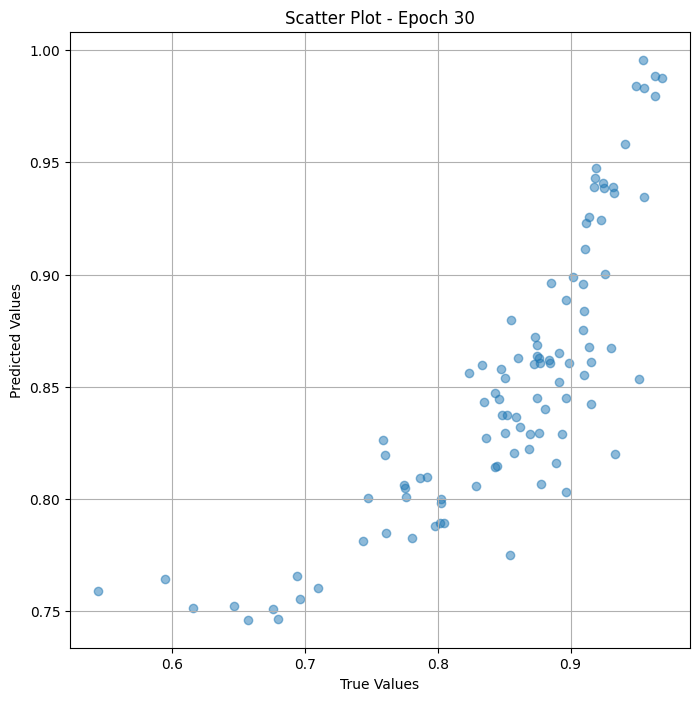

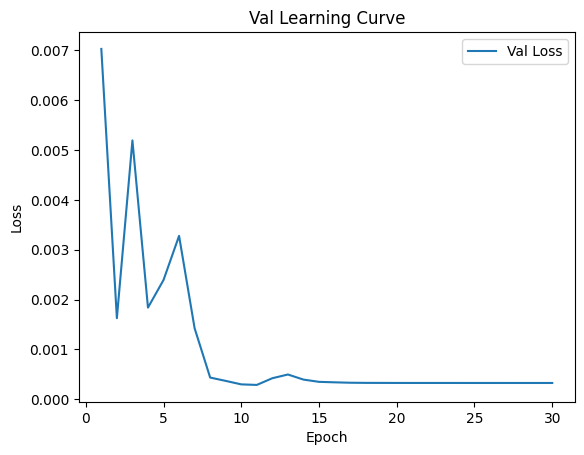

In [ ]:
# val the model and save weights
fit(30, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")


## Test

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-6)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.012563391588628292

 Epoch: (1/30) Loss_rmse = 0.11208653450012207

 Epoch: (1/30) R^2 = -5.612904071807861

 Epoch: (1/30) MAE = 0.11155833303928375
Spearman correlation coefficient: SignificanceResult(statistic=0.3881467615965172, pvalue=9.322195477671118e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396226, 

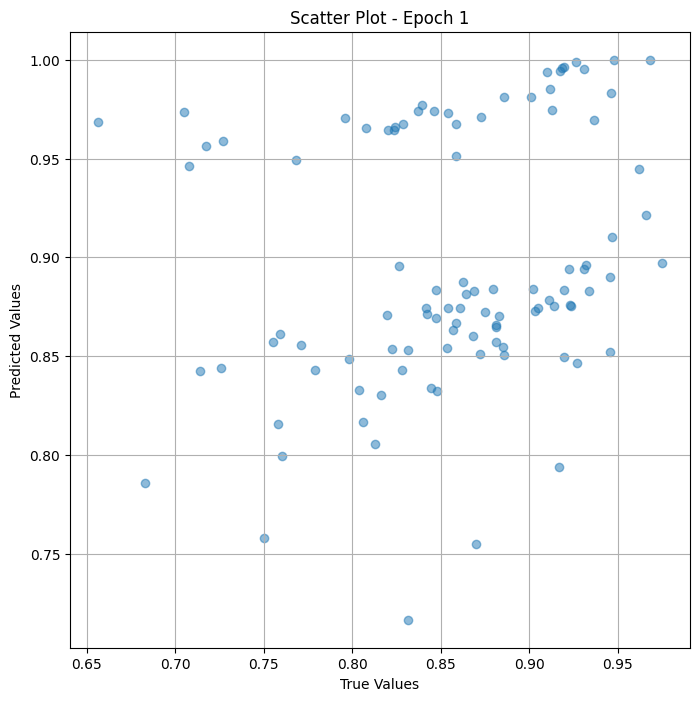

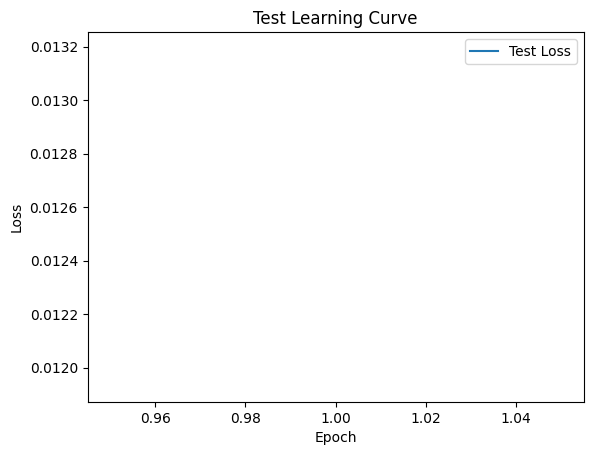


 Epoch: (2/30) Loss = 0.006993491668254137

 Epoch: (2/30) Loss_rmse = 0.08362709730863571

 Epoch: (2/30) R^2 = -2.681114912033081

 Epoch: (2/30) MAE = 0.06749646365642548
Spearman correlation coefficient: SignificanceResult(statistic=0.3473766673410667, pvalue=0.0005250426104994734)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396226, 

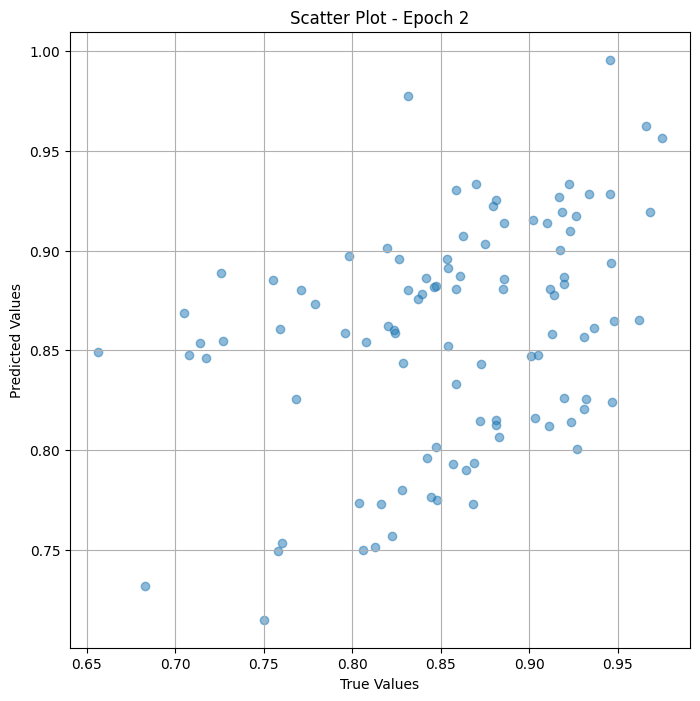

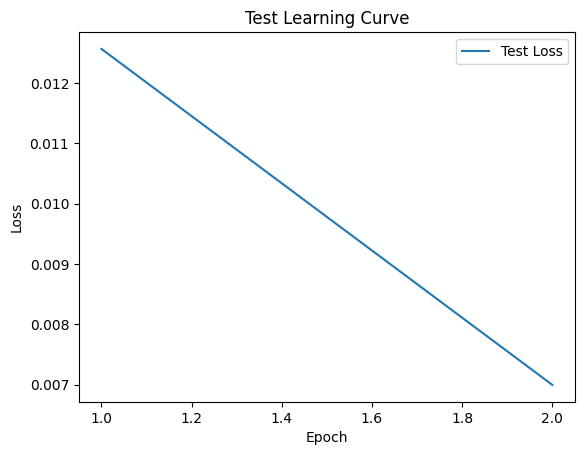


 Epoch: (3/30) Loss = 0.0009769494645297527

 Epoch: (3/30) Loss_rmse = 0.031256191432476044

 Epoch: (3/30) R^2 = 0.48576998710632324

 Epoch: (3/30) MAE = 0.030878141522407532
Spearman correlation coefficient: SignificanceResult(statistic=0.4853614947463045, pvalue=5.385750468672446e-07)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83962

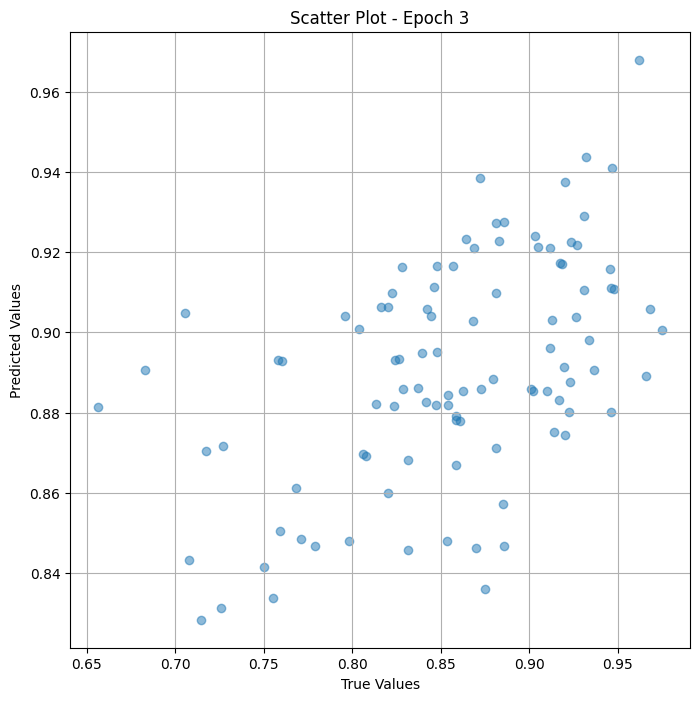

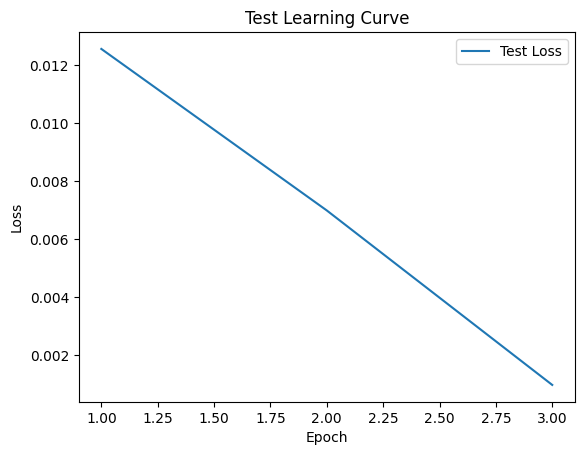


 Epoch: (4/30) Loss = 0.0005858780350536108

 Epoch: (4/30) Loss_rmse = 0.02420491725206375

 Epoch: (4/30) R^2 = 0.6916154623031616

 Epoch: (4/30) MAE = 0.022456377744674683
Spearman correlation coefficient: SignificanceResult(statistic=0.5671594213343486, pvalue=1.6950194965124434e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.839622

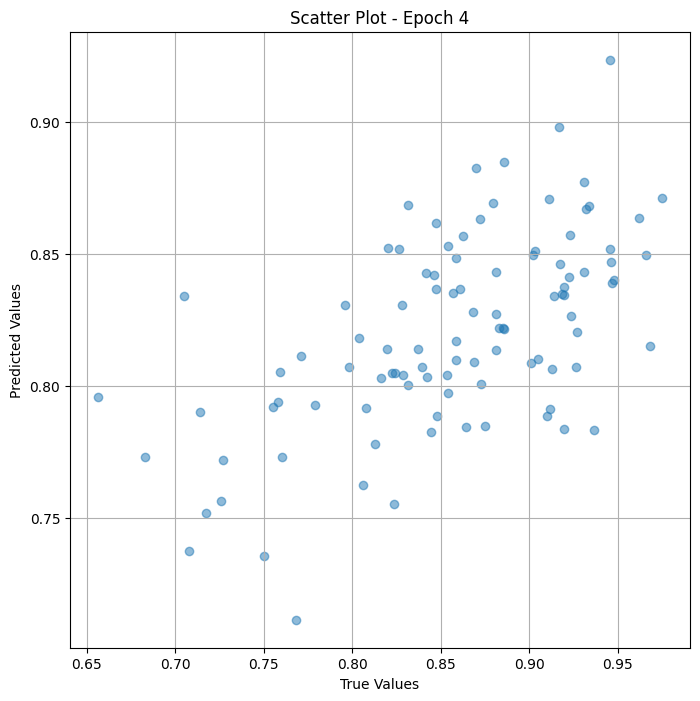

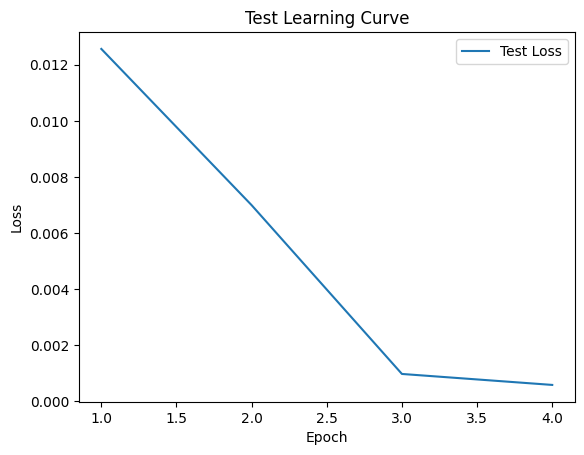


 Epoch: (5/30) Loss = 0.0006999712204560637

 Epoch: (5/30) Loss_rmse = 0.02645696885883808

 Epoch: (5/30) R^2 = 0.6315610408782959

 Epoch: (5/30) MAE = 0.019876524806022644
Spearman correlation coefficient: SignificanceResult(statistic=0.6289894295247805, pvalue=6.764422446113412e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396226

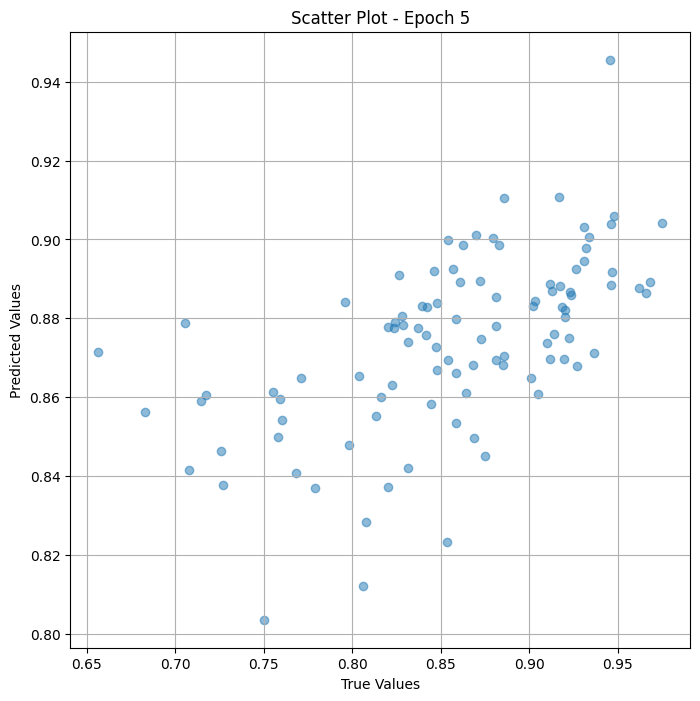

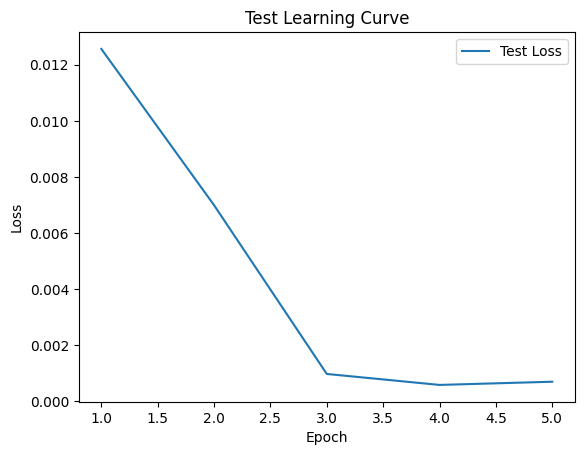


 Epoch: (6/30) Loss = 0.00019858201267197728

 Epoch: (6/30) Loss_rmse = 0.014091912657022476

 Epoch: (6/30) R^2 = 0.8954737782478333

 Epoch: (6/30) MAE = 0.00950545072555542
Spearman correlation coefficient: SignificanceResult(statistic=0.668450485651583, pvalue=9.959058909433101e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396226

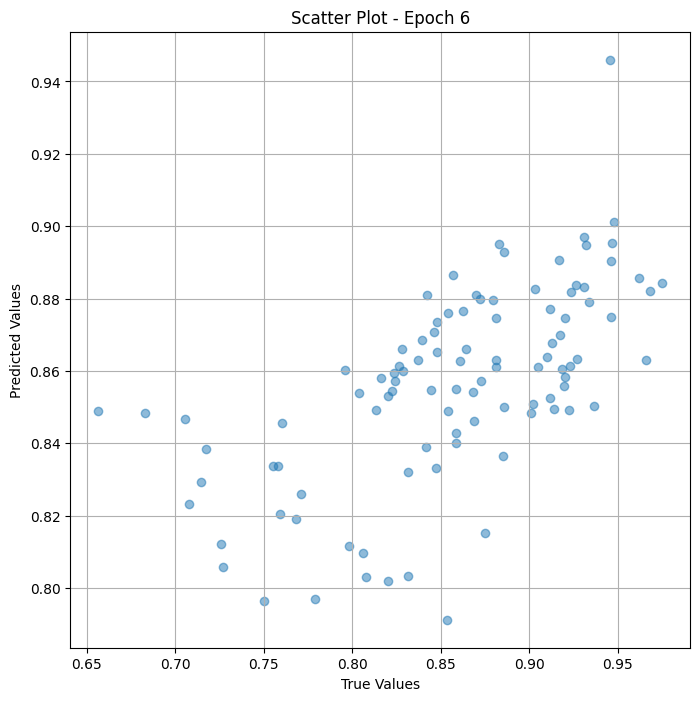

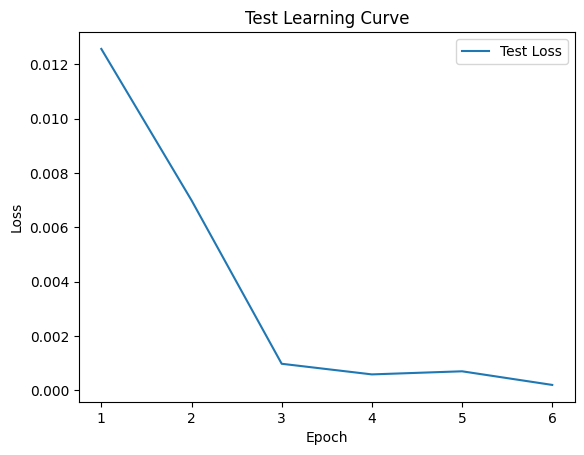


 Epoch: (7/30) Loss = 0.0003837604890577495

 Epoch: (7/30) Loss_rmse = 0.019589805975556374

 Epoch: (7/30) R^2 = 0.7980027198791504

 Epoch: (7/30) MAE = 0.01615762710571289
Spearman correlation coefficient: SignificanceResult(statistic=0.794884577652224, pvalue=4.120563193535919e-22)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396226,

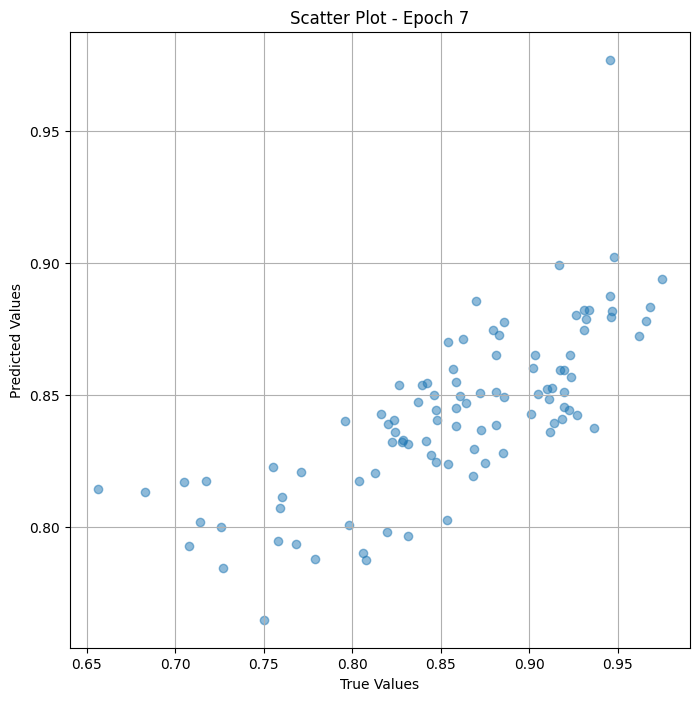

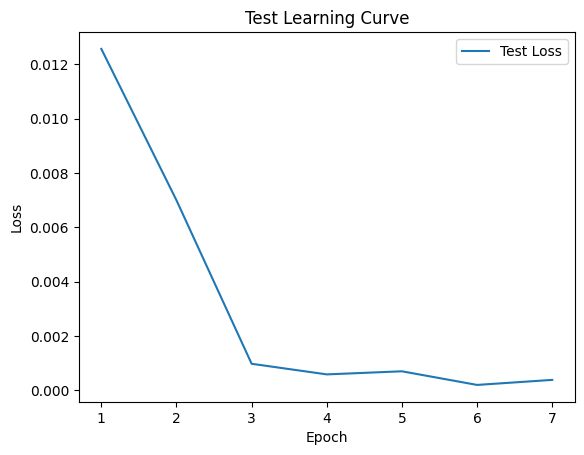


 Epoch: (8/30) Loss = 0.00011727376841008663

 Epoch: (8/30) Loss_rmse = 0.010829301550984383

 Epoch: (8/30) R^2 = 0.9382714033126831

 Epoch: (8/30) MAE = 0.009446695446968079
Spearman correlation coefficient: SignificanceResult(statistic=0.8174434419832219, pvalue=3.0191658819696614e-24)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396

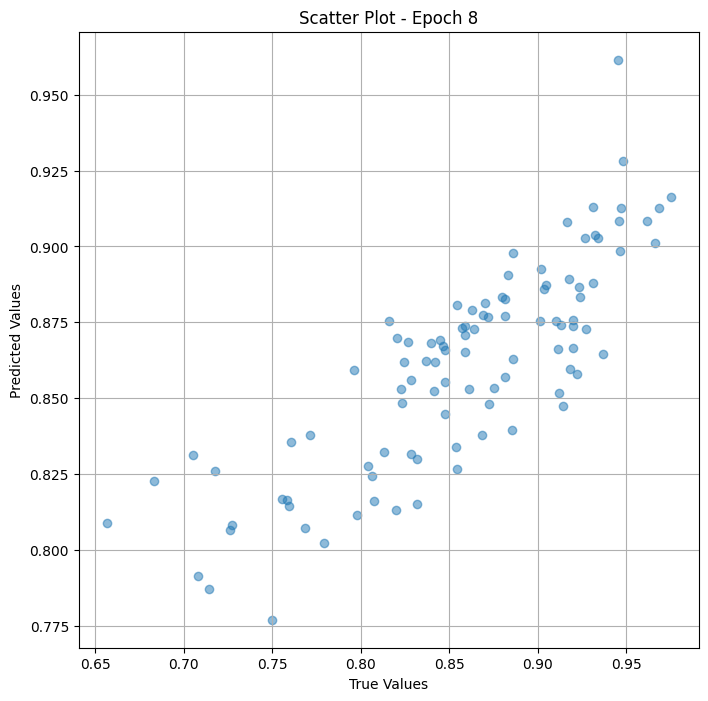

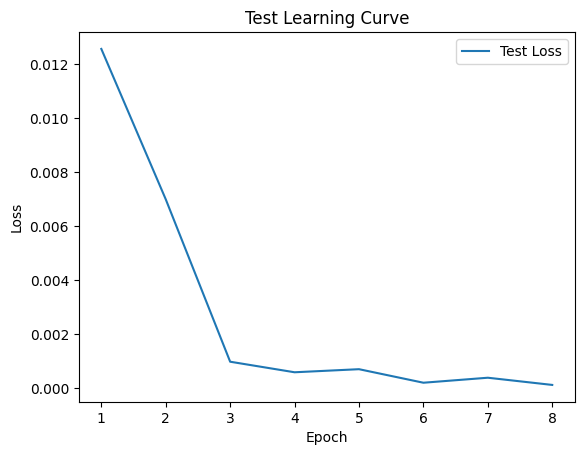


 Epoch: (9/30) Loss = 4.7995123168220744e-05

 Epoch: (9/30) Loss_rmse = 0.0069278511218726635

 Epoch: (9/30) R^2 = 0.9747371673583984

 Epoch: (9/30) MAE = 0.004791423678398132
Spearman correlation coefficient: SignificanceResult(statistic=0.8457675001450521, pvalue=2.1866211974391063e-27)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.839

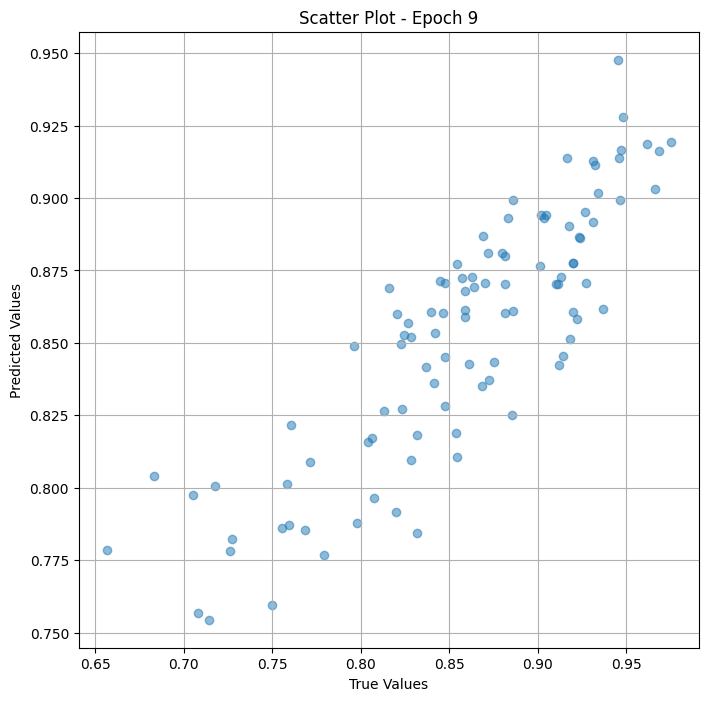

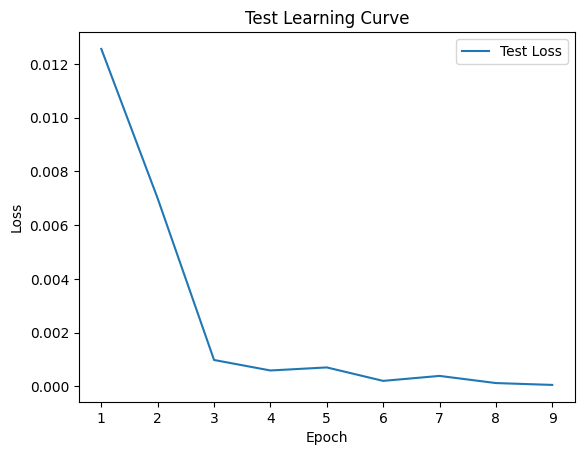


 Epoch: (10/30) Loss = 0.00014725499204359949

 Epoch: (10/30) Loss_rmse = 0.012134866788983345

 Epoch: (10/30) R^2 = 0.9224904179573059

 Epoch: (10/30) MAE = 0.011506661772727966
Spearman correlation coefficient: SignificanceResult(statistic=0.8965283361802862, pvalue=5.263268019173031e-35)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

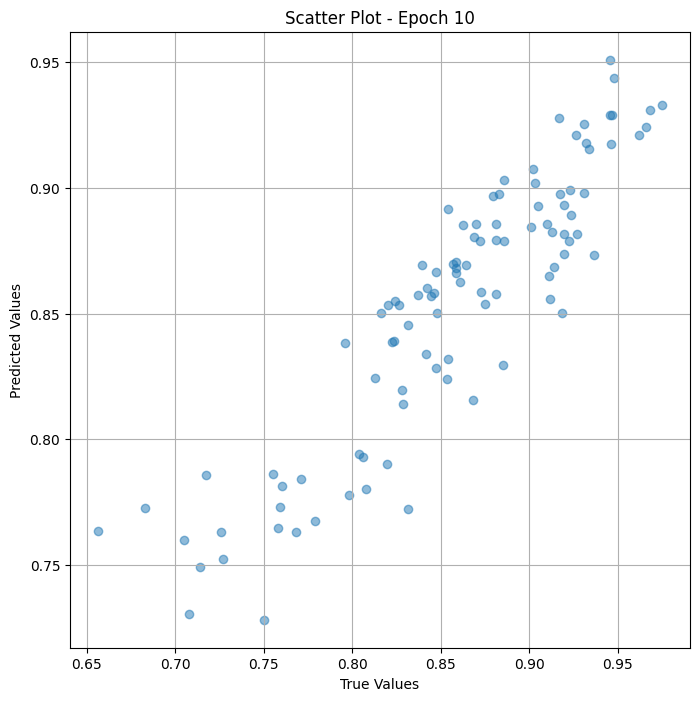

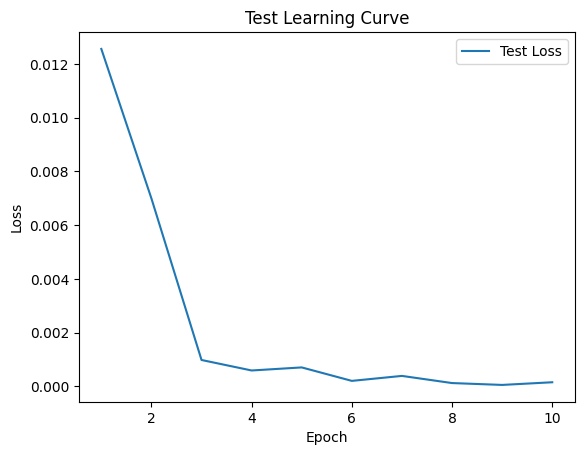


 Epoch: (11/30) Loss = 0.00023996845993679017

 Epoch: (11/30) Loss_rmse = 0.01549091562628746

 Epoch: (11/30) R^2 = 0.8736894726753235

 Epoch: (11/30) MAE = 0.010630697011947632
Spearman correlation coefficient: SignificanceResult(statistic=0.9223835348663245, pvalue=1.3086783009632725e-40)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

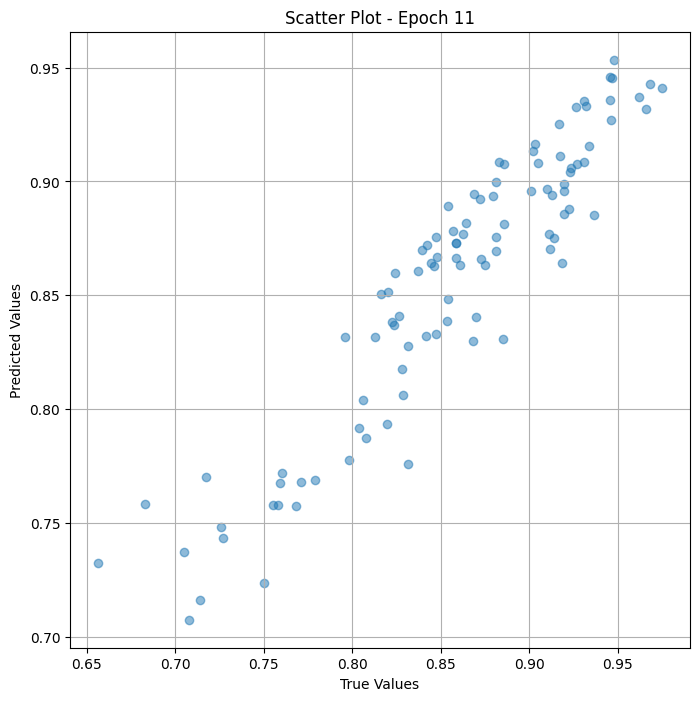

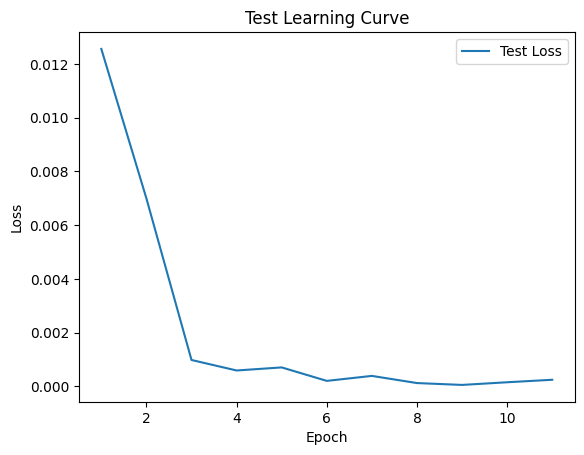

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (12/30) Loss = 0.00016762805171310902

 Epoch: (12/30) Loss_rmse = 0.012947125360369682

 Epoch: (12/30) R^2 = 0.9117668271064758

 Epoch: (12/30) MAE = 0.009565040469169617
Spearman correlation coefficient: SignificanceResult(statistic=0.9580463456457553, pvalue=8.284961325863239e-53)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143

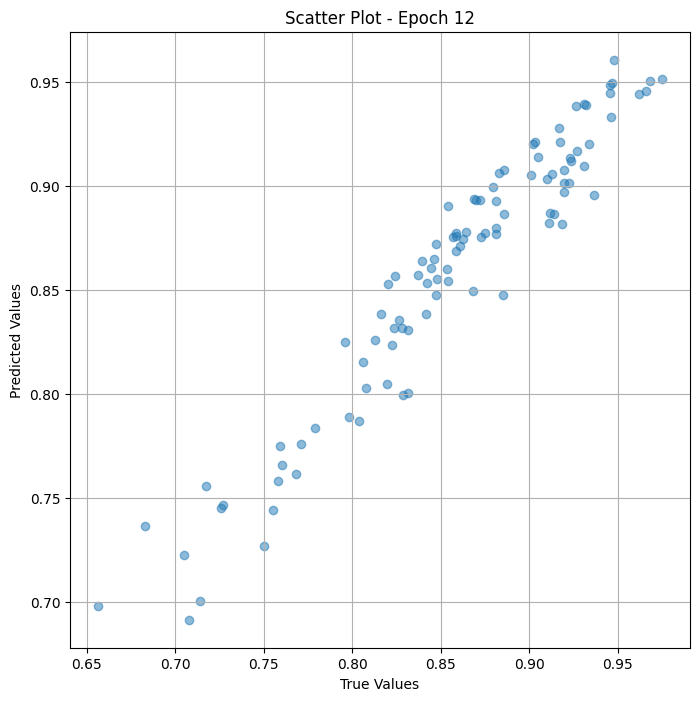

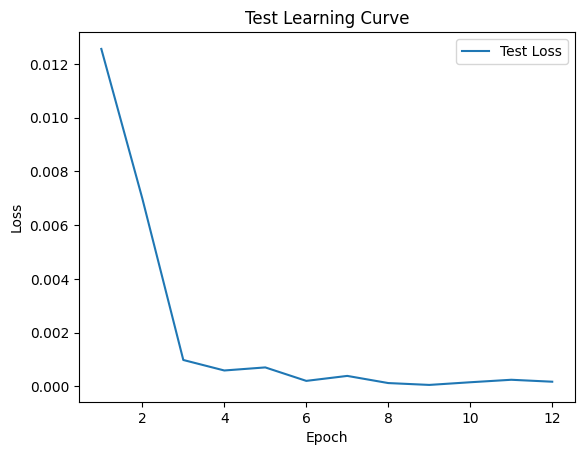


 Epoch: (13/30) Loss = 7.911843567853794e-05

 Epoch: (13/30) Loss_rmse = 0.008894854225218296

 Epoch: (13/30) R^2 = 0.9583550095558167

 Epoch: (13/30) MAE = 0.006878942251205444
Spearman correlation coefficient: SignificanceResult(statistic=0.9736259341509574, pvalue=3.965989904873776e-62)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

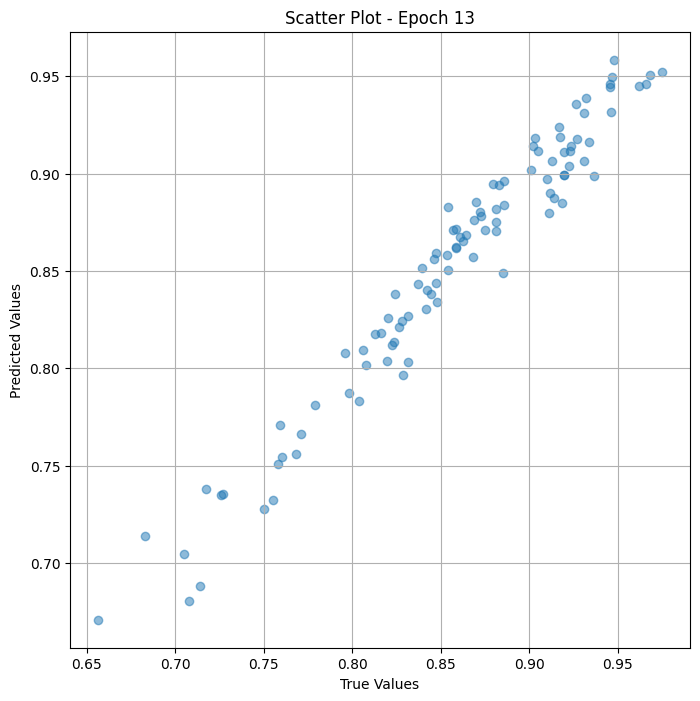

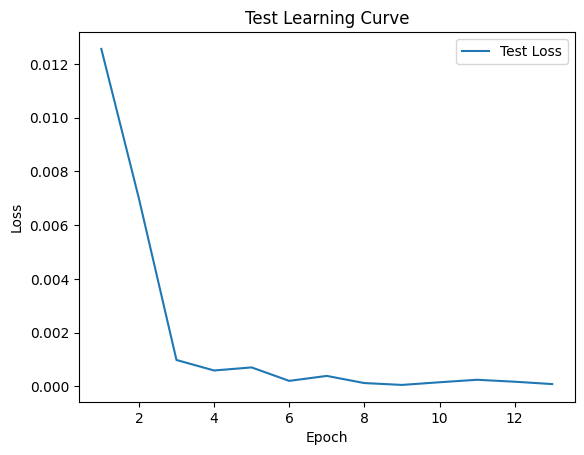


 Epoch: (14/30) Loss = 5.754367521149106e-05

 Epoch: (14/30) Loss_rmse = 0.007585754618048668

 Epoch: (14/30) R^2 = 0.9697111248970032

 Epoch: (14/30) MAE = 0.005602717399597168
Spearman correlation coefficient: SignificanceResult(statistic=0.9753419271382522, pvalue=1.7462214578318525e-63)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

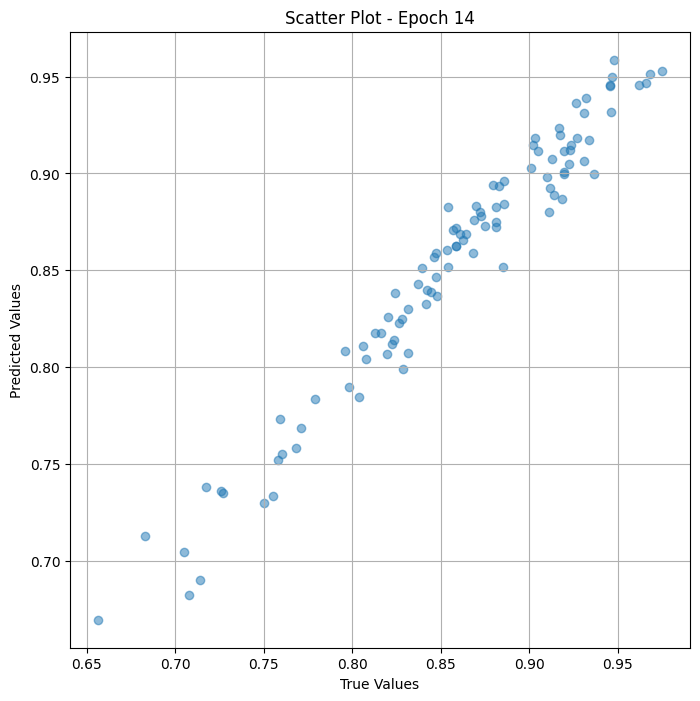

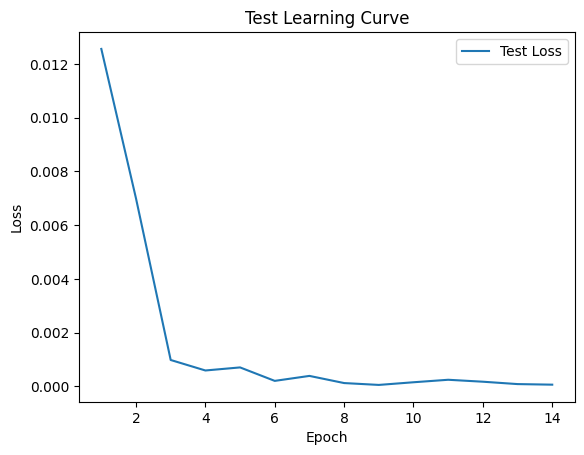


 Epoch: (15/30) Loss = 3.54495168721769e-05

 Epoch: (15/30) Loss_rmse = 0.005953949876129627

 Epoch: (15/30) R^2 = 0.9813407063484192

 Epoch: (15/30) MAE = 0.00449429452419281
Spearman correlation coefficient: SignificanceResult(statistic=0.9770647027065245, pvalue=6.036291855085168e-65)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8396

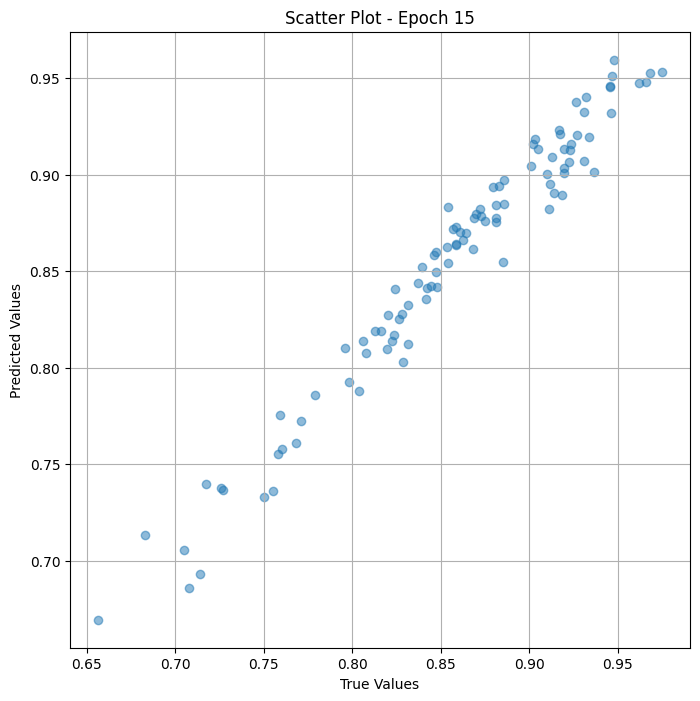

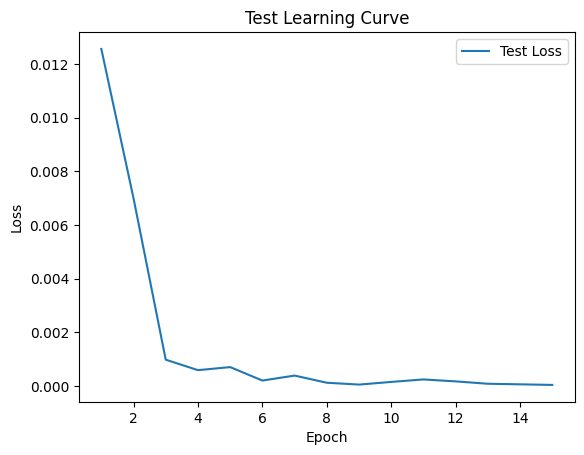


 Epoch: (16/30) Loss = 1.5708472346886992e-05

 Epoch: (16/30) Loss_rmse = 0.003963391296565533

 Epoch: (16/30) R^2 = 0.9917316436767578

 Epoch: (16/30) MAE = 0.003292098641395569
Spearman correlation coefficient: SignificanceResult(statistic=0.9781499156629164, pvalue=6.340019244292481e-66)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

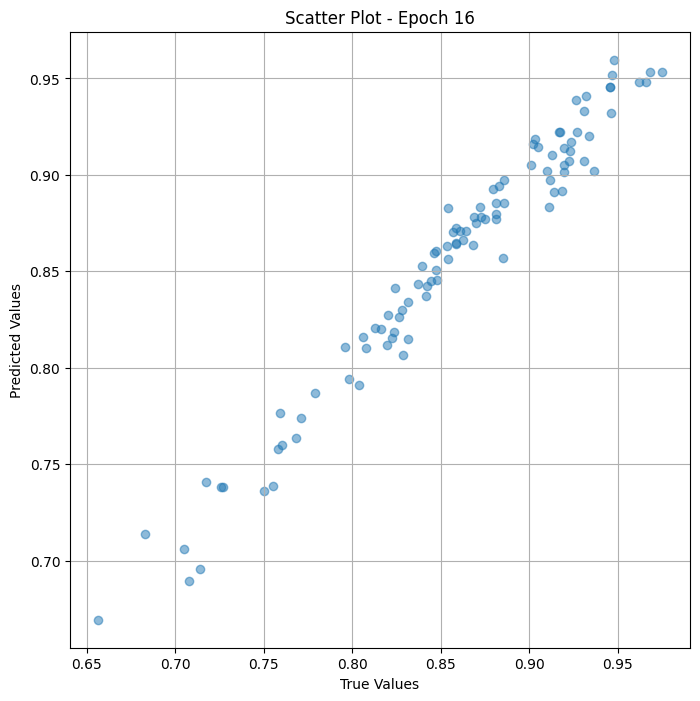

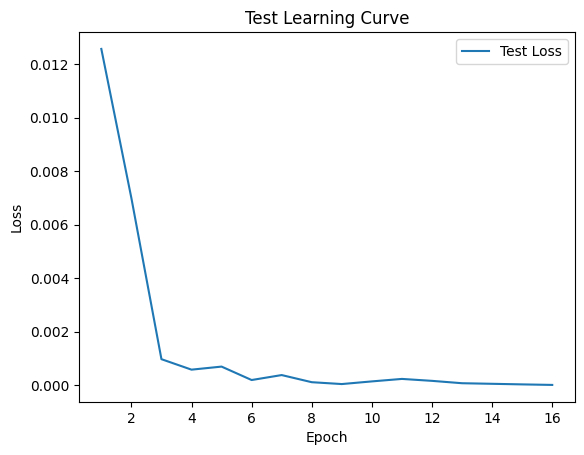


 Epoch: (17/30) Loss = 6.020025921316119e-06

 Epoch: (17/30) Loss_rmse = 0.002453574212267995

 Epoch: (17/30) R^2 = 0.9968312978744507

 Epoch: (17/30) MAE = 0.0016913264989852905
Spearman correlation coefficient: SignificanceResult(statistic=0.9792079982953986, pvalue=6.300513908757477e-67)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

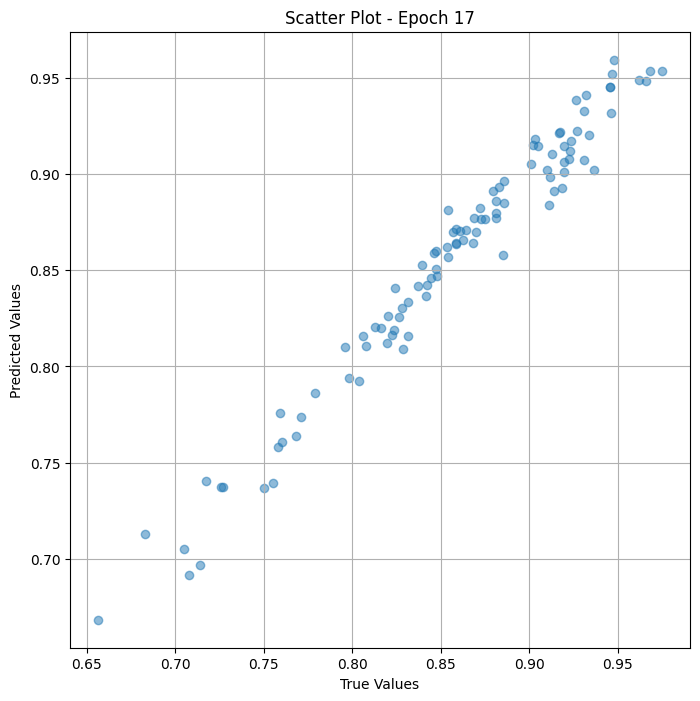

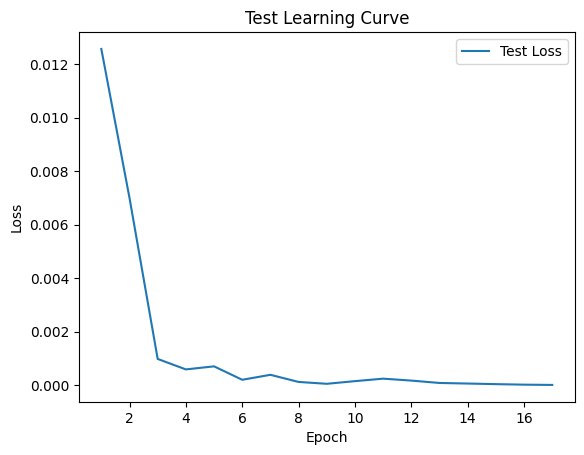


 Epoch: (18/30) Loss = 6.166600087453844e-06

 Epoch: (18/30) Loss_rmse = 0.0024832640774548054

 Epoch: (18/30) R^2 = 0.9967541098594666

 Epoch: (18/30) MAE = 0.002141237258911133
Spearman correlation coefficient: SignificanceResult(statistic=0.9810325125783327, pvalue=8.76450599228103e-69)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

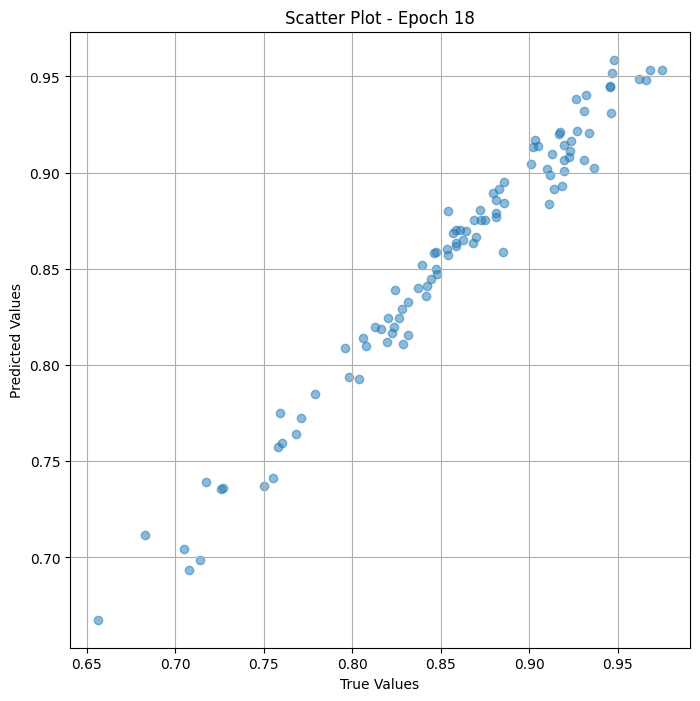

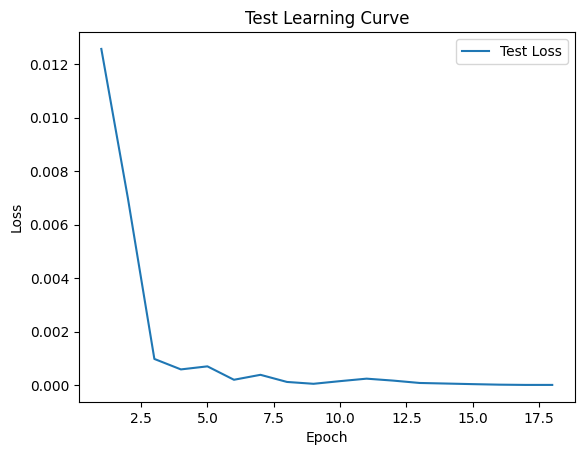


 Epoch: (19/30) Loss = 6.037377261236543e-06

 Epoch: (19/30) Loss_rmse = 0.0024571074172854424

 Epoch: (19/30) R^2 = 0.9968221187591553

 Epoch: (19/30) MAE = 0.0020455121994018555
Spearman correlation coefficient: SignificanceResult(statistic=0.9820024216581079, pvalue=7.601499768653909e-70)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.

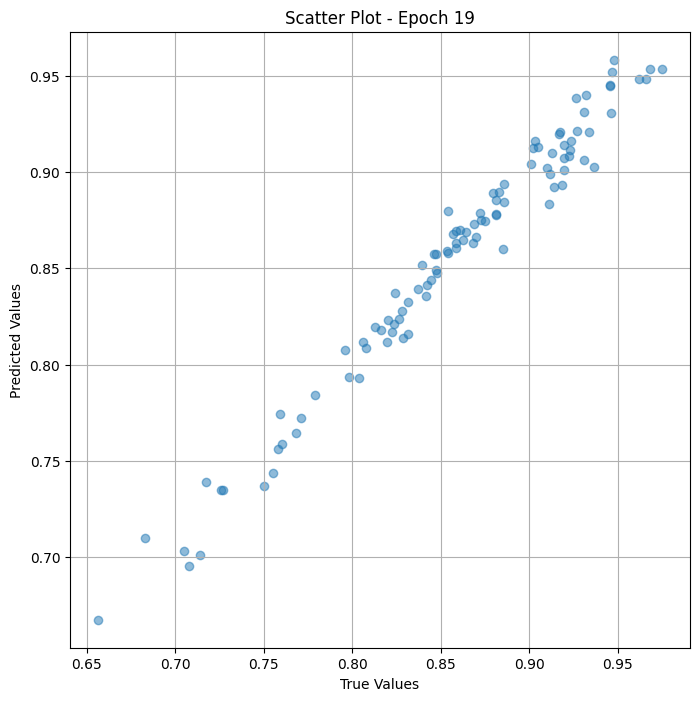

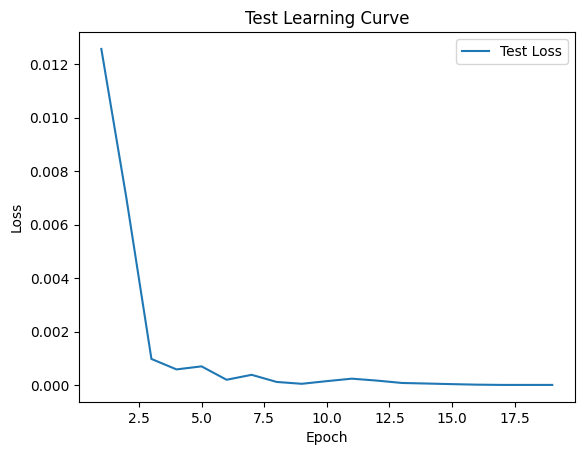


 Epoch: (20/30) Loss = 3.570179387679673e-06

 Epoch: (20/30) Loss_rmse = 0.0018894918030127883

 Epoch: (20/30) R^2 = 0.9981207847595215

 Epoch: (20/30) MAE = 0.0015836656093597412
Spearman correlation coefficient: SignificanceResult(statistic=0.982802766213447, pvalue=9.126125187667565e-71)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

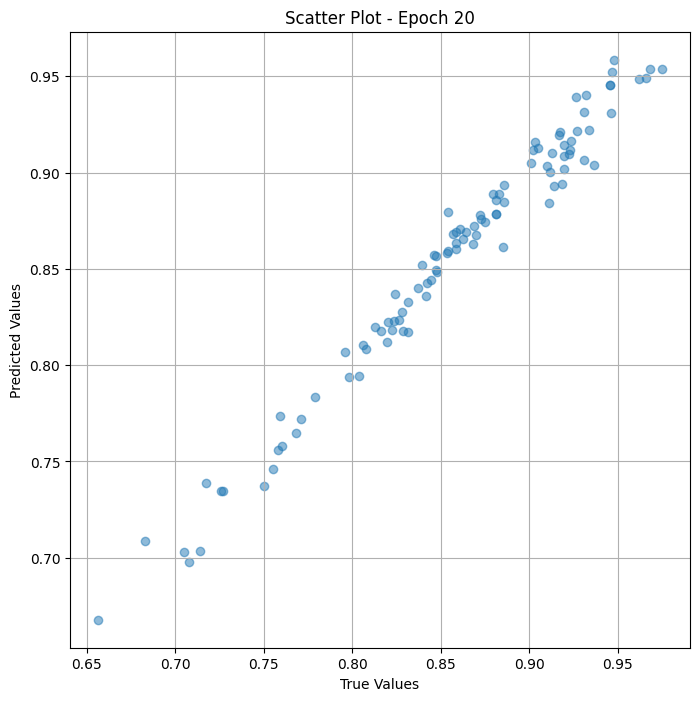

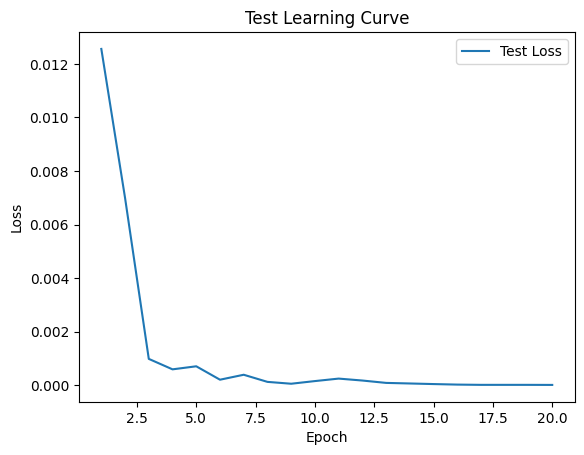


 Epoch: (21/30) Loss = 1.7919526271725772e-06

 Epoch: (21/30) Loss_rmse = 0.0013386383652687073

 Epoch: (21/30) R^2 = 0.9990567564964294

 Epoch: (21/30) MAE = 0.0011344999074935913
Spearman correlation coefficient: SignificanceResult(statistic=0.9837591101312674, pvalue=6.336119891609381e-72)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0

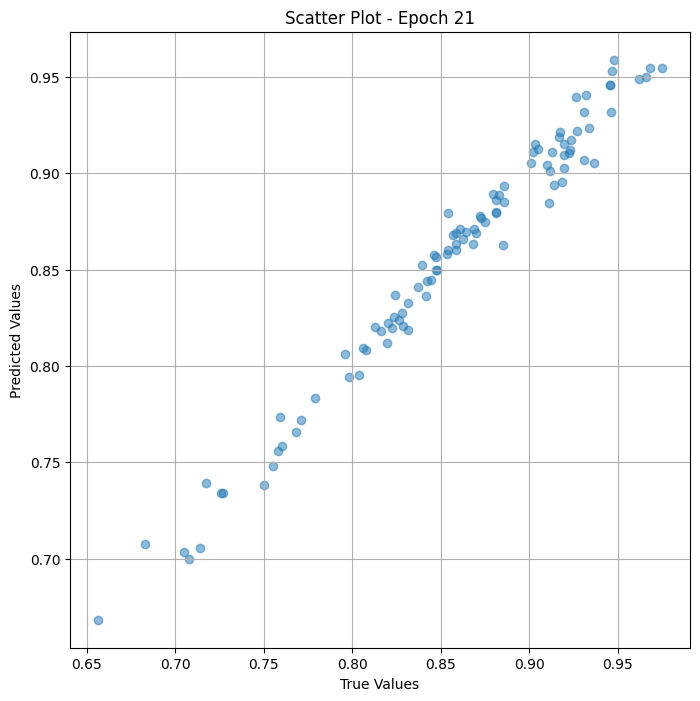

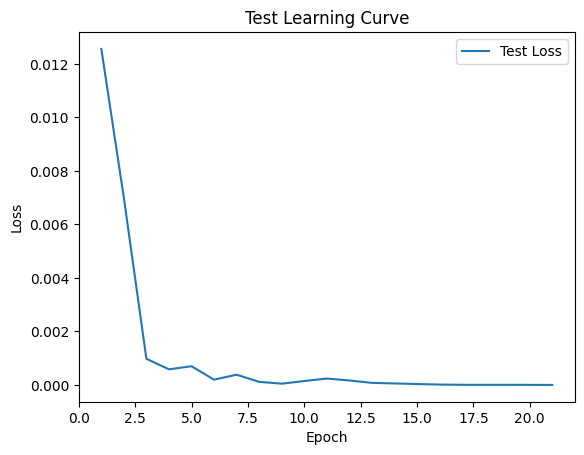


 Epoch: (22/30) Loss = 5.734480623686977e-07

 Epoch: (22/30) Loss_rmse = 0.000757263507694006

 Epoch: (22/30) R^2 = 0.9996981620788574

 Epoch: (22/30) MAE = 0.0006294846534729004
Spearman correlation coefficient: SignificanceResult(statistic=0.9853191037560809, pvalue=5.7003875029986524e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.

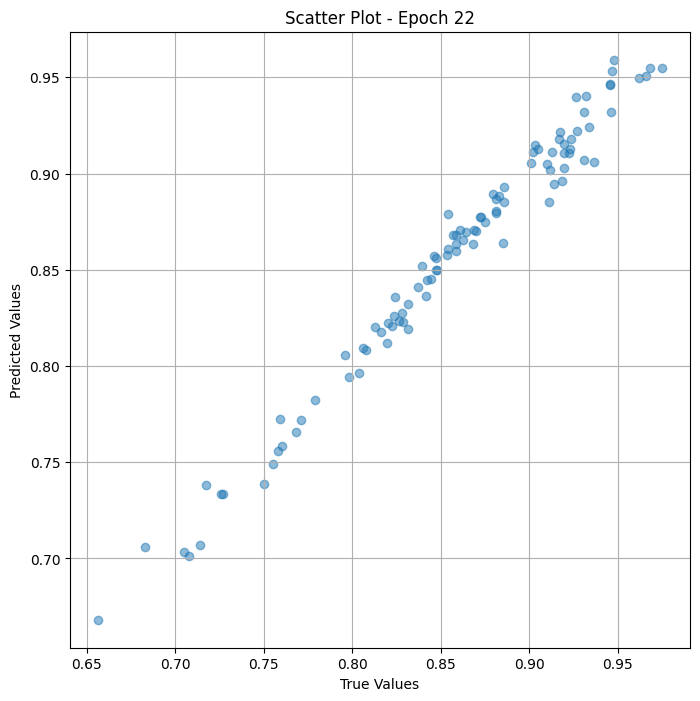

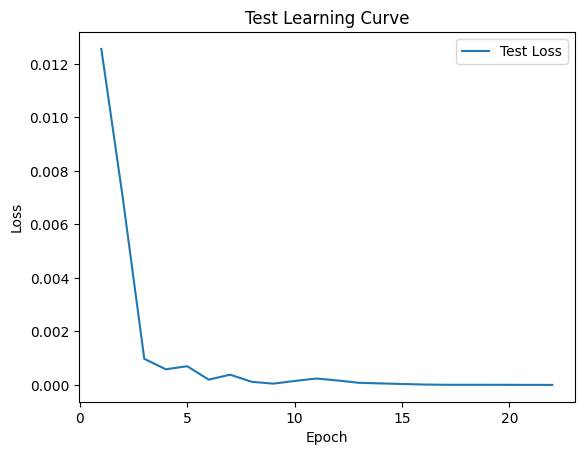


 Epoch: (23/30) Loss = 1.3951046184956795e-07

 Epoch: (23/30) Loss_rmse = 0.0003735109930858016

 Epoch: (23/30) R^2 = 0.9999265670776367

 Epoch: (23/30) MAE = 0.0002582371234893799
Spearman correlation coefficient: SignificanceResult(statistic=0.985909188301119, pvalue=8.401129831033934e-75)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.

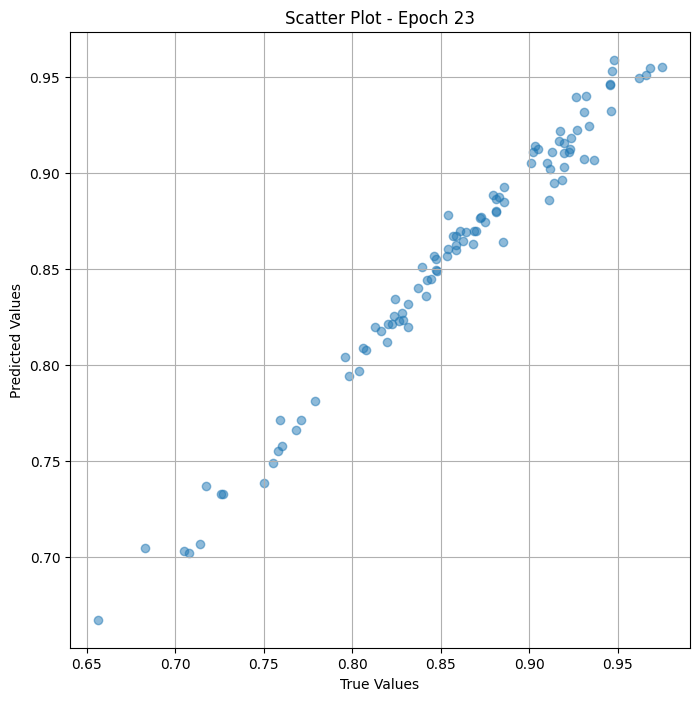

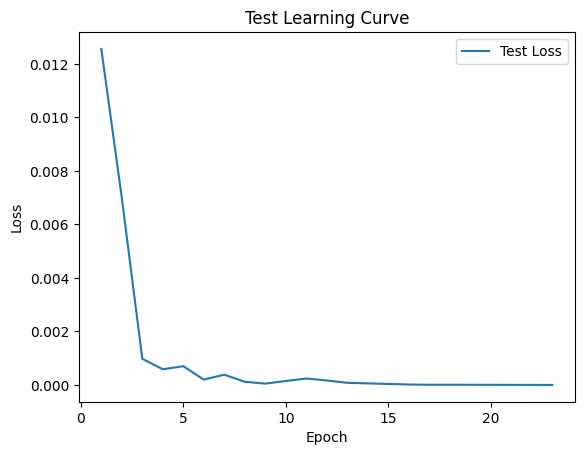


 Epoch: (24/30) Loss = 2.101038063528904e-07

 Epoch: (24/30) Loss_rmse = 0.0004583708068821579

 Epoch: (24/30) R^2 = 0.9998894333839417

 Epoch: (24/30) MAE = 0.00033427774906158447
Spearman correlation coefficient: SignificanceResult(statistic=0.9862144044451041, pvalue=3.0223902111598075e-75)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 

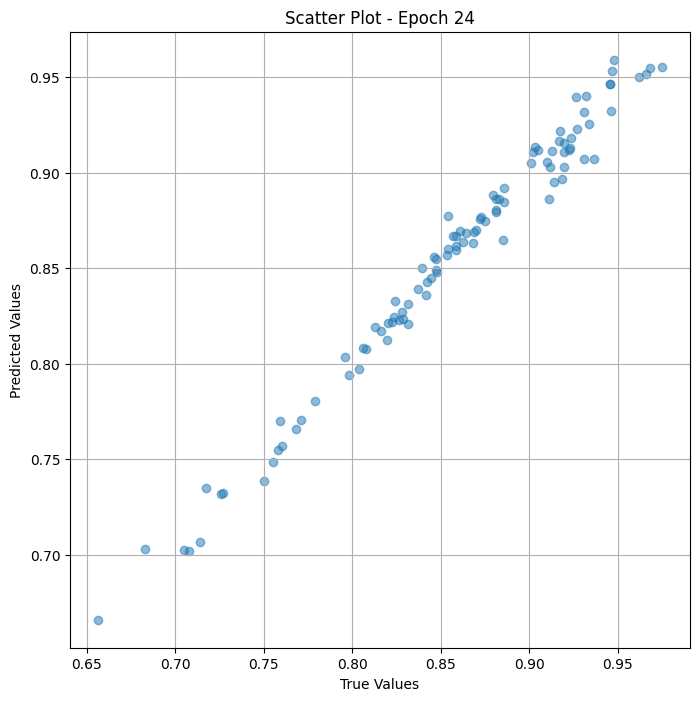

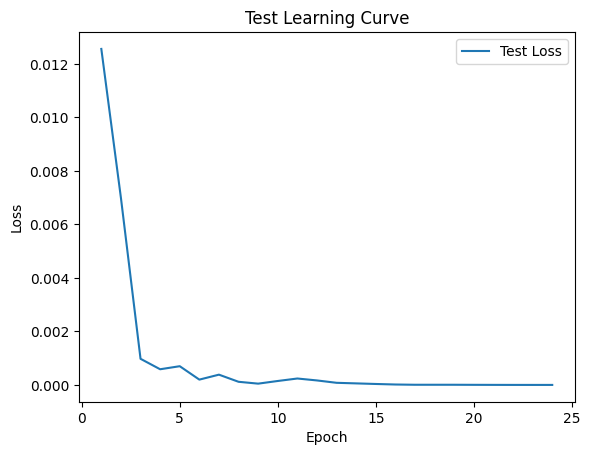


 Epoch: (25/30) Loss = 3.1241995657182997e-07

 Epoch: (25/30) Loss_rmse = 0.0005589454085566103

 Epoch: (25/30) R^2 = 0.9998355507850647

 Epoch: (25/30) MAE = 0.0003787875175476074
Spearman correlation coefficient: SignificanceResult(statistic=0.9873606606302933, pvalue=5.2441946904966e-77)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

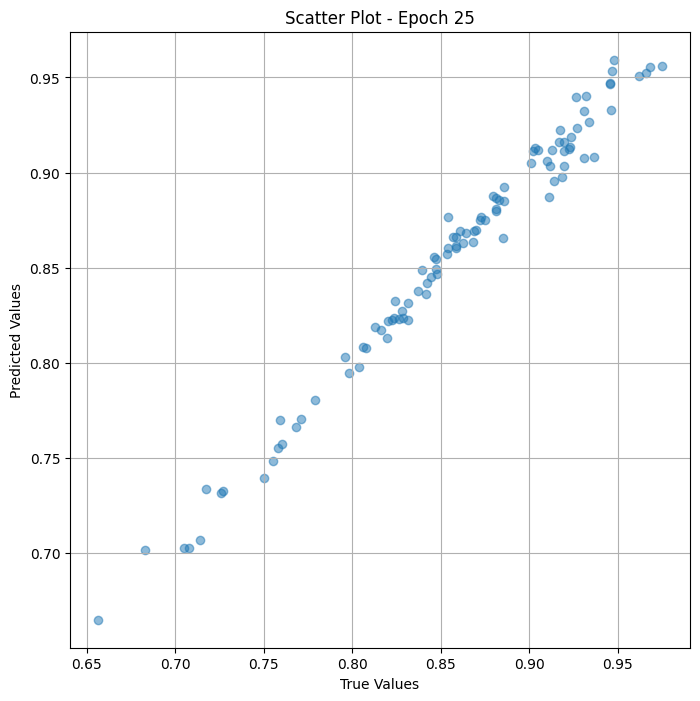

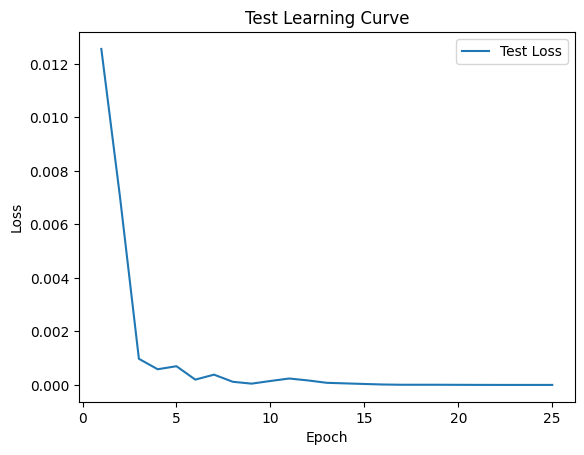

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (26/30) Loss = 3.9487977687713283e-07

 Epoch: (26/30) Loss_rmse = 0.0006283945986069739

 Epoch: (26/30) R^2 = 0.9997921586036682

 Epoch: (26/30) MAE = 0.0004497319459915161
Spearman correlation coefficient: SignificanceResult(statistic=0.98848656907255, pvalue=6.703988096824416e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143

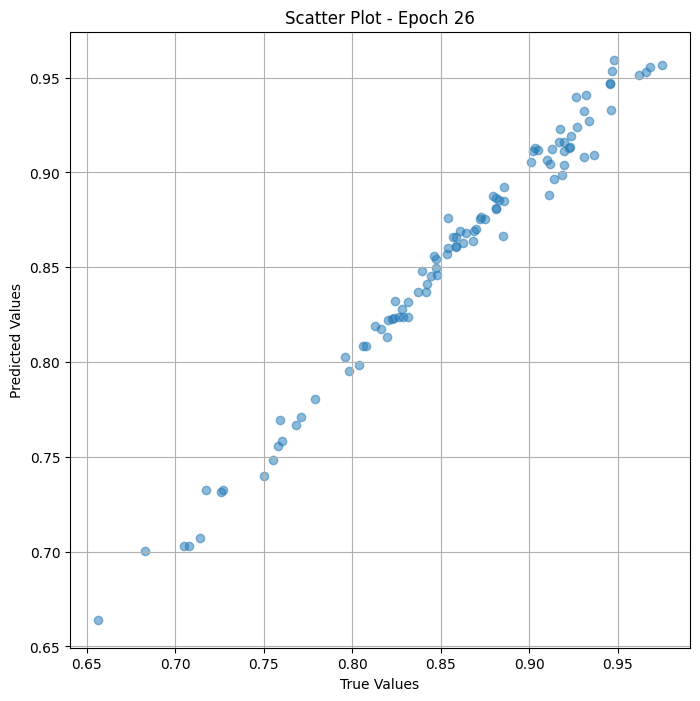

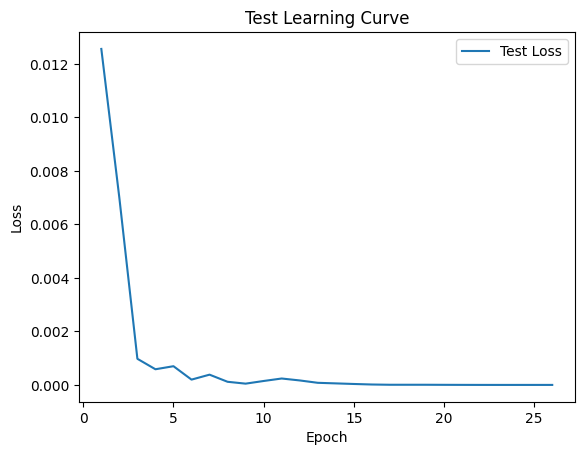


 Epoch: (27/30) Loss = 4.036336918034067e-07

 Epoch: (27/30) Loss_rmse = 0.0006353217177093029

 Epoch: (27/30) R^2 = 0.9997875690460205

 Epoch: (27/30) MAE = 0.0004692375659942627
Spearman correlation coefficient: SignificanceResult(statistic=0.98880535037849, pvalue=1.8044225555866896e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.8

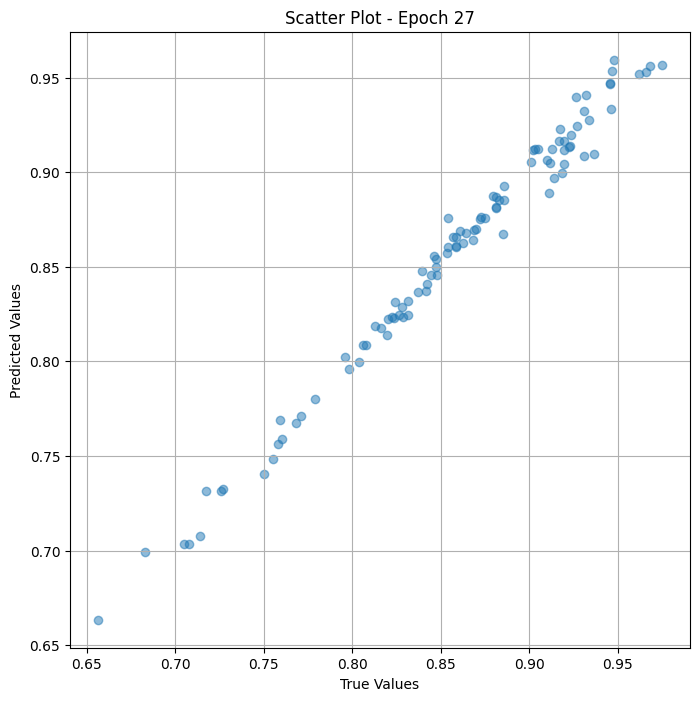

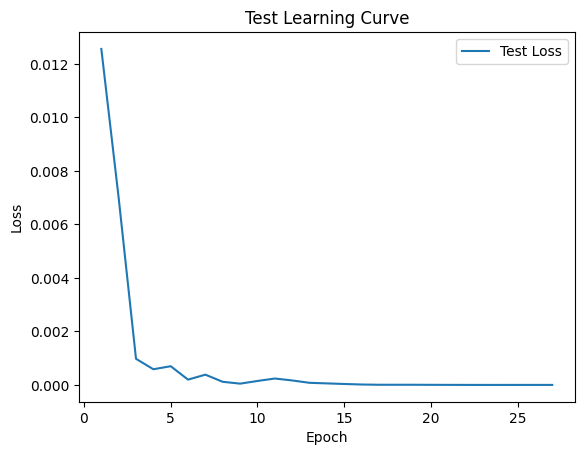


 Epoch: (28/30) Loss = 3.947097013679013e-07

 Epoch: (28/30) Loss_rmse = 0.0006282592657953501

 Epoch: (28/30) R^2 = 0.999792218208313

 Epoch: (28/30) MAE = 0.0004585534334182739
Spearman correlation coefficient: SignificanceResult(statistic=0.98880535037849, pvalue=1.8044225555866896e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.83

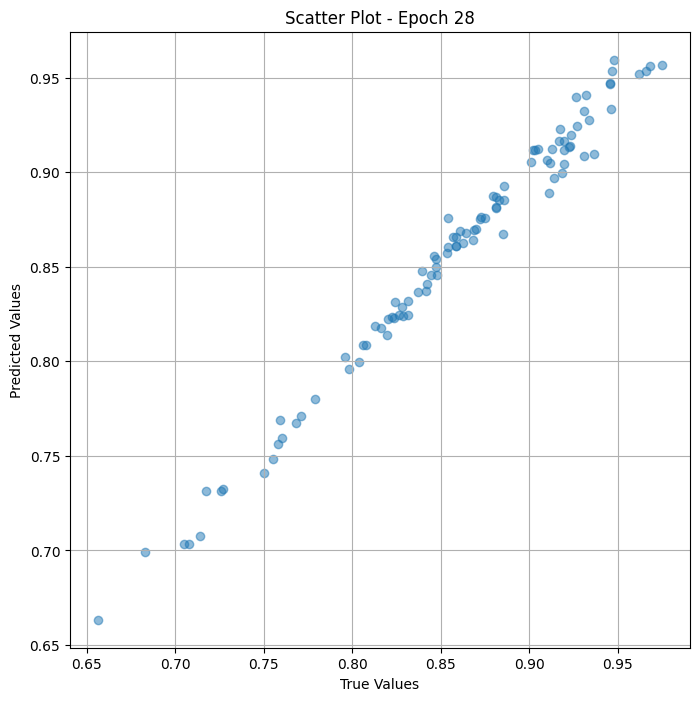

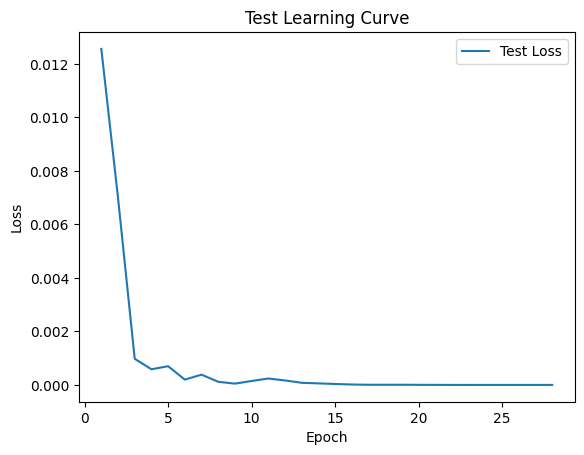

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (29/30) Loss = 3.8090684029157273e-07

 Epoch: (29/30) Loss_rmse = 0.0006171765271574259

 Epoch: (29/30) R^2 = 0.9997994899749756

 Epoch: (29/30) MAE = 0.00044186413288116455
Spearman correlation coefficient: SignificanceResult(statistic=0.98880535037849, pvalue=1.8044225555866896e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.88571

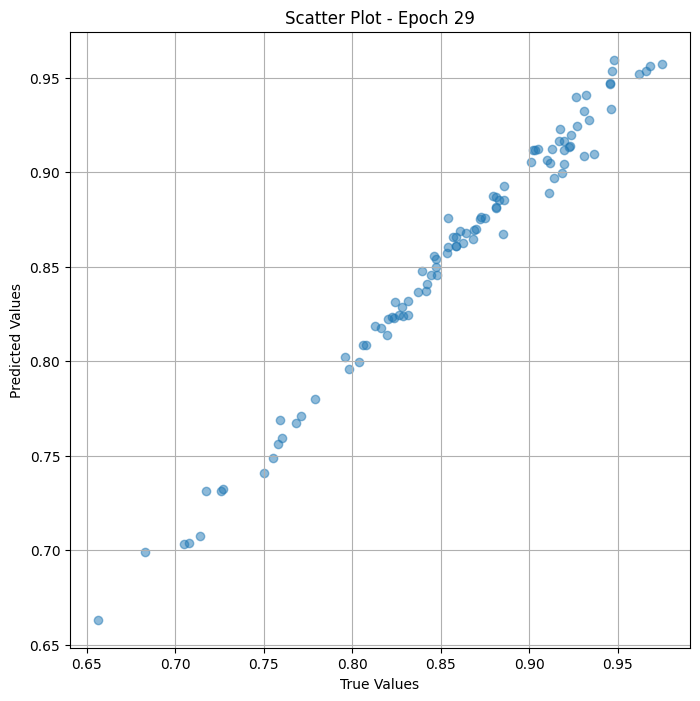

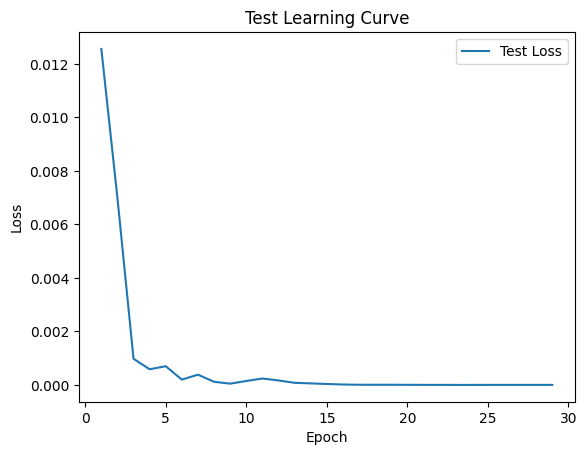


 Epoch: (30/30) Loss = 3.7567261301774124e-07

 Epoch: (30/30) Loss_rmse = 0.0006129213725216687

 Epoch: (30/30) R^2 = 0.9998022317886353

 Epoch: (30/30) MAE = 0.0004367232322692871
Spearman correlation coefficient: SignificanceResult(statistic=0.9889274368360842, pvalue=1.08070913900337e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7604167, 0.8811881, 0.8039216, 0.9237288, 0.85714287, 0.8131868, 0.9310345, 0.91150445, 0.9322034, 0.8446602, 0.88297874, 0.84782606, 0.75, 0.9047619, 0.6831683, 0.7582418, 0.8811881, 0.81609195, 0.92, 0.8224299, 0.86904764, 0.84761906, 0.8684211, 0.92727274, 0.9468085, 0.84210527, 0.96190476, 0.82828283, 0.8061224, 0.8640777, 0.9032258, 0.872093, 0.9310345, 0.82857144, 0.82417583, 0.79591835, 0.8235294, 0.7176471, 0.65656567, 0.9117647, 0.70526314, 0.9130435, 0.8076923, 0.9479167, 0.8543689, 0.8369565, 0.9266055, 0.94623655, 0.8586956, 0.8857143, 0.9009901, 0.872549, 0.72727275, 0.91752577, 0.9368421, 0.

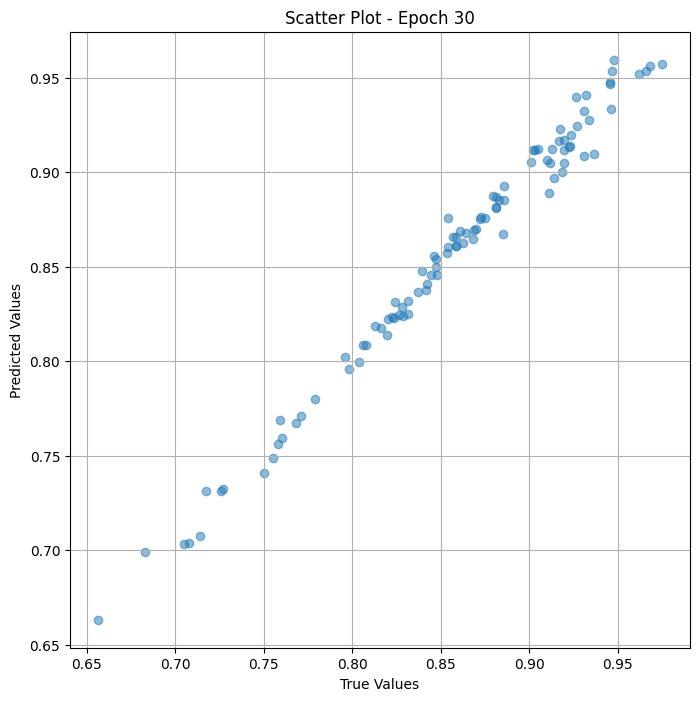

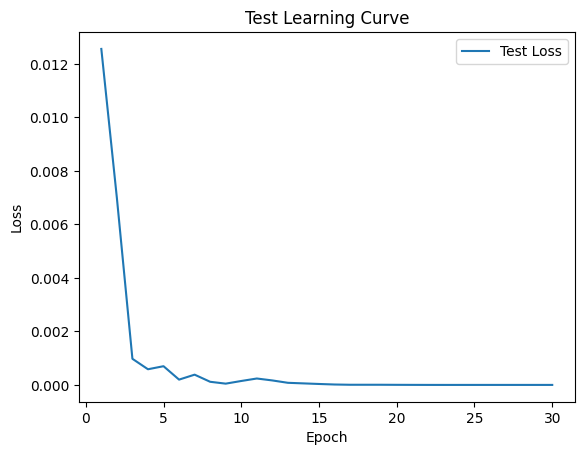

In [ ]:
# val the model and save weights
fit(30, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_food' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result_fine = pd.DataFrame({
    'Image Path': df_test_food['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result_fine)

                                        Image Path  True Value  \
0      /content/food/000000374451_preprocessed.jpg    0.760417   
1   /content/food/n07863374_17242_preprocessed.jpg    0.881188   
2    /content/food/n07583197_3923_preprocessed.jpg    0.803922   
3      /content/food/000000445557_preprocessed.jpg    0.923729   
4      /content/food/000000435488_preprocessed.jpg    0.857143   
..                                             ...         ...   
95     /content/food/000000245540_preprocessed.jpg    0.885965   
96  /content/food/n07933274_29270_preprocessed.jpg    0.831579   
97  /content/food/n07716358_11986_preprocessed.jpg    0.945455   
98   /content/food/n07693725_8046_preprocessed.jpg    0.916667   
99     /content/food/000000439537_preprocessed.jpg    0.869919   

    Predicted Value  
0          0.759183  
1          0.886821  
2          0.799535  
3          0.919664  
4          0.865777  
..              ...  
95         0.885337  
96         0.831720  
97       